In [1]:
import torch
import sklearn
import pandas as pd
import matplotlib.pyplot as plt
import os
import numpy as np
import random
from PIL import Image
from numpy import asarray
import skimage
import torchvision
from torchvision import transforms
from sklearn.model_selection import KFold
from torch import nn
from sklearn.metrics import classification_report
from torchinfo import summary


In [2]:
path = os.path.join(os.getcwd(), "dataset", "archive", "animals", "animals")

In [258]:
def get_file_count(path: str)->tuple([int, str, list]): 
    """
        To get count of files in each animal folder and return and return which animal have max image. 
    """
    count_of_animals = os.listdir(path)
    max_count = 0
    animal_name = ""
    count_list = list()
    for i in count_of_animals: 
        if max_count < len(os.path.join(path, i)): 
            max_count = len(os.path.join(path, i))
            animal_name = i
        count_list.append([i, len(os.path.join(path, i))])
    return (max_count, animal_name, count_list)
        

In [259]:
get_file_count(path)

(93,
 'pelecaniformes',
 [['antelope', 87],
  ['badger', 85],
  ['bat', 82],
  ['bear', 83],
  ['bee', 82],
  ['beetle', 85],
  ['bison', 84],
  ['boar', 83],
  ['butterfly', 88],
  ['cat', 82],
  ['caterpillar', 90],
  ['chimpanzee', 89],
  ['cockroach', 88],
  ['cow', 82],
  ['coyote', 85],
  ['crab', 83],
  ['crow', 83],
  ['deer', 83],
  ['dog', 82],
  ['dolphin', 86],
  ['donkey', 85],
  ['dragonfly', 88],
  ['duck', 83],
  ['eagle', 84],
  ['elephant', 87],
  ['flamingo', 87],
  ['fly', 82],
  ['fox', 82],
  ['goat', 83],
  ['goldfish', 87],
  ['goose', 84],
  ['gorilla', 86],
  ['grasshopper', 90],
  ['hamster', 86],
  ['hare', 83],
  ['hedgehog', 87],
  ['hippopotamus', 91],
  ['hornbill', 87],
  ['horse', 84],
  ['hummingbird', 90],
  ['hyena', 84],
  ['jellyfish', 88],
  ['kangaroo', 87],
  ['koala', 84],
  ['ladybugs', 87],
  ['leopard', 86],
  ['lion', 83],
  ['lizard', 85],
  ['lobster', 86],
  ['mosquito', 87],
  ['moth', 83],
  ['mouse', 84],
  ['octopus', 86],
  ['okapi

In [346]:
def get_random_image()->None: 
    """
        Return random images for dataset
    """
    path = os.path.join(os.getcwd(), "dataset", "archive", "animals", "animals")
    random_image_class = random.choice(os.listdir(path))
    random_image = random.choice(os.listdir(os.path.join(path, random_image_class)))
    img = Image.open(os.path.join(path, random_image_class, random_image))
    image = asarray(img)
    print("Image Shape: ", image.shape, "Image Width:", img.width, "Image Height:", img.height)
    plt.imshow(image)
    plt.title(random_image_class)
    plt.axis(False)
    plt.show()

Image Shape:  (576, 1024, 3) Image Width: 1024 Image Height: 576


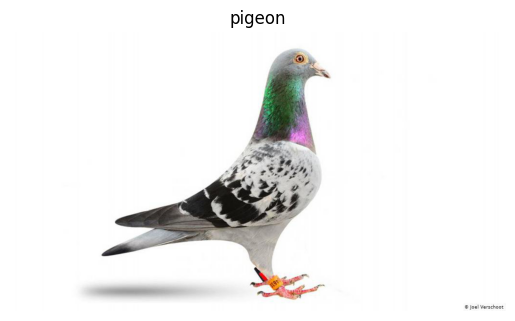

In [347]:
get_random_image()

In [348]:
def create_csv_dataset(path:str)->list:
    """
        Create csv file for dataset for ease of use.
    """
    dataset_create = list()
    img_classes = os.listdir(path)
    for i in img_classes: 
        for j in os.listdir(os.path.join(path, i)):
            dataset_create.append([i, os.path.join(path, i, j)])
    return dataset_create
        
    

In [343]:
df = create_csv_dataset(path)

In [335]:
df = pd.DataFrame(df, columns = ["class_name", "file_path"])

In [336]:
df.head()

,class_name,file_path
0,antelope,C:\Users\pares\Documents\animal_classification...
1,antelope,C:\Users\pares\Documents\animal_classification...
2,antelope,C:\Users\pares\Documents\animal_classification...
3,antelope,C:\Users\pares\Documents\animal_classification...
4,antelope,C:\Users\pares\Documents\animal_classification...


In [337]:
df['class_name'].value_counts()

class_name
antelope     60
raccoon      60
porcupine    60
pigeon       60
pig          60
             ..
goat         60
fox          60
fly          60
flamingo     60
zebra        60
Name: count, Length: 90, dtype: int64

In [12]:
def selecting_k_images(path, class_name): 
    df_sample = pd.read_csv(path)
    df_class_name = df_sample[df_sample['class_name'] == class_name]
    cln = list(df_sample['class_name'].unique())
    cln.remove(class_name)
    for idx, i in enumerate(cln): 
        temp_df = df_sample[df_sample['class_name'] == i].sample(frac = 0.05)
        df_class_name = pd.concat([df_class_name, temp_df], axis = 0)
    df_class_name.reset_index(inplace=True)
    df_class_name.to_csv('df_sample.csv', index = False)

In [13]:
selecting_k_images('./dataset.csv', 'bear')

In [14]:
df_sample = pd.read_csv('./df_sample.csv')

In [15]:
df_sample.drop(['Unnamed: 0', 'index'], inplace=True, axis = 1)

In [16]:
df_sample.to_csv('df_sample.csv', index = False)

In [17]:
len(df.class_name.unique())

90

In [18]:
df_sample['class_name'].unique()

array(['bear', 'antelope', 'badger', 'bat', 'bee', 'beetle', 'bison',
       'boar', 'butterfly', 'cat', 'caterpillar', 'chimpanzee',
       'cockroach', 'cow', 'coyote', 'crab', 'crow', 'deer', 'dog',
       'dolphin', 'donkey', 'dragonfly', 'duck', 'eagle', 'elephant',
       'flamingo', 'fly', 'fox', 'goat', 'goldfish', 'goose', 'gorilla',
       'grasshopper', 'hamster', 'hare', 'hedgehog', 'hippopotamus',
       'hornbill', 'horse', 'hummingbird', 'hyena', 'jellyfish',
       'kangaroo', 'koala', 'ladybugs', 'leopard', 'lion', 'lizard',
       'lobster', 'mosquito', 'moth', 'mouse', 'octopus', 'okapi',
       'orangutan', 'otter', 'owl', 'ox', 'oyster', 'panda', 'parrot',
       'pelecaniformes', 'penguin', 'pig', 'pigeon', 'porcupine',
       'possum', 'raccoon', 'rat', 'reindeer', 'rhinoceros', 'sandpiper',
       'seahorse', 'seal', 'shark', 'sheep', 'snake', 'sparrow', 'squid',
       'squirrel', 'starfish', 'swan', 'tiger', 'turkey', 'turtle',
       'whale', 'wolf', 'wombat'

In [19]:
df.to_csv('dataset.csv')

In [19]:
from torch.utils.data import Dataset, DataLoader

In [20]:
class CustomDataset(Dataset): 
    def __init__(self, path, transform): 
        self.dataset_path = pd.read_csv(path)  
        self.transform = transform
    def __len__(self): 
        return len(self.dataset_path)
    def __getitem__(self,idx): 
        img_path= self.dataset_path['file_path'][idx]
        class_name = self.dataset_path['class_name'][idx]
        img = Image.open(img_path).convert("RGB")
#         class_name_idx = list(df['class_name'].unique()).index(class_name)
        if self.transform is not None: 
            img = self.transform(img)
        return img, class_name

In [ ]:
# ovr

In [26]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
weights = torchvision.models.EfficientNet_B0_Weights.DEFAULT # “.DEFAULT” = best available weights
eff_model = torchvision.models.efficientnet_b0(weights=weights).to(device)

In [27]:
summary(model=eff_model, 
        input_size=(32, 3, 224, 224), # make sure this is "input_size", not "input_shape"
        # col_names=["input_size"], # uncomment for smaller output
        col_names=["input_size", "output_size", "num_params", "trainable"],
        col_width=20,
        row_settings=["var_names"]
)

Layer (type (var_name))                                      Input Shape          Output Shape         Param #              Trainable
EfficientNet (EfficientNet)                                  [32, 3, 224, 224]    [32, 1000]           --                   True
├─Sequential (features)                                      [32, 3, 224, 224]    [32, 1280, 7, 7]     --                   True
│    └─Conv2dNormActivation (0)                              [32, 3, 224, 224]    [32, 32, 112, 112]   --                   True
│    │    └─Conv2d (0)                                       [32, 3, 224, 224]    [32, 32, 112, 112]   864                  True
│    │    └─BatchNorm2d (1)                                  [32, 32, 112, 112]   [32, 32, 112, 112]   64                   True
│    │    └─SiLU (2)                                         [32, 32, 112, 112]   [32, 32, 112, 112]   --                   --
│    └─Sequential (1)                                        [32, 32, 112, 112]   [32, 16, 112

In [25]:
class Model(nn.Module): 
    def __init__(self, class_name):
        super().__init__()
        self.class_name = class_name
        self.weights = torchvision.models.EfficientNet_B0_Weights.DEFAULT
        self.device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
        self.model = torchvision.models.efficientnet_b0(weights=self.weights).to(self.device) 
    def model_init(self):
        for param in self.model.features.parameters():
            param.requires_grad = False
        for param in self.model.features[-1:].parameters():
            param.requires_grad = True
        self.model.classifier = torch.nn.Sequential(
        torch.nn.Dropout(p=0.2, inplace=True), 
        torch.nn.Linear(in_features=1280, 
                        out_features=1, bias=True)).to(device)
    def train_mode(self, train_loader, test_loader, epoch): 
        self.model_init()
        loss_fn =  nn.BCEWithLogitsLoss()
        optimizer = torch.optim.Adam(params=  self.model.parameters(), lr = 0.001)
        results = train(model=self.model,
                           train_dataloader=train_loader,
                           test_dataloader=test_loader,
                           optimizer=optimizer,
                           loss_fn=loss_fn,
                           epochs=epoch,
                           device=self.device)
        plot_loss_curves(results, self.class_name)

In [90]:
import matplotlib.pyplot as plt
def train_step_binary(model: torch.nn.Module, 
               dataloader: torch.utils.data.DataLoader, 
               loss_fn: torch.nn.Module, 
               optimizer: torch.optim.Optimizer,
               device: torch.device):
    # Put model in train mode
    y_trues = list()
    y_preds = list()
    model.train()

    # Setup train loss and train accuracy values
    train_loss, train_acc = 0, 0

    # Loop through data loader data batches
    for batch, (X, y) in enumerate(dataloader):
        # Send data to target device
        X, y = X.to(device), y.to(device)

        # 1. Forward pass
        y_pred = model(X).squeeze()

        # 2. Calculate  and accumulate loss
        loss = loss_fn(y_pred, y.float())
        train_loss += loss.item() 

        # 3. Optimizer zero grad
        optimizer.zero_grad()

        # 4. Loss backward
        loss.backward()

        # 5. Optimizer step
        optimizer.step()

        # Calculate and accumulate accuracy metric across all batches
        y_pred_class = torch.round(torch.sigmoid(y_pred)) 
        train_acc += (y_pred_class == y).sum().item()/len(y_pred)
        y_trues.extend(list(y.cpu().numpy()))
        y_preds.extend(list(y_pred_class.cpu().detach().numpy()))
    # Adjust metrics to get average loss and accuracy per batch 
    print("Train classification")
    print(classification_report(y_trues, y_preds))
    train_loss = train_loss / len(dataloader)
    train_acc = train_acc / len(dataloader)
    return train_loss, train_acc

def test_step_binary(model: torch.nn.Module, 
              dataloader: torch.utils.data.DataLoader, 
              loss_fn: torch.nn.Module,
              device: torch.device):
    # Put model in eval mode
    y_trues = list()
    y_preds = list()
    model.eval() 

    # Setup test loss and test accuracy values
    test_loss, test_acc = 0, 0

    # Turn on inference context manager
    with torch.inference_mode():
        # Loop through DataLoader batches
        for batch, (X, y) in enumerate(dataloader):
            # Send data to target device
            X, y = X.to(device), y.to(device)

            # 1. Forward pass
            test_pred_logits = model(X).squeeze()

            # 2. Calculate and accumulate loss
            loss = loss_fn(test_pred_logits, y.float())
            test_loss += loss.item()

            # Calculate and accumulate accuracy
            test_pred_labels = torch.round(torch.sigmoid(test_pred_logits)) 
            test_acc += ((test_pred_labels == y).sum().item()/len(test_pred_labels))
            y_trues.extend(list(y.cpu().numpy()))
            y_preds.extend(list(test_pred_labels.cpu().detach().numpy()))
    # Adjust metrics to get average loss and accuracy per batch 
    print("Test classification")
    print(classification_report(y_trues, y_preds))
    # Adjust metrics to get average loss and accuracy per batch 
    test_loss = test_loss / len(dataloader)
    test_acc = test_acc / len(dataloader)
    return test_loss, test_acc

def train_binary(model: torch.nn.Module, 
          train_dataloader: torch.utils.data.DataLoader, 
          test_dataloader: torch.utils.data.DataLoader, 
          optimizer: torch.optim.Optimizer,
          loss_fn: torch.nn.Module,
          epochs: int,
          device: torch.device):
    # Create empty results dictionary
    early_stopping = EarlyStopping(tolerance=2, min_delta=5)
    results = {"train_loss": [],
               "train_acc": [],
               "test_loss": [],
               "test_acc": []
    }
    
    # Make sure model on target device
    model.to(device)

    # Loop through training and testing steps for a number of epochs
    for epoch in range(epochs):
        train_loss, train_acc = train_step_binary(model=model,
                                          dataloader=train_dataloader,
                                          loss_fn=loss_fn,
                                          optimizer=optimizer,
                                          device=device)
        test_loss, test_acc = test_step_binary(model=model,
          dataloader=test_dataloader,
          loss_fn=loss_fn,
          device=device)
        

        # Print out what's happening
        print(
          f"Epoch: {epoch+1} | "
          f"train_loss: {train_loss:.4f} | "
          f"train_acc: {train_acc:.4f} | "
          f"test_loss: {test_loss:.4f} | "
          f"test_acc: {test_acc:.4f}"
        )

        # Update results dictionary
        results["train_loss"].append(train_loss)
        results["train_acc"].append(train_acc)
        results["test_loss"].append(test_loss)
        results["test_acc"].append(test_acc)
        
        early_stopping(results['train_loss'][epoch], results['test_loss'][epoch])
        if early_stopping.early_stop:
            print("We are at epoch:", i)
            break
    # Return the filled results at the end of the epochs
    return results
def plot_loss_curves(results, class_name):
    """Plots training curves of a results dictionary.

    Args:
        results (dict): dictionary containing list of values, e.g.
            {"train_loss": [...],
             "train_acc": [...],
             "test_loss": [...],
             "test_acc": [...]}
    """
    
    # Get the loss values of the results dictionary (training and test)
    loss = results['train_loss']
    test_loss = results['test_loss']

    # Get the accuracy values of the results dictionary (training and test)
    accuracy = results['train_acc']
    test_accuracy = results['test_acc']

    # Figure out how many epochs there were
    epochs = range(len(results['train_loss']))

    # Setup a plot 
    plt.figure(figsize=(15, 7))
    
    # Plot loss
    plt.subplot(1, 2, 1)
    plt.plot(epochs, loss, label='train_loss')
    plt.plot(epochs, test_loss, label='test_loss')
    plt.title(f'Loss {class_name}')
    plt.xlabel('Epochs')
    plt.legend()
    plt.show()
    # Plot accuracy
    plt.subplot(1, 2, 2)
    plt.plot(epochs, accuracy, label='train_accuracy')
    plt.plot(epochs, test_accuracy, label='test_accuracy')
    plt.title(f'Accuracy {class_name}')
    plt.xlabel('Epochs')
    plt.legend()
    plt.show()

In [26]:
train_transform_class = transforms.Compose([
            transforms.Resize((224, 224)), 
            transforms.ToTensor(),
            transforms.Normalize(mean=[0.485, 0.456, 0.406],
                                 std=[0.229, 0.224, 0.225]),
        ])

Fold 1
-------
Epoch: 1 | train_loss: 0.4062 | train_acc: 0.8798 | test_loss: 0.2619 | test_acc: 0.9643
Epoch: 2 | train_loss: 0.1331 | train_acc: 0.9808 | test_loss: 0.1575 | test_acc: 0.9598
Epoch: 3 | train_loss: 0.0806 | train_acc: 0.9808 | test_loss: 0.1098 | test_acc: 0.9688


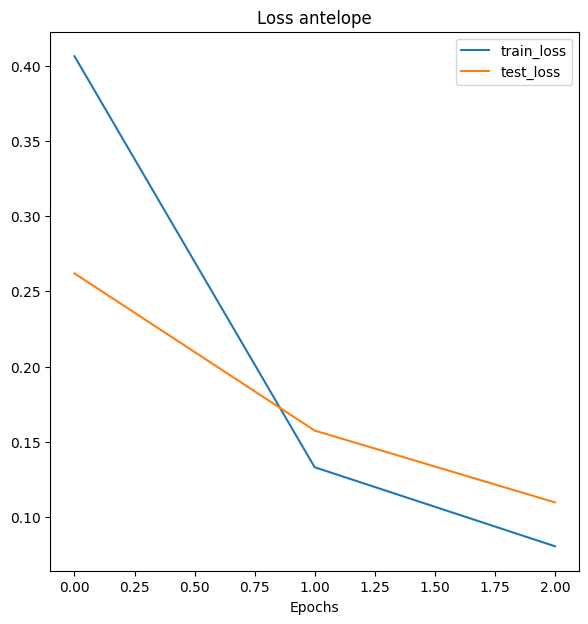

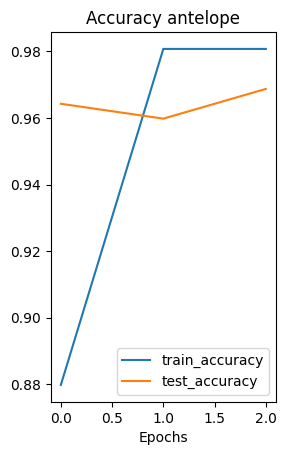

Fold 2
-------
Epoch: 1 | train_loss: 0.3726 | train_acc: 0.9062 | test_loss: 0.1593 | test_acc: 0.9955
Epoch: 2 | train_loss: 0.1153 | train_acc: 0.9784 | test_loss: 0.0682 | test_acc: 1.0000
Epoch: 3 | train_loss: 0.0653 | train_acc: 0.9880 | test_loss: 0.0504 | test_acc: 1.0000


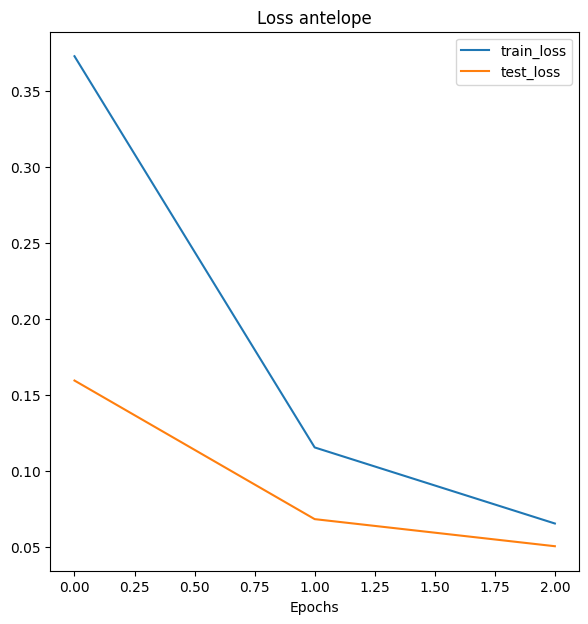

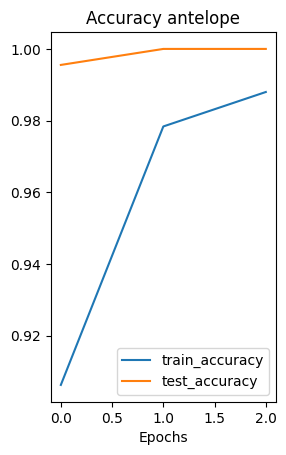

Fold 3
-------
Epoch: 1 | train_loss: 0.3359 | train_acc: 0.9159 | test_loss: 0.1545 | test_acc: 0.9821
Epoch: 2 | train_loss: 0.0981 | train_acc: 0.9784 | test_loss: 0.0831 | test_acc: 0.9821
Epoch: 3 | train_loss: 0.0409 | train_acc: 0.9952 | test_loss: 0.0730 | test_acc: 0.9866


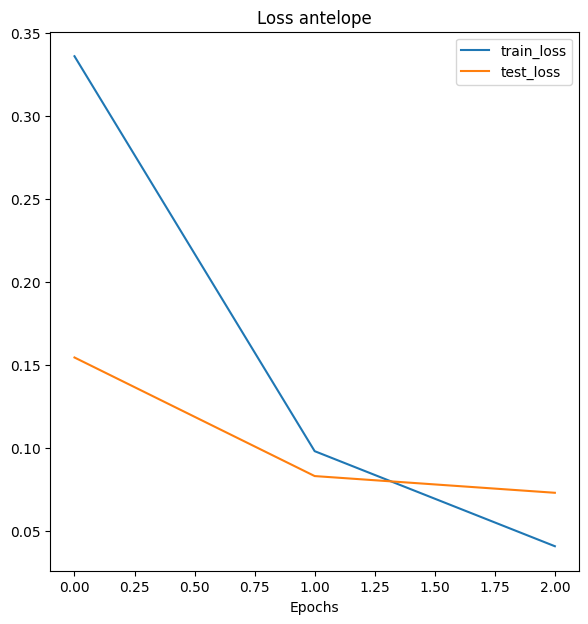

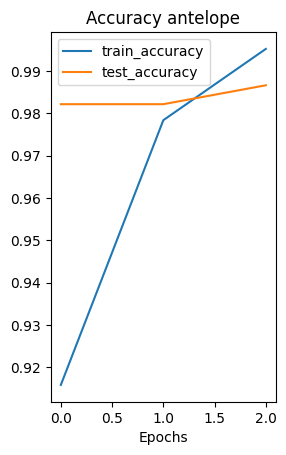

Fold 1
-------
Epoch: 1 | train_loss: 0.3902 | train_acc: 0.8942 | test_loss: 0.2611 | test_acc: 0.9375
Epoch: 2 | train_loss: 0.1464 | train_acc: 0.9663 | test_loss: 0.1443 | test_acc: 0.9643
Epoch: 3 | train_loss: 0.0656 | train_acc: 0.9904 | test_loss: 0.0831 | test_acc: 0.9688


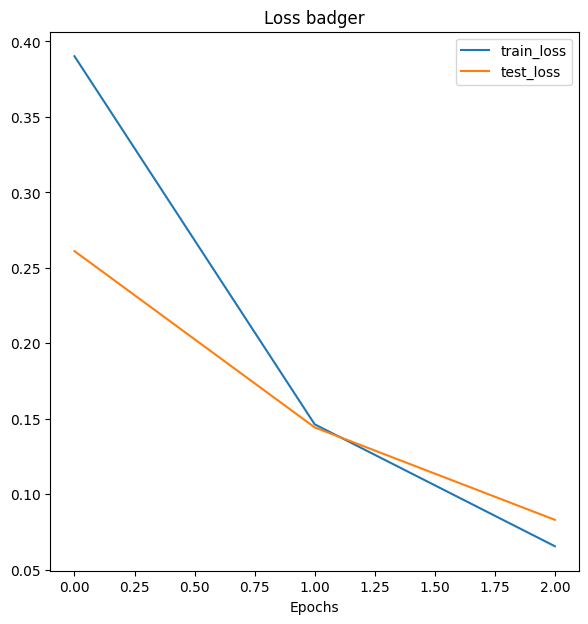

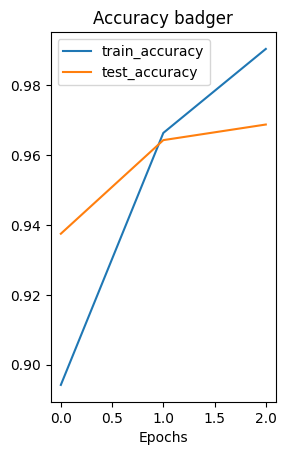

Fold 2
-------
Epoch: 1 | train_loss: 0.3460 | train_acc: 0.9183 | test_loss: 0.1570 | test_acc: 0.9911
Epoch: 2 | train_loss: 0.0905 | train_acc: 0.9856 | test_loss: 0.0783 | test_acc: 0.9955
Epoch: 3 | train_loss: 0.0480 | train_acc: 0.9976 | test_loss: 0.0596 | test_acc: 0.9955


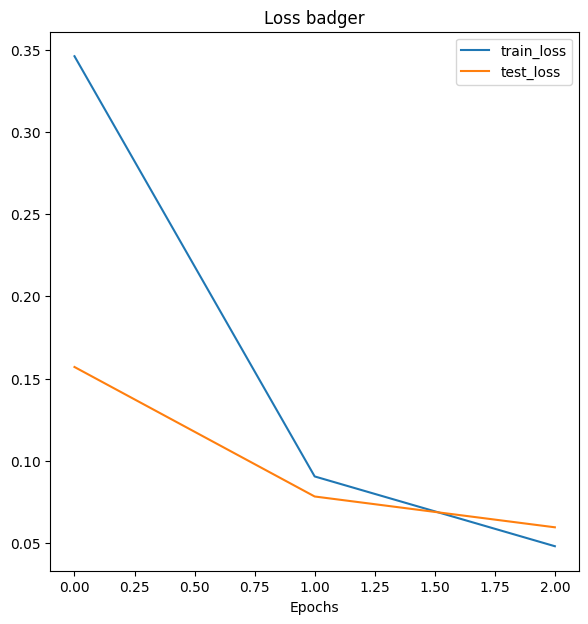

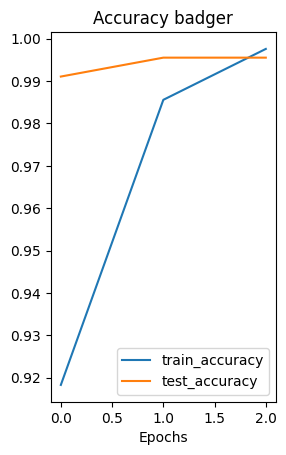

Fold 3
-------
Epoch: 1 | train_loss: 0.3483 | train_acc: 0.8990 | test_loss: 0.1122 | test_acc: 1.0000
Epoch: 2 | train_loss: 0.0826 | train_acc: 0.9880 | test_loss: 0.0601 | test_acc: 1.0000
Epoch: 3 | train_loss: 0.0401 | train_acc: 0.9976 | test_loss: 0.0278 | test_acc: 1.0000


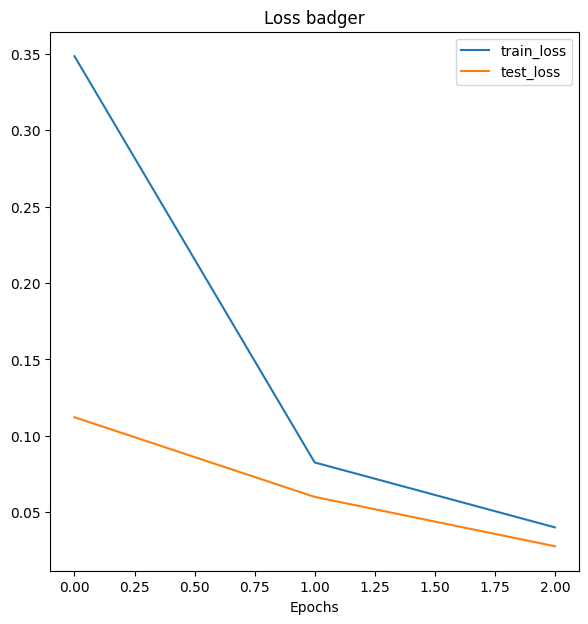

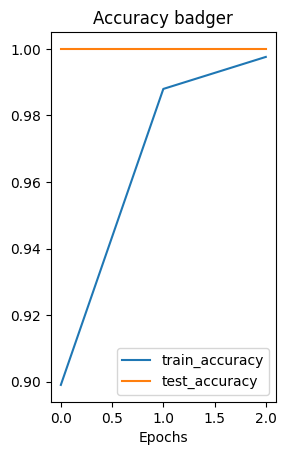

Fold 1
-------
Epoch: 1 | train_loss: 0.4459 | train_acc: 0.8438 | test_loss: 0.3492 | test_acc: 0.9062
Epoch: 2 | train_loss: 0.2022 | train_acc: 0.9399 | test_loss: 0.2304 | test_acc: 0.9241
Epoch: 3 | train_loss: 0.0973 | train_acc: 0.9784 | test_loss: 0.1718 | test_acc: 0.9598


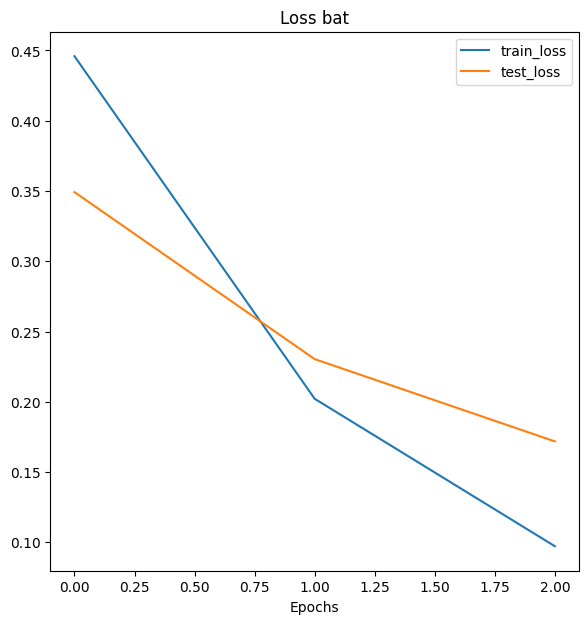

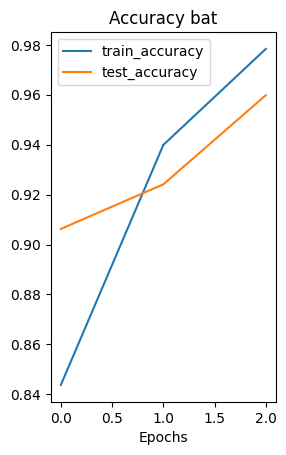

Fold 2
-------
Epoch: 1 | train_loss: 0.3921 | train_acc: 0.8870 | test_loss: 0.2065 | test_acc: 0.9688
Epoch: 2 | train_loss: 0.1314 | train_acc: 0.9784 | test_loss: 0.1276 | test_acc: 0.9688
Epoch: 3 | train_loss: 0.0679 | train_acc: 0.9880 | test_loss: 0.0773 | test_acc: 0.9866


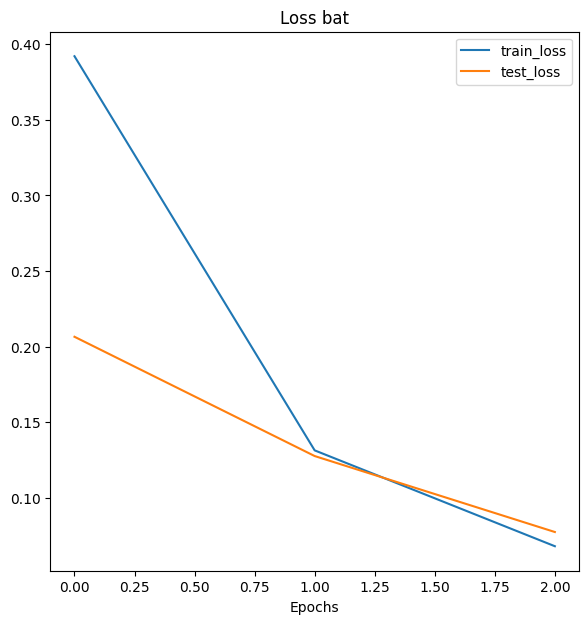

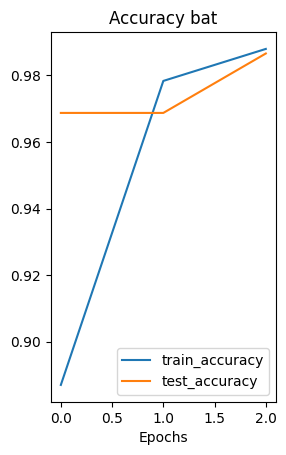

Fold 3
-------
Epoch: 1 | train_loss: 0.4223 | train_acc: 0.8558 | test_loss: 0.1533 | test_acc: 0.9911
Epoch: 2 | train_loss: 0.1238 | train_acc: 0.9784 | test_loss: 0.0639 | test_acc: 0.9955
Epoch: 3 | train_loss: 0.0611 | train_acc: 0.9976 | test_loss: 0.0470 | test_acc: 0.9955


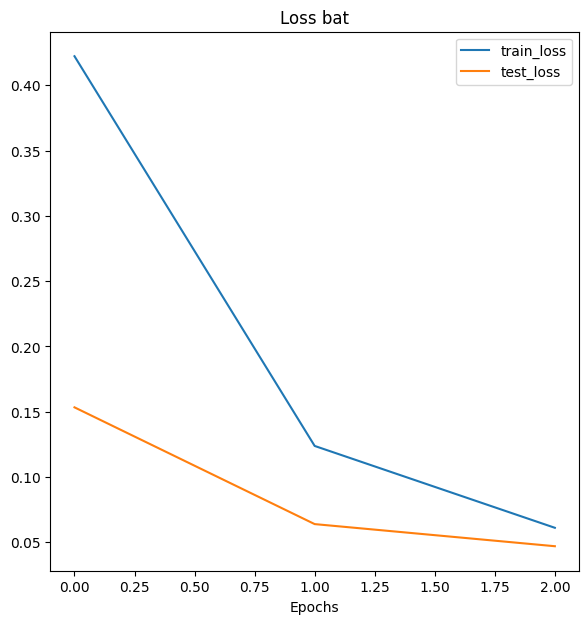

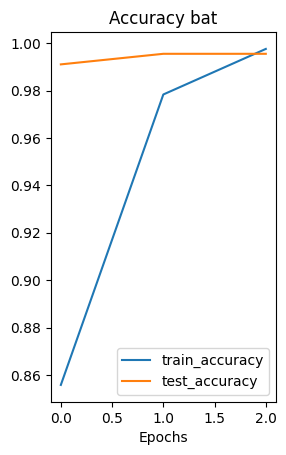

Fold 1
-------
Epoch: 1 | train_loss: 0.3993 | train_acc: 0.8990 | test_loss: 0.3030 | test_acc: 0.9241
Epoch: 2 | train_loss: 0.1616 | train_acc: 0.9543 | test_loss: 0.1508 | test_acc: 0.9643
Epoch: 3 | train_loss: 0.0926 | train_acc: 0.9808 | test_loss: 0.1110 | test_acc: 0.9777


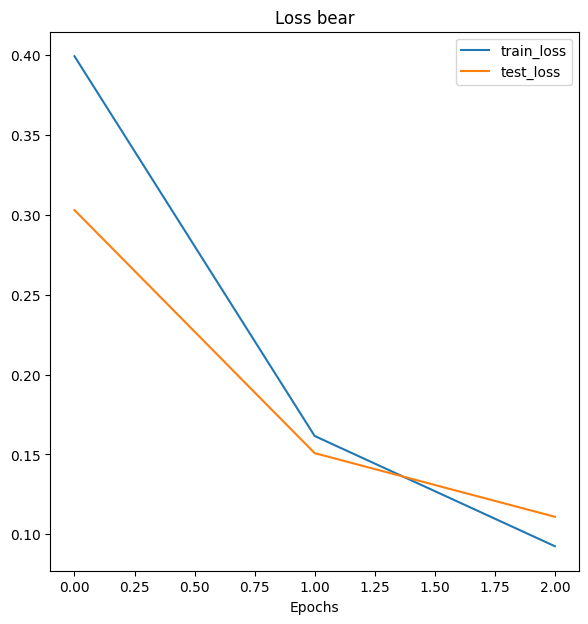

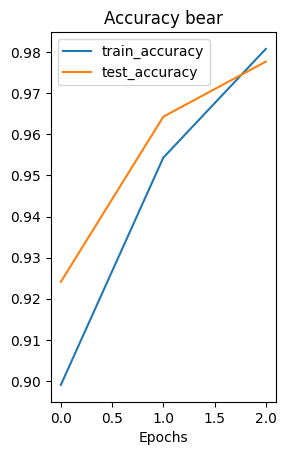

Fold 2
-------
Epoch: 1 | train_loss: 0.3493 | train_acc: 0.9207 | test_loss: 0.1753 | test_acc: 0.9598
Epoch: 2 | train_loss: 0.1073 | train_acc: 0.9784 | test_loss: 0.0937 | test_acc: 0.9643
Epoch: 3 | train_loss: 0.0480 | train_acc: 0.9904 | test_loss: 0.0794 | test_acc: 0.9732


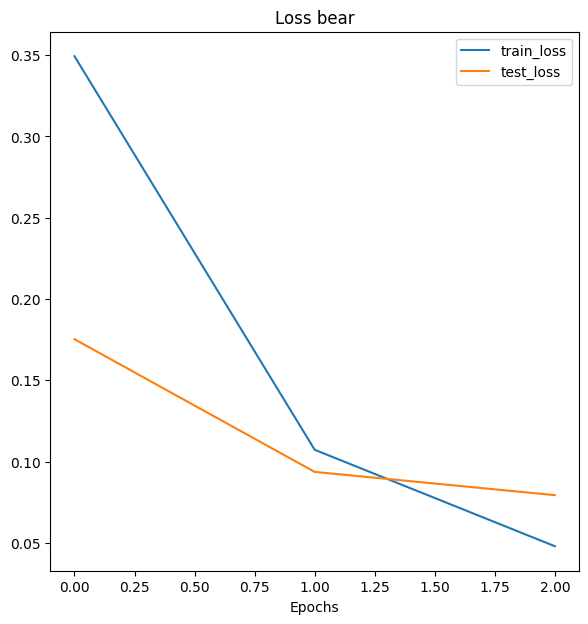

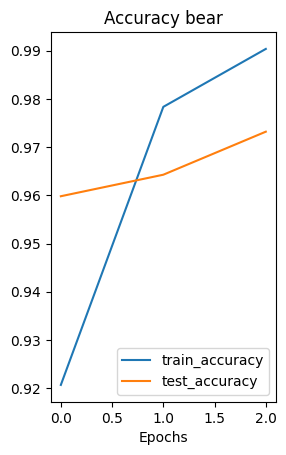

Fold 3
-------
Epoch: 1 | train_loss: 0.3550 | train_acc: 0.9038 | test_loss: 0.1304 | test_acc: 0.9866
Epoch: 2 | train_loss: 0.0925 | train_acc: 0.9856 | test_loss: 0.0690 | test_acc: 0.9911
Epoch: 3 | train_loss: 0.0424 | train_acc: 0.9928 | test_loss: 0.0476 | test_acc: 0.9911


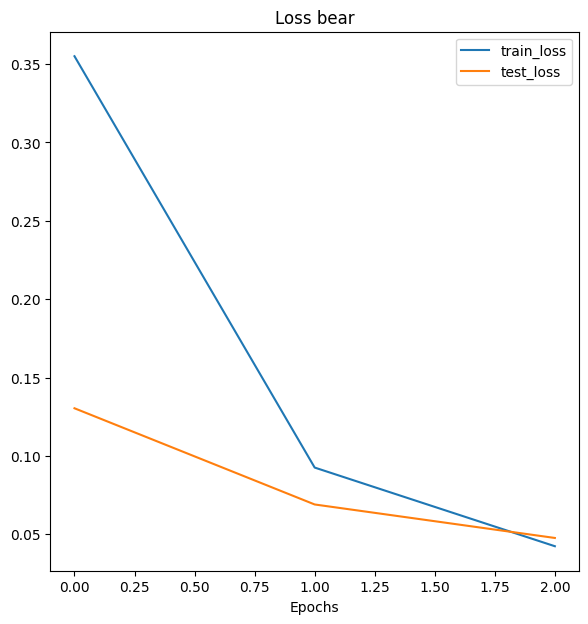

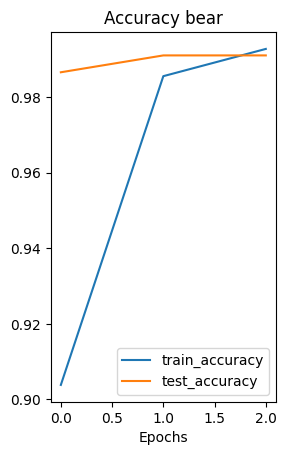

Fold 1
-------
Epoch: 1 | train_loss: 0.4152 | train_acc: 0.8798 | test_loss: 0.2402 | test_acc: 0.9554
Epoch: 2 | train_loss: 0.1457 | train_acc: 0.9663 | test_loss: 0.1124 | test_acc: 0.9821
Epoch: 3 | train_loss: 0.0975 | train_acc: 0.9760 | test_loss: 0.0715 | test_acc: 0.9866


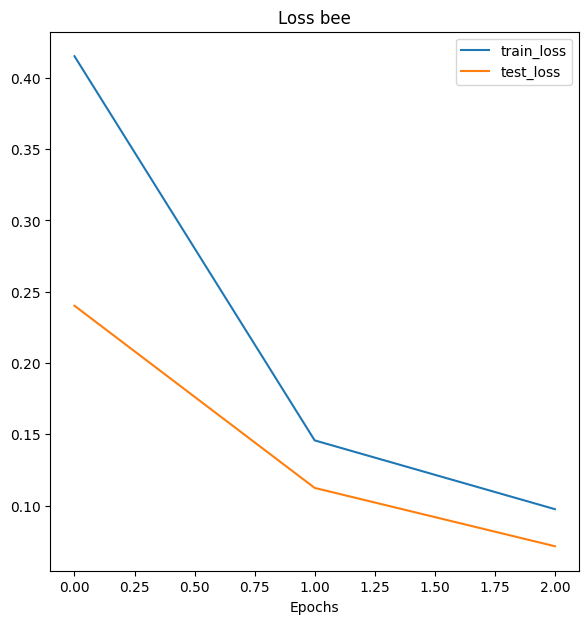

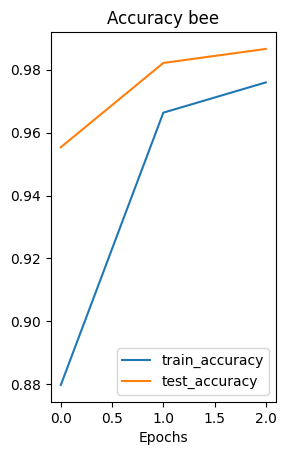

Fold 2
-------
Epoch: 1 | train_loss: 0.4215 | train_acc: 0.8486 | test_loss: 0.1936 | test_acc: 0.9821
Epoch: 2 | train_loss: 0.1202 | train_acc: 0.9808 | test_loss: 0.1019 | test_acc: 0.9866
Epoch: 3 | train_loss: 0.0496 | train_acc: 0.9952 | test_loss: 0.0831 | test_acc: 0.9955


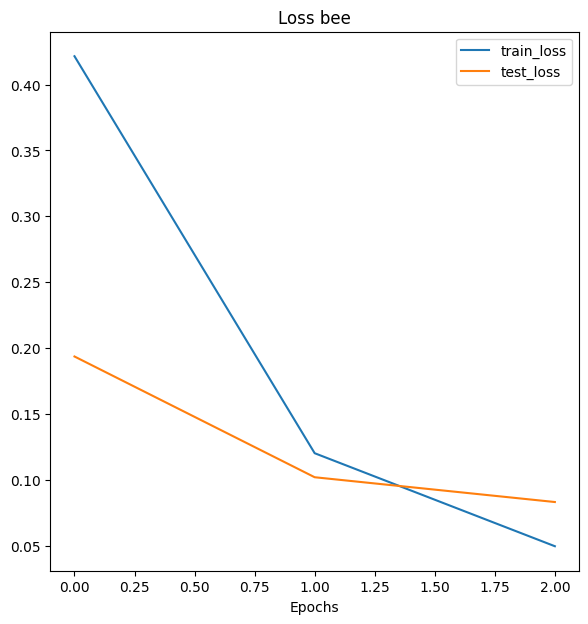

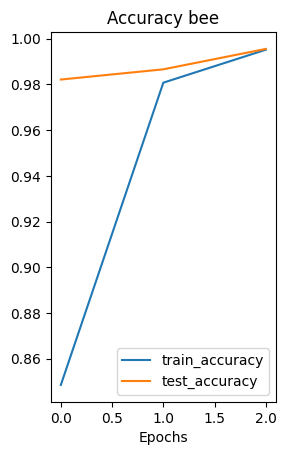

Fold 3
-------
Epoch: 1 | train_loss: 0.3812 | train_acc: 0.8846 | test_loss: 0.1545 | test_acc: 0.9911
Epoch: 2 | train_loss: 0.1010 | train_acc: 0.9832 | test_loss: 0.0756 | test_acc: 0.9911
Epoch: 3 | train_loss: 0.0484 | train_acc: 0.9880 | test_loss: 0.0480 | test_acc: 0.9955


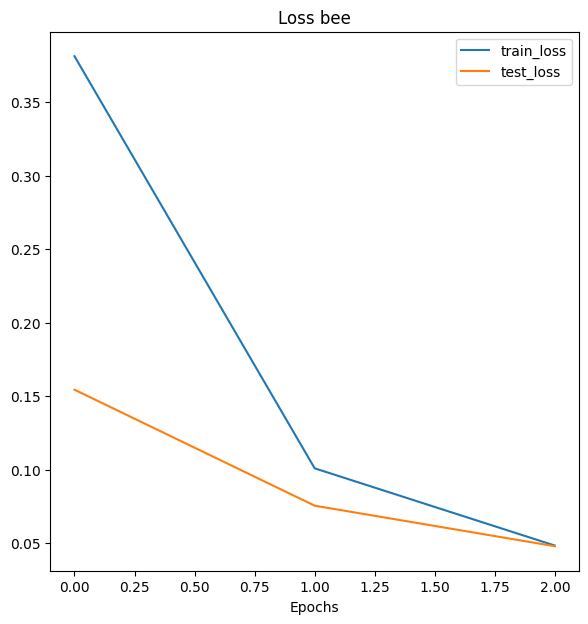

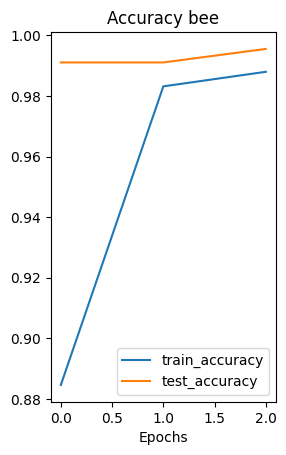

Fold 1
-------
Epoch: 1 | train_loss: 0.4169 | train_acc: 0.8750 | test_loss: 0.2909 | test_acc: 0.9509
Epoch: 2 | train_loss: 0.1689 | train_acc: 0.9519 | test_loss: 0.1673 | test_acc: 0.9598
Epoch: 3 | train_loss: 0.0950 | train_acc: 0.9832 | test_loss: 0.1065 | test_acc: 0.9821


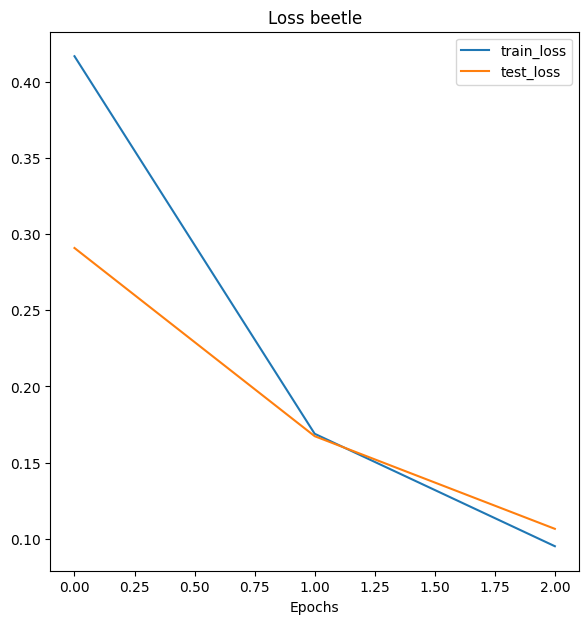

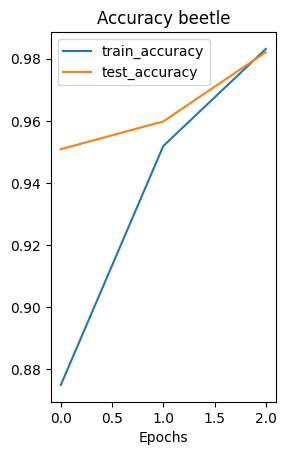

Fold 2
-------
Epoch: 1 | train_loss: 0.3689 | train_acc: 0.9038 | test_loss: 0.2066 | test_acc: 0.9598
Epoch: 2 | train_loss: 0.1156 | train_acc: 0.9760 | test_loss: 0.1345 | test_acc: 0.9598
Epoch: 3 | train_loss: 0.0514 | train_acc: 0.9952 | test_loss: 0.1090 | test_acc: 0.9688


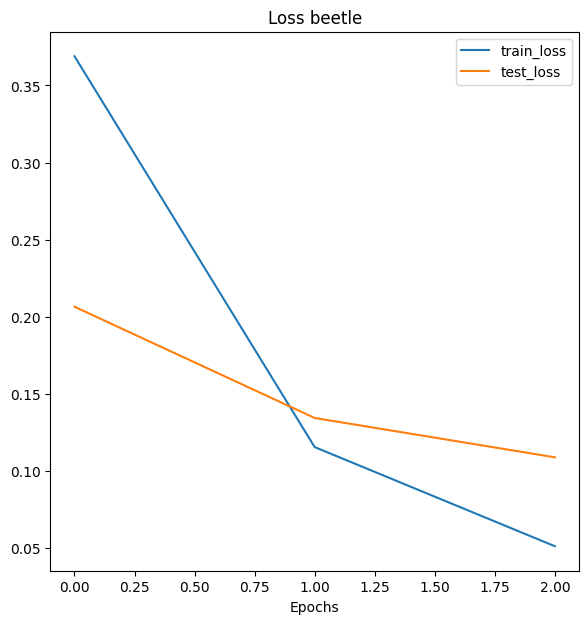

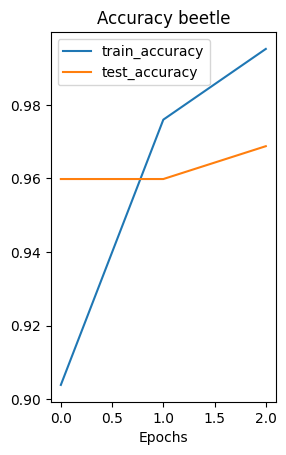

Fold 3
-------
Epoch: 1 | train_loss: 0.3705 | train_acc: 0.8726 | test_loss: 0.1483 | test_acc: 0.9688
Epoch: 2 | train_loss: 0.1094 | train_acc: 0.9736 | test_loss: 0.0762 | test_acc: 0.9866
Epoch: 3 | train_loss: 0.0536 | train_acc: 0.9904 | test_loss: 0.0582 | test_acc: 0.9821


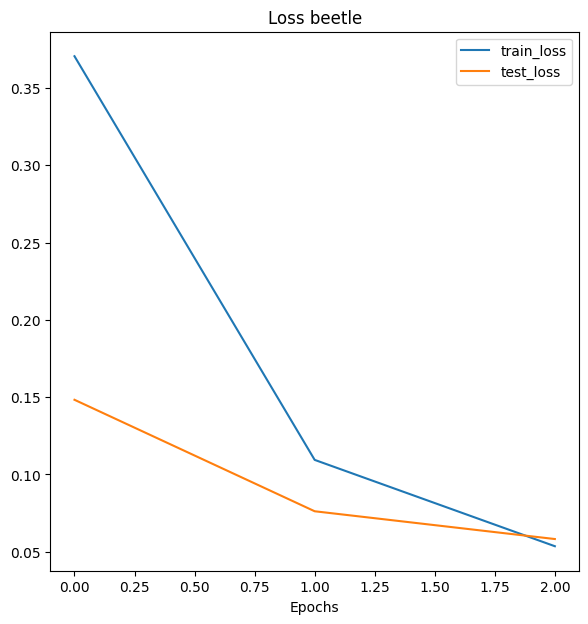

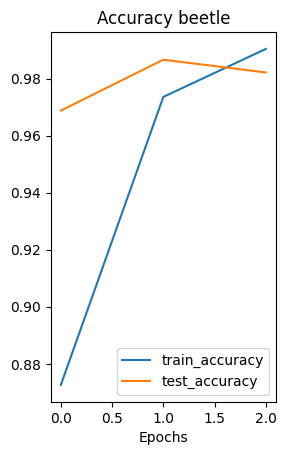

Fold 1
-------
Epoch: 1 | train_loss: 0.4226 | train_acc: 0.8726 | test_loss: 0.2576 | test_acc: 0.9330
Epoch: 2 | train_loss: 0.1407 | train_acc: 0.9760 | test_loss: 0.1532 | test_acc: 0.9598
Epoch: 3 | train_loss: 0.0684 | train_acc: 0.9928 | test_loss: 0.0880 | test_acc: 0.9821


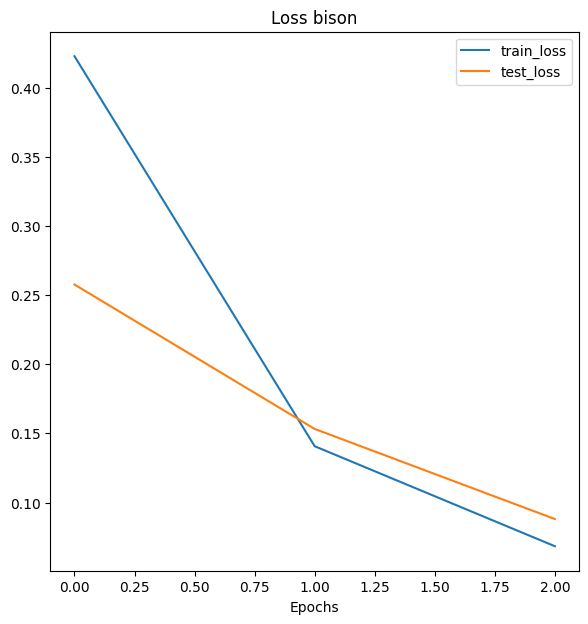

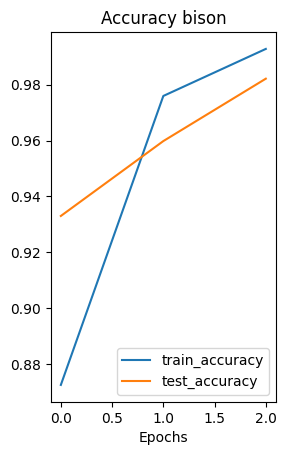

Fold 2
-------
Epoch: 1 | train_loss: 0.3438 | train_acc: 0.9279 | test_loss: 0.1694 | test_acc: 0.9911
Epoch: 2 | train_loss: 0.1201 | train_acc: 0.9712 | test_loss: 0.0995 | test_acc: 0.9911
Epoch: 3 | train_loss: 0.0351 | train_acc: 1.0000 | test_loss: 0.0812 | test_acc: 0.9732


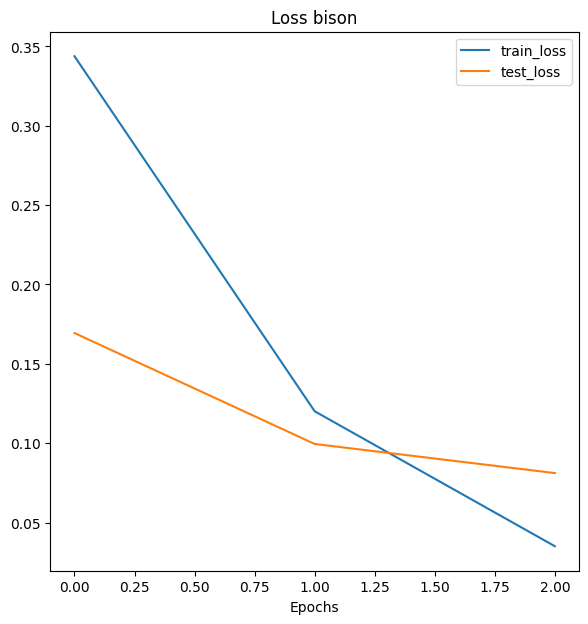

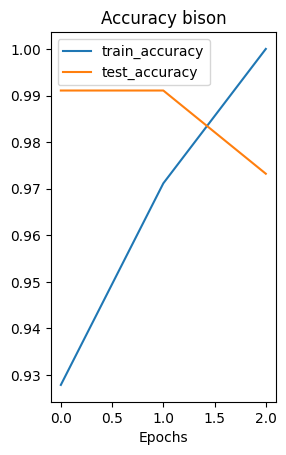

Fold 3
-------
Epoch: 1 | train_loss: 0.3116 | train_acc: 0.9567 | test_loss: 0.1113 | test_acc: 1.0000
Epoch: 2 | train_loss: 0.0878 | train_acc: 0.9784 | test_loss: 0.0464 | test_acc: 0.9955
Epoch: 3 | train_loss: 0.0392 | train_acc: 0.9928 | test_loss: 0.0290 | test_acc: 0.9955


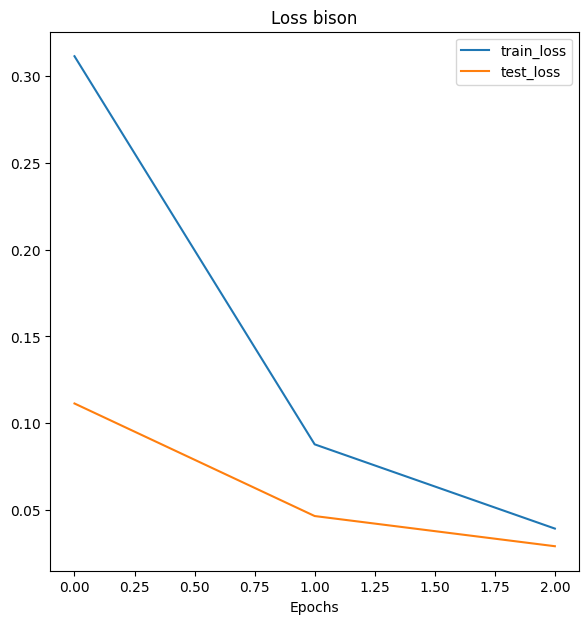

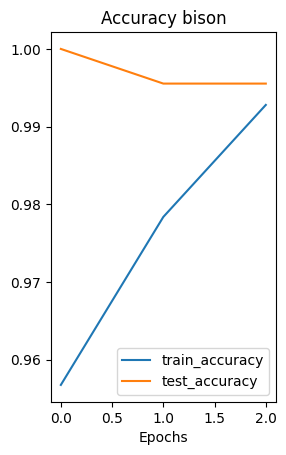

Fold 1
-------
Epoch: 1 | train_loss: 0.4066 | train_acc: 0.8894 | test_loss: 0.2567 | test_acc: 0.9464
Epoch: 2 | train_loss: 0.1385 | train_acc: 0.9808 | test_loss: 0.1155 | test_acc: 0.9732
Epoch: 3 | train_loss: 0.0851 | train_acc: 0.9832 | test_loss: 0.0743 | test_acc: 0.9777


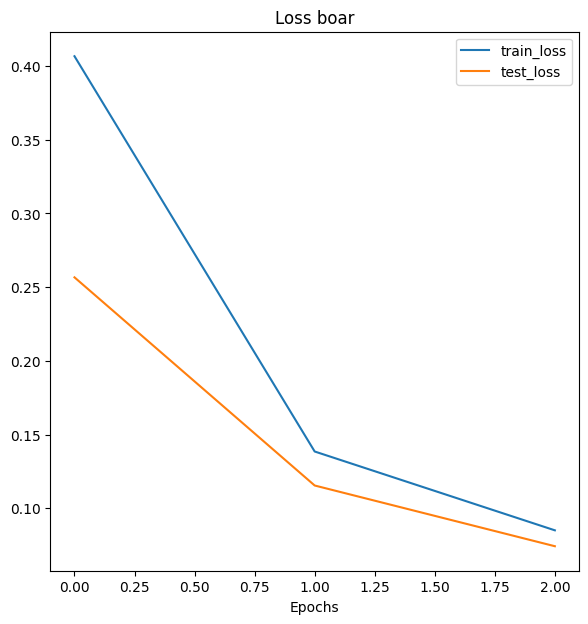

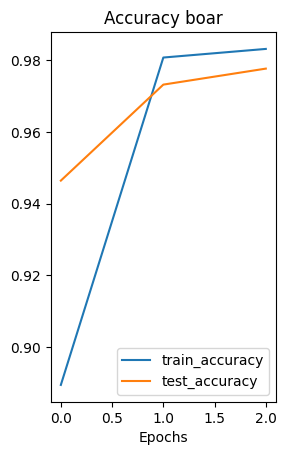

Fold 2
-------
Epoch: 1 | train_loss: 0.3808 | train_acc: 0.8918 | test_loss: 0.1976 | test_acc: 0.9598
Epoch: 2 | train_loss: 0.1115 | train_acc: 0.9808 | test_loss: 0.1000 | test_acc: 0.9866
Epoch: 3 | train_loss: 0.0451 | train_acc: 0.9952 | test_loss: 0.0776 | test_acc: 0.9911


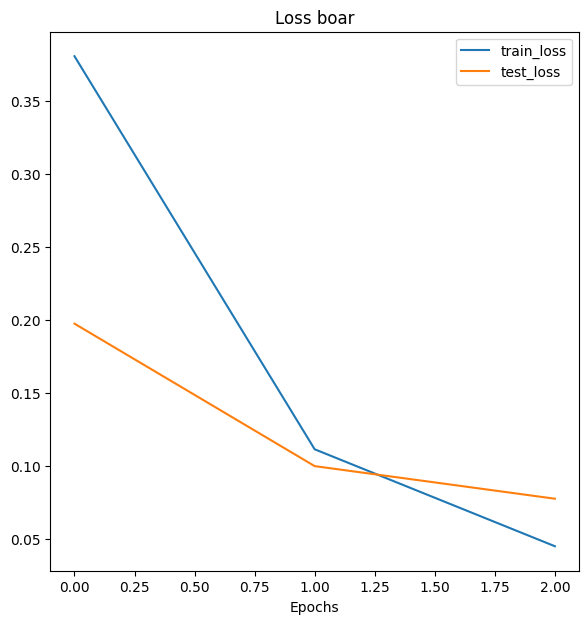

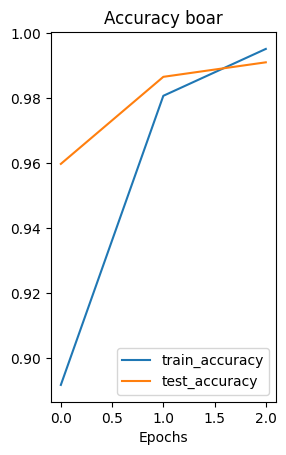

Fold 3
-------
Epoch: 1 | train_loss: 0.3721 | train_acc: 0.8894 | test_loss: 0.1504 | test_acc: 0.9777
Epoch: 2 | train_loss: 0.0980 | train_acc: 0.9856 | test_loss: 0.0812 | test_acc: 0.9911
Epoch: 3 | train_loss: 0.0677 | train_acc: 0.9832 | test_loss: 0.0500 | test_acc: 0.9955


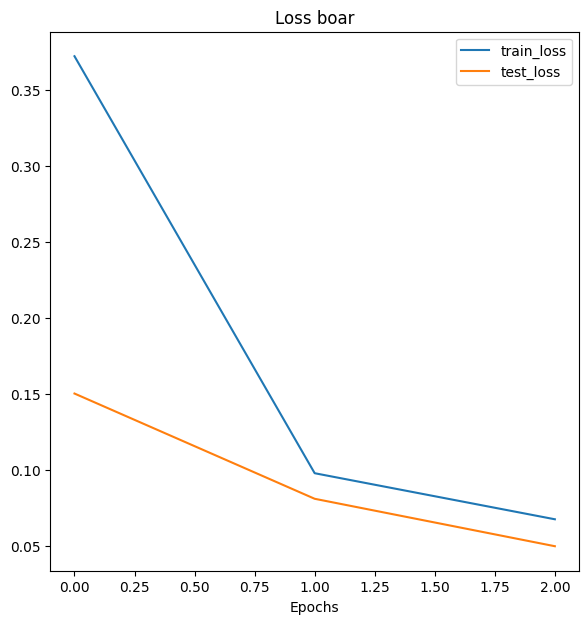

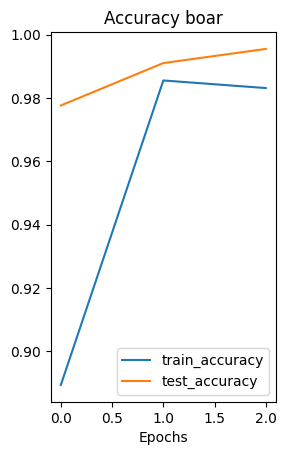

Fold 1
-------
Epoch: 1 | train_loss: 0.3530 | train_acc: 0.9255 | test_loss: 0.2976 | test_acc: 0.9107
Epoch: 2 | train_loss: 0.1120 | train_acc: 0.9784 | test_loss: 0.2194 | test_acc: 0.9107
Epoch: 3 | train_loss: 0.0702 | train_acc: 0.9832 | test_loss: 0.1307 | test_acc: 0.9554


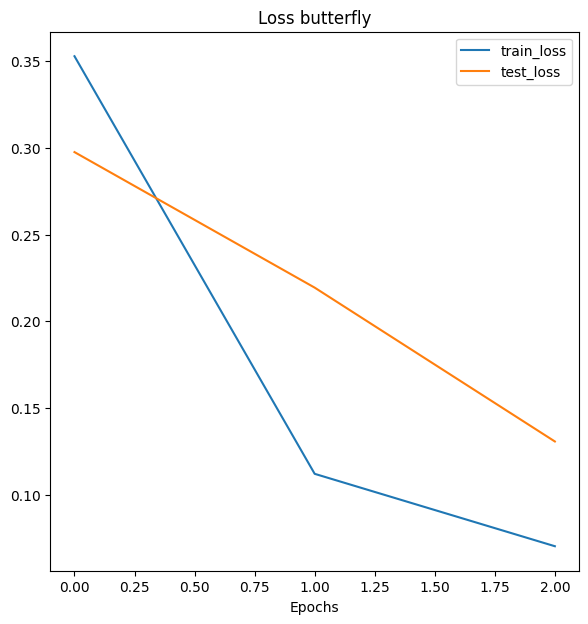

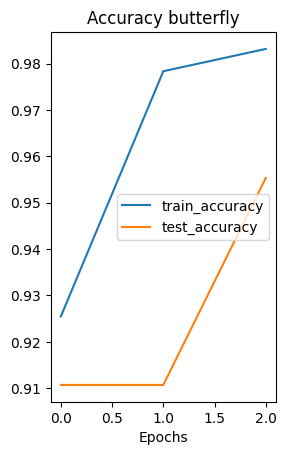

Fold 2
-------
Epoch: 1 | train_loss: 0.3705 | train_acc: 0.8798 | test_loss: 0.1752 | test_acc: 0.9732
Epoch: 2 | train_loss: 0.0900 | train_acc: 0.9880 | test_loss: 0.0775 | test_acc: 0.9911
Epoch: 3 | train_loss: 0.0464 | train_acc: 0.9904 | test_loss: 0.0697 | test_acc: 0.9911


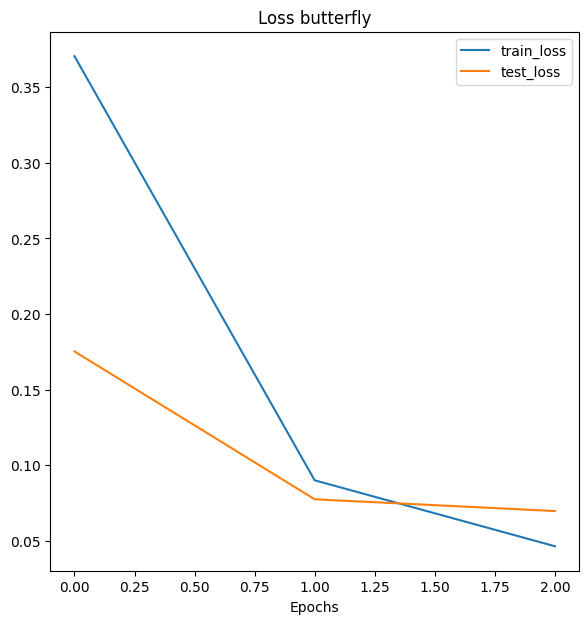

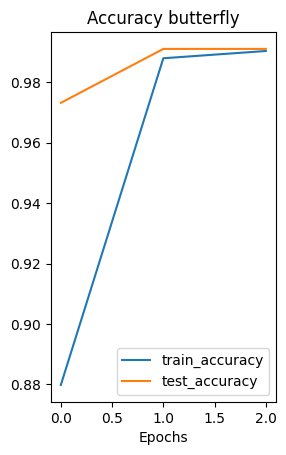

Fold 3
-------
Epoch: 1 | train_loss: 0.3349 | train_acc: 0.9159 | test_loss: 0.1293 | test_acc: 0.9777
Epoch: 2 | train_loss: 0.0885 | train_acc: 0.9832 | test_loss: 0.0505 | test_acc: 0.9955
Epoch: 3 | train_loss: 0.0468 | train_acc: 0.9904 | test_loss: 0.0426 | test_acc: 0.9911


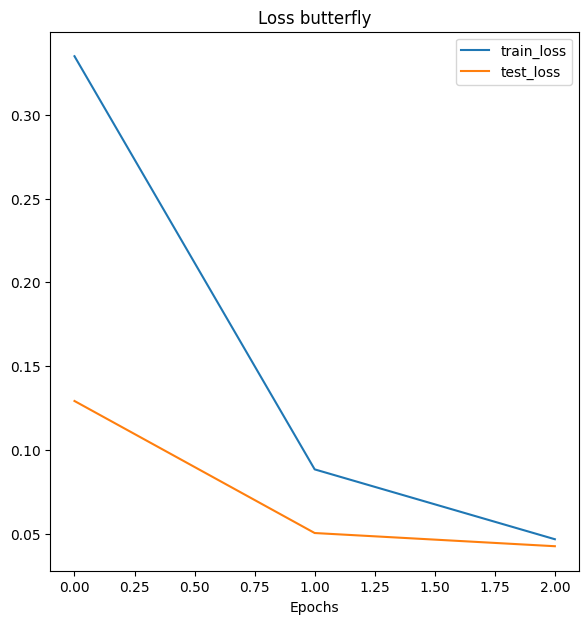

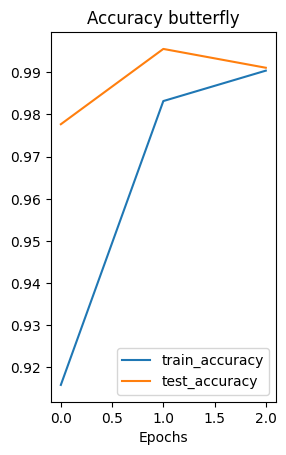

Fold 1
-------
Epoch: 1 | train_loss: 0.4357 | train_acc: 0.8774 | test_loss: 0.2667 | test_acc: 0.9643
Epoch: 2 | train_loss: 0.1753 | train_acc: 0.9639 | test_loss: 0.1458 | test_acc: 0.9866
Epoch: 3 | train_loss: 0.0799 | train_acc: 0.9880 | test_loss: 0.0953 | test_acc: 0.9821


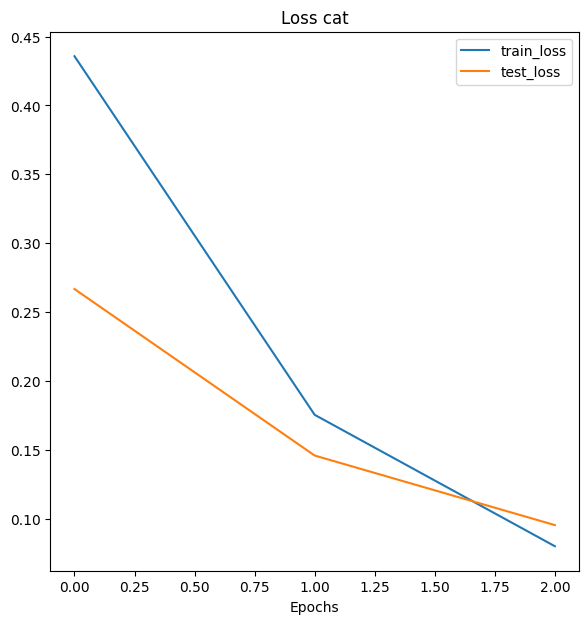

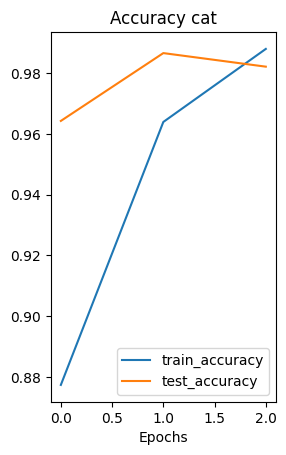

Fold 2
-------
Epoch: 1 | train_loss: 0.3700 | train_acc: 0.9183 | test_loss: 0.1483 | test_acc: 0.9911
Epoch: 2 | train_loss: 0.1039 | train_acc: 0.9784 | test_loss: 0.0740 | test_acc: 0.9955
Epoch: 3 | train_loss: 0.0563 | train_acc: 0.9880 | test_loss: 0.0523 | test_acc: 0.9955


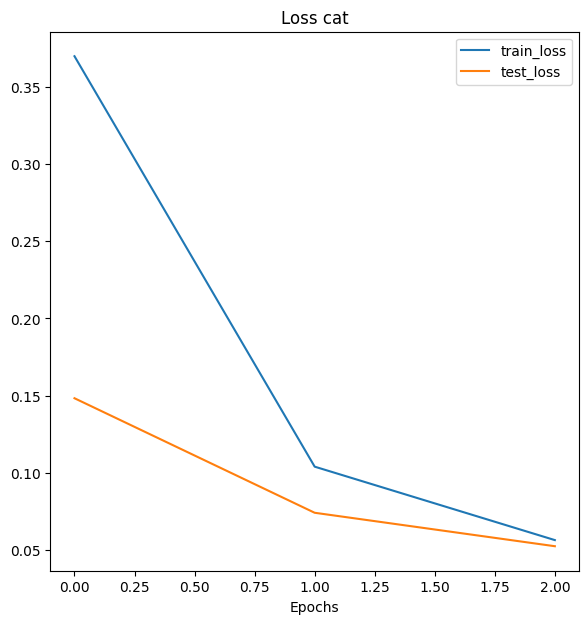

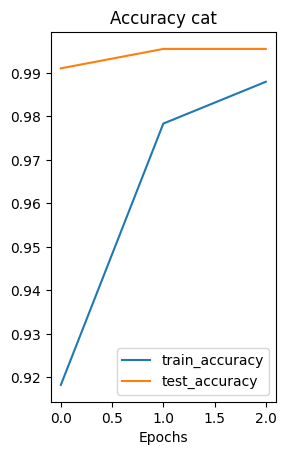

Fold 3
-------
Epoch: 1 | train_loss: 0.3664 | train_acc: 0.8846 | test_loss: 0.1240 | test_acc: 0.9911
Epoch: 2 | train_loss: 0.0818 | train_acc: 0.9952 | test_loss: 0.0513 | test_acc: 0.9955
Epoch: 3 | train_loss: 0.0479 | train_acc: 0.9952 | test_loss: 0.0398 | test_acc: 0.9911


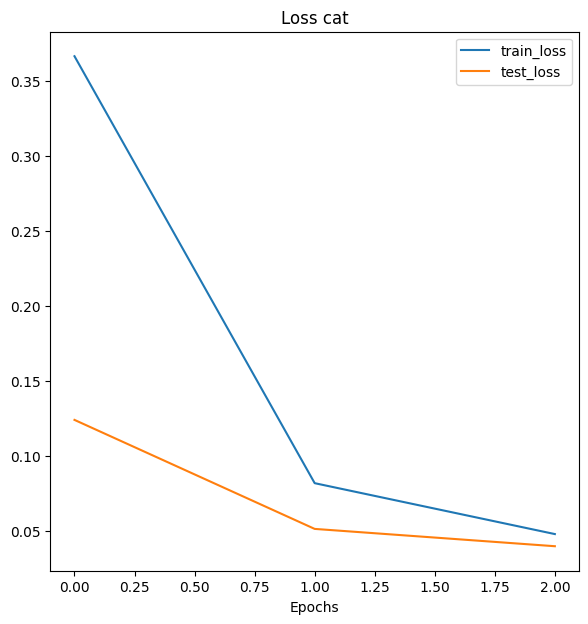

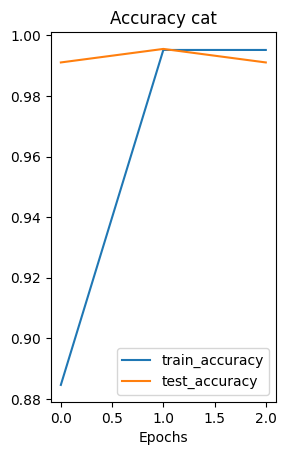

Fold 1
-------
Epoch: 1 | train_loss: 0.4534 | train_acc: 0.8317 | test_loss: 0.3080 | test_acc: 0.9152
Epoch: 2 | train_loss: 0.1672 | train_acc: 0.9784 | test_loss: 0.1812 | test_acc: 0.9241
Epoch: 3 | train_loss: 0.0803 | train_acc: 0.9928 | test_loss: 0.1572 | test_acc: 0.9509


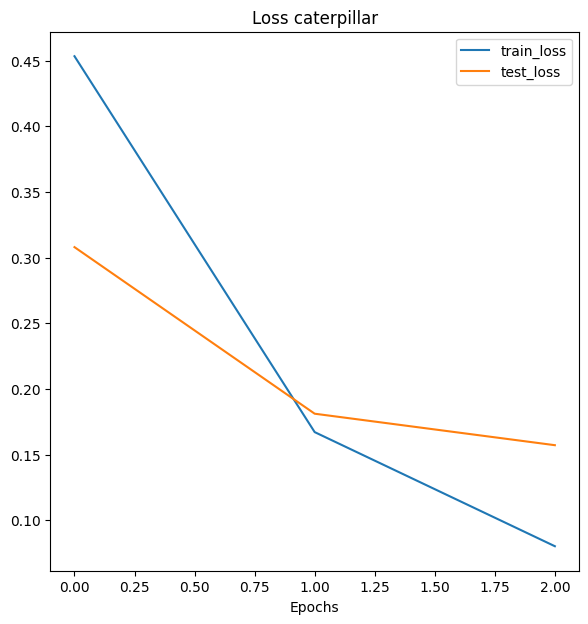

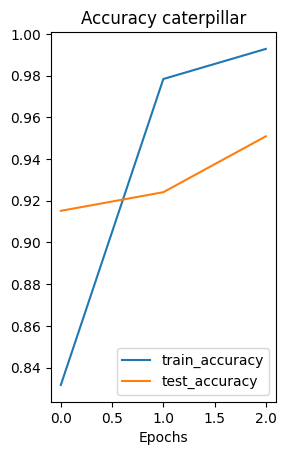

Fold 2
-------
Epoch: 1 | train_loss: 0.4070 | train_acc: 0.8726 | test_loss: 0.1735 | test_acc: 0.9955
Epoch: 2 | train_loss: 0.1306 | train_acc: 0.9712 | test_loss: 0.0787 | test_acc: 0.9955
Epoch: 3 | train_loss: 0.0631 | train_acc: 0.9904 | test_loss: 0.0540 | test_acc: 0.9955


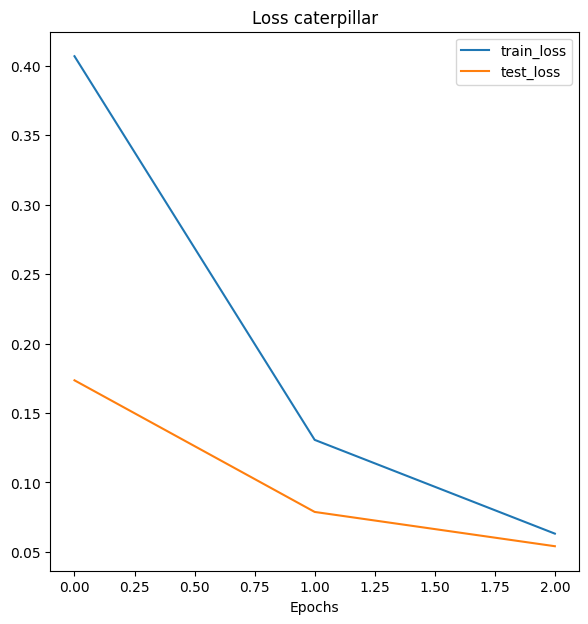

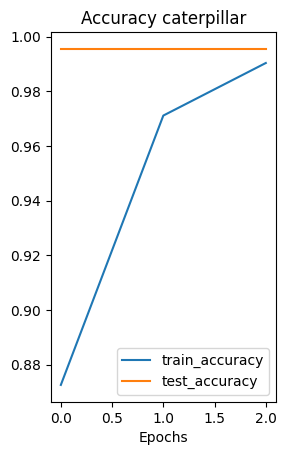

Fold 3
-------
Epoch: 1 | train_loss: 0.3727 | train_acc: 0.8894 | test_loss: 0.1543 | test_acc: 0.9955
Epoch: 2 | train_loss: 0.1063 | train_acc: 0.9832 | test_loss: 0.0689 | test_acc: 0.9955
Epoch: 3 | train_loss: 0.0478 | train_acc: 0.9952 | test_loss: 0.0518 | test_acc: 0.9911


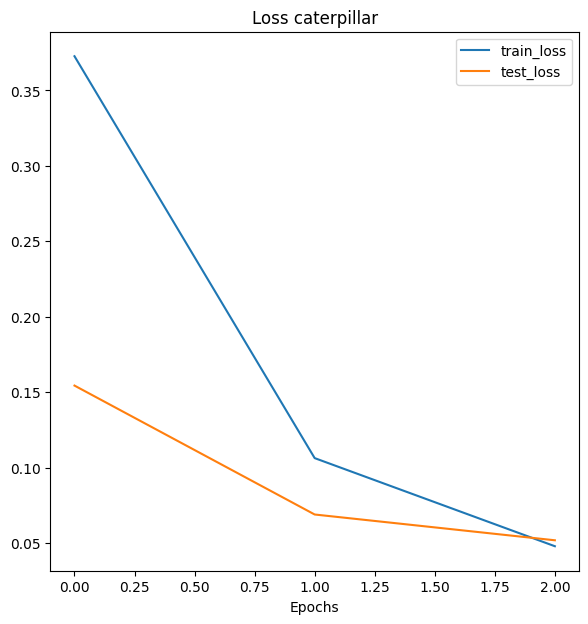

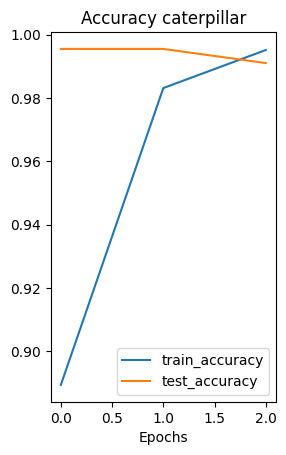

Fold 1
-------
Epoch: 1 | train_loss: 0.3544 | train_acc: 0.9111 | test_loss: 0.2531 | test_acc: 0.9241
Epoch: 2 | train_loss: 0.1129 | train_acc: 0.9712 | test_loss: 0.1478 | test_acc: 0.9554
Epoch: 3 | train_loss: 0.0610 | train_acc: 0.9856 | test_loss: 0.1022 | test_acc: 0.9777


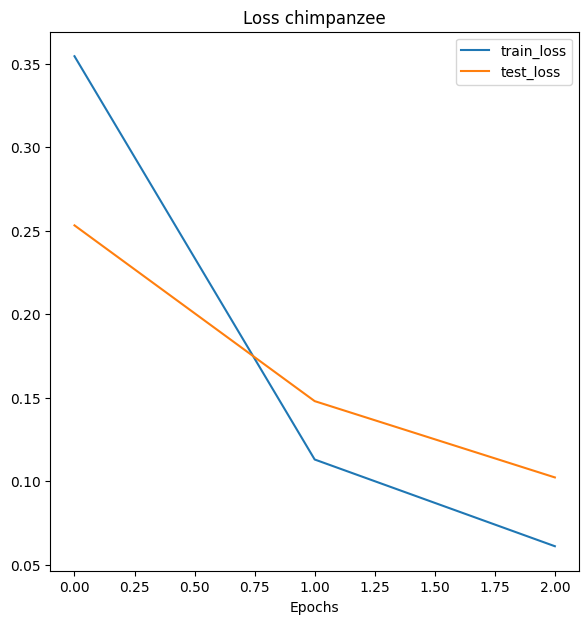

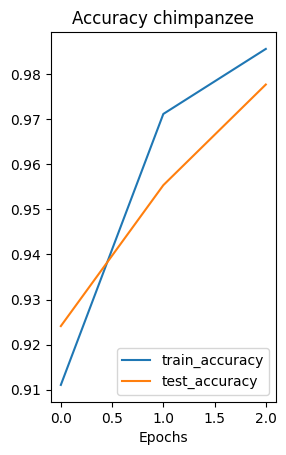

Fold 2
-------
Epoch: 1 | train_loss: 0.3280 | train_acc: 0.9207 | test_loss: 0.1523 | test_acc: 0.9732
Epoch: 2 | train_loss: 0.0736 | train_acc: 0.9832 | test_loss: 0.0977 | test_acc: 0.9732
Epoch: 3 | train_loss: 0.0397 | train_acc: 0.9904 | test_loss: 0.1015 | test_acc: 0.9688


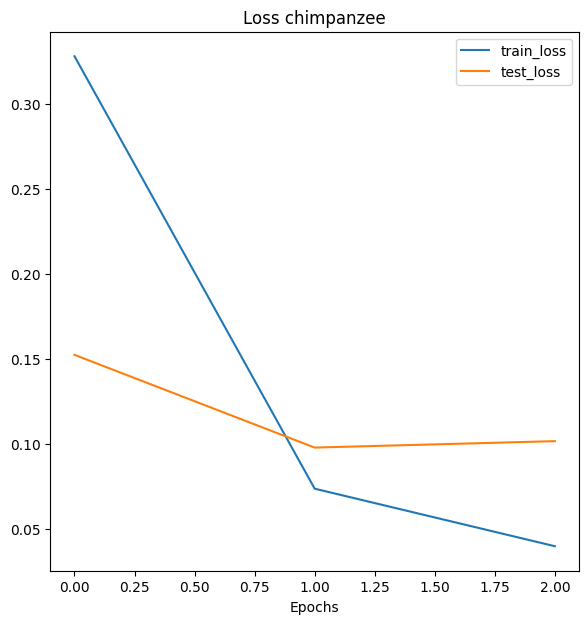

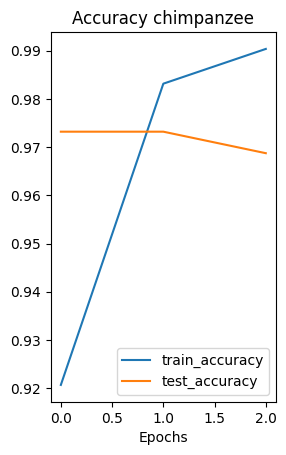

Fold 3
-------
Epoch: 1 | train_loss: 0.3218 | train_acc: 0.9183 | test_loss: 0.1058 | test_acc: 0.9955
Epoch: 2 | train_loss: 0.0840 | train_acc: 0.9808 | test_loss: 0.0434 | test_acc: 1.0000
Epoch: 3 | train_loss: 0.0413 | train_acc: 0.9952 | test_loss: 0.0239 | test_acc: 1.0000


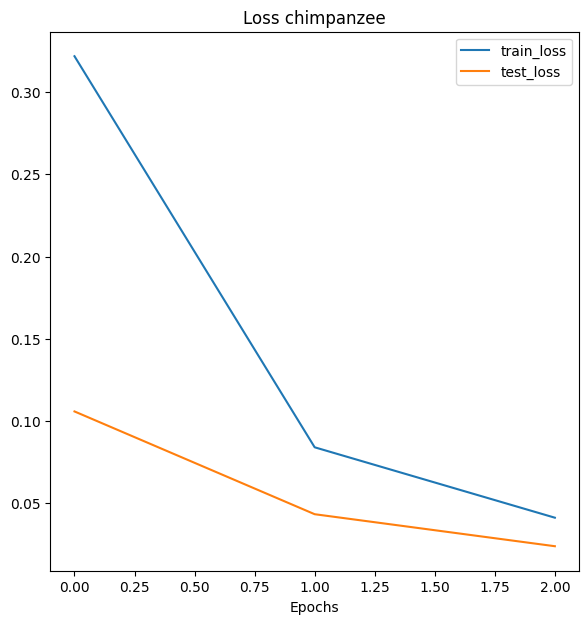

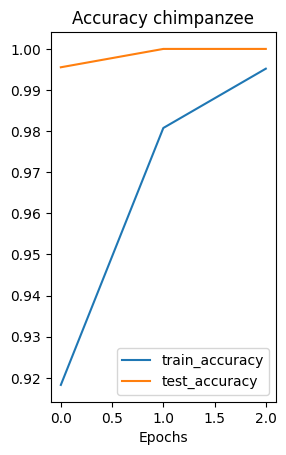

Fold 1
-------
Epoch: 1 | train_loss: 0.3930 | train_acc: 0.9038 | test_loss: 0.2397 | test_acc: 0.9330
Epoch: 2 | train_loss: 0.1227 | train_acc: 0.9808 | test_loss: 0.1086 | test_acc: 0.9732
Epoch: 3 | train_loss: 0.0718 | train_acc: 0.9832 | test_loss: 0.0633 | test_acc: 0.9866


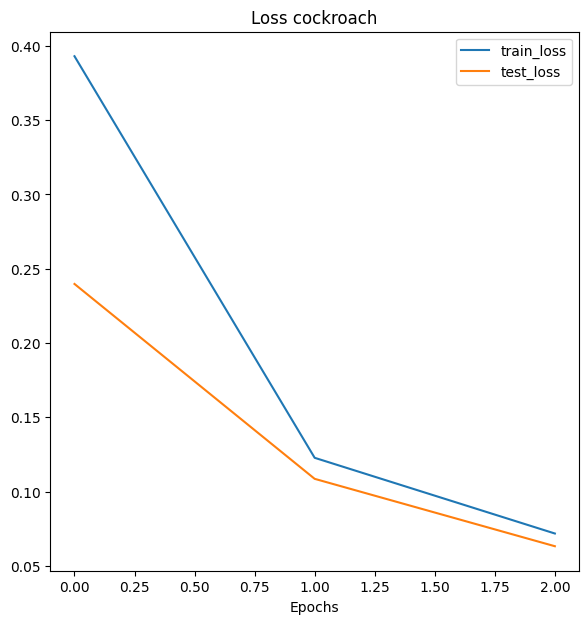

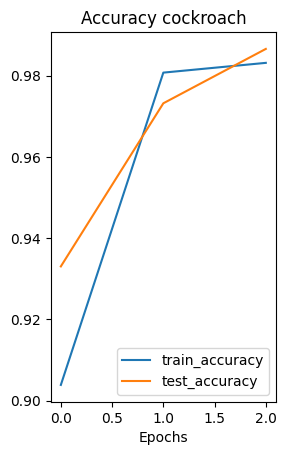

Fold 2
-------
Epoch: 1 | train_loss: 0.3364 | train_acc: 0.9231 | test_loss: 0.1393 | test_acc: 0.9866
Epoch: 2 | train_loss: 0.0901 | train_acc: 0.9880 | test_loss: 0.0623 | test_acc: 0.9955
Epoch: 3 | train_loss: 0.0398 | train_acc: 0.9952 | test_loss: 0.0450 | test_acc: 0.9955


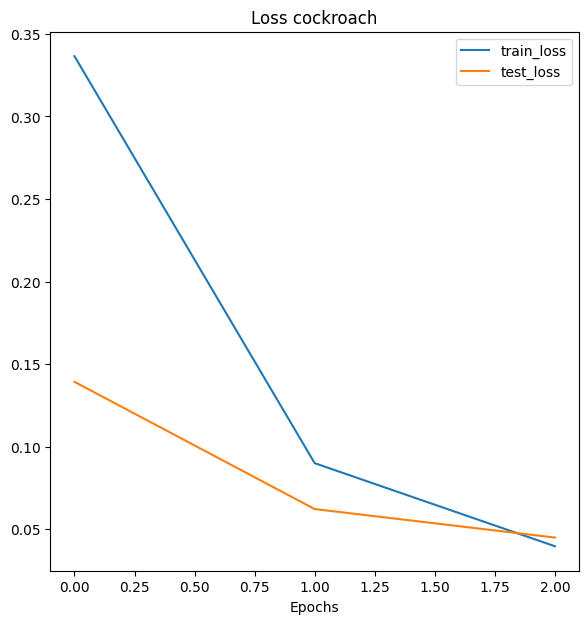

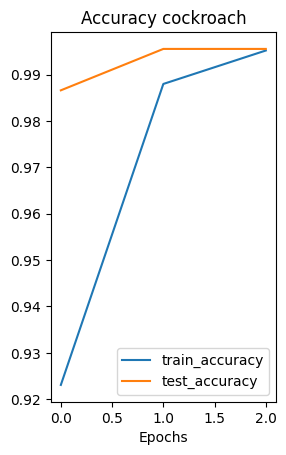

Fold 3
-------
Epoch: 1 | train_loss: 0.3310 | train_acc: 0.9062 | test_loss: 0.1162 | test_acc: 0.9821
Epoch: 2 | train_loss: 0.0745 | train_acc: 0.9928 | test_loss: 0.0459 | test_acc: 0.9866
Epoch: 3 | train_loss: 0.0299 | train_acc: 0.9952 | test_loss: 0.0302 | test_acc: 0.9911


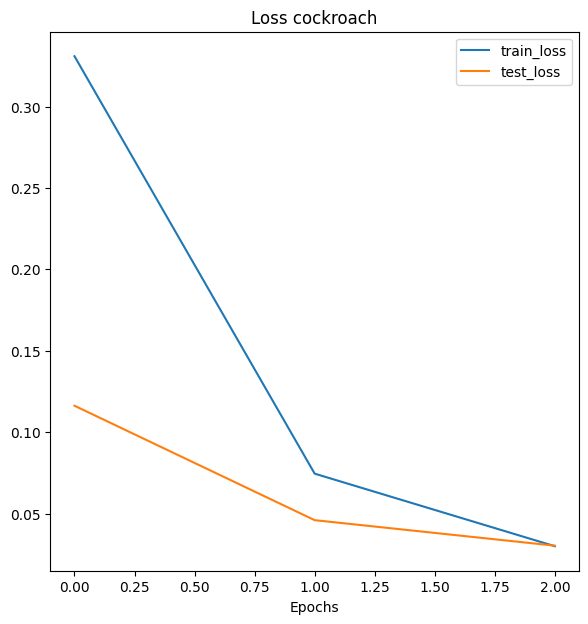

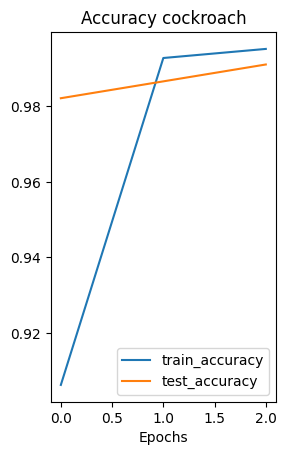

Fold 1
-------
Epoch: 1 | train_loss: 0.4398 | train_acc: 0.8606 | test_loss: 0.3287 | test_acc: 0.8839
Epoch: 2 | train_loss: 0.1549 | train_acc: 0.9712 | test_loss: 0.2169 | test_acc: 0.8929
Epoch: 3 | train_loss: 0.0766 | train_acc: 0.9856 | test_loss: 0.1589 | test_acc: 0.9241


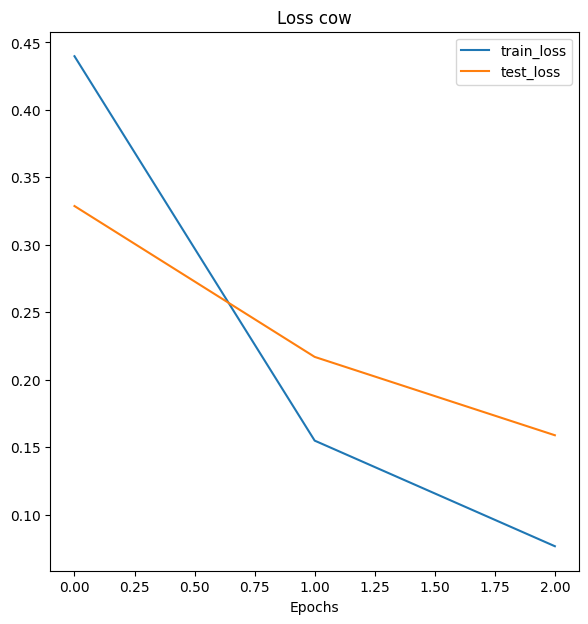

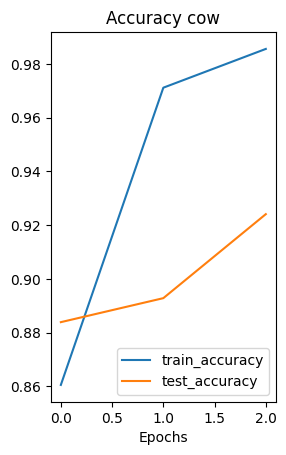

Fold 2
-------
Epoch: 1 | train_loss: 0.3811 | train_acc: 0.8990 | test_loss: 0.1828 | test_acc: 0.9821
Epoch: 2 | train_loss: 0.1298 | train_acc: 0.9712 | test_loss: 0.1110 | test_acc: 0.9732
Epoch: 3 | train_loss: 0.0667 | train_acc: 0.9832 | test_loss: 0.0727 | test_acc: 0.9911


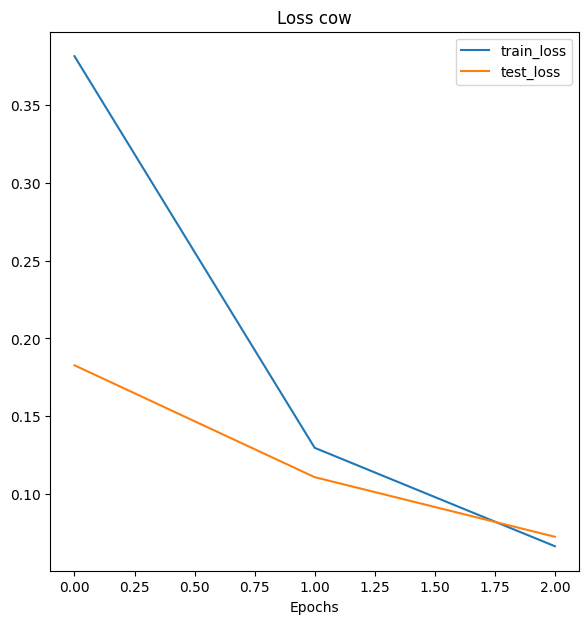

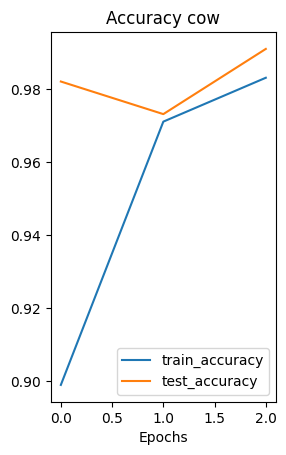

Fold 3
-------
Epoch: 1 | train_loss: 0.3515 | train_acc: 0.9351 | test_loss: 0.1554 | test_acc: 0.9911
Epoch: 2 | train_loss: 0.1029 | train_acc: 0.9784 | test_loss: 0.0734 | test_acc: 0.9911
Epoch: 3 | train_loss: 0.0644 | train_acc: 0.9808 | test_loss: 0.0491 | test_acc: 0.9911


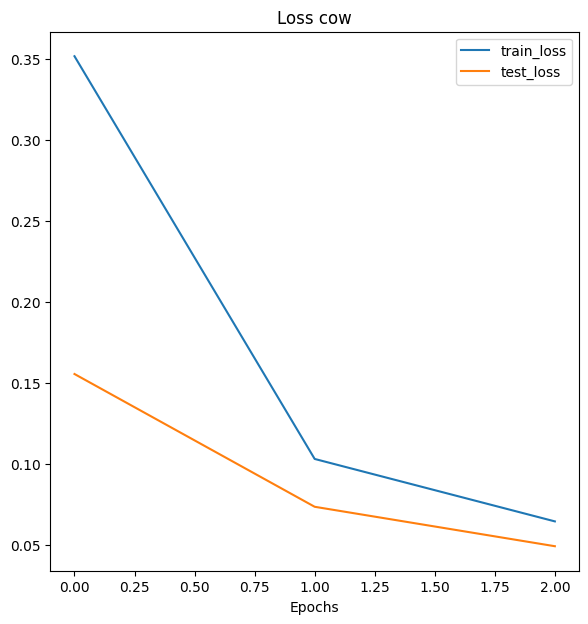

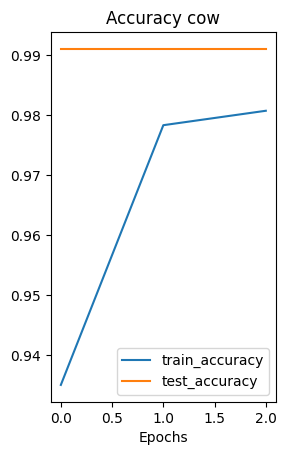

Fold 1
-------
Epoch: 1 | train_loss: 0.4170 | train_acc: 0.8774 | test_loss: 0.2920 | test_acc: 0.9420
Epoch: 2 | train_loss: 0.1552 | train_acc: 0.9663 | test_loss: 0.1792 | test_acc: 0.9598
Epoch: 3 | train_loss: 0.0930 | train_acc: 0.9784 | test_loss: 0.1322 | test_acc: 0.9598


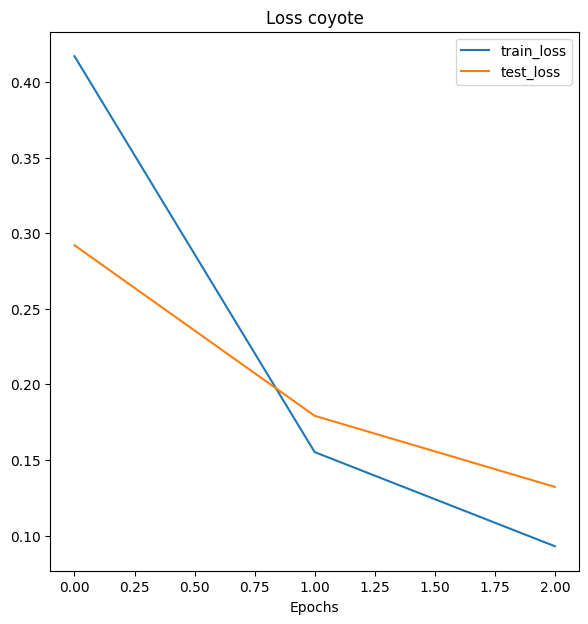

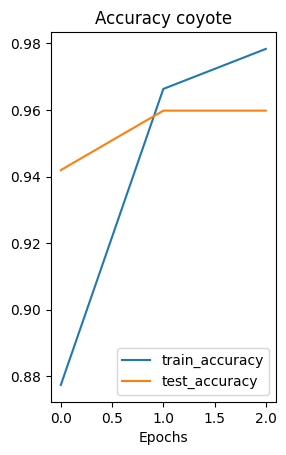

Fold 2
-------
Epoch: 1 | train_loss: 0.3507 | train_acc: 0.9111 | test_loss: 0.1547 | test_acc: 0.9821
Epoch: 2 | train_loss: 0.1077 | train_acc: 0.9784 | test_loss: 0.1010 | test_acc: 0.9821
Epoch: 3 | train_loss: 0.0741 | train_acc: 0.9784 | test_loss: 0.0595 | test_acc: 0.9911


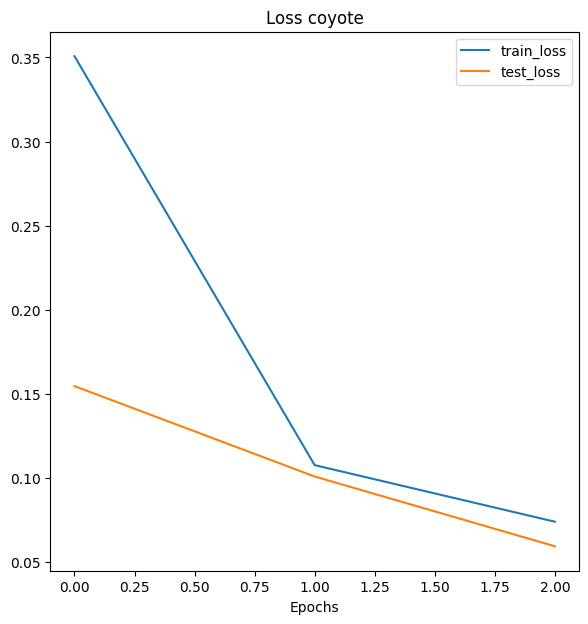

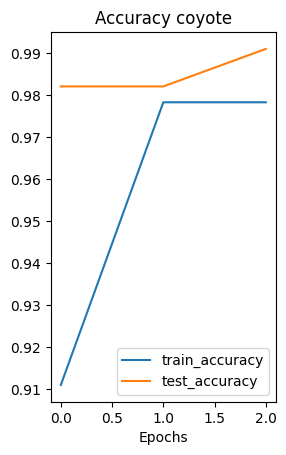

Fold 3
-------
Epoch: 1 | train_loss: 0.3877 | train_acc: 0.8678 | test_loss: 0.1453 | test_acc: 0.9911
Epoch: 2 | train_loss: 0.1185 | train_acc: 0.9688 | test_loss: 0.0697 | test_acc: 0.9911
Epoch: 3 | train_loss: 0.0681 | train_acc: 0.9784 | test_loss: 0.0522 | test_acc: 0.9866


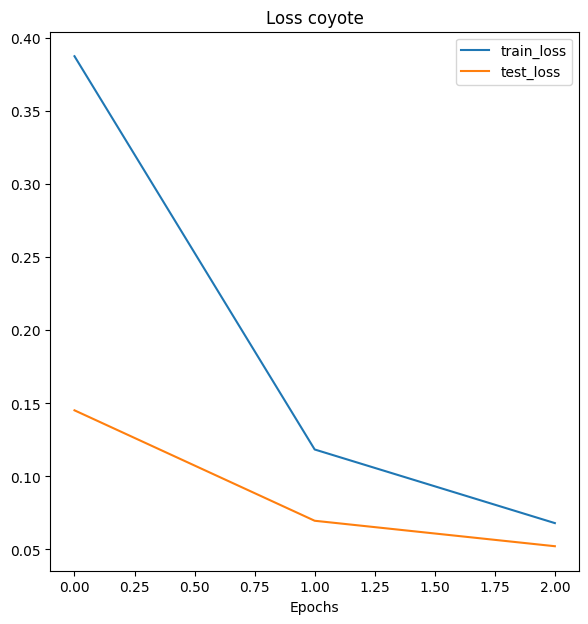

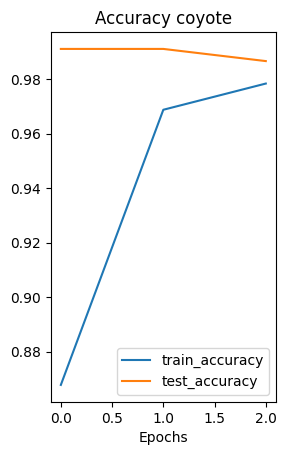

Fold 1
-------
Epoch: 1 | train_loss: 0.4518 | train_acc: 0.8389 | test_loss: 0.2764 | test_acc: 0.9643
Epoch: 2 | train_loss: 0.1568 | train_acc: 0.9712 | test_loss: 0.1197 | test_acc: 0.9866
Epoch: 3 | train_loss: 0.0658 | train_acc: 0.9928 | test_loss: 0.0795 | test_acc: 0.9911


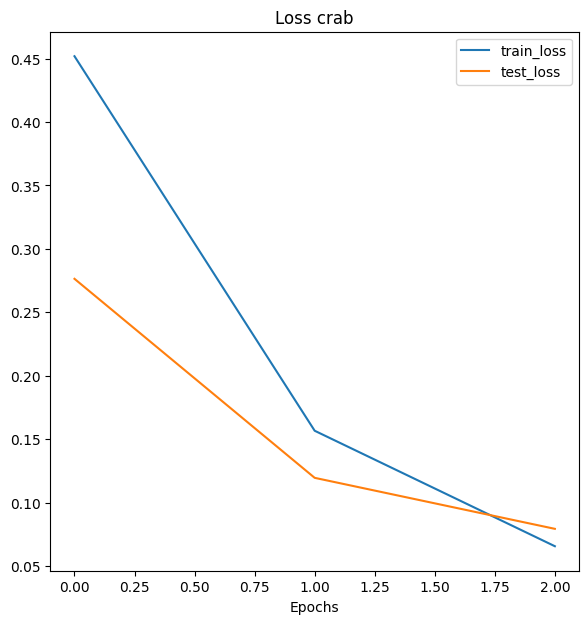

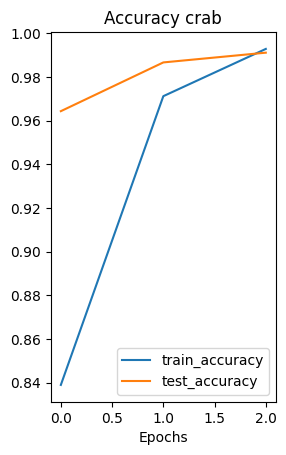

Fold 2
-------
Epoch: 1 | train_loss: 0.3578 | train_acc: 0.9255 | test_loss: 0.1550 | test_acc: 0.9911
Epoch: 2 | train_loss: 0.0898 | train_acc: 0.9904 | test_loss: 0.0678 | test_acc: 0.9955
Epoch: 3 | train_loss: 0.0427 | train_acc: 0.9928 | test_loss: 0.0518 | test_acc: 0.9955


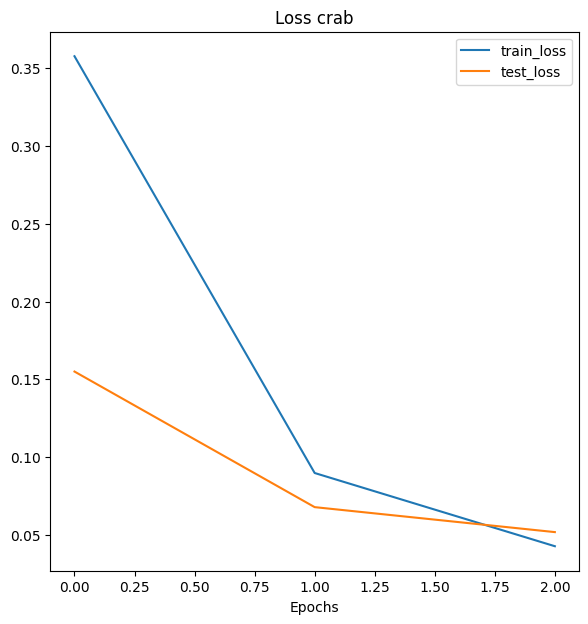

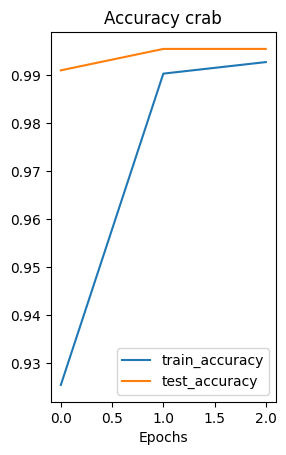

Fold 3
-------
Epoch: 1 | train_loss: 0.3546 | train_acc: 0.9135 | test_loss: 0.1152 | test_acc: 0.9955
Epoch: 2 | train_loss: 0.0859 | train_acc: 0.9880 | test_loss: 0.0472 | test_acc: 0.9955
Epoch: 3 | train_loss: 0.0328 | train_acc: 0.9976 | test_loss: 0.0408 | test_acc: 1.0000


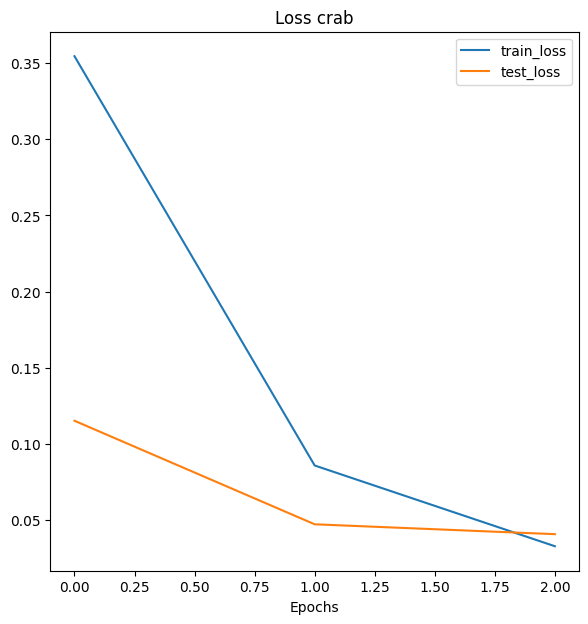

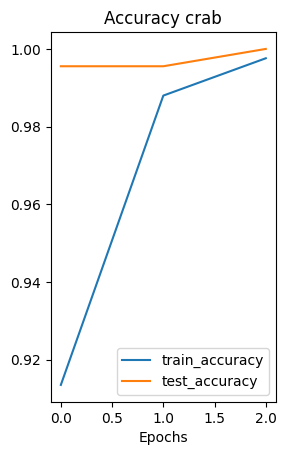

Fold 1
-------
Epoch: 1 | train_loss: 0.4061 | train_acc: 0.8582 | test_loss: 0.2831 | test_acc: 0.9375
Epoch: 2 | train_loss: 0.1203 | train_acc: 0.9856 | test_loss: 0.1414 | test_acc: 0.9777
Epoch: 3 | train_loss: 0.0498 | train_acc: 0.9928 | test_loss: 0.0945 | test_acc: 0.9509


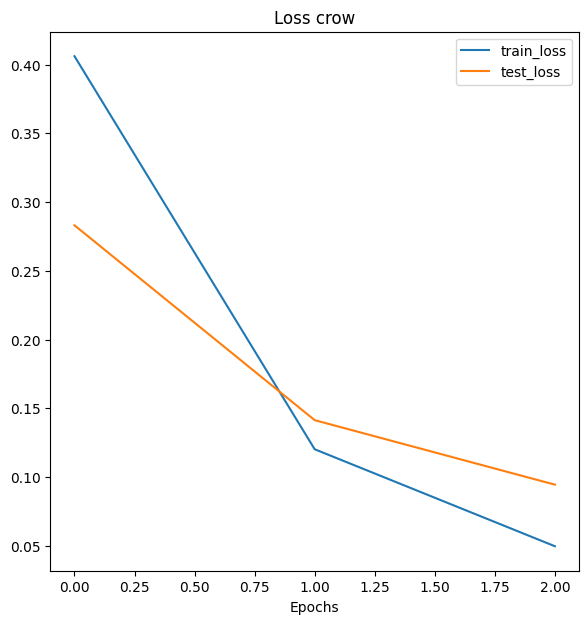

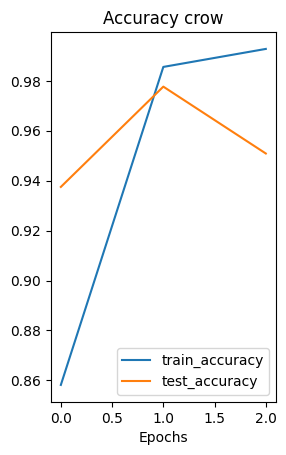

Fold 2
-------
Epoch: 1 | train_loss: 0.3485 | train_acc: 0.9159 | test_loss: 0.1571 | test_acc: 0.9732
Epoch: 2 | train_loss: 0.0844 | train_acc: 0.9904 | test_loss: 0.0752 | test_acc: 0.9821
Epoch: 3 | train_loss: 0.0347 | train_acc: 0.9952 | test_loss: 0.0546 | test_acc: 0.9777


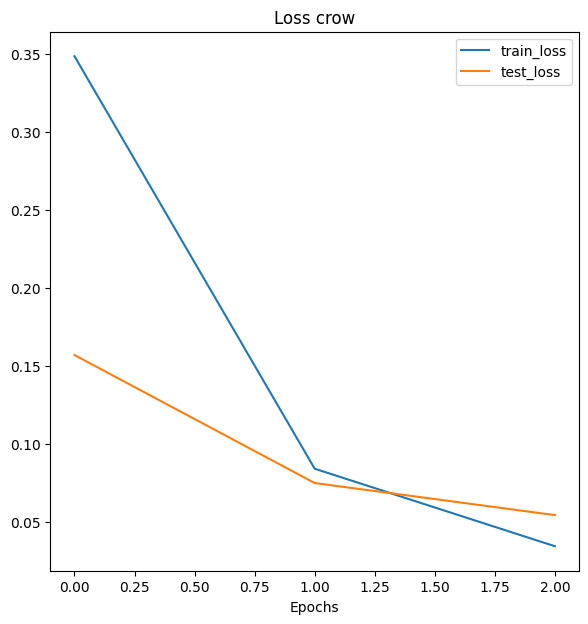

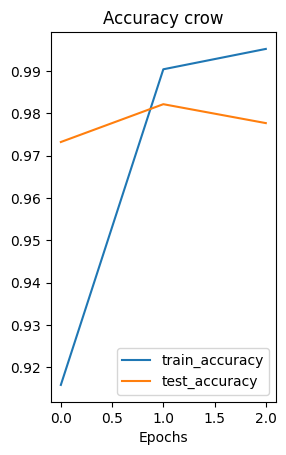

Fold 3
-------
Epoch: 1 | train_loss: 0.3109 | train_acc: 0.9399 | test_loss: 0.0989 | test_acc: 1.0000
Epoch: 2 | train_loss: 0.0614 | train_acc: 0.9952 | test_loss: 0.0429 | test_acc: 1.0000
Epoch: 3 | train_loss: 0.0631 | train_acc: 0.9760 | test_loss: 0.0345 | test_acc: 1.0000


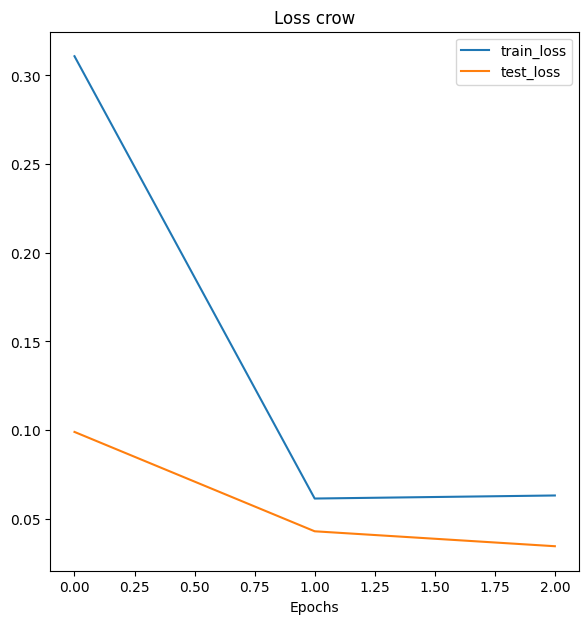

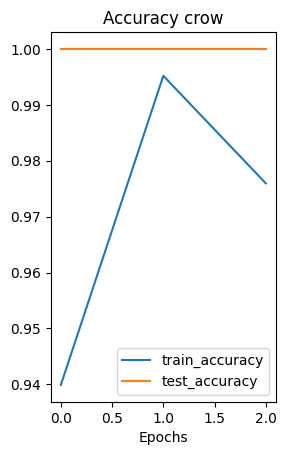

Fold 1
-------
Epoch: 1 | train_loss: 0.4411 | train_acc: 0.8822 | test_loss: 0.3161 | test_acc: 0.9286
Epoch: 2 | train_loss: 0.1673 | train_acc: 0.9615 | test_loss: 0.1850 | test_acc: 0.9598
Epoch: 3 | train_loss: 0.1047 | train_acc: 0.9712 | test_loss: 0.1286 | test_acc: 0.9688


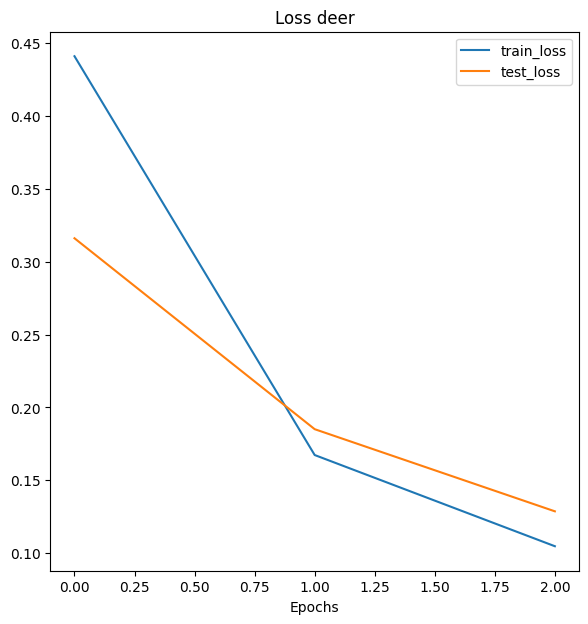

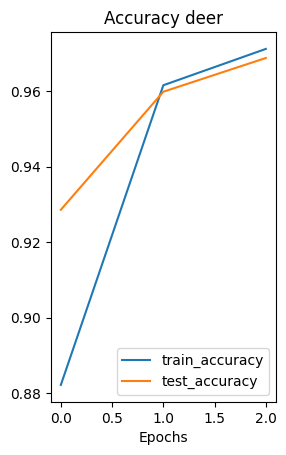

Fold 2
-------
Epoch: 1 | train_loss: 0.3833 | train_acc: 0.8894 | test_loss: 0.1719 | test_acc: 0.9777
Epoch: 2 | train_loss: 0.1287 | train_acc: 0.9736 | test_loss: 0.1010 | test_acc: 0.9732
Epoch: 3 | train_loss: 0.0656 | train_acc: 0.9904 | test_loss: 0.0930 | test_acc: 0.9554


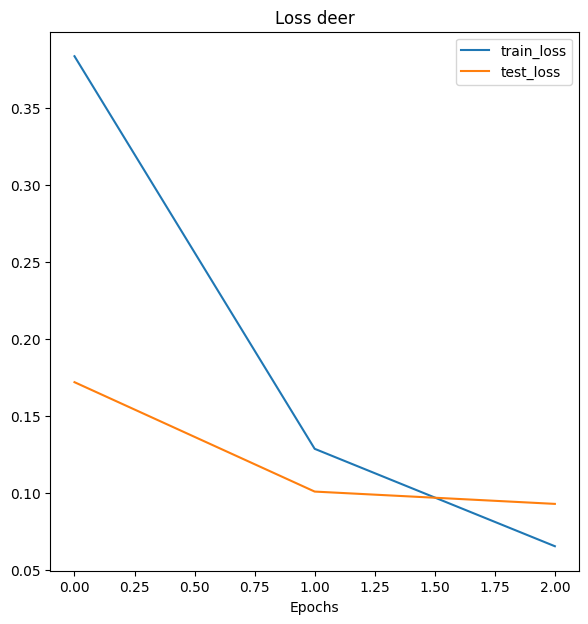

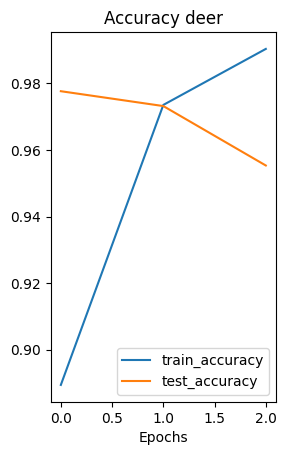

Fold 3
-------
Epoch: 1 | train_loss: 0.3652 | train_acc: 0.9111 | test_loss: 0.1487 | test_acc: 1.0000
Epoch: 2 | train_loss: 0.1189 | train_acc: 0.9808 | test_loss: 0.0712 | test_acc: 0.9955
Epoch: 3 | train_loss: 0.0581 | train_acc: 0.9880 | test_loss: 0.0528 | test_acc: 0.9911


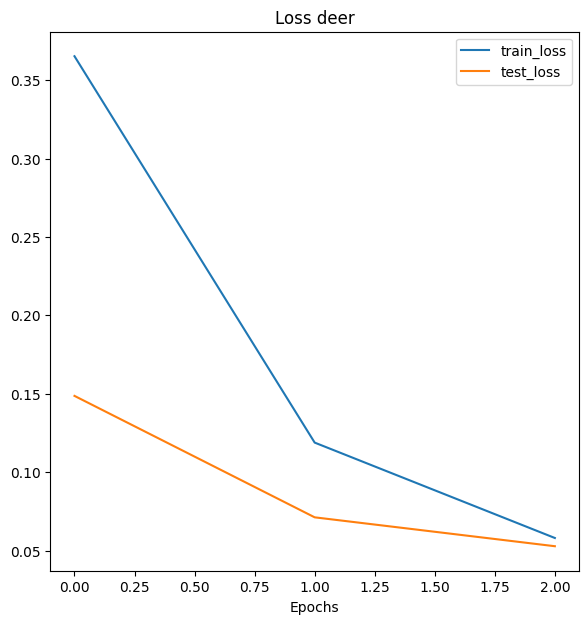

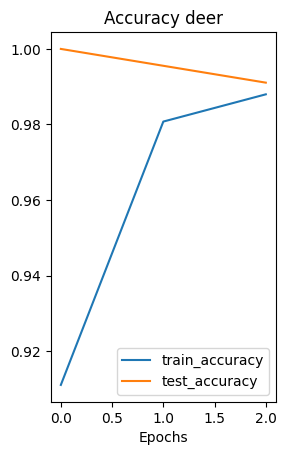

Fold 1
-------
Epoch: 1 | train_loss: 0.4447 | train_acc: 0.8269 | test_loss: 0.2773 | test_acc: 0.9554
Epoch: 2 | train_loss: 0.1778 | train_acc: 0.9688 | test_loss: 0.1390 | test_acc: 0.9866
Epoch: 3 | train_loss: 0.0958 | train_acc: 0.9784 | test_loss: 0.0798 | test_acc: 0.9955


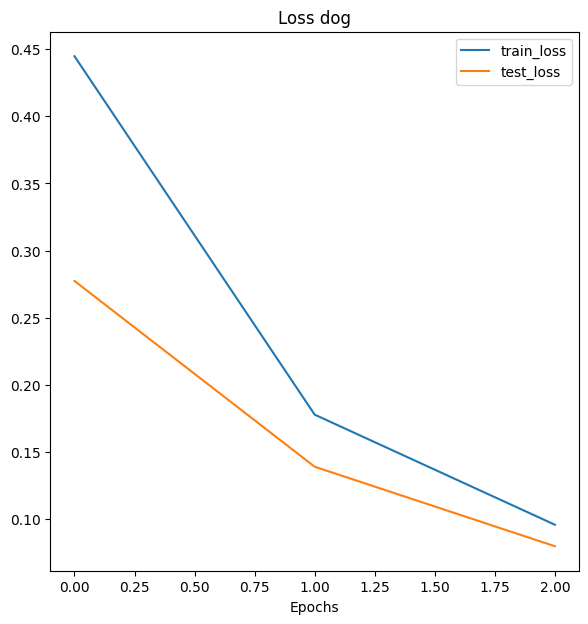

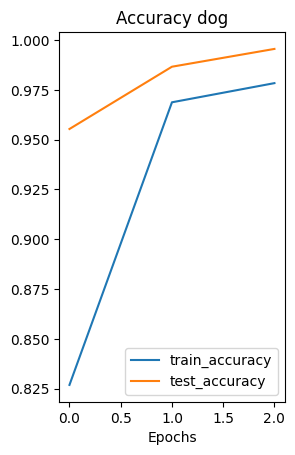

Fold 2
-------
Epoch: 1 | train_loss: 0.3893 | train_acc: 0.9038 | test_loss: 0.2113 | test_acc: 0.9821
Epoch: 2 | train_loss: 0.0974 | train_acc: 0.9856 | test_loss: 0.1077 | test_acc: 0.9777
Epoch: 3 | train_loss: 0.0551 | train_acc: 0.9904 | test_loss: 0.0776 | test_acc: 0.9821


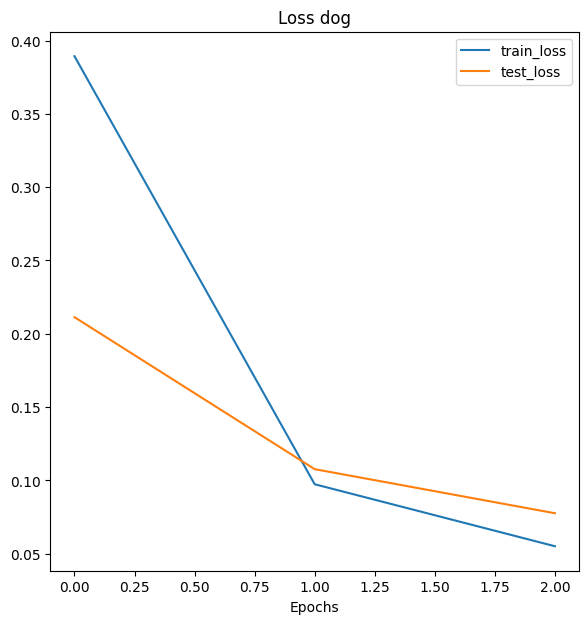

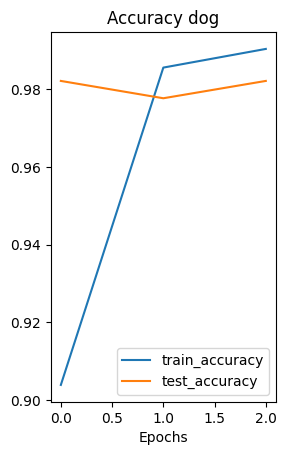

Fold 3
-------
Epoch: 1 | train_loss: 0.3506 | train_acc: 0.9303 | test_loss: 0.1284 | test_acc: 0.9866
Epoch: 2 | train_loss: 0.0787 | train_acc: 0.9952 | test_loss: 0.0589 | test_acc: 0.9911
Epoch: 3 | train_loss: 0.0353 | train_acc: 0.9976 | test_loss: 0.0521 | test_acc: 0.9777


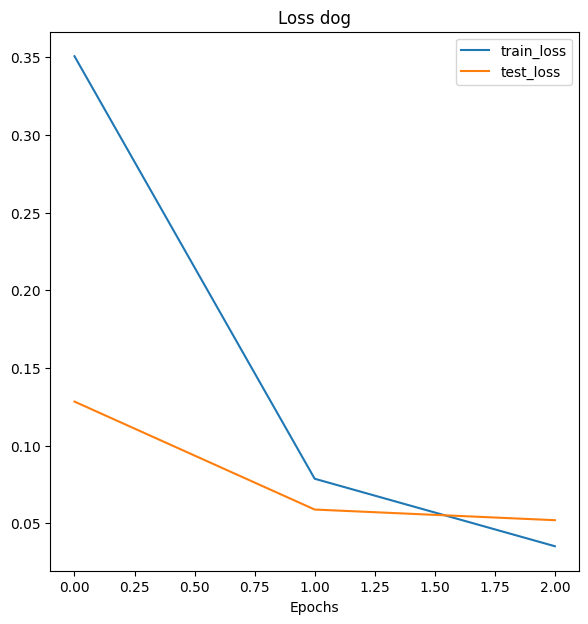

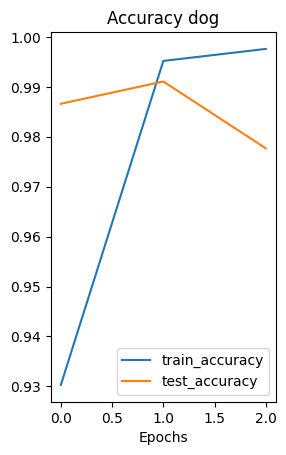

Fold 1
-------
Epoch: 1 | train_loss: 0.4495 | train_acc: 0.8606 | test_loss: 0.2838 | test_acc: 0.9509
Epoch: 2 | train_loss: 0.1607 | train_acc: 0.9663 | test_loss: 0.1683 | test_acc: 0.9688
Epoch: 3 | train_loss: 0.0805 | train_acc: 0.9808 | test_loss: 0.1150 | test_acc: 0.9821


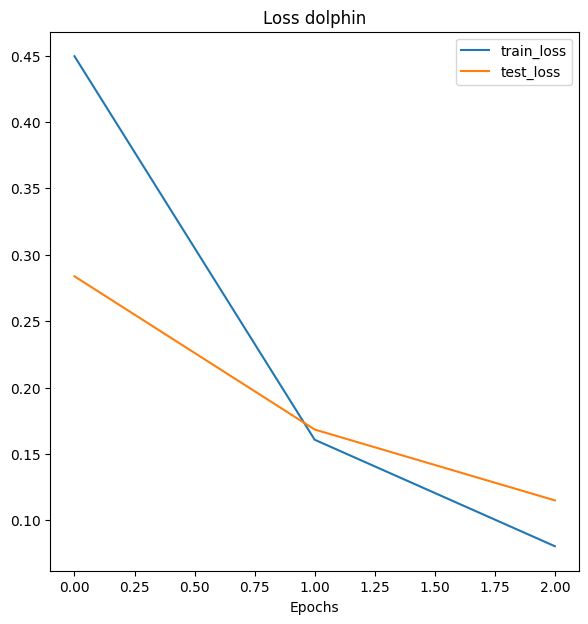

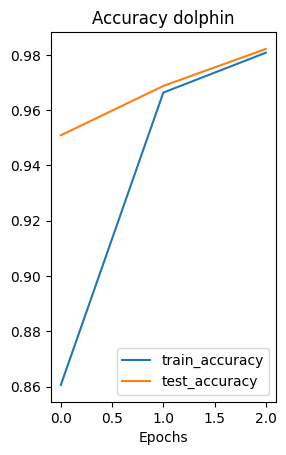

Fold 2
-------
Epoch: 1 | train_loss: 0.3529 | train_acc: 0.9303 | test_loss: 0.1617 | test_acc: 0.9777
Epoch: 2 | train_loss: 0.1072 | train_acc: 0.9832 | test_loss: 0.1060 | test_acc: 0.9643
Epoch: 3 | train_loss: 0.0643 | train_acc: 0.9808 | test_loss: 0.0662 | test_acc: 0.9821


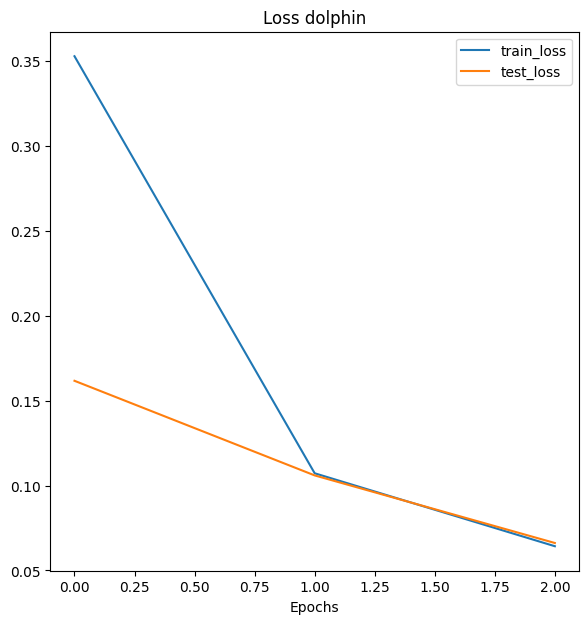

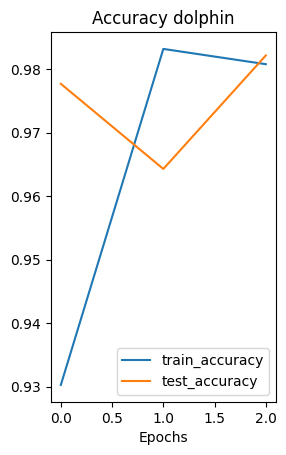

Fold 3
-------
Epoch: 1 | train_loss: 0.3607 | train_acc: 0.8990 | test_loss: 0.1354 | test_acc: 0.9911
Epoch: 2 | train_loss: 0.0945 | train_acc: 0.9880 | test_loss: 0.0586 | test_acc: 0.9955
Epoch: 3 | train_loss: 0.0447 | train_acc: 0.9928 | test_loss: 0.0396 | test_acc: 0.9955


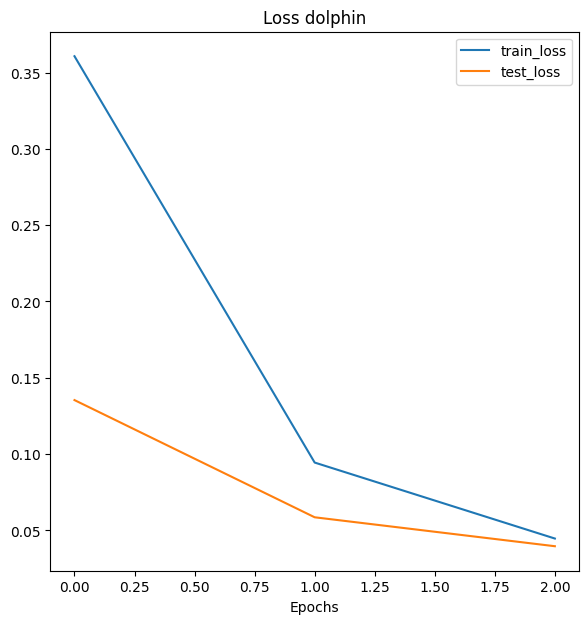

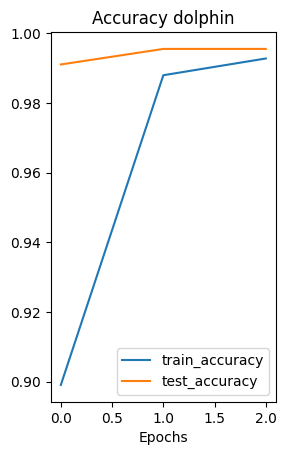

Fold 1
-------
Epoch: 1 | train_loss: 0.4477 | train_acc: 0.8534 | test_loss: 0.2986 | test_acc: 0.9464
Epoch: 2 | train_loss: 0.1873 | train_acc: 0.9639 | test_loss: 0.1874 | test_acc: 0.9509
Epoch: 3 | train_loss: 0.1126 | train_acc: 0.9688 | test_loss: 0.1195 | test_acc: 0.9777


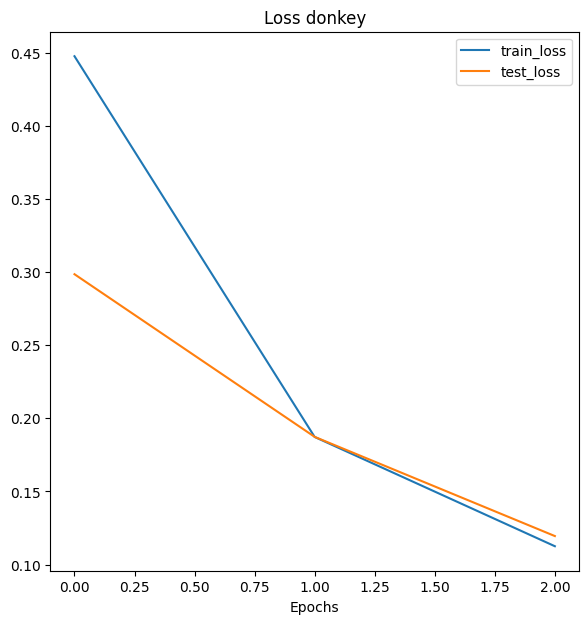

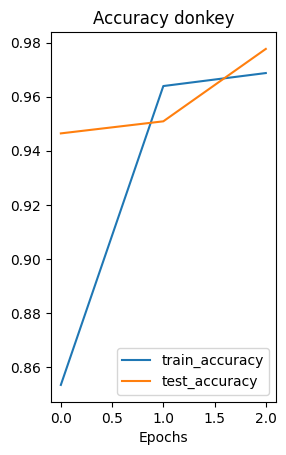

Fold 2
-------
Epoch: 1 | train_loss: 0.4134 | train_acc: 0.8798 | test_loss: 0.2308 | test_acc: 0.9643
Epoch: 2 | train_loss: 0.1277 | train_acc: 0.9736 | test_loss: 0.1256 | test_acc: 0.9732
Epoch: 3 | train_loss: 0.0585 | train_acc: 0.9928 | test_loss: 0.0960 | test_acc: 0.9732


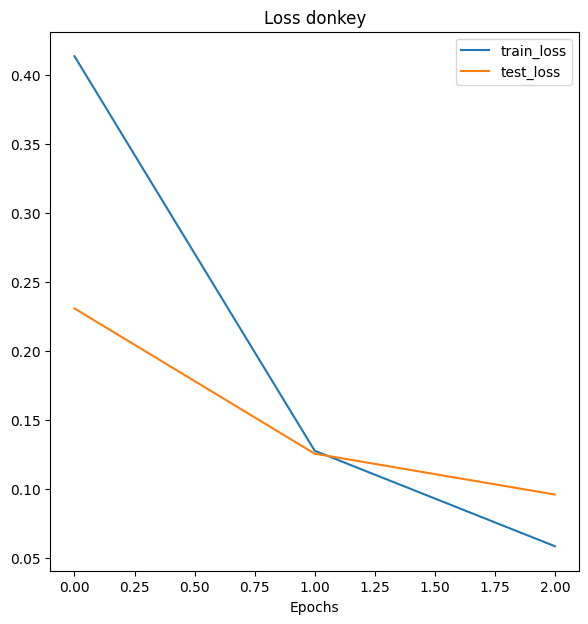

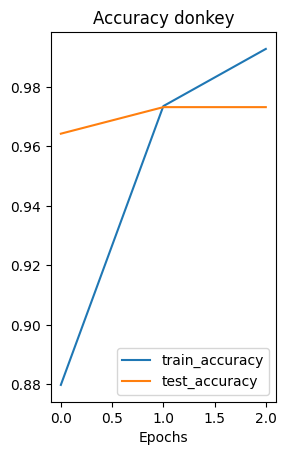

Fold 3
-------
Epoch: 1 | train_loss: 0.3962 | train_acc: 0.8798 | test_loss: 0.1822 | test_acc: 0.9911
Epoch: 2 | train_loss: 0.1255 | train_acc: 0.9808 | test_loss: 0.0835 | test_acc: 0.9911
Epoch: 3 | train_loss: 0.0700 | train_acc: 0.9904 | test_loss: 0.0653 | test_acc: 0.9911


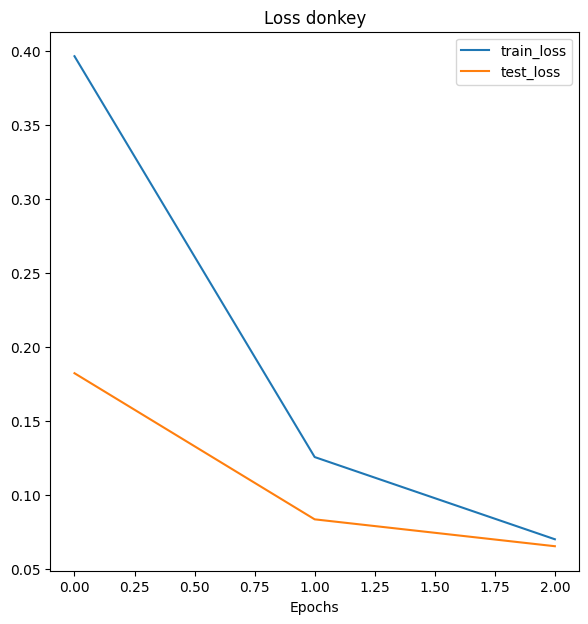

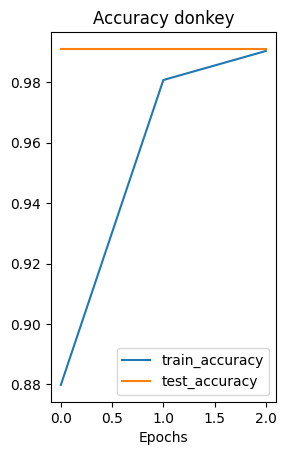

Fold 1
-------
Epoch: 1 | train_loss: 0.4218 | train_acc: 0.8558 | test_loss: 0.2681 | test_acc: 0.9286
Epoch: 2 | train_loss: 0.1404 | train_acc: 0.9712 | test_loss: 0.1633 | test_acc: 0.9643
Epoch: 3 | train_loss: 0.0711 | train_acc: 0.9856 | test_loss: 0.1261 | test_acc: 0.9554


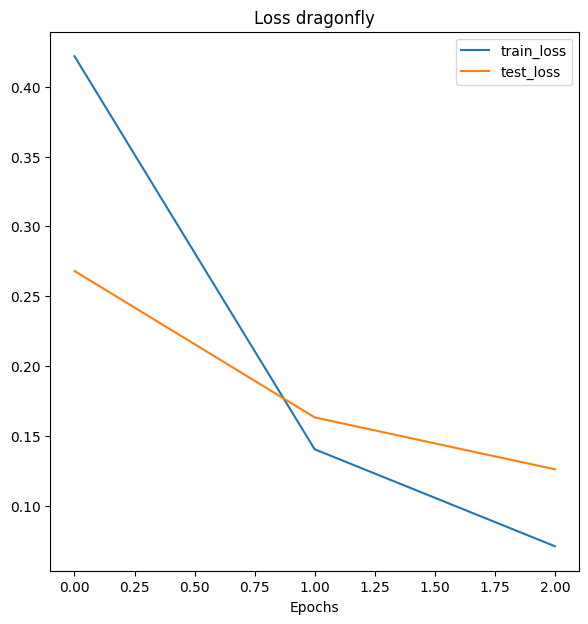

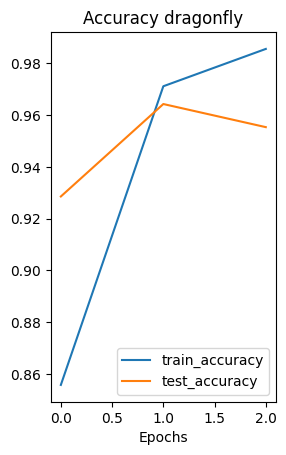

Fold 2
-------
Epoch: 1 | train_loss: 0.3279 | train_acc: 0.9447 | test_loss: 0.1359 | test_acc: 0.9911
Epoch: 2 | train_loss: 0.0933 | train_acc: 0.9904 | test_loss: 0.0650 | test_acc: 0.9955
Epoch: 3 | train_loss: 0.0496 | train_acc: 0.9928 | test_loss: 0.0591 | test_acc: 0.9955


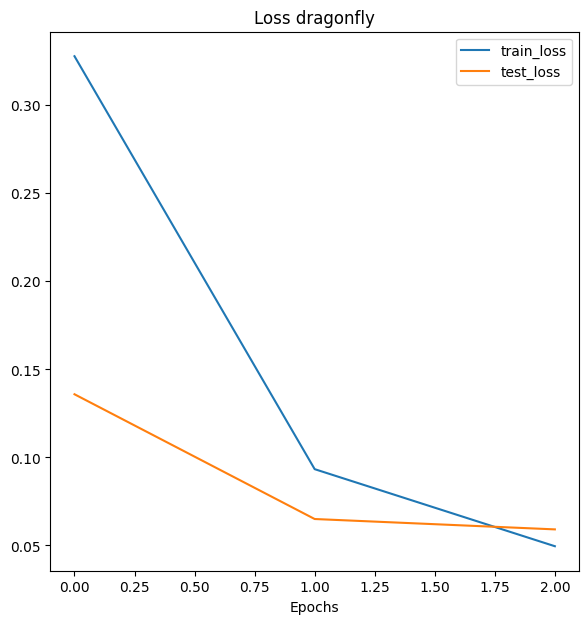

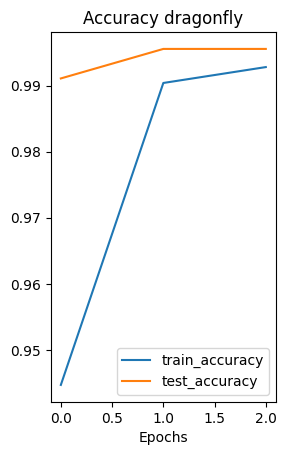

Fold 3
-------
Epoch: 1 | train_loss: 0.3112 | train_acc: 0.9375 | test_loss: 0.1150 | test_acc: 1.0000
Epoch: 2 | train_loss: 0.0877 | train_acc: 0.9856 | test_loss: 0.0434 | test_acc: 0.9955
Epoch: 3 | train_loss: 0.0608 | train_acc: 0.9808 | test_loss: 0.0279 | test_acc: 1.0000


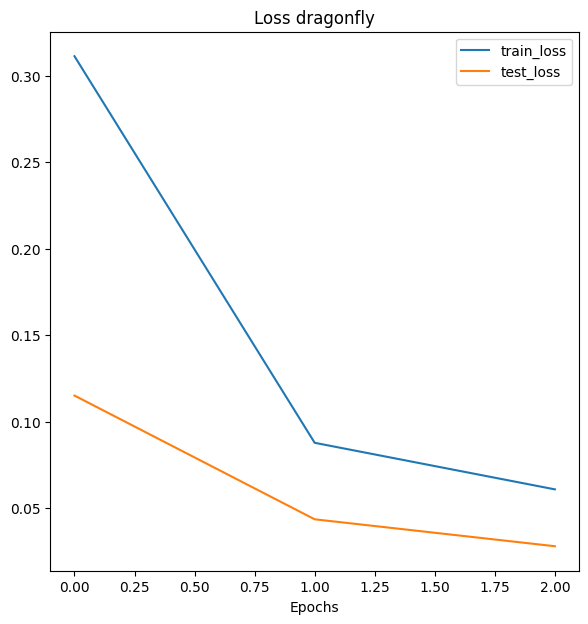

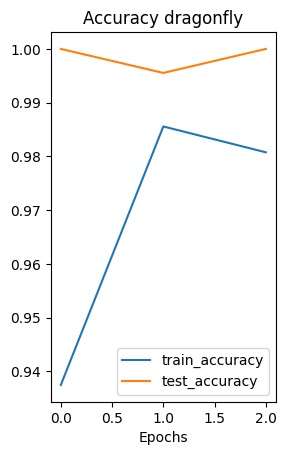

Fold 1
-------
Epoch: 1 | train_loss: 0.4692 | train_acc: 0.8269 | test_loss: 0.3130 | test_acc: 0.9196
Epoch: 2 | train_loss: 0.2036 | train_acc: 0.9495 | test_loss: 0.1925 | test_acc: 0.9554
Epoch: 3 | train_loss: 0.1119 | train_acc: 0.9688 | test_loss: 0.1387 | test_acc: 0.9866


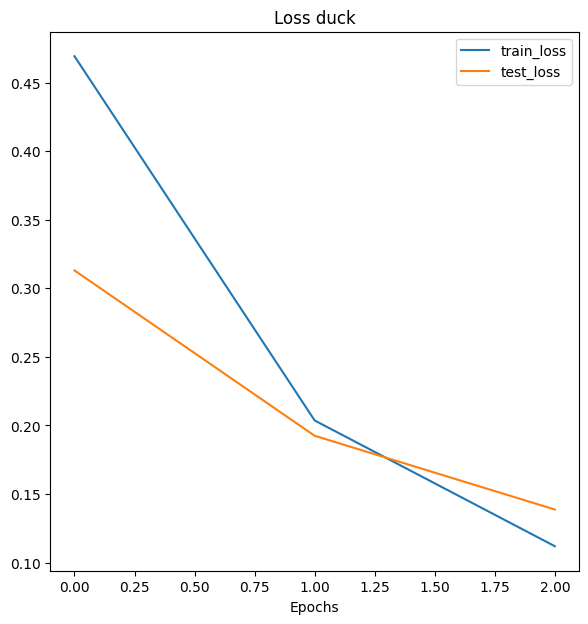

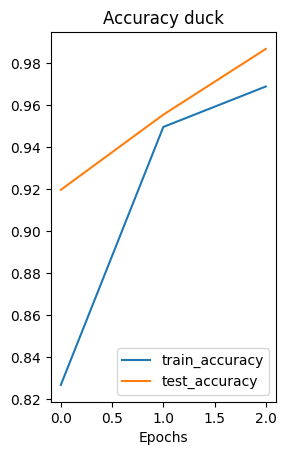

Fold 2
-------
Epoch: 1 | train_loss: 0.4179 | train_acc: 0.8582 | test_loss: 0.2137 | test_acc: 0.9777
Epoch: 2 | train_loss: 0.1679 | train_acc: 0.9543 | test_loss: 0.1268 | test_acc: 0.9598
Epoch: 3 | train_loss: 0.0745 | train_acc: 0.9928 | test_loss: 0.0754 | test_acc: 0.9911


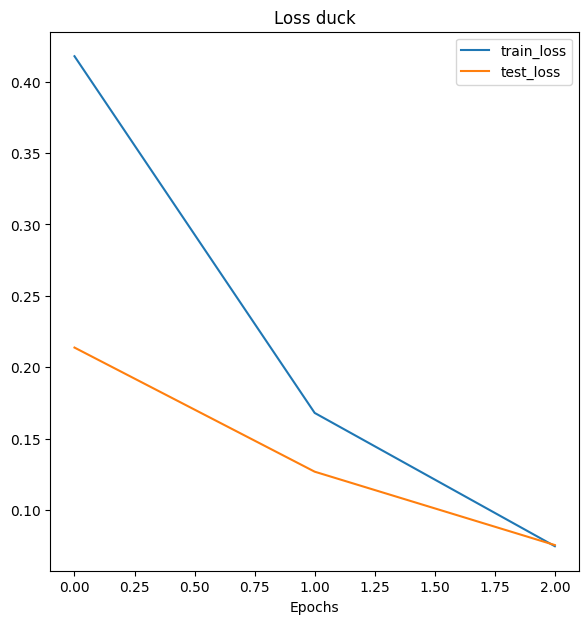

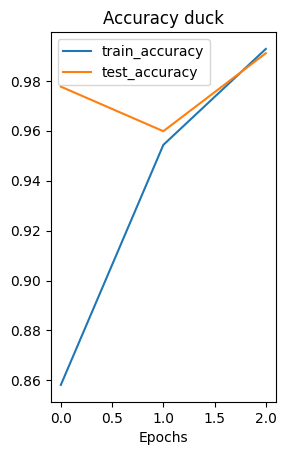

Fold 3
-------
Epoch: 1 | train_loss: 0.3705 | train_acc: 0.9135 | test_loss: 0.1763 | test_acc: 0.9688
Epoch: 2 | train_loss: 0.1111 | train_acc: 0.9880 | test_loss: 0.0967 | test_acc: 0.9732
Epoch: 3 | train_loss: 0.0626 | train_acc: 0.9880 | test_loss: 0.0794 | test_acc: 0.9777


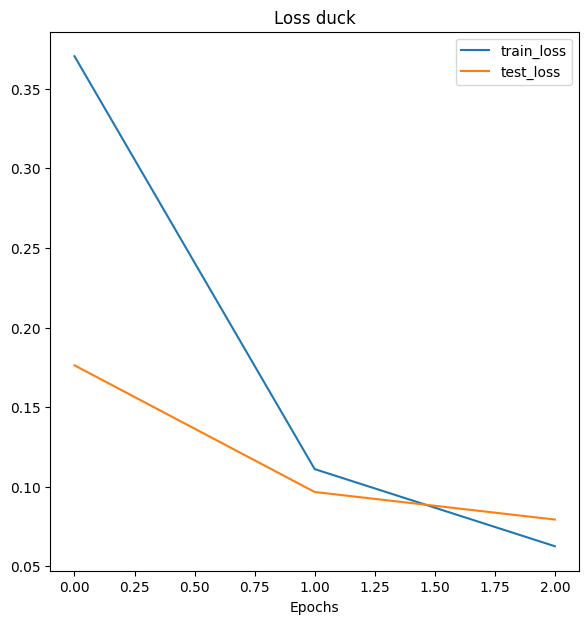

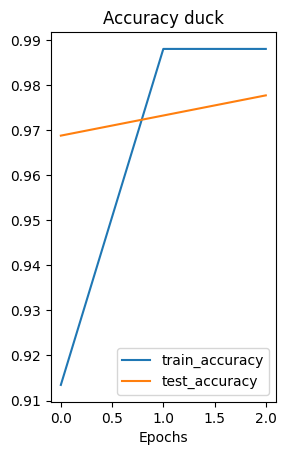

Fold 1
-------
Epoch: 1 | train_loss: 0.3792 | train_acc: 0.8942 | test_loss: 0.3201 | test_acc: 0.9107
Epoch: 2 | train_loss: 0.1237 | train_acc: 0.9760 | test_loss: 0.1976 | test_acc: 0.9286
Epoch: 3 | train_loss: 0.0572 | train_acc: 0.9952 | test_loss: 0.1893 | test_acc: 0.9241


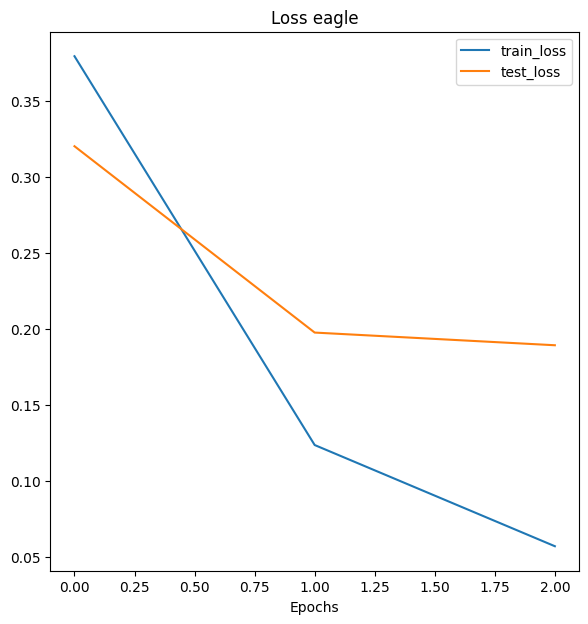

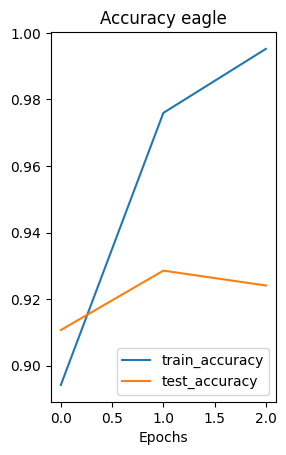

Fold 2
-------
Epoch: 1 | train_loss: 0.3816 | train_acc: 0.8750 | test_loss: 0.1522 | test_acc: 1.0000
Epoch: 2 | train_loss: 0.1045 | train_acc: 0.9760 | test_loss: 0.0575 | test_acc: 1.0000
Epoch: 3 | train_loss: 0.0519 | train_acc: 0.9928 | test_loss: 0.0357 | test_acc: 1.0000


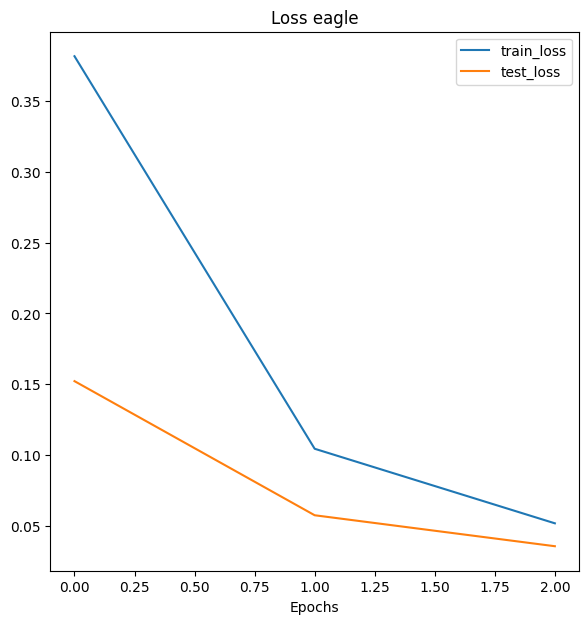

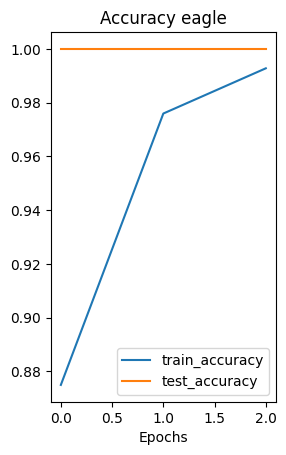

Fold 3
-------
Epoch: 1 | train_loss: 0.3016 | train_acc: 0.9591 | test_loss: 0.0876 | test_acc: 0.9955
Epoch: 2 | train_loss: 0.0690 | train_acc: 0.9928 | test_loss: 0.0452 | test_acc: 0.9955
Epoch: 3 | train_loss: 0.0396 | train_acc: 0.9904 | test_loss: 0.0269 | test_acc: 0.9911


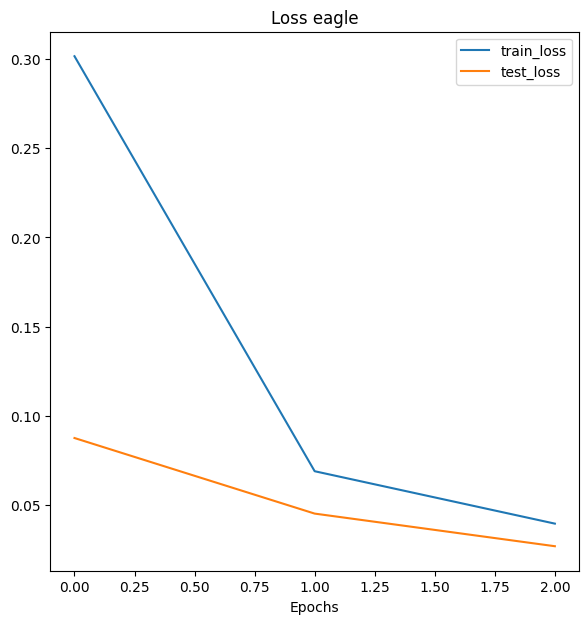

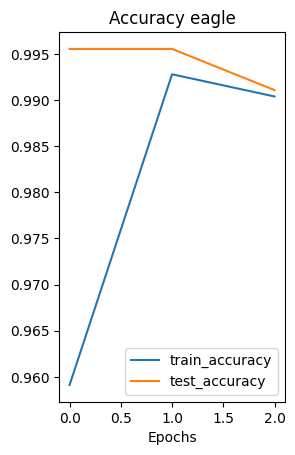

Fold 1
-------
Epoch: 1 | train_loss: 0.4282 | train_acc: 0.8750 | test_loss: 0.2602 | test_acc: 0.9643
Epoch: 2 | train_loss: 0.1283 | train_acc: 0.9784 | test_loss: 0.1267 | test_acc: 0.9821
Epoch: 3 | train_loss: 0.0541 | train_acc: 0.9952 | test_loss: 0.0805 | test_acc: 0.9911


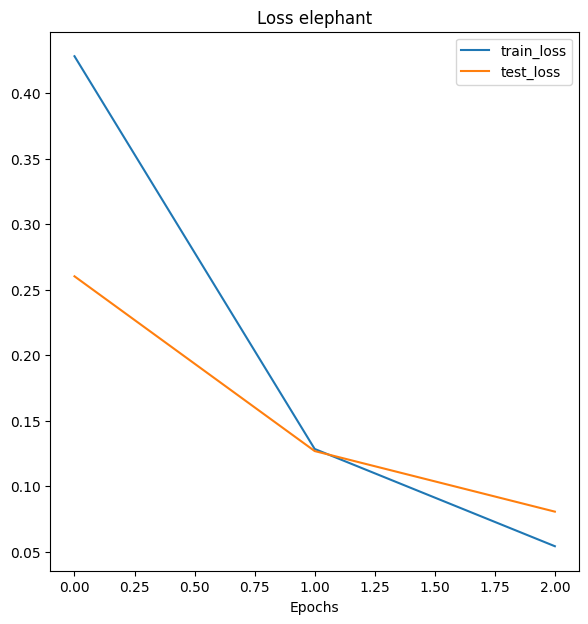

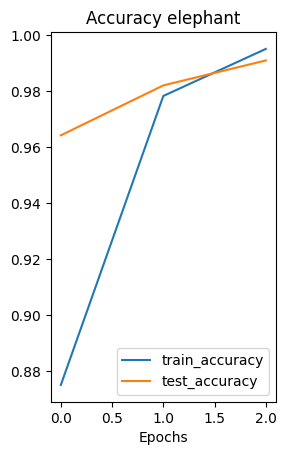

Fold 2
-------
Epoch: 1 | train_loss: 0.3339 | train_acc: 0.9447 | test_loss: 0.1525 | test_acc: 0.9955
Epoch: 2 | train_loss: 0.0865 | train_acc: 0.9952 | test_loss: 0.0737 | test_acc: 0.9911
Epoch: 3 | train_loss: 0.0396 | train_acc: 0.9952 | test_loss: 0.0446 | test_acc: 0.9955


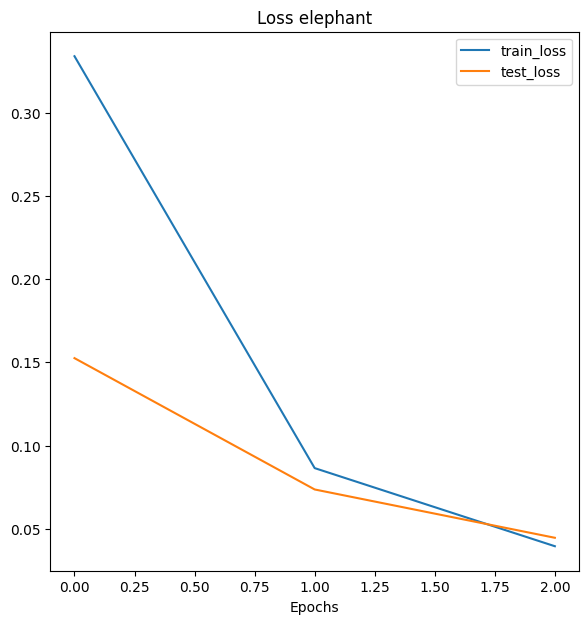

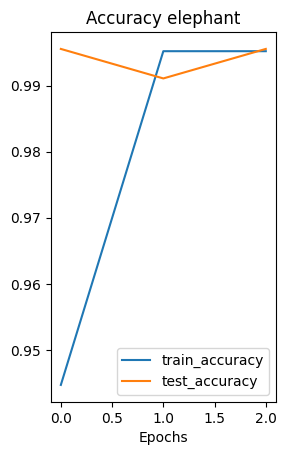

Fold 3
-------
Epoch: 1 | train_loss: 0.3362 | train_acc: 0.9207 | test_loss: 0.1156 | test_acc: 0.9955
Epoch: 2 | train_loss: 0.0736 | train_acc: 0.9904 | test_loss: 0.0423 | test_acc: 0.9955
Epoch: 3 | train_loss: 0.0340 | train_acc: 0.9976 | test_loss: 0.0272 | test_acc: 0.9955


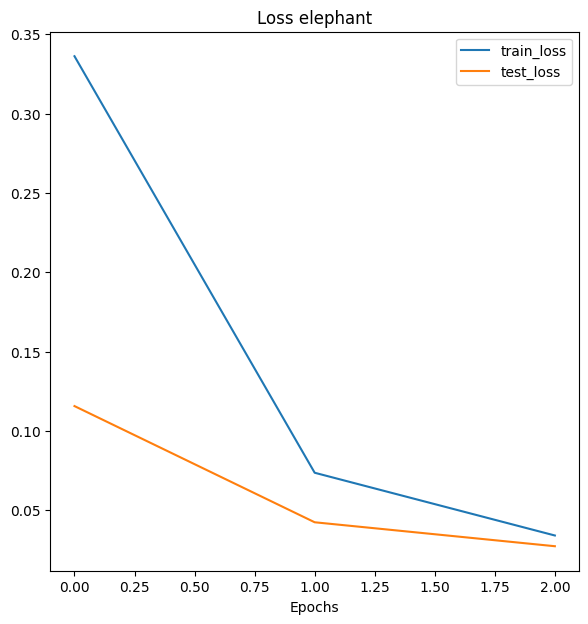

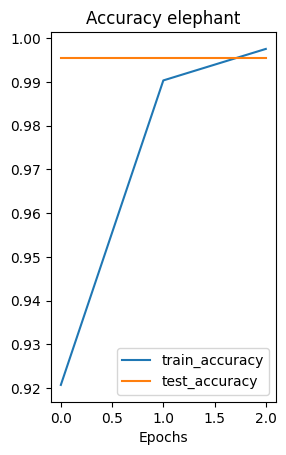

Fold 1
-------
Epoch: 1 | train_loss: 0.4211 | train_acc: 0.8846 | test_loss: 0.2480 | test_acc: 0.9821
Epoch: 2 | train_loss: 0.1392 | train_acc: 0.9832 | test_loss: 0.1080 | test_acc: 0.9911
Epoch: 3 | train_loss: 0.0610 | train_acc: 0.9976 | test_loss: 0.0663 | test_acc: 0.9911


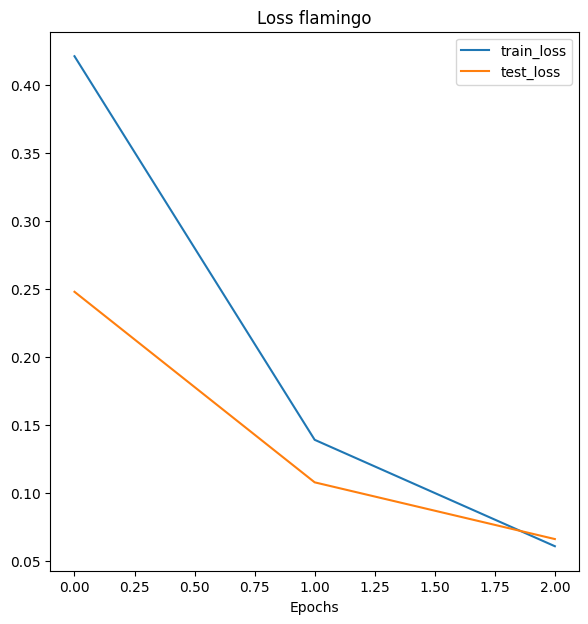

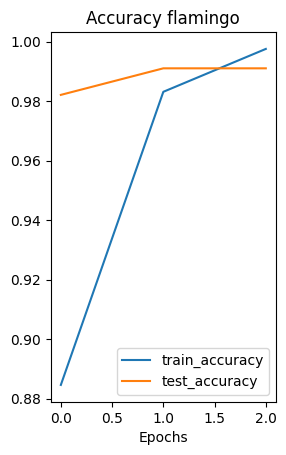

Fold 2
-------
Epoch: 1 | train_loss: 0.3539 | train_acc: 0.9303 | test_loss: 0.1647 | test_acc: 0.9688
Epoch: 2 | train_loss: 0.0873 | train_acc: 0.9880 | test_loss: 0.0815 | test_acc: 0.9911
Epoch: 3 | train_loss: 0.0377 | train_acc: 0.9976 | test_loss: 0.0562 | test_acc: 0.9955


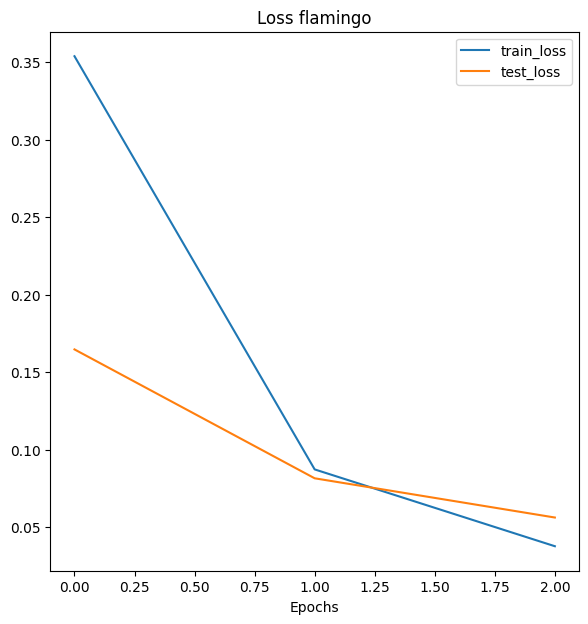

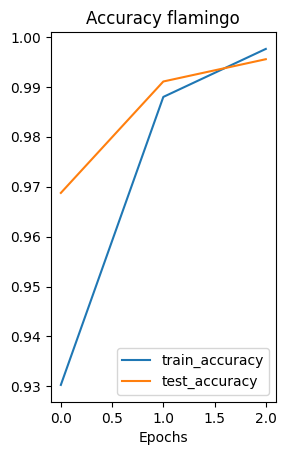

Fold 3
-------
Epoch: 1 | train_loss: 0.2896 | train_acc: 0.9712 | test_loss: 0.1011 | test_acc: 1.0000
Epoch: 2 | train_loss: 0.0597 | train_acc: 0.9928 | test_loss: 0.0447 | test_acc: 1.0000
Epoch: 3 | train_loss: 0.0286 | train_acc: 0.9976 | test_loss: 0.0321 | test_acc: 1.0000


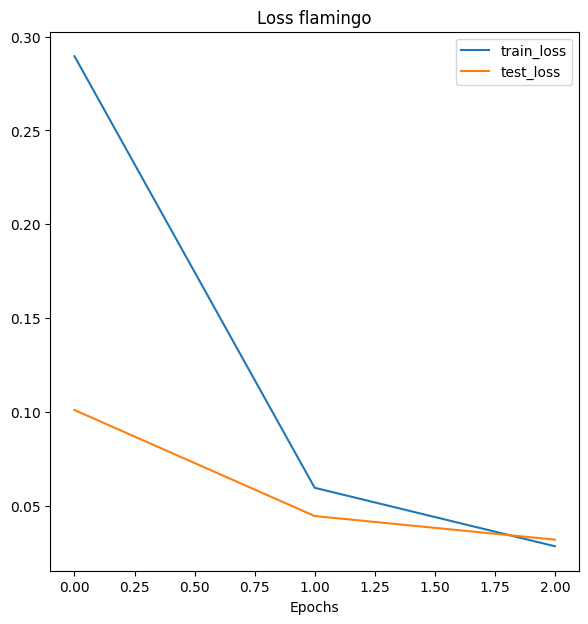

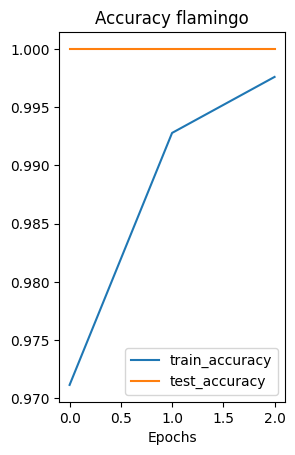

Fold 1
-------
Epoch: 1 | train_loss: 0.4181 | train_acc: 0.8774 | test_loss: 0.2874 | test_acc: 0.9062
Epoch: 2 | train_loss: 0.1457 | train_acc: 0.9567 | test_loss: 0.1640 | test_acc: 0.9509
Epoch: 3 | train_loss: 0.1023 | train_acc: 0.9688 | test_loss: 0.1285 | test_acc: 0.9598


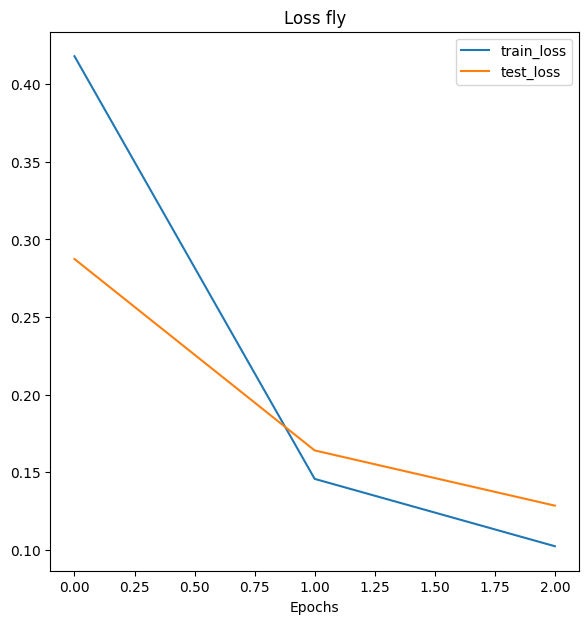

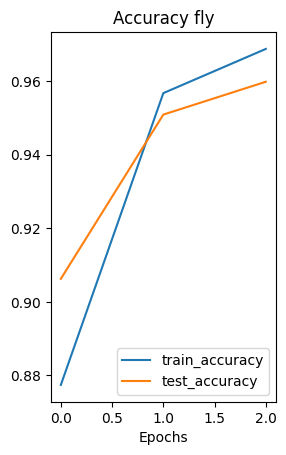

Fold 2
-------
Epoch: 1 | train_loss: 0.3979 | train_acc: 0.8846 | test_loss: 0.2163 | test_acc: 0.9420
Epoch: 2 | train_loss: 0.1082 | train_acc: 0.9784 | test_loss: 0.1236 | test_acc: 0.9554
Epoch: 3 | train_loss: 0.0660 | train_acc: 0.9832 | test_loss: 0.0828 | test_acc: 0.9732


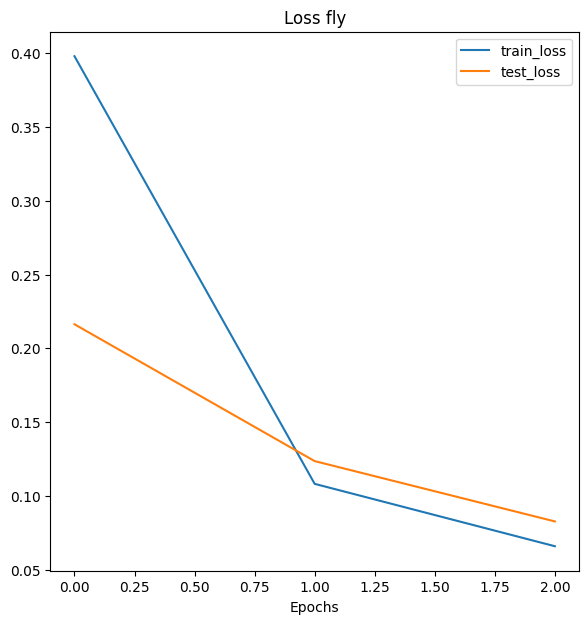

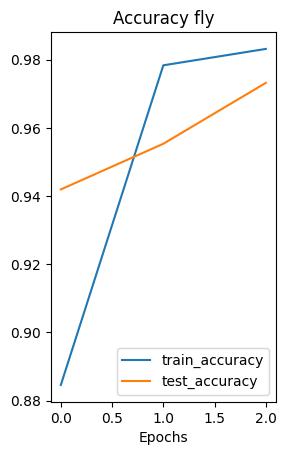

Fold 3
-------
Epoch: 1 | train_loss: 0.3297 | train_acc: 0.9303 | test_loss: 0.1196 | test_acc: 0.9821
Epoch: 2 | train_loss: 0.0848 | train_acc: 0.9904 | test_loss: 0.0529 | test_acc: 0.9821
Epoch: 3 | train_loss: 0.0404 | train_acc: 0.9952 | test_loss: 0.0427 | test_acc: 0.9821


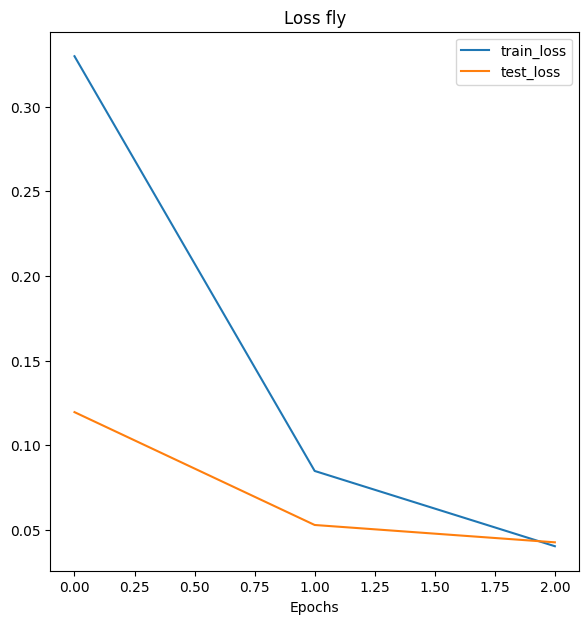

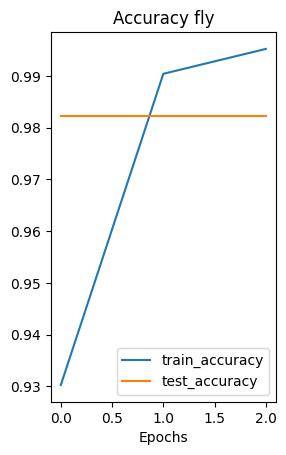

Fold 1
-------
Epoch: 1 | train_loss: 0.3982 | train_acc: 0.8966 | test_loss: 0.2647 | test_acc: 0.9286
Epoch: 2 | train_loss: 0.1461 | train_acc: 0.9688 | test_loss: 0.1392 | test_acc: 0.9688
Epoch: 3 | train_loss: 0.0661 | train_acc: 0.9880 | test_loss: 0.1025 | test_acc: 0.9777


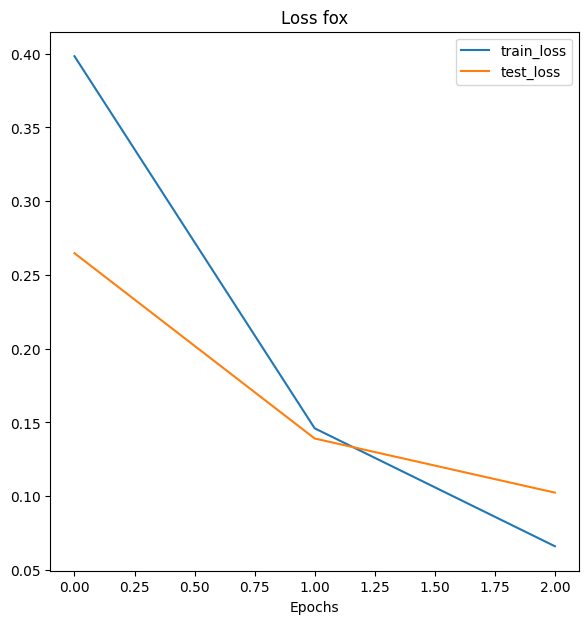

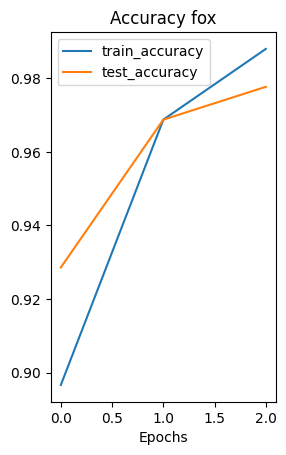

Fold 2
-------
Epoch: 1 | train_loss: 0.3752 | train_acc: 0.8966 | test_loss: 0.1478 | test_acc: 0.9911
Epoch: 2 | train_loss: 0.1138 | train_acc: 0.9663 | test_loss: 0.0737 | test_acc: 0.9911
Epoch: 3 | train_loss: 0.0580 | train_acc: 0.9880 | test_loss: 0.0439 | test_acc: 1.0000


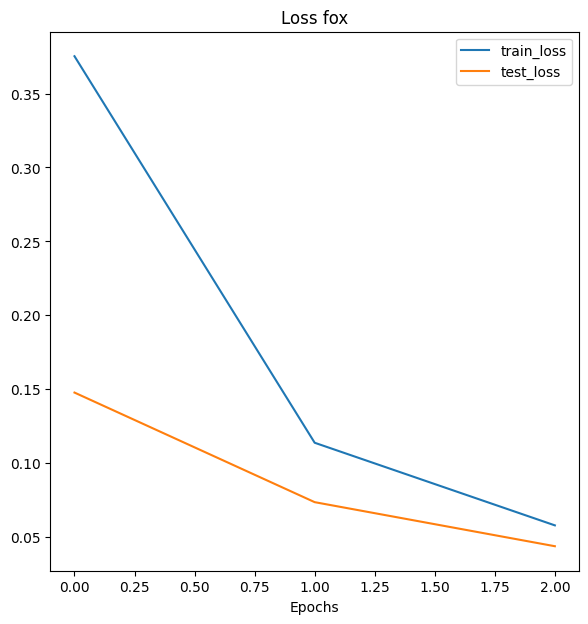

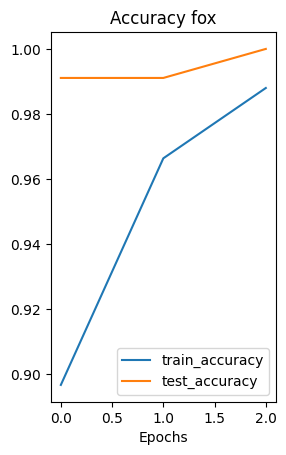

Fold 3
-------
Epoch: 1 | train_loss: 0.3428 | train_acc: 0.9087 | test_loss: 0.1149 | test_acc: 1.0000
Epoch: 2 | train_loss: 0.0730 | train_acc: 0.9880 | test_loss: 0.0471 | test_acc: 0.9955
Epoch: 3 | train_loss: 0.0359 | train_acc: 0.9928 | test_loss: 0.0324 | test_acc: 0.9955


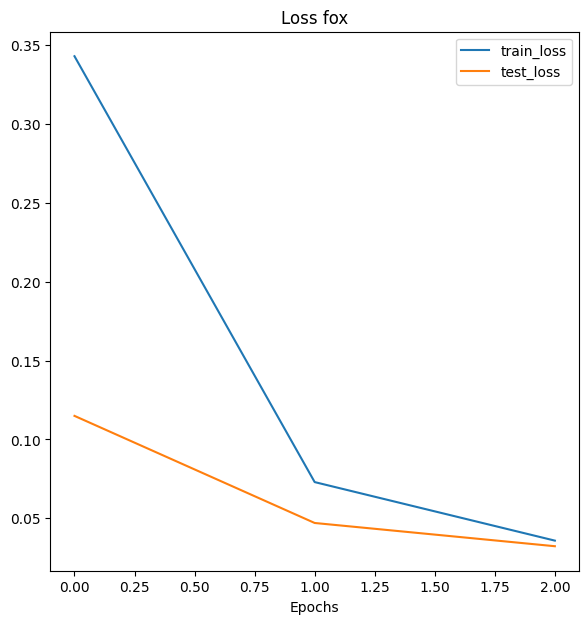

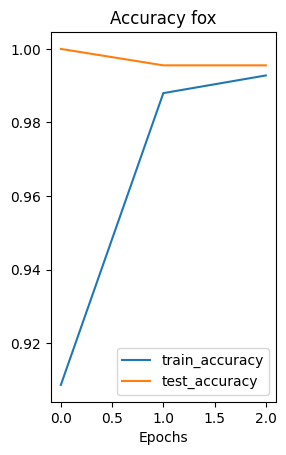

Fold 1
-------
Epoch: 1 | train_loss: 0.4473 | train_acc: 0.8413 | test_loss: 0.3267 | test_acc: 0.9241
Epoch: 2 | train_loss: 0.1842 | train_acc: 0.9519 | test_loss: 0.1788 | test_acc: 0.9375
Epoch: 3 | train_loss: 0.0897 | train_acc: 0.9832 | test_loss: 0.1350 | test_acc: 0.9420


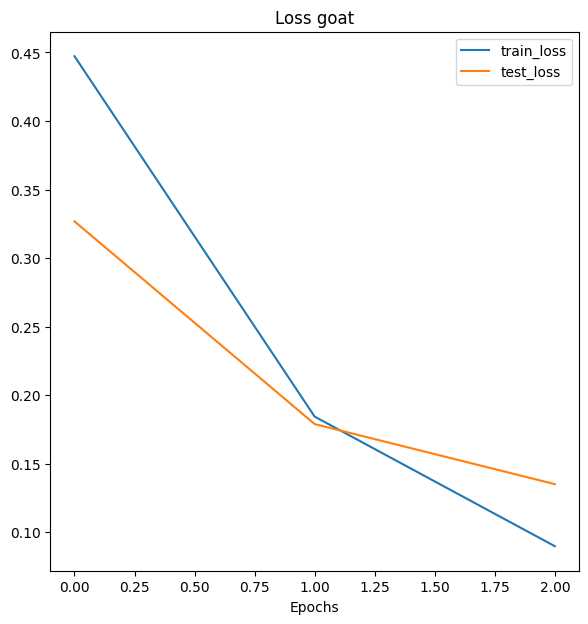

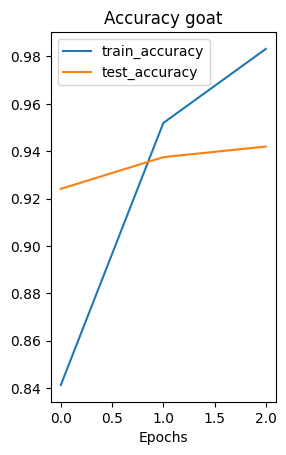

Fold 2
-------
Epoch: 1 | train_loss: 0.4230 | train_acc: 0.8486 | test_loss: 0.2154 | test_acc: 0.9643
Epoch: 2 | train_loss: 0.1313 | train_acc: 0.9808 | test_loss: 0.1156 | test_acc: 0.9732
Epoch: 3 | train_loss: 0.0782 | train_acc: 0.9760 | test_loss: 0.0821 | test_acc: 0.9777


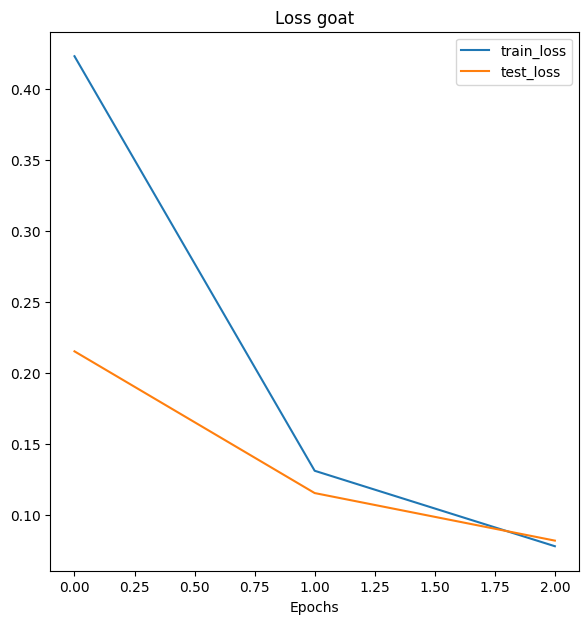

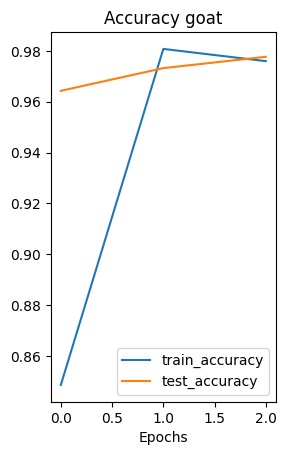

Fold 3
-------
Epoch: 1 | train_loss: 0.3370 | train_acc: 0.9351 | test_loss: 0.1610 | test_acc: 0.9732
Epoch: 2 | train_loss: 0.1202 | train_acc: 0.9615 | test_loss: 0.0956 | test_acc: 0.9688
Epoch: 3 | train_loss: 0.0584 | train_acc: 0.9928 | test_loss: 0.0773 | test_acc: 0.9777


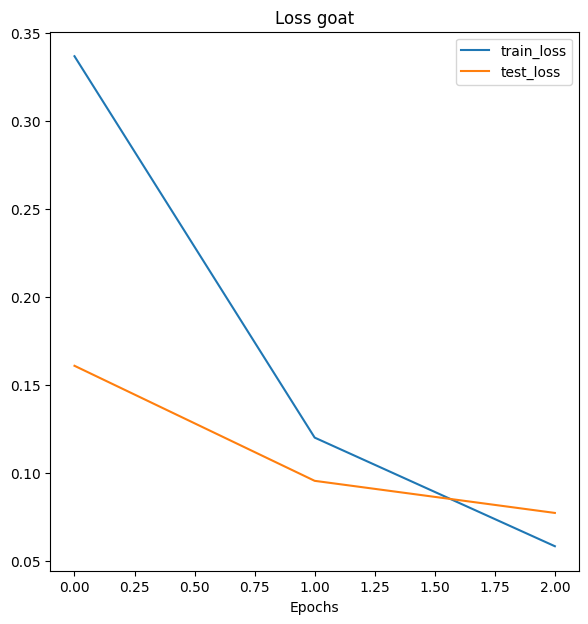

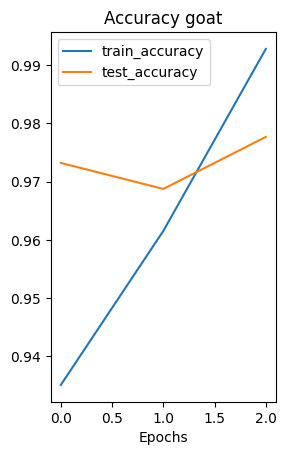

Fold 1
-------
Epoch: 1 | train_loss: 0.4020 | train_acc: 0.8822 | test_loss: 0.2990 | test_acc: 0.9107
Epoch: 2 | train_loss: 0.1236 | train_acc: 0.9856 | test_loss: 0.1439 | test_acc: 0.9598
Epoch: 3 | train_loss: 0.0562 | train_acc: 0.9952 | test_loss: 0.1125 | test_acc: 0.9464


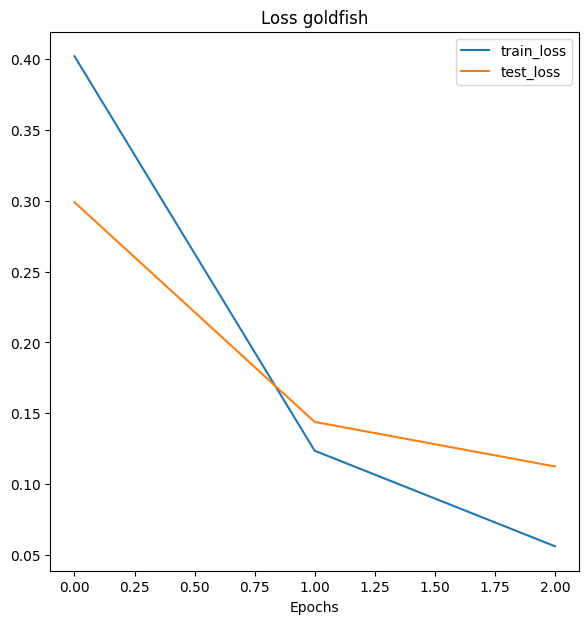

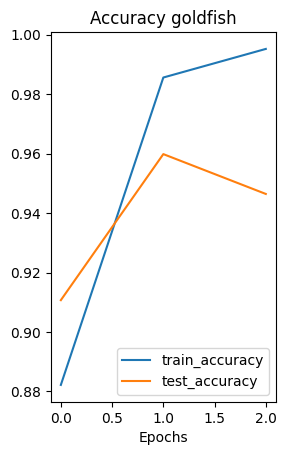

Fold 2
-------
Epoch: 1 | train_loss: 0.3358 | train_acc: 0.9351 | test_loss: 0.1227 | test_acc: 0.9866
Epoch: 2 | train_loss: 0.0783 | train_acc: 0.9832 | test_loss: 0.0540 | test_acc: 1.0000
Epoch: 3 | train_loss: 0.0327 | train_acc: 1.0000 | test_loss: 0.0351 | test_acc: 0.9955


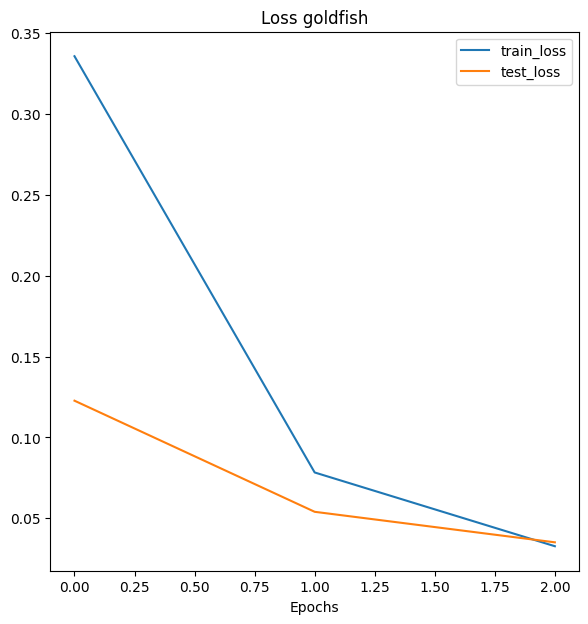

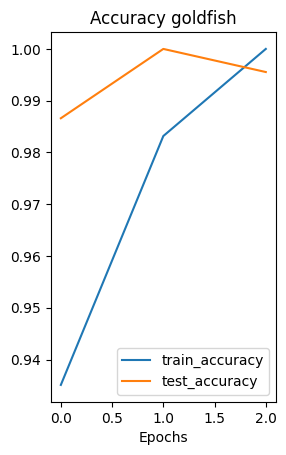

Fold 3
-------
Epoch: 1 | train_loss: 0.3202 | train_acc: 0.9255 | test_loss: 0.1116 | test_acc: 0.9911
Epoch: 2 | train_loss: 0.0625 | train_acc: 0.9928 | test_loss: 0.0553 | test_acc: 0.9955
Epoch: 3 | train_loss: 0.0343 | train_acc: 0.9928 | test_loss: 0.0294 | test_acc: 0.9955


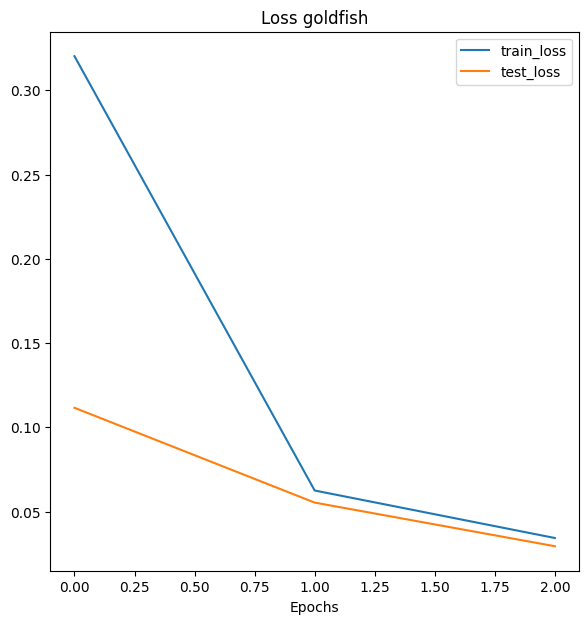

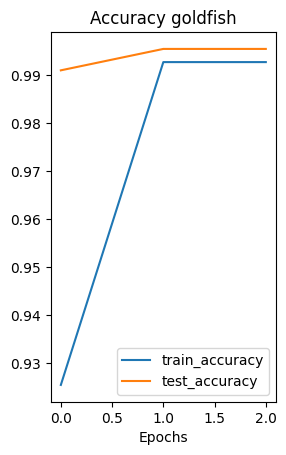

Fold 1
-------
Epoch: 1 | train_loss: 0.4257 | train_acc: 0.8413 | test_loss: 0.3394 | test_acc: 0.8750
Epoch: 2 | train_loss: 0.1659 | train_acc: 0.9543 | test_loss: 0.2175 | test_acc: 0.9196
Epoch: 3 | train_loss: 0.0958 | train_acc: 0.9712 | test_loss: 0.1582 | test_acc: 0.9375


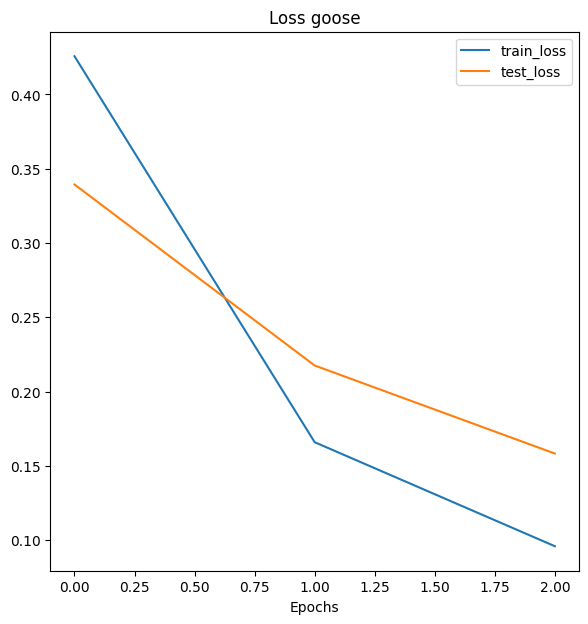

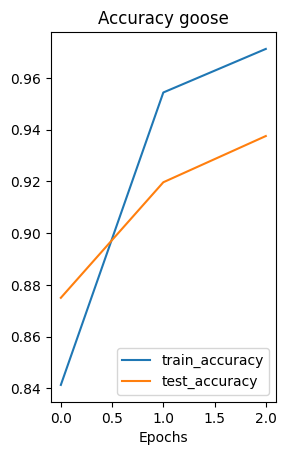

Fold 2
-------
Epoch: 1 | train_loss: 0.3578 | train_acc: 0.9279 | test_loss: 0.1791 | test_acc: 0.9464
Epoch: 2 | train_loss: 0.1203 | train_acc: 0.9736 | test_loss: 0.0959 | test_acc: 0.9777
Epoch: 3 | train_loss: 0.0836 | train_acc: 0.9760 | test_loss: 0.0617 | test_acc: 0.9821


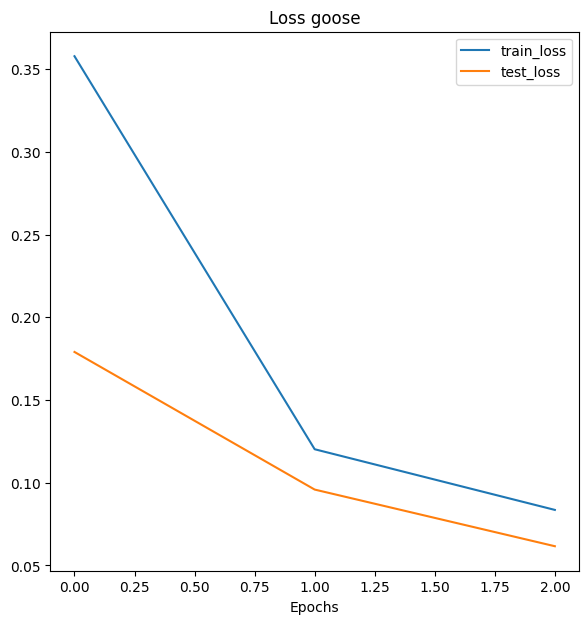

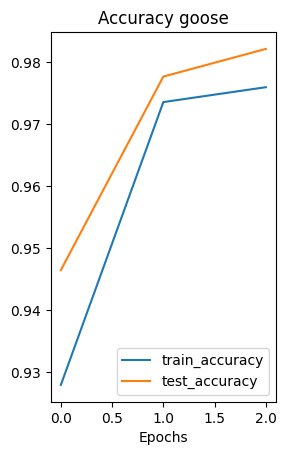

Fold 3
-------
Epoch: 1 | train_loss: 0.3480 | train_acc: 0.8966 | test_loss: 0.1488 | test_acc: 0.9777
Epoch: 2 | train_loss: 0.0884 | train_acc: 0.9904 | test_loss: 0.1028 | test_acc: 0.9598
Epoch: 3 | train_loss: 0.0534 | train_acc: 0.9832 | test_loss: 0.0862 | test_acc: 0.9643


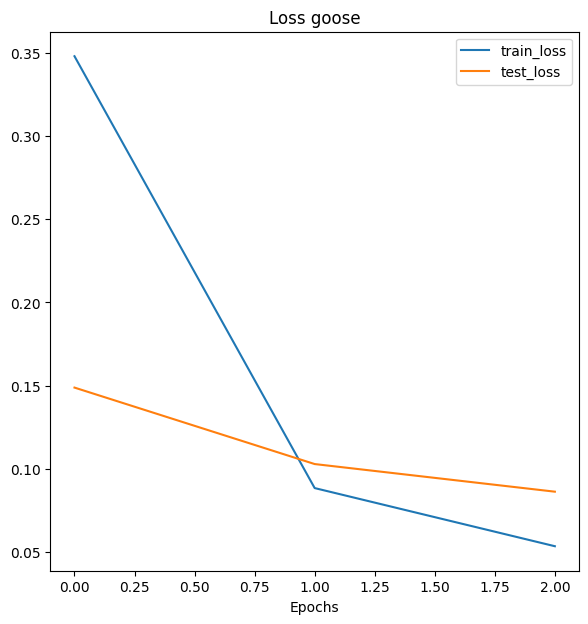

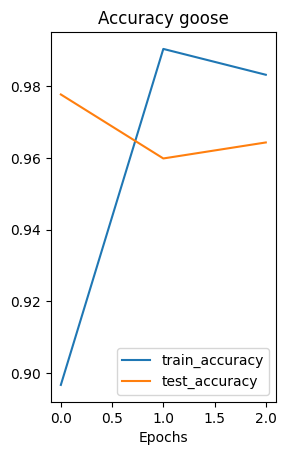

Fold 1
-------
Epoch: 1 | train_loss: 0.3961 | train_acc: 0.8774 | test_loss: 0.2618 | test_acc: 0.9464
Epoch: 2 | train_loss: 0.1417 | train_acc: 0.9712 | test_loss: 0.1327 | test_acc: 0.9688
Epoch: 3 | train_loss: 0.0724 | train_acc: 0.9808 | test_loss: 0.1006 | test_acc: 0.9732


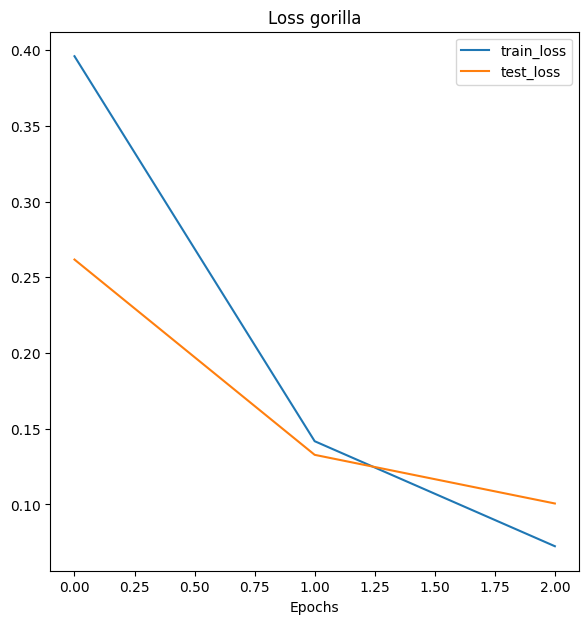

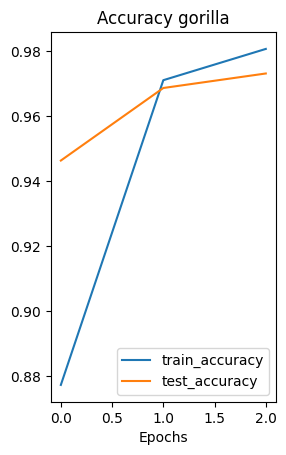

Fold 2
-------
Epoch: 1 | train_loss: 0.3657 | train_acc: 0.9087 | test_loss: 0.2056 | test_acc: 0.9688
Epoch: 2 | train_loss: 0.0977 | train_acc: 0.9880 | test_loss: 0.1033 | test_acc: 0.9866
Epoch: 3 | train_loss: 0.0379 | train_acc: 0.9928 | test_loss: 0.0651 | test_acc: 0.9866


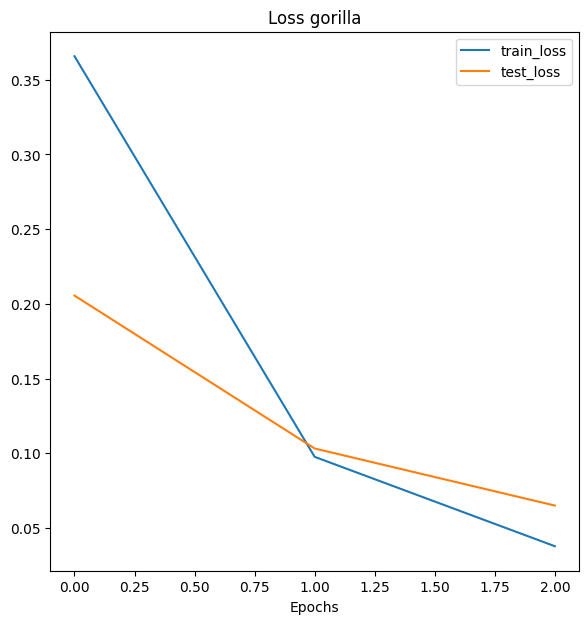

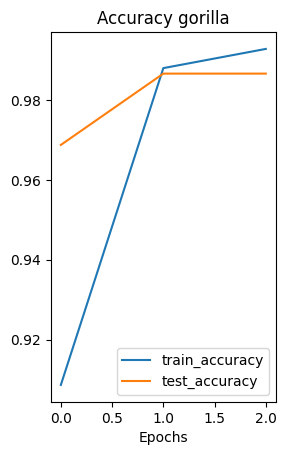

Fold 3
-------
Epoch: 1 | train_loss: 0.3291 | train_acc: 0.9255 | test_loss: 0.1114 | test_acc: 0.9911
Epoch: 2 | train_loss: 0.0741 | train_acc: 0.9880 | test_loss: 0.0438 | test_acc: 0.9911
Epoch: 3 | train_loss: 0.0439 | train_acc: 0.9904 | test_loss: 0.0234 | test_acc: 1.0000


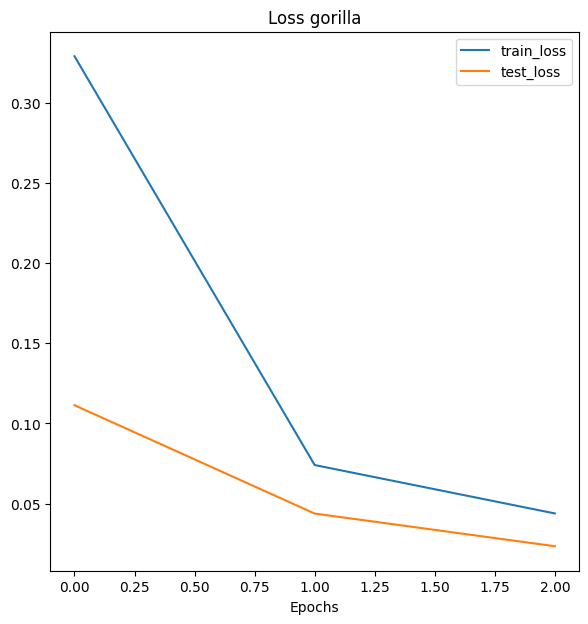

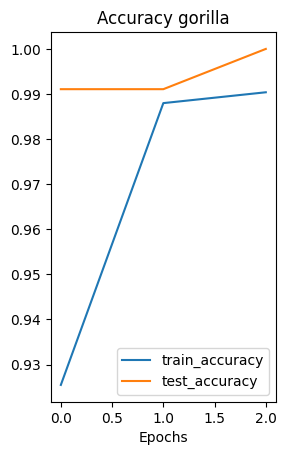

Fold 1
-------
Epoch: 1 | train_loss: 0.4062 | train_acc: 0.8774 | test_loss: 0.2643 | test_acc: 0.9464
Epoch: 2 | train_loss: 0.1433 | train_acc: 0.9688 | test_loss: 0.1454 | test_acc: 0.9777
Epoch: 3 | train_loss: 0.0668 | train_acc: 0.9928 | test_loss: 0.1064 | test_acc: 0.9777


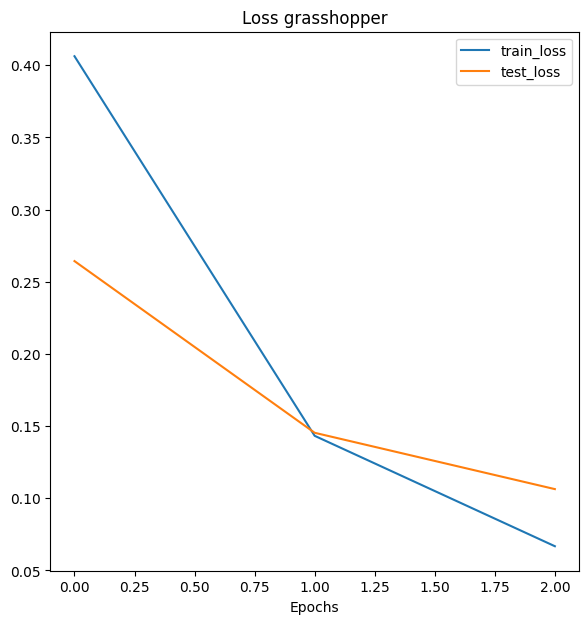

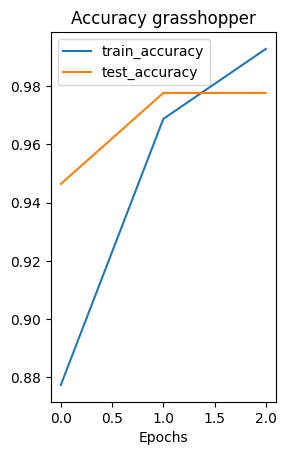

Fold 2
-------
Epoch: 1 | train_loss: 0.3302 | train_acc: 0.9423 | test_loss: 0.1234 | test_acc: 0.9911
Epoch: 2 | train_loss: 0.0929 | train_acc: 0.9880 | test_loss: 0.0474 | test_acc: 1.0000
Epoch: 3 | train_loss: 0.0540 | train_acc: 0.9904 | test_loss: 0.0274 | test_acc: 1.0000


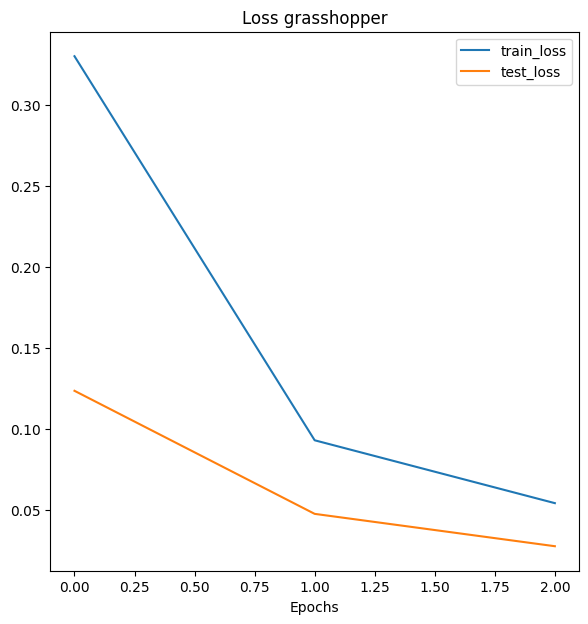

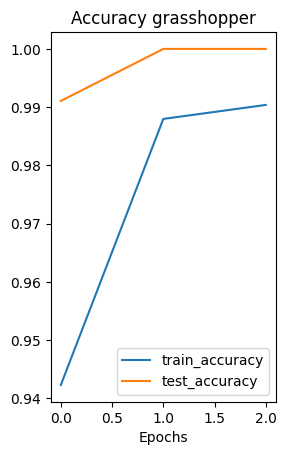

Fold 3
-------
Epoch: 1 | train_loss: 0.3374 | train_acc: 0.9279 | test_loss: 0.1208 | test_acc: 0.9911
Epoch: 2 | train_loss: 0.0668 | train_acc: 1.0000 | test_loss: 0.0516 | test_acc: 0.9911
Epoch: 3 | train_loss: 0.0376 | train_acc: 0.9976 | test_loss: 0.0377 | test_acc: 0.9911


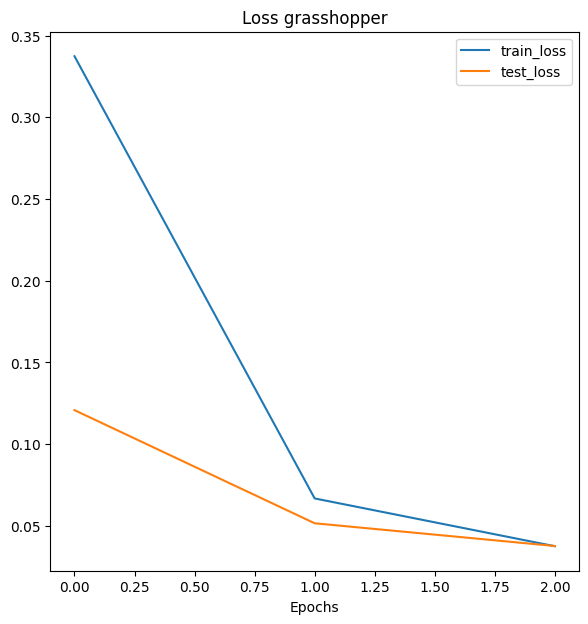

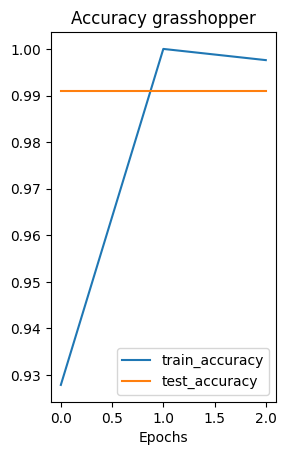

Fold 1
-------
Epoch: 1 | train_loss: 0.3929 | train_acc: 0.9014 | test_loss: 0.2731 | test_acc: 0.9375
Epoch: 2 | train_loss: 0.1404 | train_acc: 0.9688 | test_loss: 0.1553 | test_acc: 0.9643
Epoch: 3 | train_loss: 0.0763 | train_acc: 0.9856 | test_loss: 0.1225 | test_acc: 0.9688


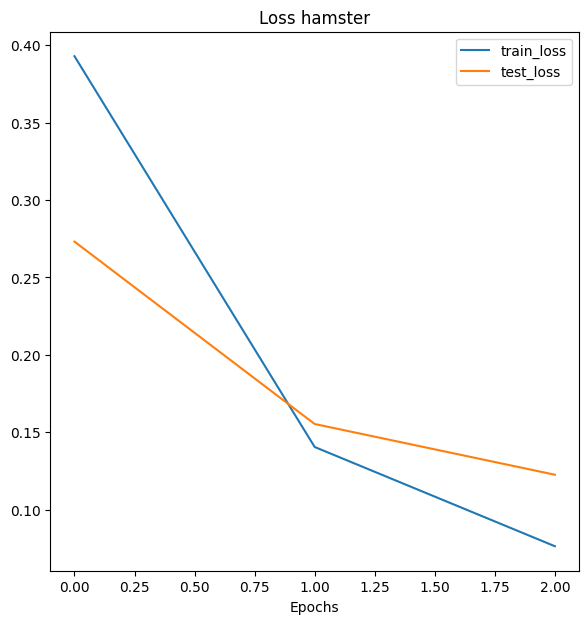

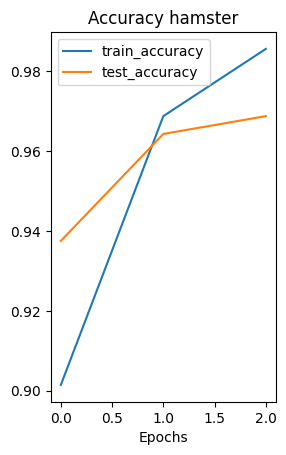

Fold 2
-------
Epoch: 1 | train_loss: 0.3913 | train_acc: 0.8582 | test_loss: 0.1908 | test_acc: 0.9509
Epoch: 2 | train_loss: 0.1106 | train_acc: 0.9784 | test_loss: 0.1084 | test_acc: 0.9688
Epoch: 3 | train_loss: 0.0584 | train_acc: 0.9904 | test_loss: 0.1199 | test_acc: 0.9554


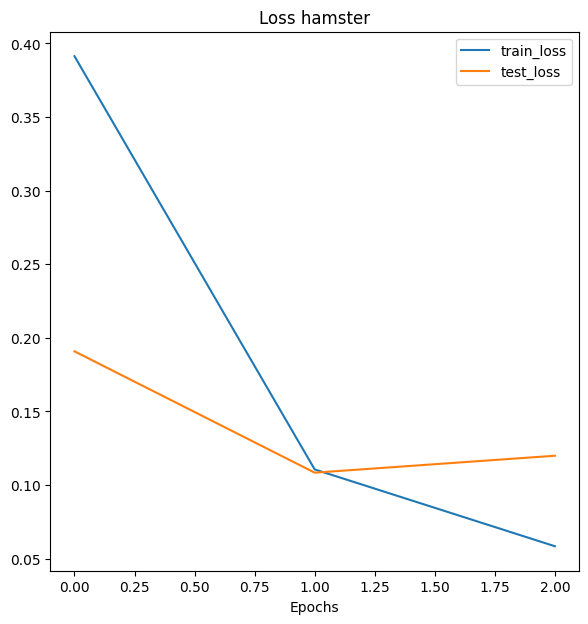

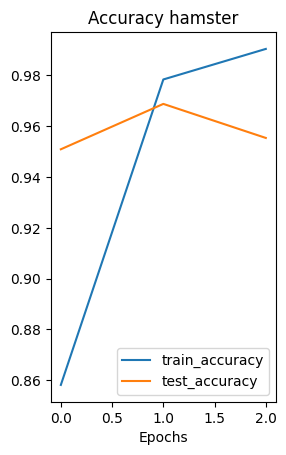

Fold 3
-------
Epoch: 1 | train_loss: 0.3133 | train_acc: 0.9471 | test_loss: 0.1386 | test_acc: 0.9911
Epoch: 2 | train_loss: 0.0770 | train_acc: 0.9856 | test_loss: 0.0670 | test_acc: 0.9955
Epoch: 3 | train_loss: 0.0470 | train_acc: 0.9880 | test_loss: 0.0430 | test_acc: 1.0000


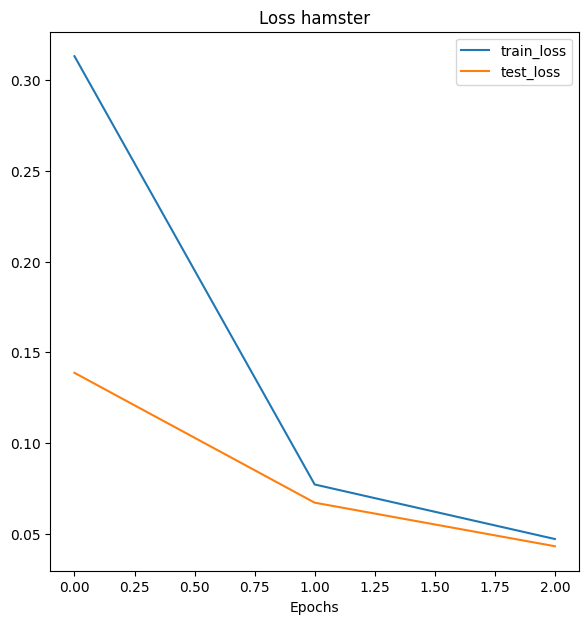

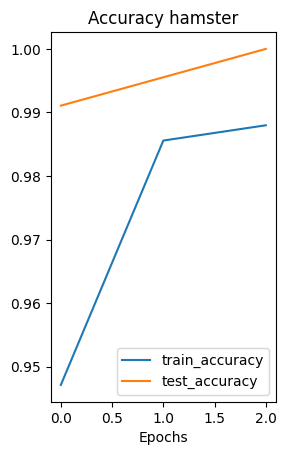

Fold 1
-------
Epoch: 1 | train_loss: 0.4420 | train_acc: 0.8606 | test_loss: 0.3491 | test_acc: 0.9152
Epoch: 2 | train_loss: 0.1902 | train_acc: 0.9519 | test_loss: 0.2136 | test_acc: 0.9330
Epoch: 3 | train_loss: 0.1010 | train_acc: 0.9760 | test_loss: 0.1446 | test_acc: 0.9598


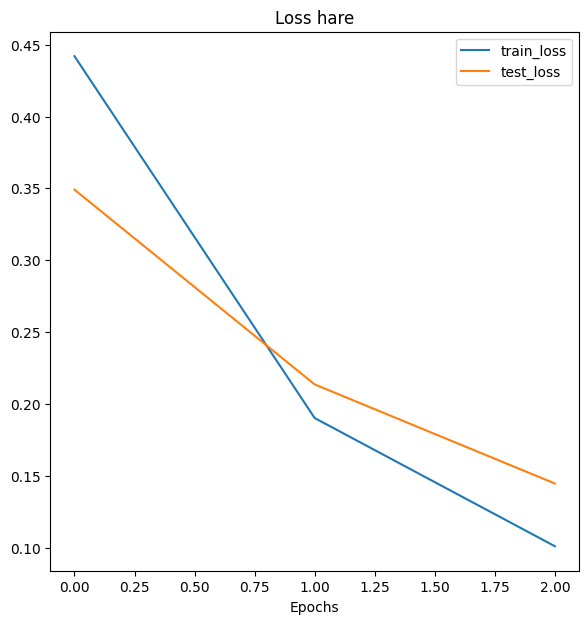

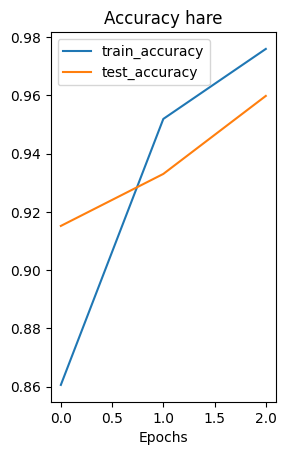

Fold 2
-------
Epoch: 1 | train_loss: 0.3873 | train_acc: 0.9087 | test_loss: 0.2045 | test_acc: 0.9732
Epoch: 2 | train_loss: 0.1267 | train_acc: 0.9784 | test_loss: 0.0860 | test_acc: 0.9866
Epoch: 3 | train_loss: 0.0684 | train_acc: 0.9808 | test_loss: 0.0657 | test_acc: 0.9911


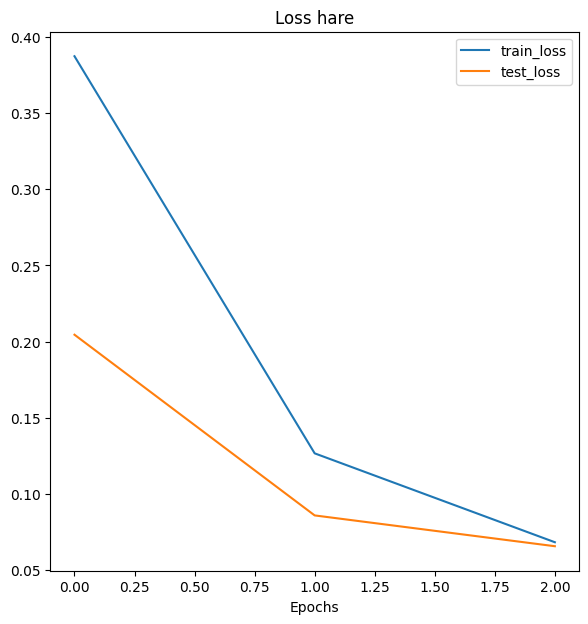

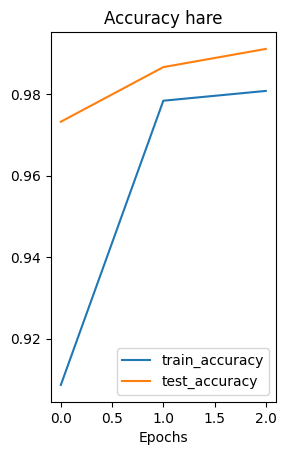

Fold 3
-------
Epoch: 1 | train_loss: 0.3481 | train_acc: 0.9207 | test_loss: 0.1535 | test_acc: 0.9821
Epoch: 2 | train_loss: 0.0818 | train_acc: 0.9832 | test_loss: 0.0884 | test_acc: 0.9911
Epoch: 3 | train_loss: 0.0475 | train_acc: 0.9904 | test_loss: 0.0691 | test_acc: 0.9911


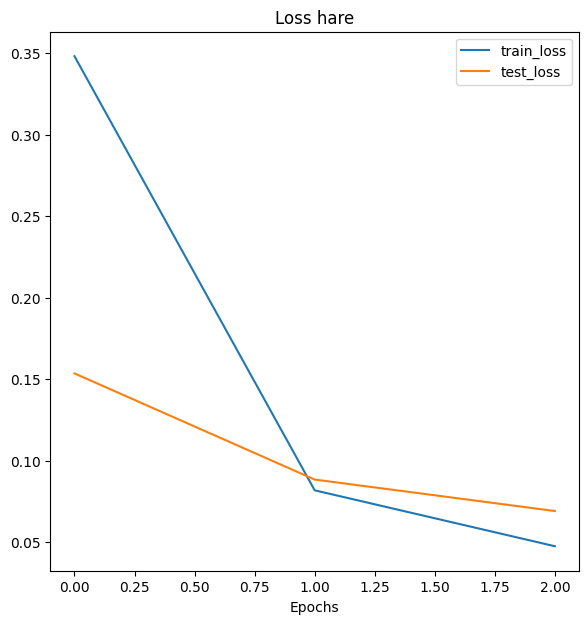

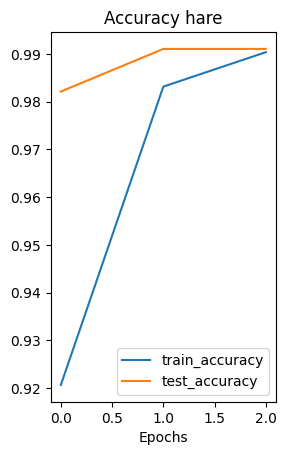

Fold 1
-------
Epoch: 1 | train_loss: 0.3832 | train_acc: 0.9014 | test_loss: 0.2518 | test_acc: 0.9062
Epoch: 2 | train_loss: 0.1219 | train_acc: 0.9784 | test_loss: 0.1233 | test_acc: 0.9598
Epoch: 3 | train_loss: 0.0625 | train_acc: 0.9904 | test_loss: 0.0697 | test_acc: 0.9866


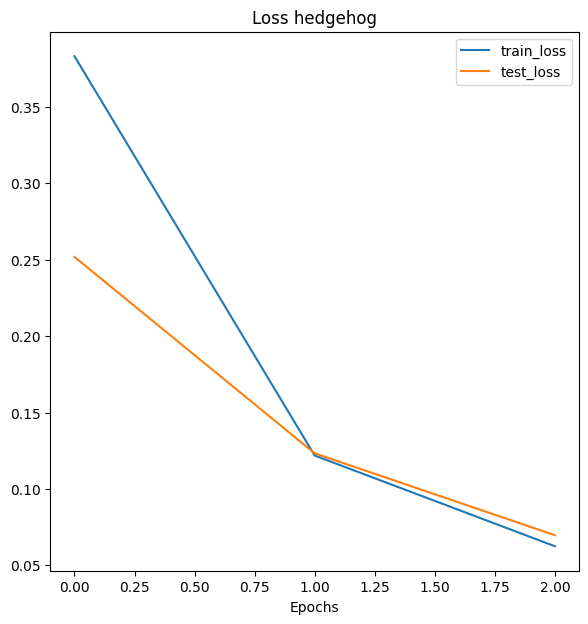

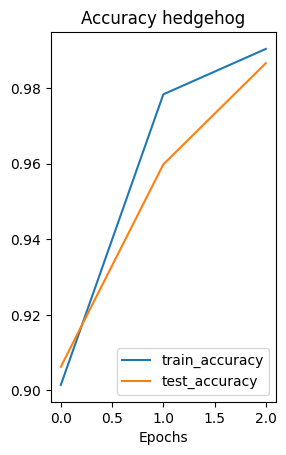

Fold 2
-------
Epoch: 1 | train_loss: 0.3335 | train_acc: 0.9231 | test_loss: 0.1438 | test_acc: 0.9911
Epoch: 2 | train_loss: 0.0824 | train_acc: 0.9880 | test_loss: 0.0745 | test_acc: 0.9866
Epoch: 3 | train_loss: 0.0379 | train_acc: 0.9952 | test_loss: 0.0477 | test_acc: 0.9955


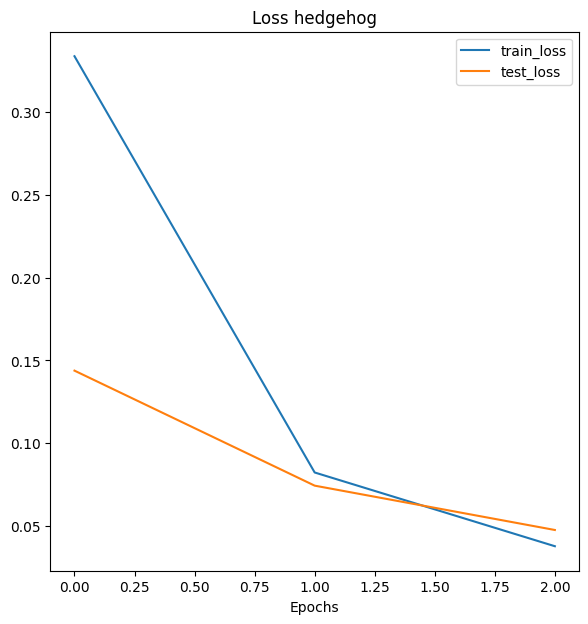

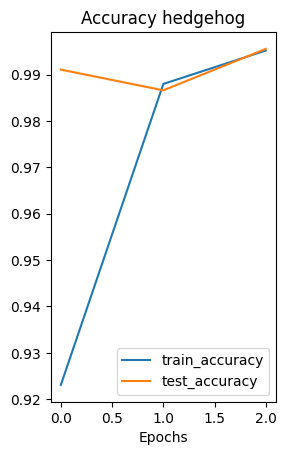

Fold 3
-------
Epoch: 1 | train_loss: 0.3084 | train_acc: 0.9303 | test_loss: 0.0986 | test_acc: 0.9955
Epoch: 2 | train_loss: 0.0710 | train_acc: 0.9928 | test_loss: 0.0469 | test_acc: 0.9955
Epoch: 3 | train_loss: 0.0519 | train_acc: 0.9832 | test_loss: 0.0478 | test_acc: 0.9821


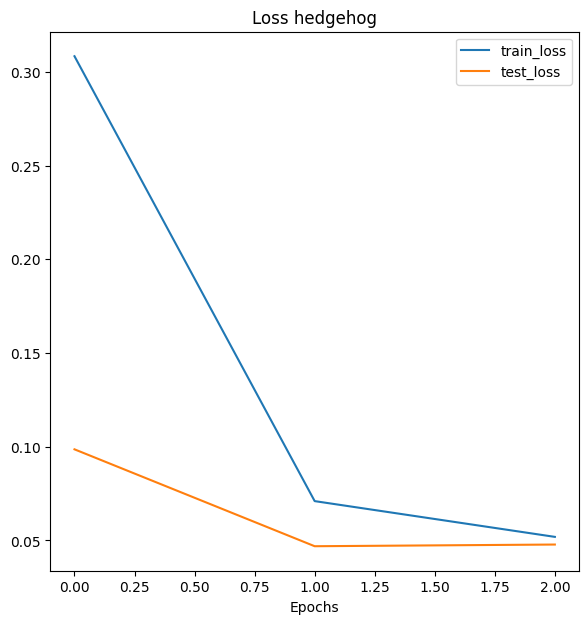

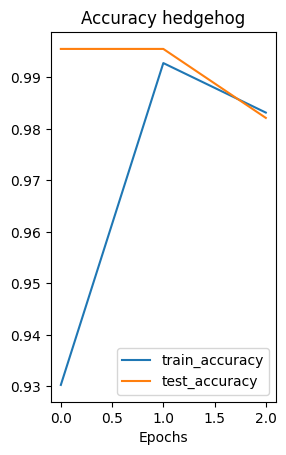

Fold 1
-------
Epoch: 1 | train_loss: 0.4284 | train_acc: 0.8774 | test_loss: 0.2872 | test_acc: 0.9420
Epoch: 2 | train_loss: 0.1512 | train_acc: 0.9688 | test_loss: 0.1388 | test_acc: 0.9643
Epoch: 3 | train_loss: 0.0769 | train_acc: 0.9832 | test_loss: 0.1020 | test_acc: 0.9554


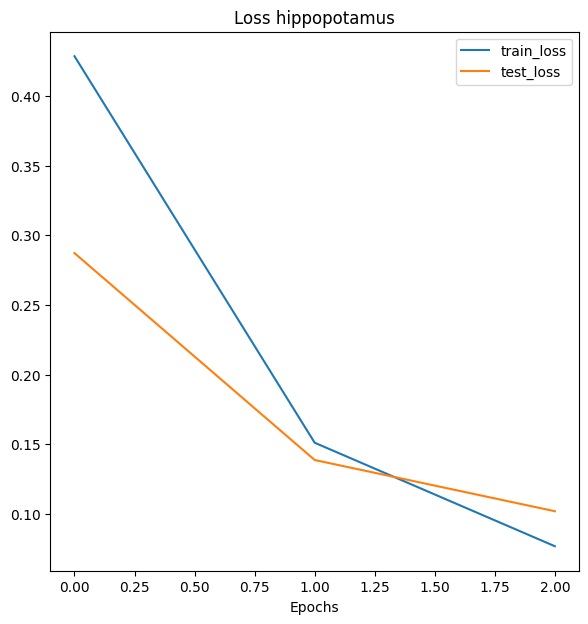

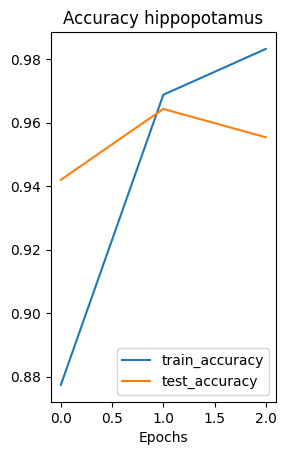

Fold 2
-------
Epoch: 1 | train_loss: 0.3913 | train_acc: 0.8894 | test_loss: 0.1869 | test_acc: 0.9688
Epoch: 2 | train_loss: 0.1084 | train_acc: 0.9880 | test_loss: 0.0795 | test_acc: 0.9866
Epoch: 3 | train_loss: 0.0485 | train_acc: 0.9928 | test_loss: 0.0571 | test_acc: 0.9911


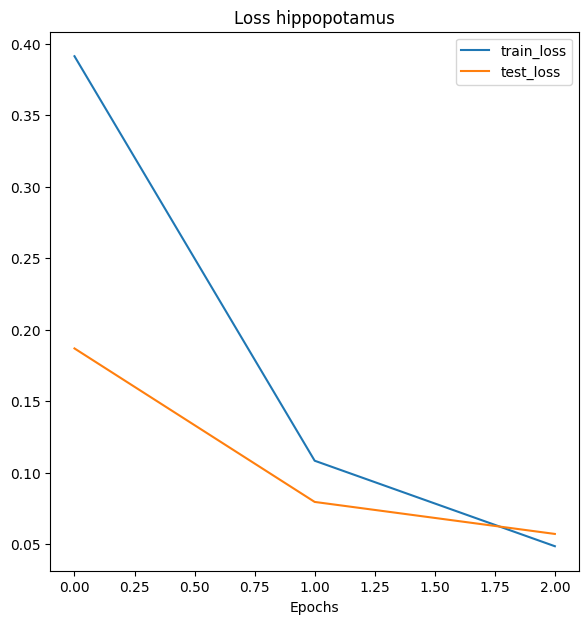

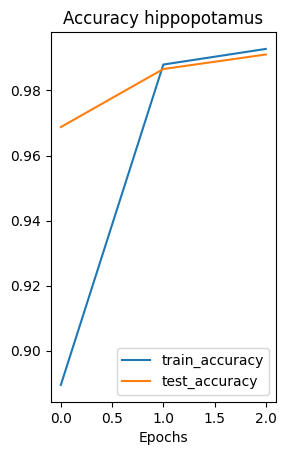

Fold 3
-------
Epoch: 1 | train_loss: 0.3458 | train_acc: 0.9351 | test_loss: 0.1221 | test_acc: 1.0000
Epoch: 2 | train_loss: 0.0914 | train_acc: 0.9928 | test_loss: 0.0548 | test_acc: 1.0000
Epoch: 3 | train_loss: 0.0467 | train_acc: 0.9904 | test_loss: 0.0383 | test_acc: 1.0000


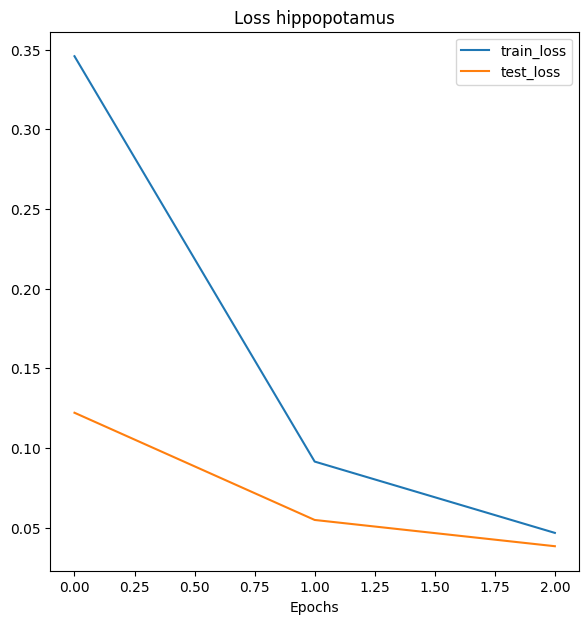

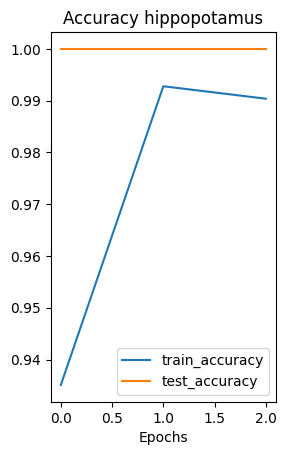

Fold 1
-------
Epoch: 1 | train_loss: 0.4417 | train_acc: 0.8606 | test_loss: 0.2924 | test_acc: 0.9375
Epoch: 2 | train_loss: 0.1700 | train_acc: 0.9615 | test_loss: 0.1620 | test_acc: 0.9554
Epoch: 3 | train_loss: 0.0719 | train_acc: 0.9952 | test_loss: 0.0904 | test_acc: 0.9911


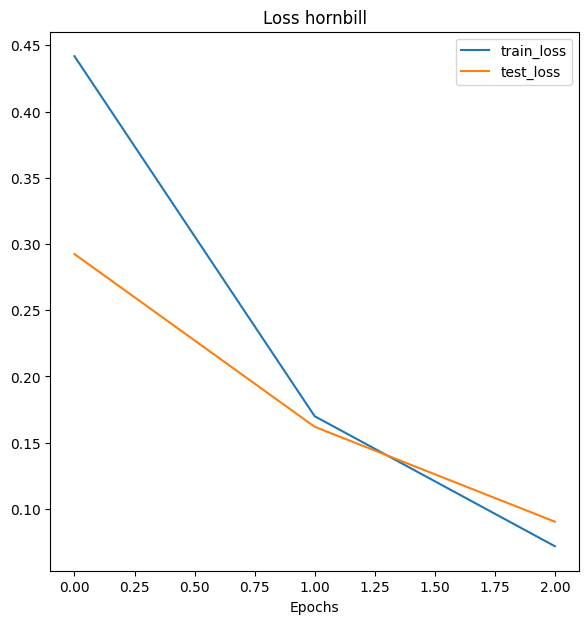

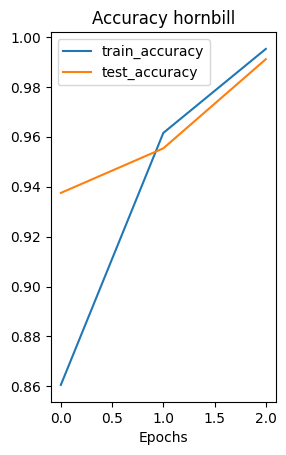

Fold 2
-------
Epoch: 1 | train_loss: 0.3729 | train_acc: 0.9062 | test_loss: 0.1684 | test_acc: 0.9866
Epoch: 2 | train_loss: 0.1071 | train_acc: 0.9784 | test_loss: 0.0735 | test_acc: 0.9955
Epoch: 3 | train_loss: 0.0635 | train_acc: 0.9904 | test_loss: 0.0442 | test_acc: 0.9955


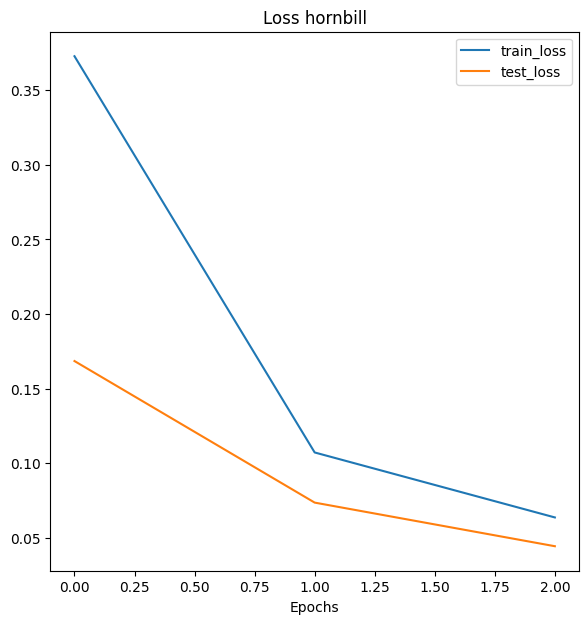

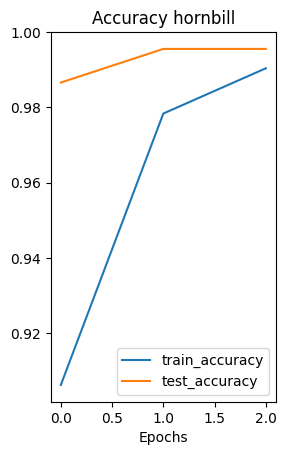

Fold 3
-------
Epoch: 1 | train_loss: 0.3672 | train_acc: 0.9159 | test_loss: 0.1397 | test_acc: 0.9866
Epoch: 2 | train_loss: 0.0905 | train_acc: 0.9928 | test_loss: 0.0626 | test_acc: 0.9911
Epoch: 3 | train_loss: 0.0349 | train_acc: 0.9976 | test_loss: 0.0495 | test_acc: 0.9911


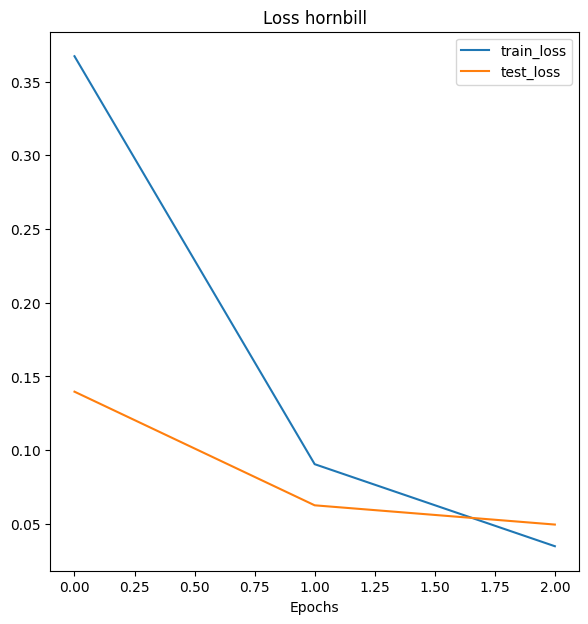

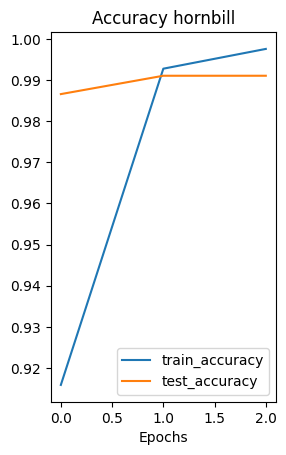

Fold 1
-------
Epoch: 1 | train_loss: 0.4624 | train_acc: 0.8341 | test_loss: 0.3019 | test_acc: 0.9152
Epoch: 2 | train_loss: 0.1771 | train_acc: 0.9688 | test_loss: 0.1844 | test_acc: 0.9375
Epoch: 3 | train_loss: 0.0994 | train_acc: 0.9784 | test_loss: 0.1456 | test_acc: 0.9464


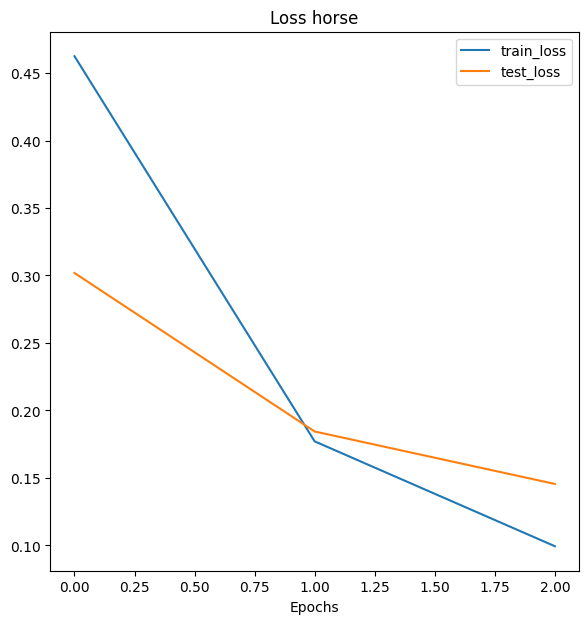

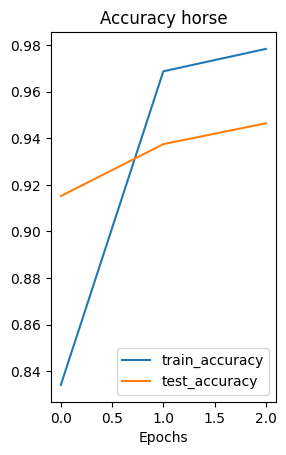

Fold 2
-------
Epoch: 1 | train_loss: 0.4189 | train_acc: 0.8726 | test_loss: 0.2040 | test_acc: 0.9732
Epoch: 2 | train_loss: 0.1383 | train_acc: 0.9712 | test_loss: 0.1146 | test_acc: 0.9777
Epoch: 3 | train_loss: 0.0815 | train_acc: 0.9832 | test_loss: 0.0830 | test_acc: 0.9911


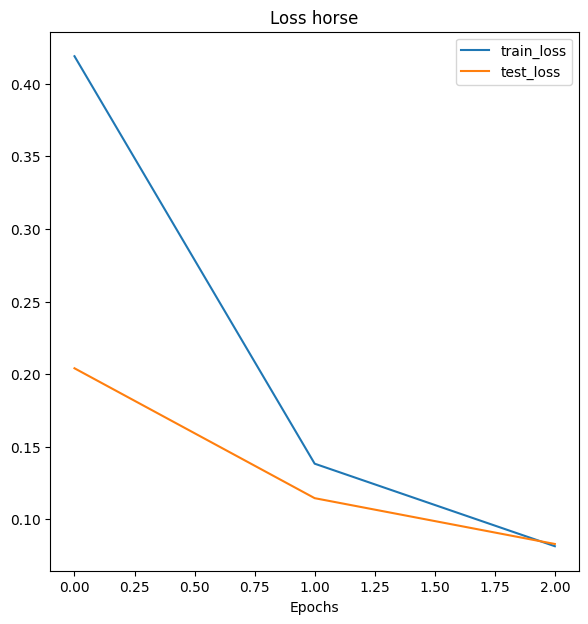

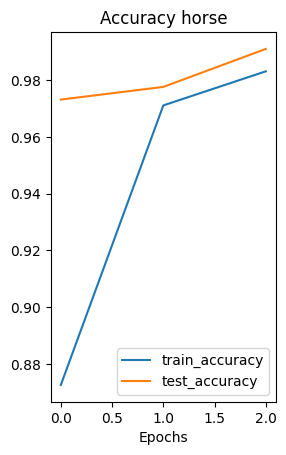

Fold 3
-------
Epoch: 1 | train_loss: 0.3658 | train_acc: 0.9087 | test_loss: 0.1513 | test_acc: 0.9866
Epoch: 2 | train_loss: 0.1168 | train_acc: 0.9736 | test_loss: 0.0778 | test_acc: 1.0000
Epoch: 3 | train_loss: 0.0641 | train_acc: 0.9880 | test_loss: 0.0547 | test_acc: 1.0000


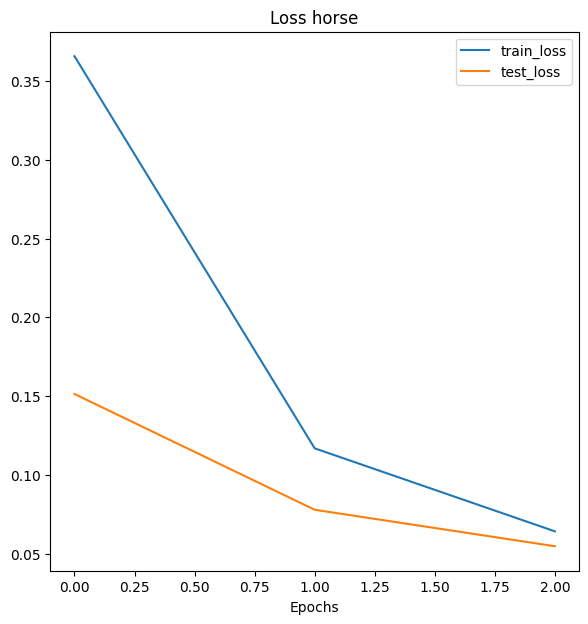

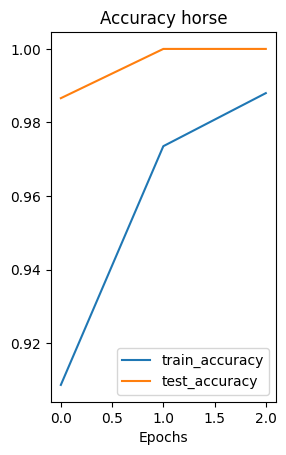

Fold 1
-------
Epoch: 1 | train_loss: 0.3906 | train_acc: 0.8894 | test_loss: 0.2370 | test_acc: 0.9598
Epoch: 2 | train_loss: 0.1285 | train_acc: 0.9663 | test_loss: 0.1090 | test_acc: 0.9911
Epoch: 3 | train_loss: 0.0667 | train_acc: 0.9856 | test_loss: 0.0719 | test_acc: 0.9911


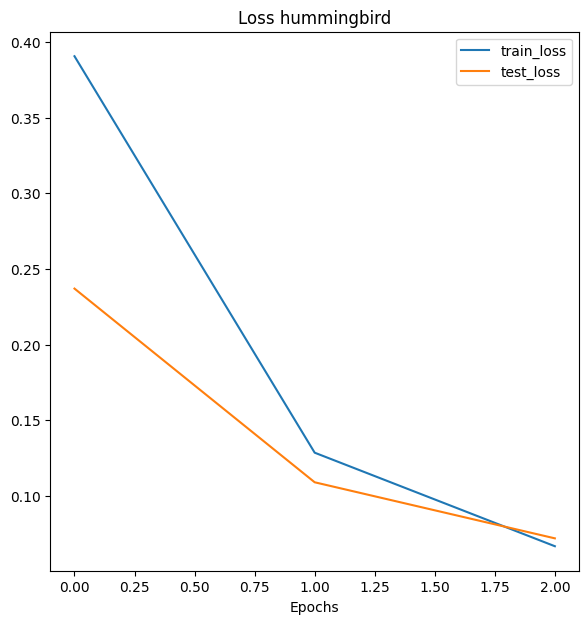

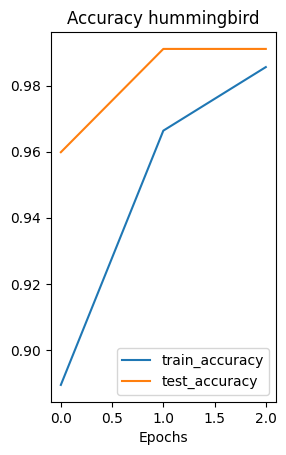

Fold 2
-------
Epoch: 1 | train_loss: 0.3364 | train_acc: 0.9399 | test_loss: 0.1323 | test_acc: 0.9866
Epoch: 2 | train_loss: 0.0809 | train_acc: 0.9952 | test_loss: 0.0692 | test_acc: 0.9866
Epoch: 3 | train_loss: 0.0461 | train_acc: 0.9928 | test_loss: 0.0437 | test_acc: 0.9911


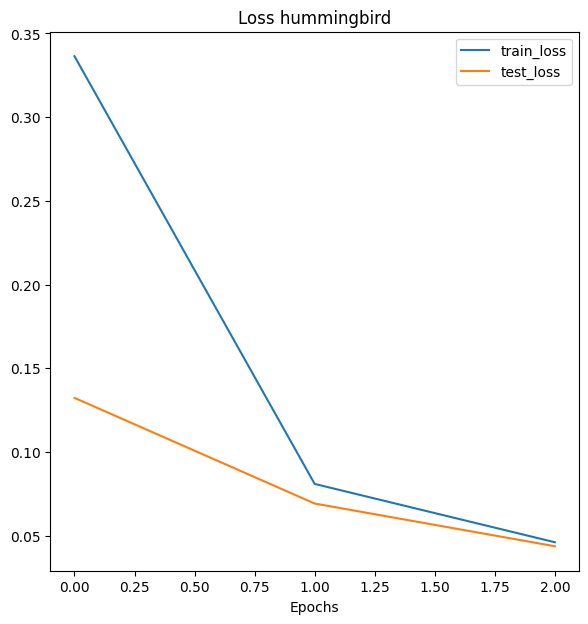

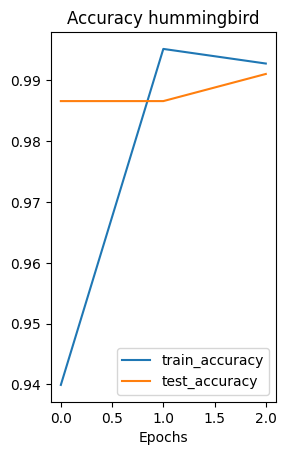

Fold 3
-------
Epoch: 1 | train_loss: 0.3000 | train_acc: 0.9471 | test_loss: 0.1012 | test_acc: 0.9955
Epoch: 2 | train_loss: 0.0659 | train_acc: 0.9952 | test_loss: 0.0427 | test_acc: 0.9911
Epoch: 3 | train_loss: 0.0437 | train_acc: 0.9928 | test_loss: 0.0287 | test_acc: 0.9955


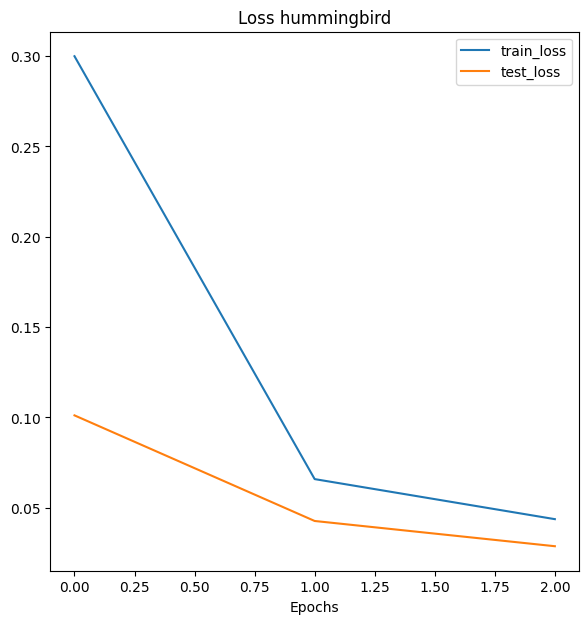

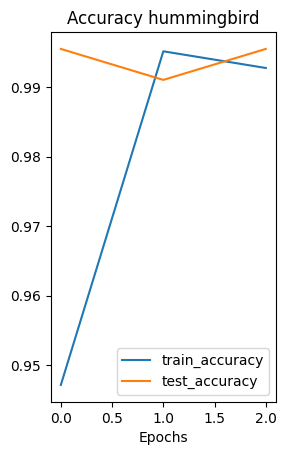

Fold 1
-------
Epoch: 1 | train_loss: 0.3993 | train_acc: 0.9014 | test_loss: 0.2665 | test_acc: 0.9509
Epoch: 2 | train_loss: 0.1305 | train_acc: 0.9808 | test_loss: 0.1288 | test_acc: 0.9955
Epoch: 3 | train_loss: 0.0580 | train_acc: 0.9928 | test_loss: 0.0568 | test_acc: 1.0000


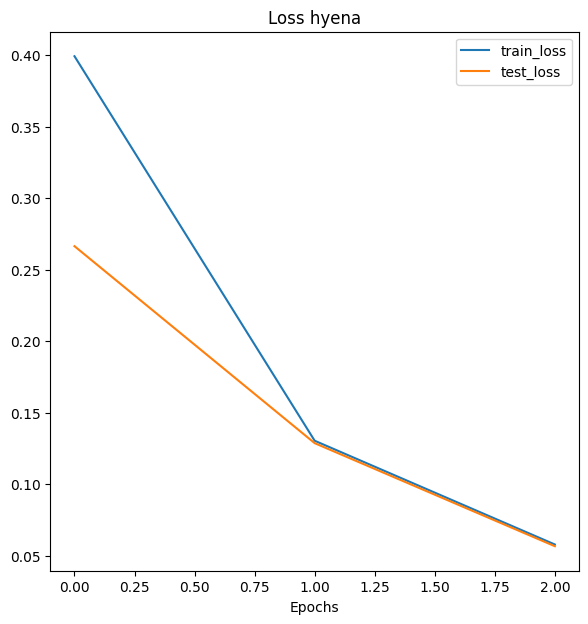

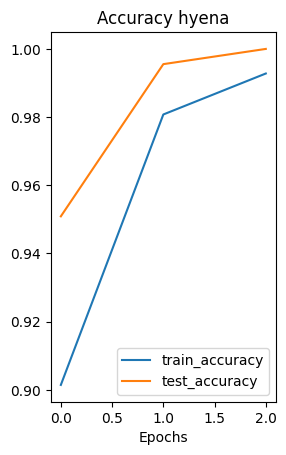

Fold 2
-------
Epoch: 1 | train_loss: 0.3424 | train_acc: 0.9351 | test_loss: 0.1425 | test_acc: 0.9911
Epoch: 2 | train_loss: 0.0925 | train_acc: 0.9928 | test_loss: 0.0598 | test_acc: 0.9955
Epoch: 3 | train_loss: 0.0357 | train_acc: 0.9976 | test_loss: 0.0547 | test_acc: 0.9821


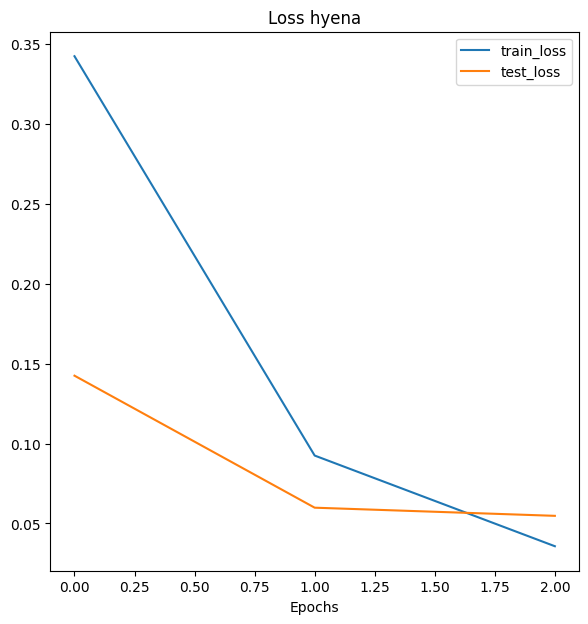

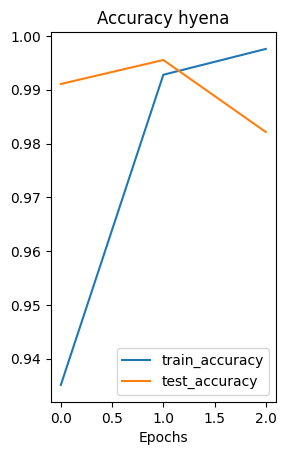

Fold 3
-------
Epoch: 1 | train_loss: 0.3291 | train_acc: 0.9279 | test_loss: 0.1084 | test_acc: 1.0000
Epoch: 2 | train_loss: 0.0591 | train_acc: 0.9976 | test_loss: 0.0344 | test_acc: 1.0000
Epoch: 3 | train_loss: 0.0323 | train_acc: 1.0000 | test_loss: 0.0245 | test_acc: 1.0000


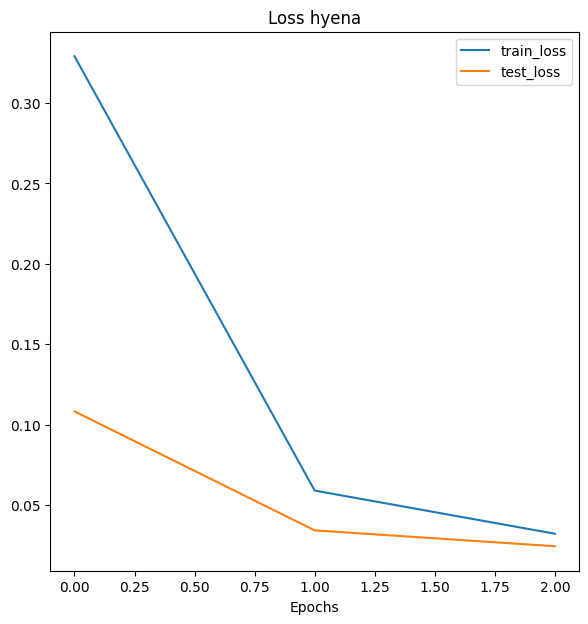

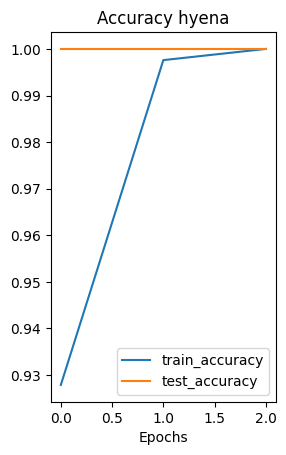

Fold 1
-------
Epoch: 1 | train_loss: 0.3880 | train_acc: 0.8894 | test_loss: 0.2374 | test_acc: 0.9777
Epoch: 2 | train_loss: 0.1240 | train_acc: 0.9832 | test_loss: 0.1061 | test_acc: 0.9821
Epoch: 3 | train_loss: 0.0687 | train_acc: 0.9856 | test_loss: 0.0663 | test_acc: 0.9955


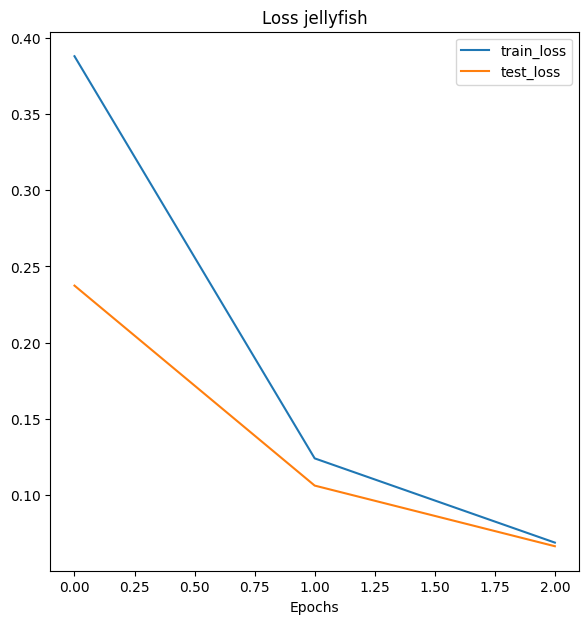

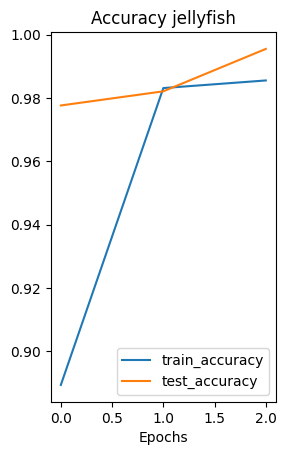

Fold 2
-------
Epoch: 1 | train_loss: 0.3625 | train_acc: 0.8870 | test_loss: 0.1416 | test_acc: 0.9911
Epoch: 2 | train_loss: 0.0871 | train_acc: 0.9928 | test_loss: 0.0621 | test_acc: 0.9955
Epoch: 3 | train_loss: 0.0346 | train_acc: 1.0000 | test_loss: 0.0462 | test_acc: 0.9821


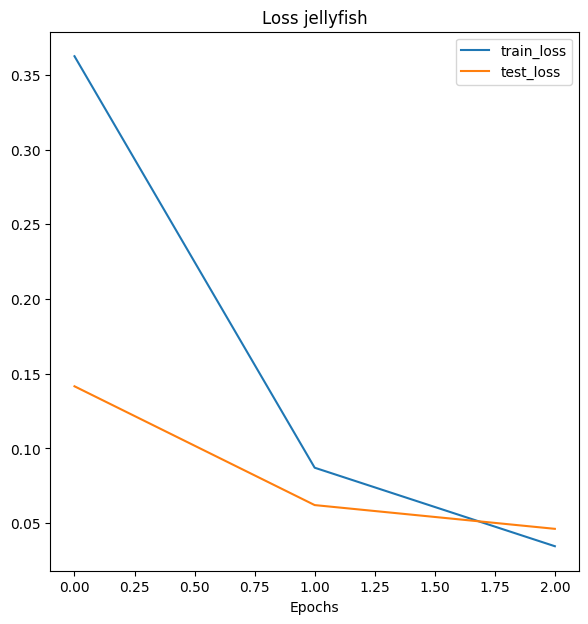

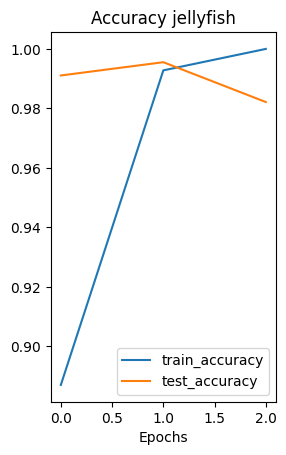

Fold 3
-------
Epoch: 1 | train_loss: 0.3055 | train_acc: 0.9591 | test_loss: 0.1107 | test_acc: 0.9911
Epoch: 2 | train_loss: 0.0696 | train_acc: 0.9928 | test_loss: 0.0577 | test_acc: 0.9821
Epoch: 3 | train_loss: 0.0372 | train_acc: 0.9952 | test_loss: 0.0333 | test_acc: 0.9955


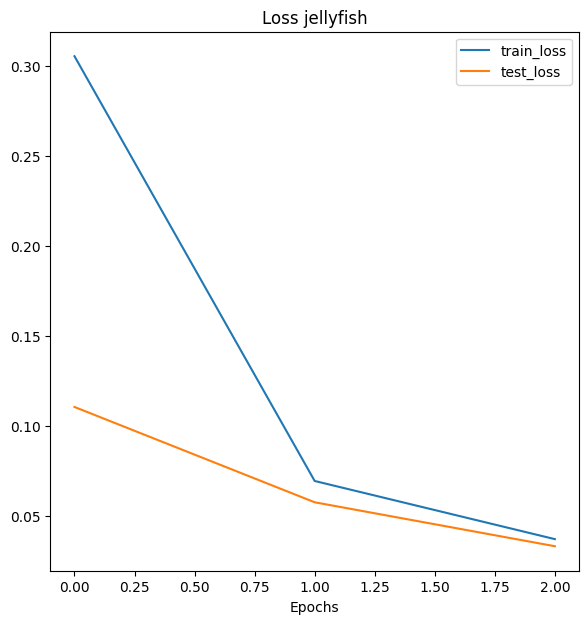

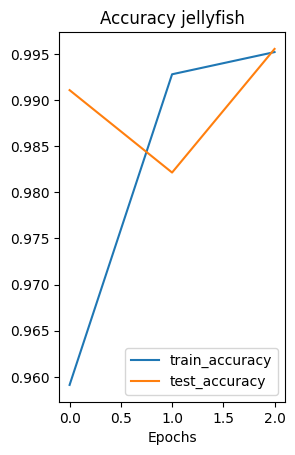

Fold 1
-------
Epoch: 1 | train_loss: 0.4482 | train_acc: 0.8606 | test_loss: 0.3417 | test_acc: 0.8929
Epoch: 2 | train_loss: 0.1649 | train_acc: 0.9736 | test_loss: 0.2389 | test_acc: 0.9152
Epoch: 3 | train_loss: 0.0875 | train_acc: 0.9832 | test_loss: 0.1845 | test_acc: 0.9375


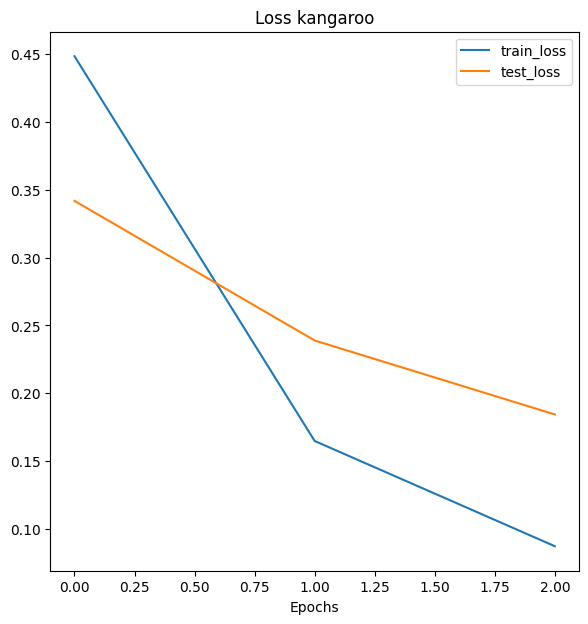

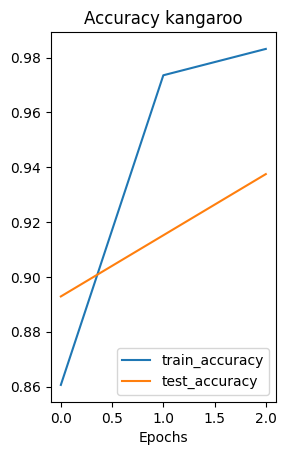

Fold 2
-------
Epoch: 1 | train_loss: 0.3667 | train_acc: 0.9135 | test_loss: 0.1812 | test_acc: 0.9866
Epoch: 2 | train_loss: 0.1150 | train_acc: 0.9832 | test_loss: 0.0806 | test_acc: 0.9911
Epoch: 3 | train_loss: 0.0736 | train_acc: 0.9856 | test_loss: 0.0727 | test_acc: 0.9911


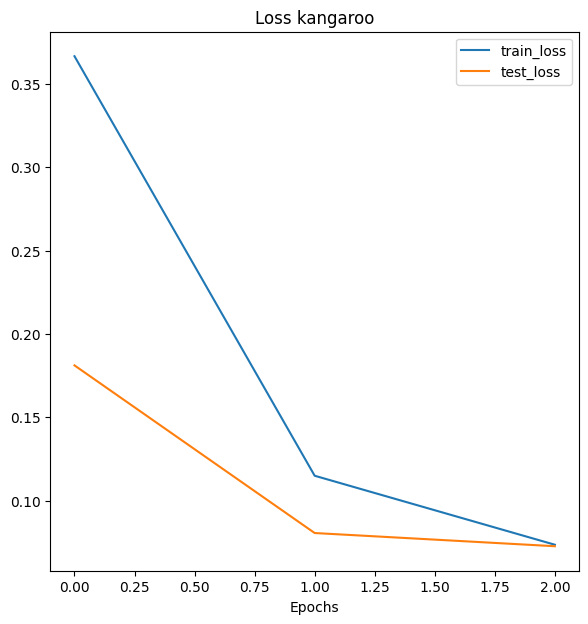

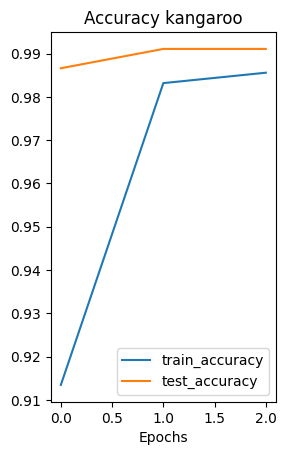

Fold 3
-------
Epoch: 1 | train_loss: 0.3610 | train_acc: 0.9183 | test_loss: 0.1376 | test_acc: 0.9955
Epoch: 2 | train_loss: 0.1012 | train_acc: 0.9784 | test_loss: 0.0649 | test_acc: 0.9955
Epoch: 3 | train_loss: 0.0564 | train_acc: 0.9856 | test_loss: 0.0467 | test_acc: 0.9955


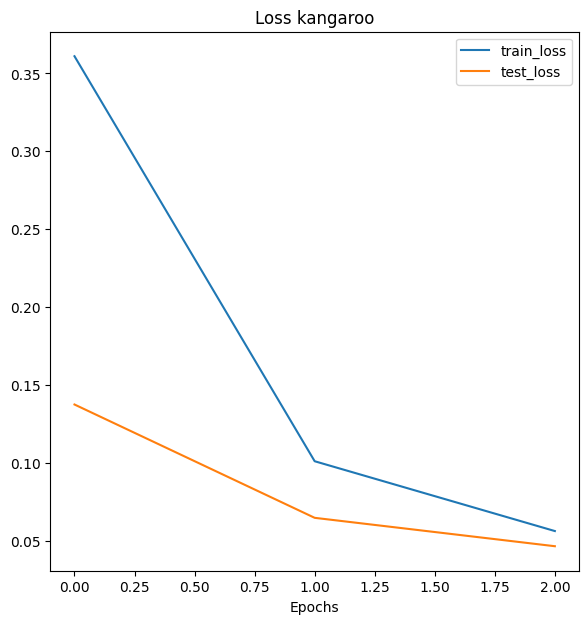

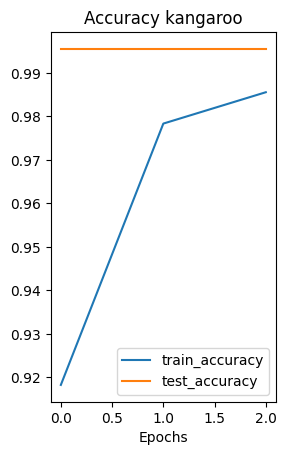

Fold 1
-------
Epoch: 1 | train_loss: 0.3868 | train_acc: 0.8870 | test_loss: 0.2455 | test_acc: 0.9420
Epoch: 2 | train_loss: 0.1291 | train_acc: 0.9760 | test_loss: 0.1089 | test_acc: 0.9866
Epoch: 3 | train_loss: 0.0475 | train_acc: 1.0000 | test_loss: 0.0684 | test_acc: 0.9911


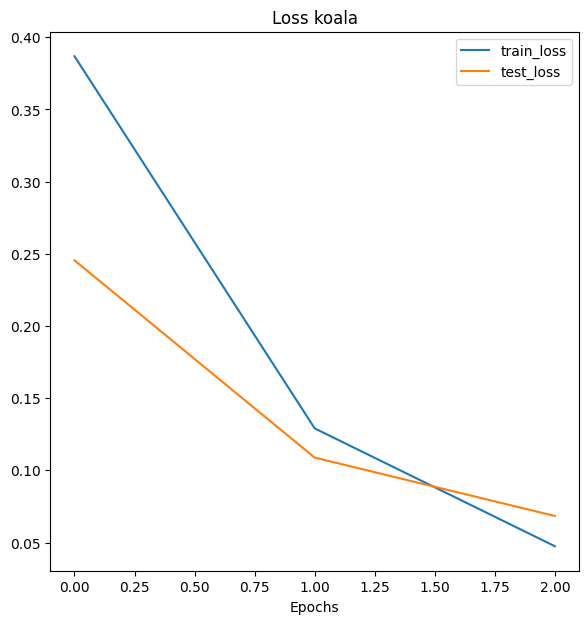

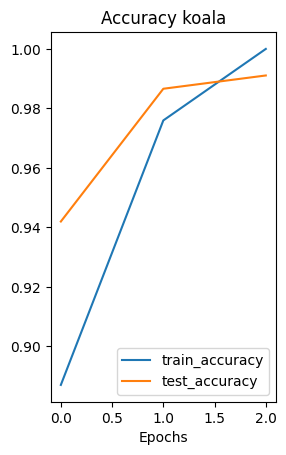

Fold 2
-------
Epoch: 1 | train_loss: 0.3378 | train_acc: 0.9351 | test_loss: 0.1353 | test_acc: 0.9911
Epoch: 2 | train_loss: 0.0719 | train_acc: 0.9952 | test_loss: 0.0549 | test_acc: 0.9955
Epoch: 3 | train_loss: 0.0412 | train_acc: 0.9928 | test_loss: 0.0422 | test_acc: 0.9955


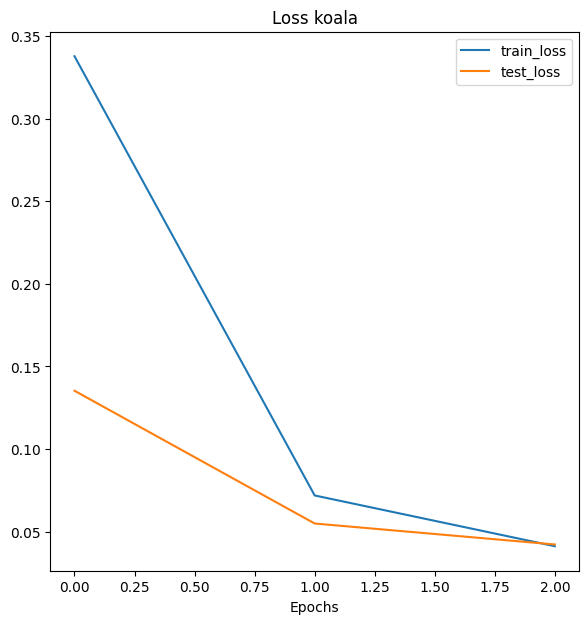

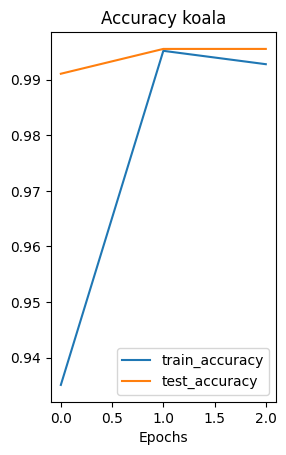

Fold 3
-------
Epoch: 1 | train_loss: 0.2935 | train_acc: 0.9615 | test_loss: 0.0893 | test_acc: 1.0000
Epoch: 2 | train_loss: 0.0655 | train_acc: 0.9952 | test_loss: 0.0336 | test_acc: 1.0000
Epoch: 3 | train_loss: 0.0402 | train_acc: 0.9880 | test_loss: 0.0226 | test_acc: 0.9955


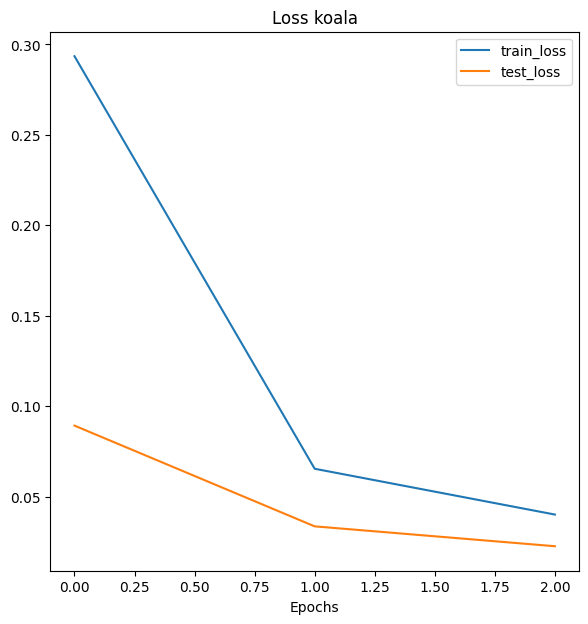

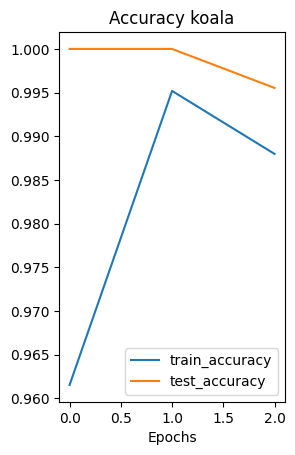

Fold 1
-------
Epoch: 1 | train_loss: 0.4014 | train_acc: 0.9135 | test_loss: 0.2770 | test_acc: 0.9241
Epoch: 2 | train_loss: 0.1466 | train_acc: 0.9784 | test_loss: 0.1334 | test_acc: 0.9598
Epoch: 3 | train_loss: 0.0612 | train_acc: 0.9856 | test_loss: 0.0836 | test_acc: 0.9777


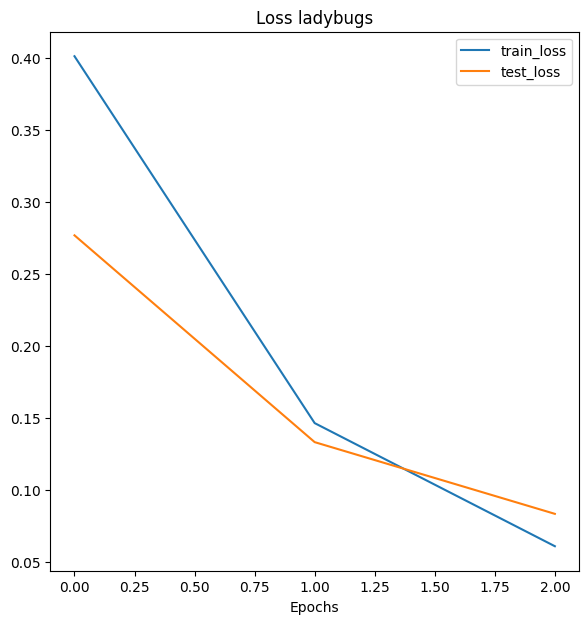

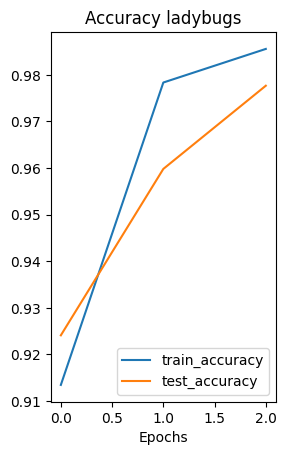

Fold 2
-------
Epoch: 1 | train_loss: 0.3616 | train_acc: 0.9111 | test_loss: 0.1312 | test_acc: 1.0000
Epoch: 2 | train_loss: 0.0820 | train_acc: 0.9952 | test_loss: 0.0546 | test_acc: 1.0000
Epoch: 3 | train_loss: 0.0390 | train_acc: 0.9976 | test_loss: 0.0366 | test_acc: 1.0000


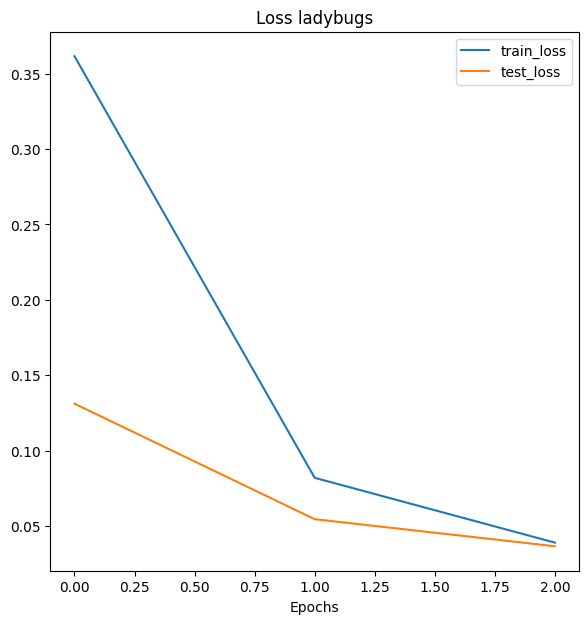

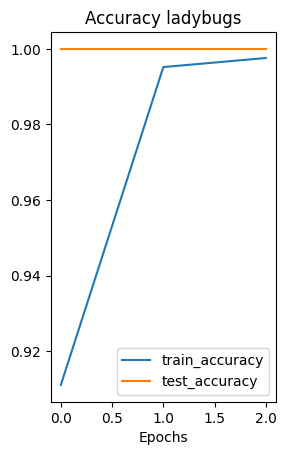

Fold 3
-------
Epoch: 1 | train_loss: 0.3461 | train_acc: 0.9255 | test_loss: 0.1078 | test_acc: 0.9955
Epoch: 2 | train_loss: 0.0806 | train_acc: 0.9904 | test_loss: 0.0437 | test_acc: 0.9955
Epoch: 3 | train_loss: 0.0298 | train_acc: 1.0000 | test_loss: 0.0404 | test_acc: 0.9821


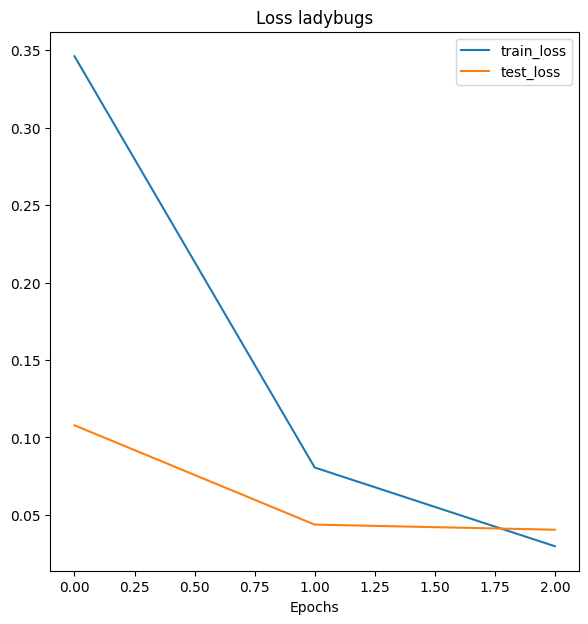

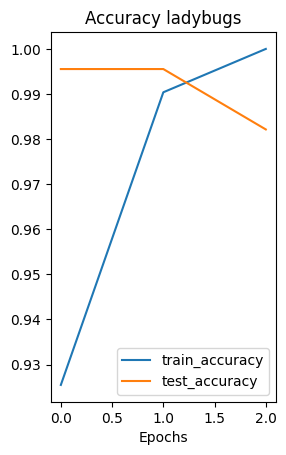

Fold 1
-------
Epoch: 1 | train_loss: 0.3565 | train_acc: 0.9279 | test_loss: 0.2329 | test_acc: 0.9420
Epoch: 2 | train_loss: 0.1046 | train_acc: 0.9904 | test_loss: 0.1039 | test_acc: 0.9732
Epoch: 3 | train_loss: 0.0423 | train_acc: 0.9952 | test_loss: 0.0610 | test_acc: 0.9866


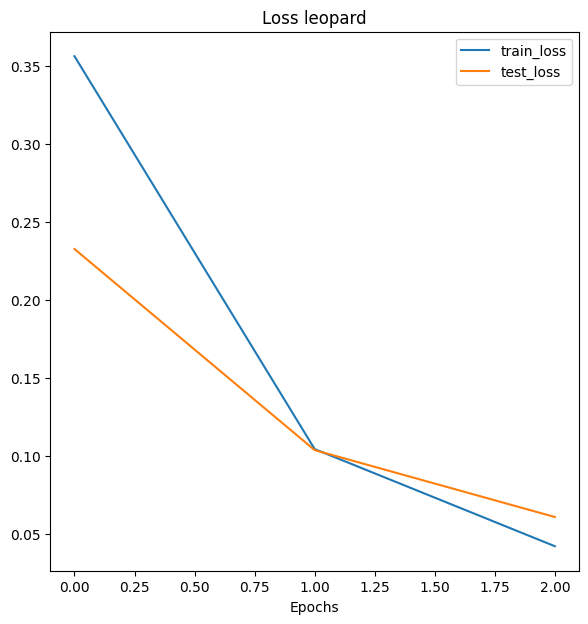

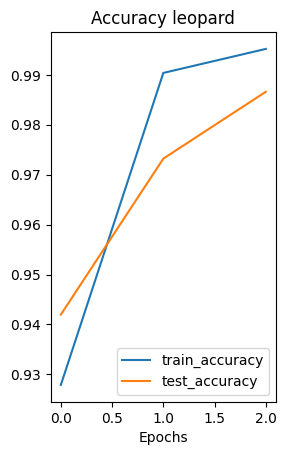

Fold 2
-------
Epoch: 1 | train_loss: 0.3057 | train_acc: 0.9423 | test_loss: 0.1259 | test_acc: 0.9911
Epoch: 2 | train_loss: 0.0724 | train_acc: 0.9880 | test_loss: 0.0599 | test_acc: 0.9911
Epoch: 3 | train_loss: 0.0404 | train_acc: 0.9832 | test_loss: 0.0290 | test_acc: 1.0000


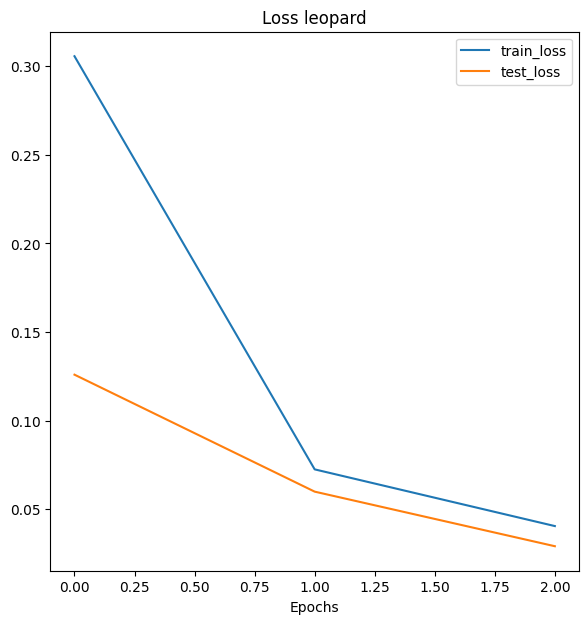

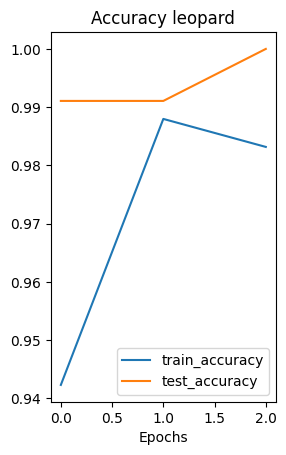

Fold 3
-------
Epoch: 1 | train_loss: 0.3535 | train_acc: 0.8894 | test_loss: 0.1289 | test_acc: 0.9777
Epoch: 2 | train_loss: 0.0672 | train_acc: 0.9928 | test_loss: 0.0529 | test_acc: 0.9955
Epoch: 3 | train_loss: 0.0258 | train_acc: 1.0000 | test_loss: 0.0350 | test_acc: 0.9955


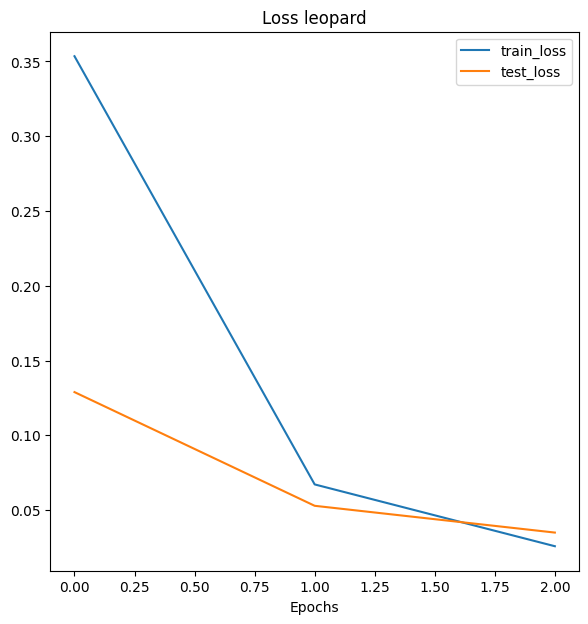

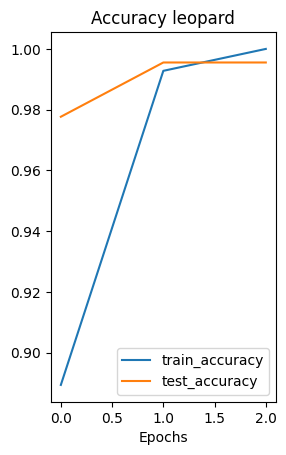

Fold 1
-------
Epoch: 1 | train_loss: 0.3952 | train_acc: 0.8846 | test_loss: 0.2621 | test_acc: 0.9464
Epoch: 2 | train_loss: 0.1459 | train_acc: 0.9615 | test_loss: 0.1404 | test_acc: 0.9598
Epoch: 3 | train_loss: 0.0851 | train_acc: 0.9784 | test_loss: 0.1484 | test_acc: 0.9598


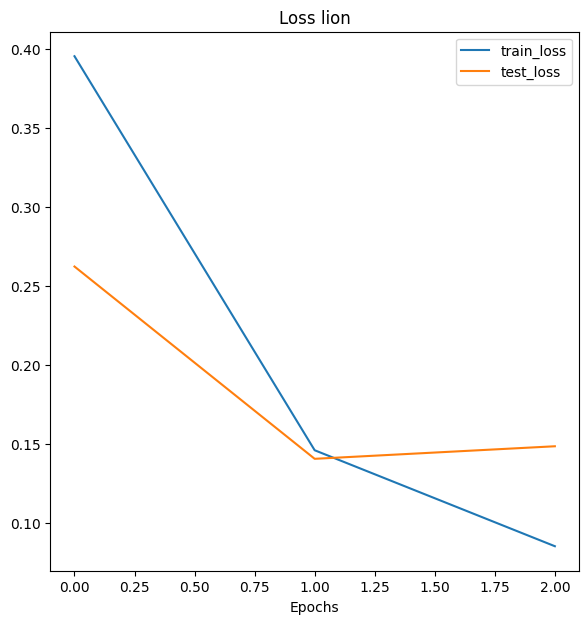

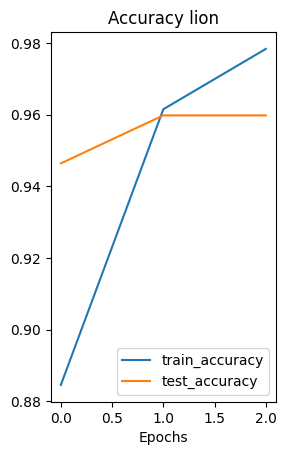

Fold 2
-------
Epoch: 1 | train_loss: 0.3501 | train_acc: 0.9135 | test_loss: 0.1772 | test_acc: 0.9821
Epoch: 2 | train_loss: 0.0920 | train_acc: 0.9856 | test_loss: 0.0980 | test_acc: 0.9688
Epoch: 3 | train_loss: 0.0452 | train_acc: 0.9976 | test_loss: 0.0660 | test_acc: 0.9821


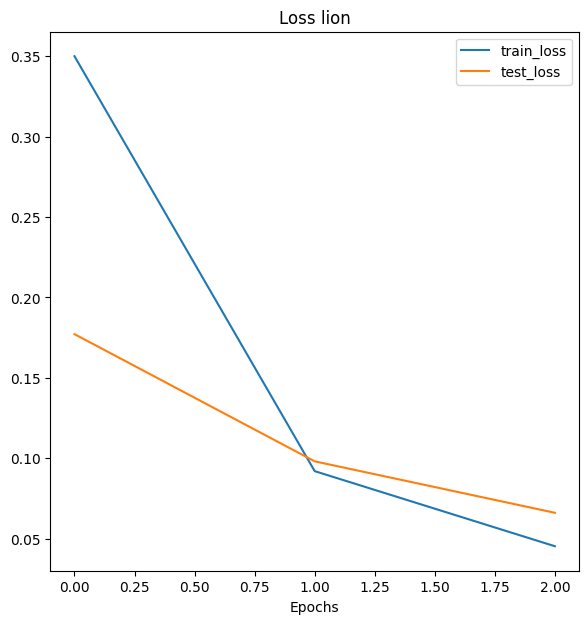

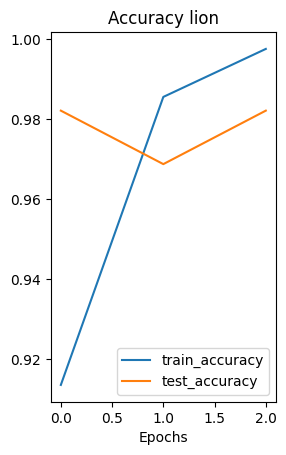

Fold 3
-------
Epoch: 1 | train_loss: 0.3359 | train_acc: 0.9183 | test_loss: 0.1147 | test_acc: 0.9911
Epoch: 2 | train_loss: 0.0783 | train_acc: 0.9880 | test_loss: 0.0528 | test_acc: 0.9955
Epoch: 3 | train_loss: 0.0483 | train_acc: 0.9880 | test_loss: 0.0351 | test_acc: 0.9911


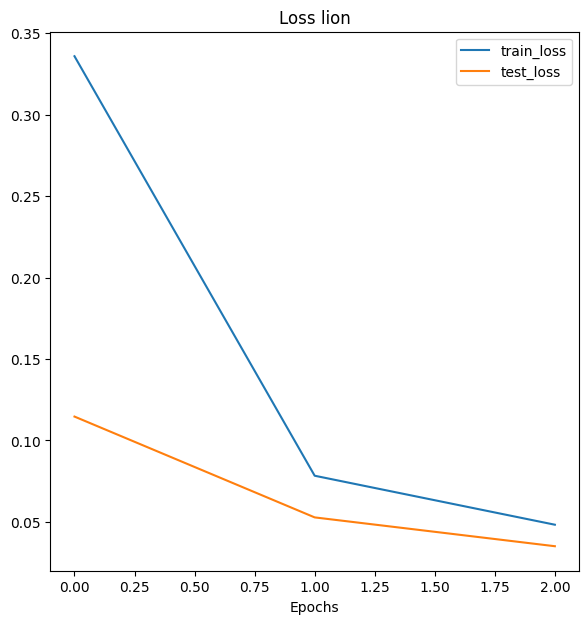

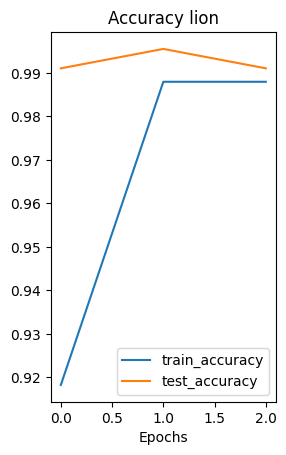

Fold 1
-------
Epoch: 1 | train_loss: 0.4122 | train_acc: 0.9014 | test_loss: 0.2792 | test_acc: 0.9420
Epoch: 2 | train_loss: 0.1725 | train_acc: 0.9615 | test_loss: 0.1575 | test_acc: 0.9643
Epoch: 3 | train_loss: 0.0869 | train_acc: 0.9784 | test_loss: 0.1323 | test_acc: 0.9375


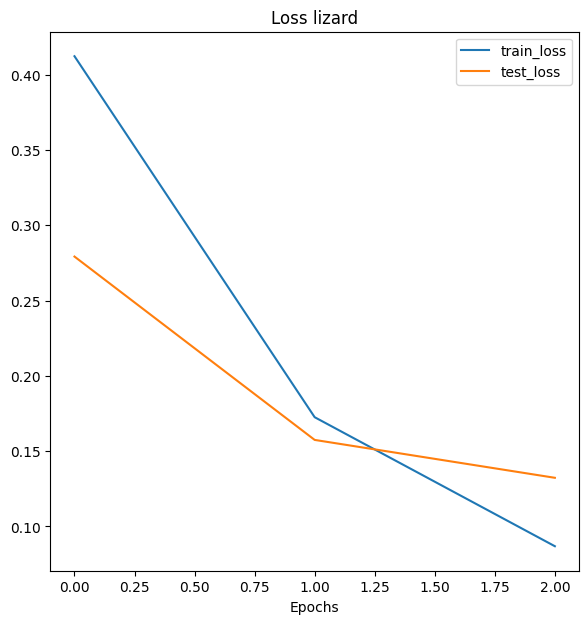

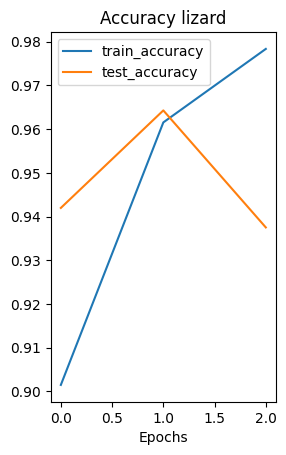

Fold 2
-------
Epoch: 1 | train_loss: 0.4230 | train_acc: 0.8438 | test_loss: 0.2021 | test_acc: 0.9732
Epoch: 2 | train_loss: 0.1252 | train_acc: 0.9832 | test_loss: 0.0998 | test_acc: 0.9955
Epoch: 3 | train_loss: 0.0701 | train_acc: 0.9832 | test_loss: 0.0678 | test_acc: 0.9955


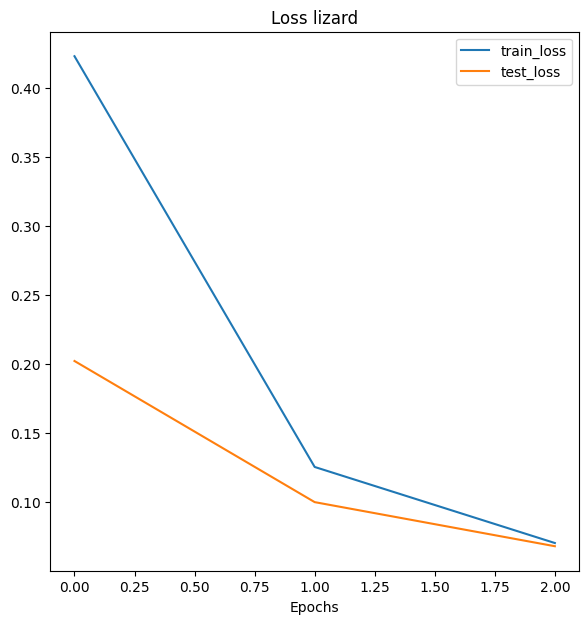

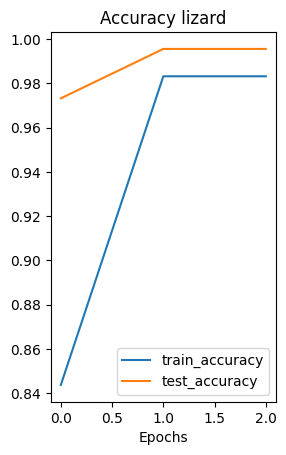

Fold 3
-------
Epoch: 1 | train_loss: 0.3752 | train_acc: 0.9159 | test_loss: 0.1386 | test_acc: 0.9955
Epoch: 2 | train_loss: 0.1237 | train_acc: 0.9736 | test_loss: 0.0593 | test_acc: 0.9955
Epoch: 3 | train_loss: 0.0679 | train_acc: 0.9808 | test_loss: 0.0448 | test_acc: 1.0000


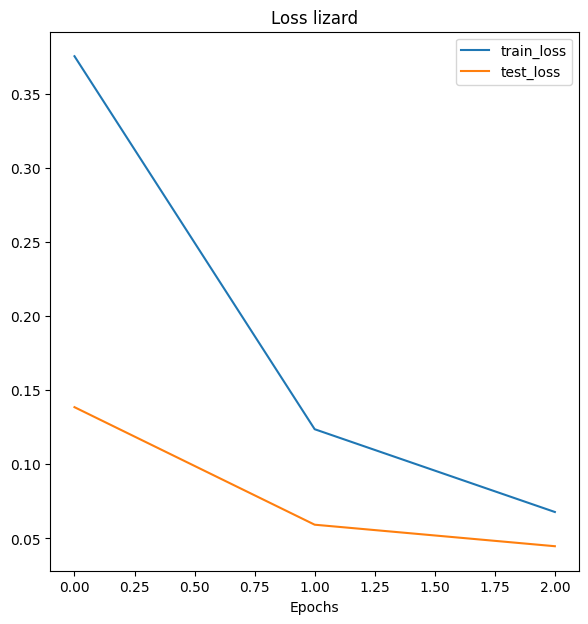

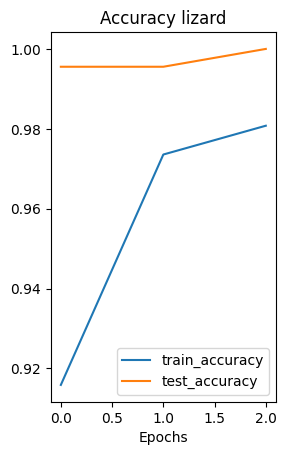

Fold 1
-------
Epoch: 1 | train_loss: 0.4247 | train_acc: 0.8630 | test_loss: 0.2677 | test_acc: 0.9062
Epoch: 2 | train_loss: 0.1457 | train_acc: 0.9736 | test_loss: 0.1380 | test_acc: 0.9688
Epoch: 3 | train_loss: 0.0840 | train_acc: 0.9856 | test_loss: 0.0759 | test_acc: 0.9955


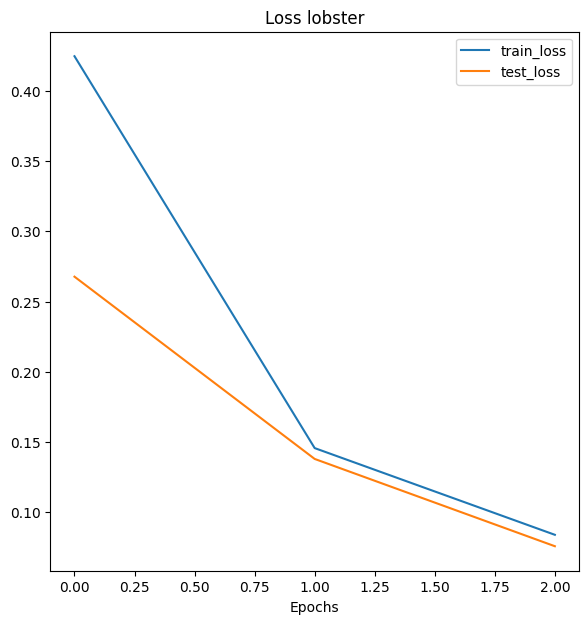

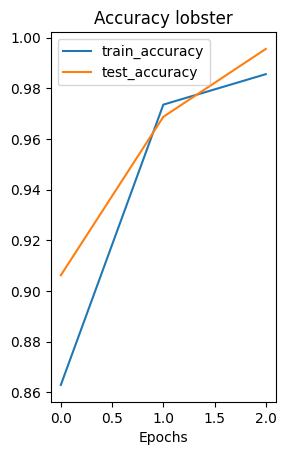

Fold 2
-------
Epoch: 1 | train_loss: 0.3545 | train_acc: 0.9207 | test_loss: 0.1424 | test_acc: 0.9866
Epoch: 2 | train_loss: 0.0841 | train_acc: 0.9976 | test_loss: 0.0720 | test_acc: 0.9911
Epoch: 3 | train_loss: 0.0509 | train_acc: 0.9880 | test_loss: 0.0598 | test_acc: 0.9911


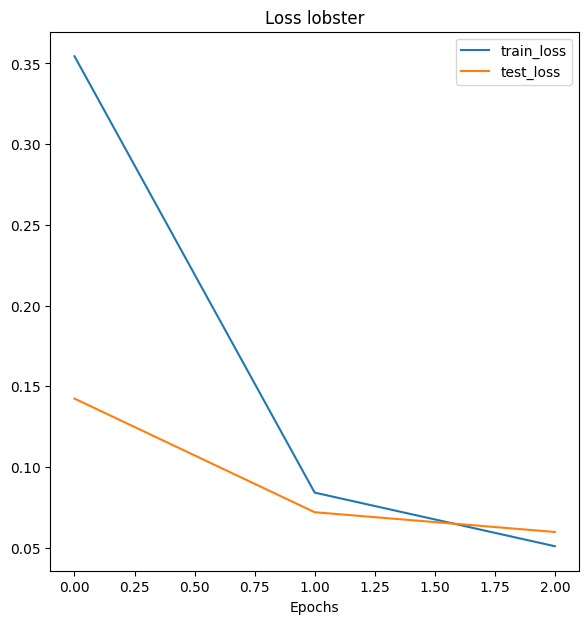

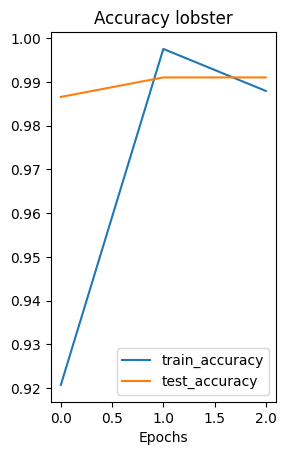

Fold 3
-------
Epoch: 1 | train_loss: 0.3339 | train_acc: 0.9231 | test_loss: 0.1261 | test_acc: 1.0000
Epoch: 2 | train_loss: 0.0749 | train_acc: 0.9952 | test_loss: 0.0588 | test_acc: 0.9955
Epoch: 3 | train_loss: 0.0300 | train_acc: 0.9976 | test_loss: 0.0407 | test_acc: 0.9955


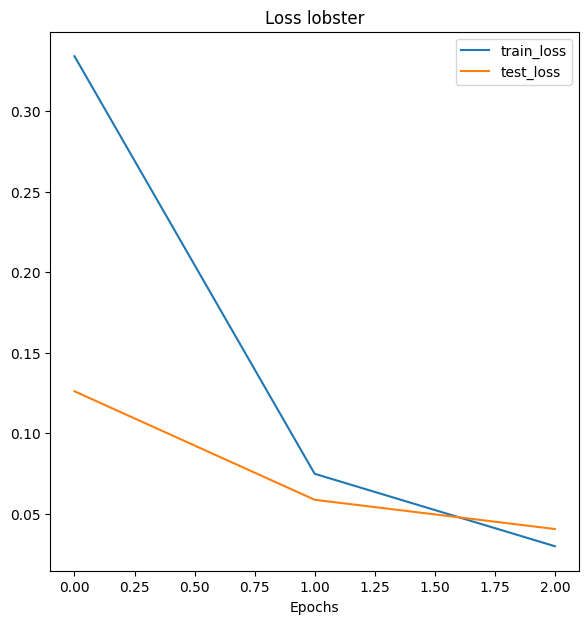

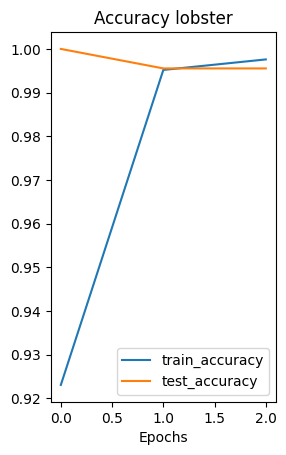

Fold 1
-------
Epoch: 1 | train_loss: 0.3875 | train_acc: 0.9038 | test_loss: 0.2505 | test_acc: 0.9464
Epoch: 2 | train_loss: 0.1225 | train_acc: 0.9832 | test_loss: 0.1140 | test_acc: 0.9777
Epoch: 3 | train_loss: 0.0586 | train_acc: 0.9952 | test_loss: 0.0790 | test_acc: 0.9911


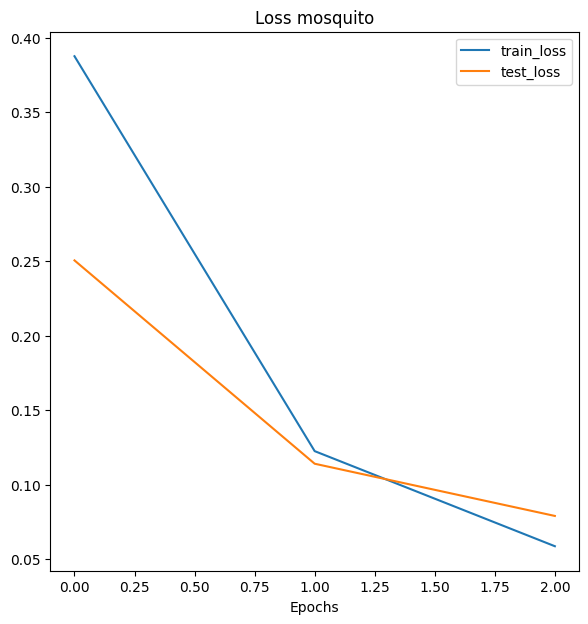

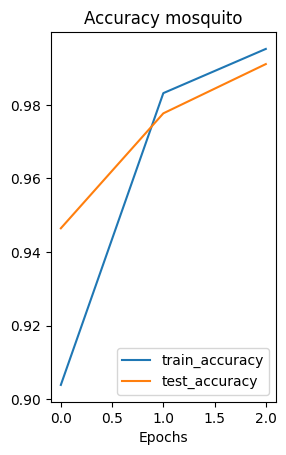

Fold 2
-------
Epoch: 1 | train_loss: 0.3435 | train_acc: 0.9038 | test_loss: 0.1665 | test_acc: 0.9732
Epoch: 2 | train_loss: 0.1018 | train_acc: 0.9832 | test_loss: 0.0767 | test_acc: 0.9955
Epoch: 3 | train_loss: 0.0491 | train_acc: 0.9952 | test_loss: 0.0518 | test_acc: 0.9955


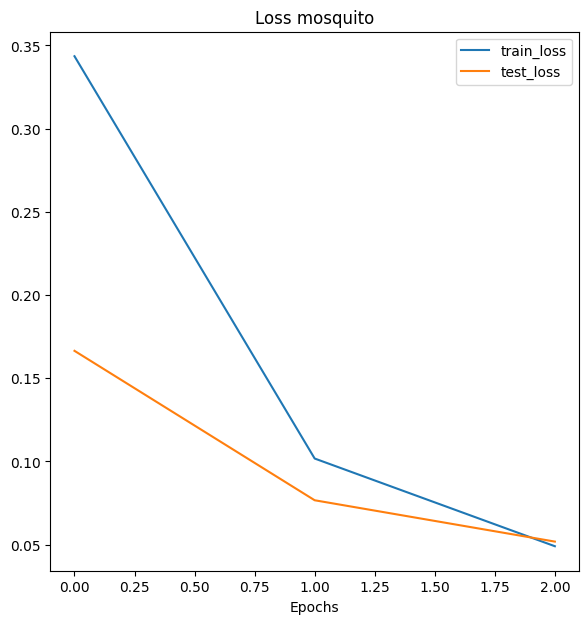

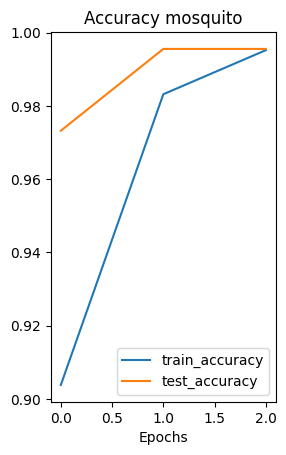

Fold 3
-------
Epoch: 1 | train_loss: 0.3245 | train_acc: 0.9159 | test_loss: 0.0994 | test_acc: 0.9911
Epoch: 2 | train_loss: 0.0723 | train_acc: 0.9952 | test_loss: 0.0455 | test_acc: 0.9911
Epoch: 3 | train_loss: 0.0318 | train_acc: 1.0000 | test_loss: 0.0428 | test_acc: 0.9821


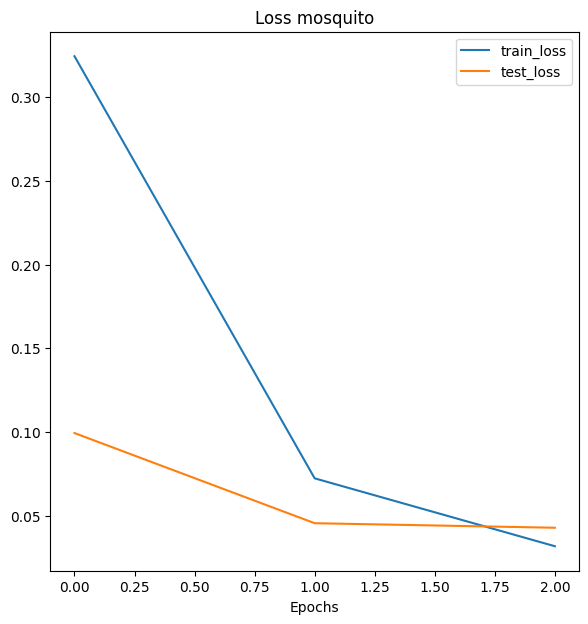

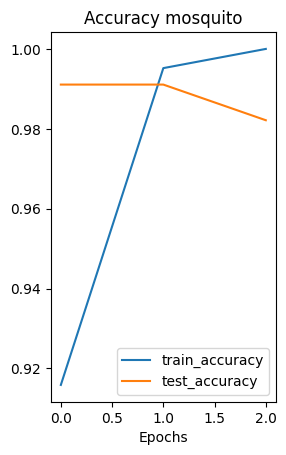

Fold 1
-------
Epoch: 1 | train_loss: 0.4910 | train_acc: 0.8221 | test_loss: 0.3248 | test_acc: 0.9375
Epoch: 2 | train_loss: 0.2279 | train_acc: 0.9351 | test_loss: 0.2137 | test_acc: 0.9509
Epoch: 3 | train_loss: 0.1418 | train_acc: 0.9639 | test_loss: 0.1513 | test_acc: 0.9509


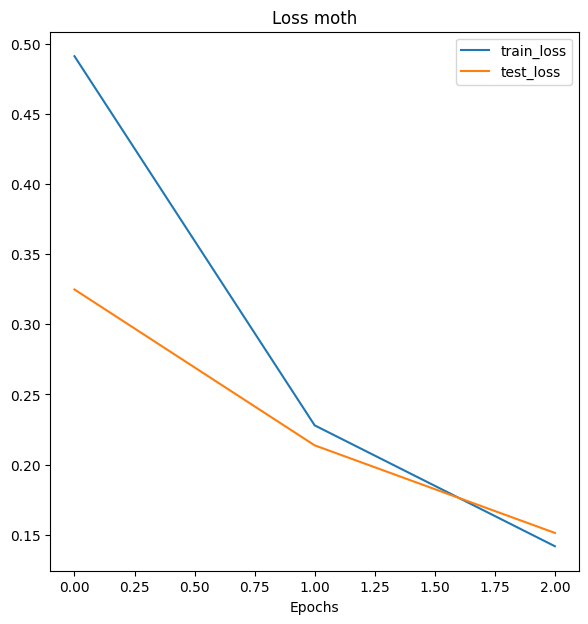

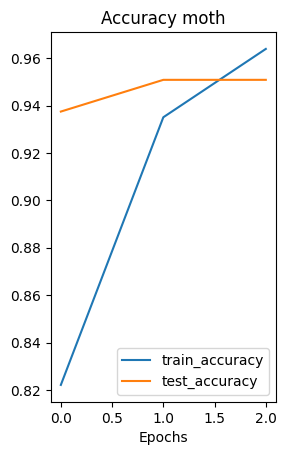

Fold 2
-------
Epoch: 1 | train_loss: 0.4089 | train_acc: 0.8822 | test_loss: 0.2650 | test_acc: 0.9420
Epoch: 2 | train_loss: 0.1500 | train_acc: 0.9688 | test_loss: 0.1563 | test_acc: 0.9509
Epoch: 3 | train_loss: 0.0834 | train_acc: 0.9784 | test_loss: 0.1259 | test_acc: 0.9643


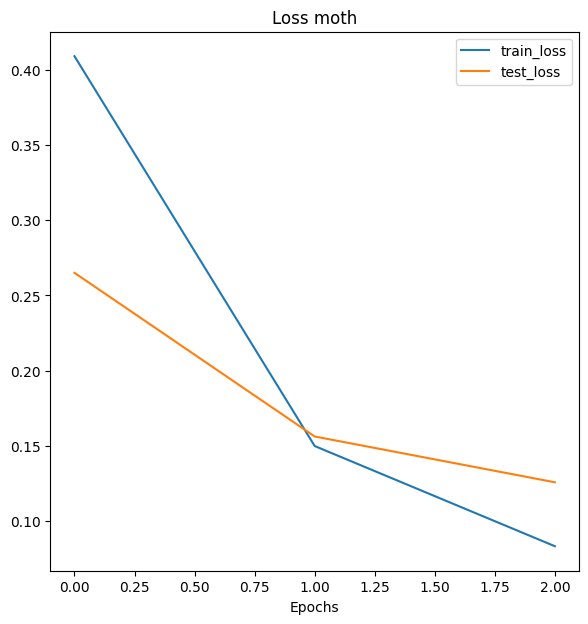

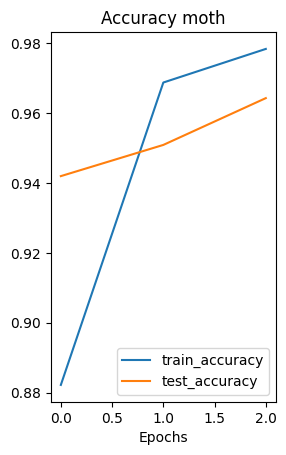

Fold 3
-------
Epoch: 1 | train_loss: 0.3784 | train_acc: 0.9014 | test_loss: 0.1859 | test_acc: 0.9643
Epoch: 2 | train_loss: 0.1269 | train_acc: 0.9688 | test_loss: 0.1184 | test_acc: 0.9420
Epoch: 3 | train_loss: 0.0768 | train_acc: 0.9832 | test_loss: 0.1177 | test_acc: 0.9464


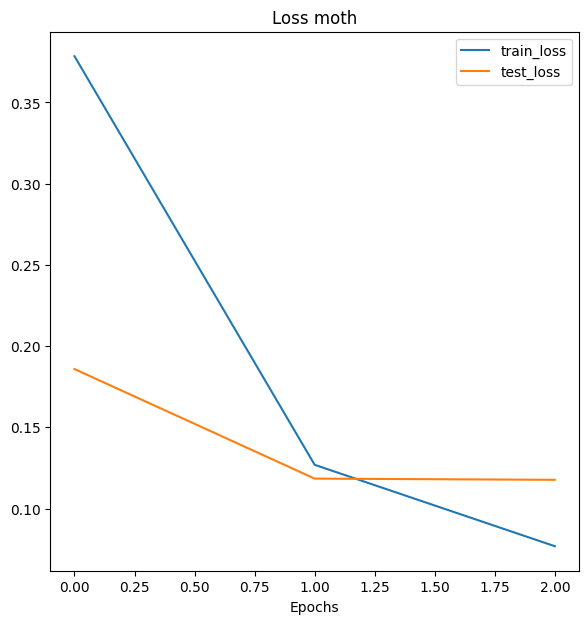

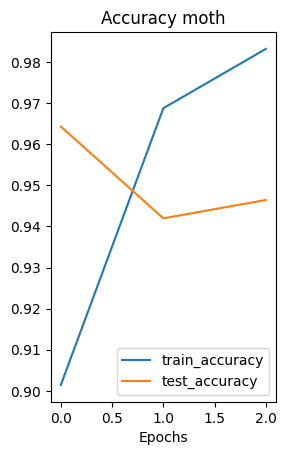

Fold 1
-------
Epoch: 1 | train_loss: 0.4537 | train_acc: 0.8558 | test_loss: 0.3148 | test_acc: 0.9018
Epoch: 2 | train_loss: 0.1822 | train_acc: 0.9399 | test_loss: 0.1693 | test_acc: 0.9643
Epoch: 3 | train_loss: 0.1123 | train_acc: 0.9688 | test_loss: 0.1240 | test_acc: 0.9688


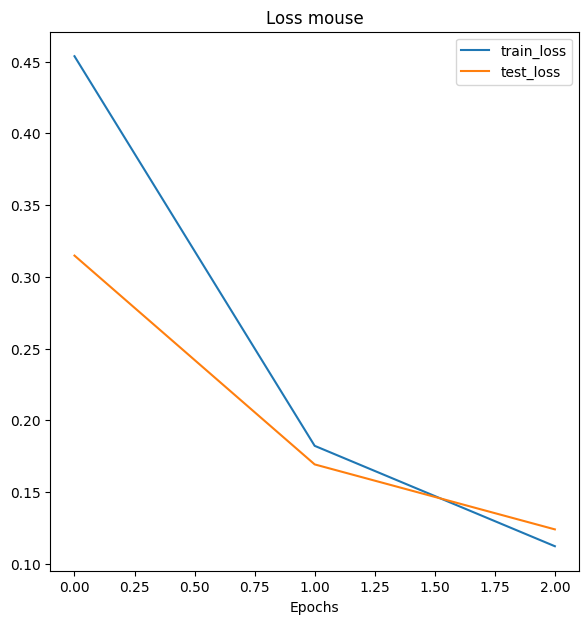

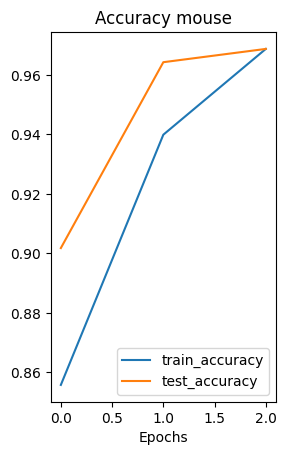

Fold 2
-------
Epoch: 1 | train_loss: 0.4011 | train_acc: 0.8822 | test_loss: 0.2293 | test_acc: 0.9509
Epoch: 2 | train_loss: 0.1328 | train_acc: 0.9688 | test_loss: 0.1355 | test_acc: 0.9732
Epoch: 3 | train_loss: 0.0757 | train_acc: 0.9856 | test_loss: 0.0989 | test_acc: 0.9688


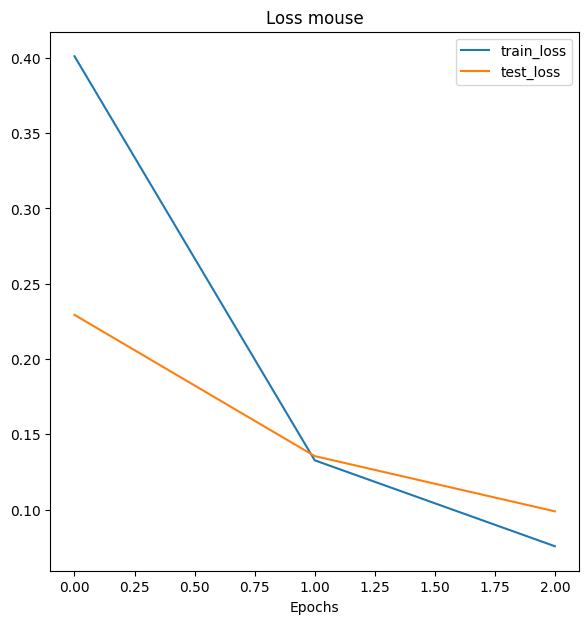

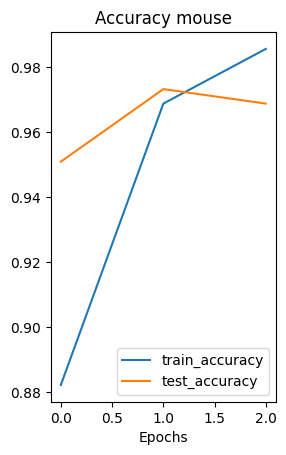

Fold 3
-------
Epoch: 1 | train_loss: 0.3773 | train_acc: 0.8726 | test_loss: 0.1758 | test_acc: 0.9554
Epoch: 2 | train_loss: 0.1164 | train_acc: 0.9784 | test_loss: 0.0840 | test_acc: 0.9866
Epoch: 3 | train_loss: 0.0598 | train_acc: 0.9880 | test_loss: 0.0584 | test_acc: 0.9911


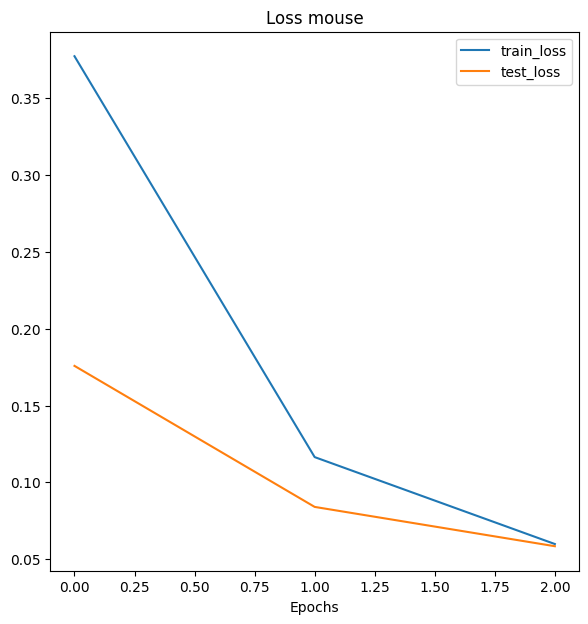

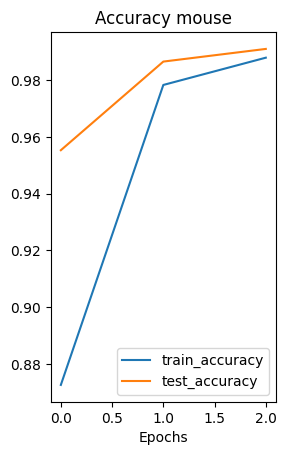

Fold 1
-------
Epoch: 1 | train_loss: 0.4652 | train_acc: 0.8413 | test_loss: 0.3390 | test_acc: 0.9464
Epoch: 2 | train_loss: 0.2062 | train_acc: 0.9303 | test_loss: 0.2517 | test_acc: 0.9509
Epoch: 3 | train_loss: 0.1024 | train_acc: 0.9808 | test_loss: 0.2011 | test_acc: 0.9420


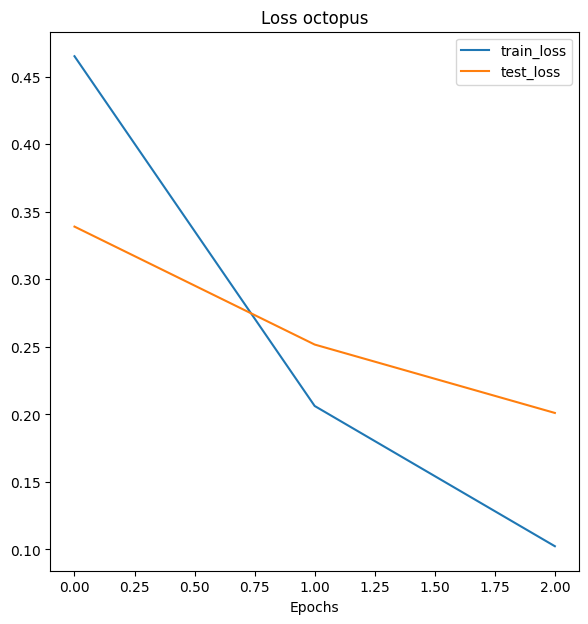

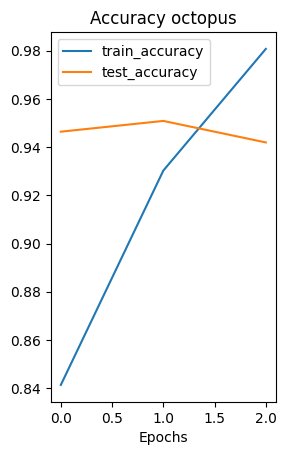

Fold 2
-------
Epoch: 1 | train_loss: 0.4297 | train_acc: 0.8678 | test_loss: 0.2143 | test_acc: 0.9554
Epoch: 2 | train_loss: 0.1410 | train_acc: 0.9736 | test_loss: 0.1491 | test_acc: 0.9509
Epoch: 3 | train_loss: 0.0822 | train_acc: 0.9808 | test_loss: 0.1093 | test_acc: 0.9643


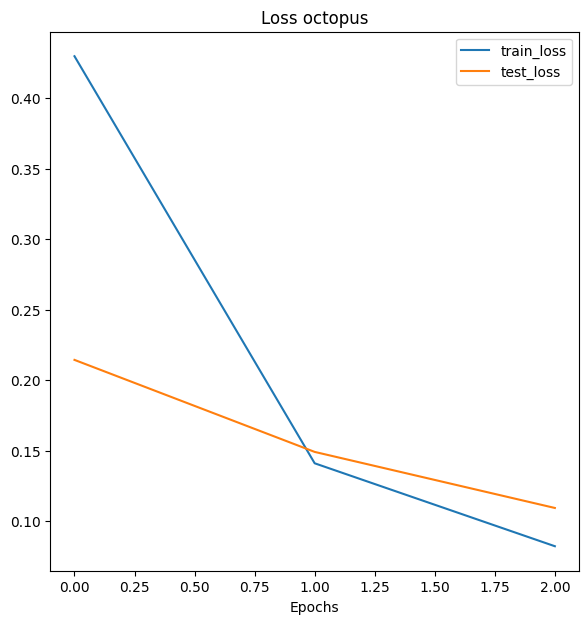

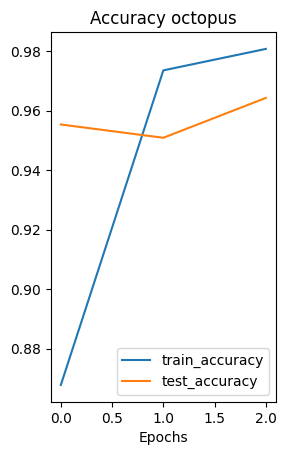

Fold 3
-------
Epoch: 1 | train_loss: 0.3814 | train_acc: 0.8942 | test_loss: 0.1418 | test_acc: 0.9866
Epoch: 2 | train_loss: 0.1372 | train_acc: 0.9591 | test_loss: 0.0722 | test_acc: 0.9911
Epoch: 3 | train_loss: 0.0617 | train_acc: 0.9928 | test_loss: 0.0530 | test_acc: 0.9911


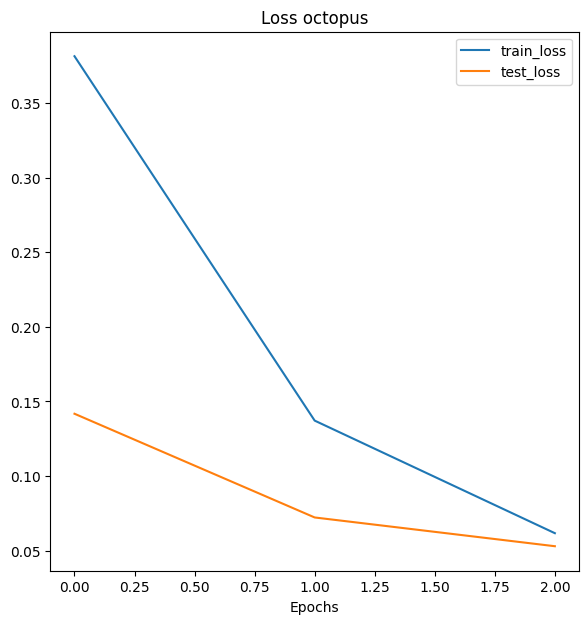

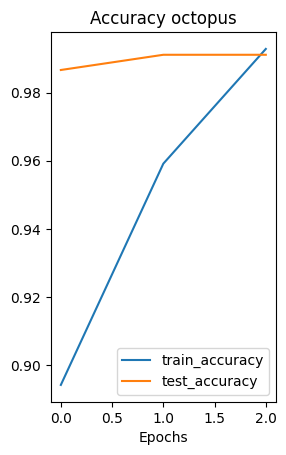

Fold 1
-------
Epoch: 1 | train_loss: 0.4198 | train_acc: 0.8774 | test_loss: 0.2627 | test_acc: 0.9509
Epoch: 2 | train_loss: 0.1366 | train_acc: 0.9832 | test_loss: 0.1278 | test_acc: 0.9777
Epoch: 3 | train_loss: 0.0576 | train_acc: 0.9928 | test_loss: 0.0758 | test_acc: 0.9866


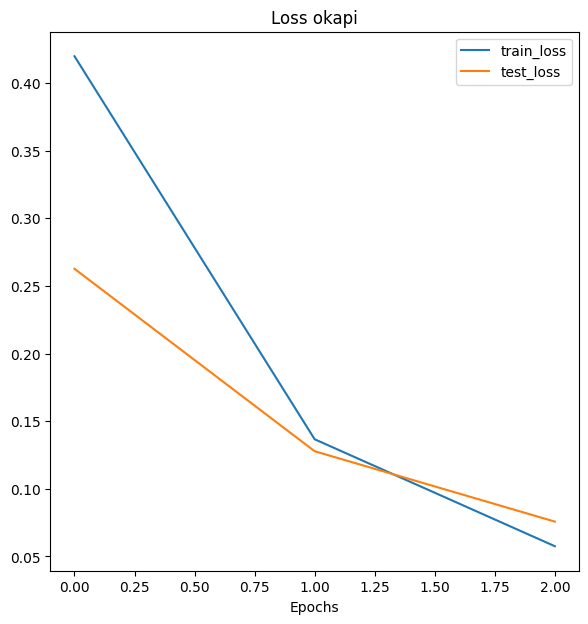

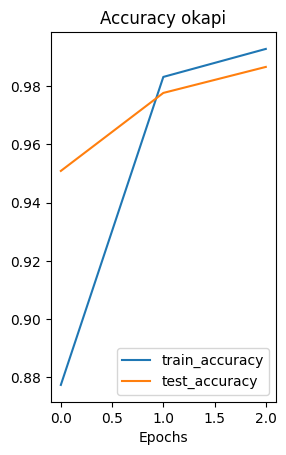

Fold 2
-------
Epoch: 1 | train_loss: 0.3707 | train_acc: 0.9159 | test_loss: 0.1707 | test_acc: 0.9777
Epoch: 2 | train_loss: 0.0875 | train_acc: 0.9928 | test_loss: 0.0849 | test_acc: 0.9821
Epoch: 3 | train_loss: 0.0394 | train_acc: 0.9952 | test_loss: 0.0577 | test_acc: 0.9911


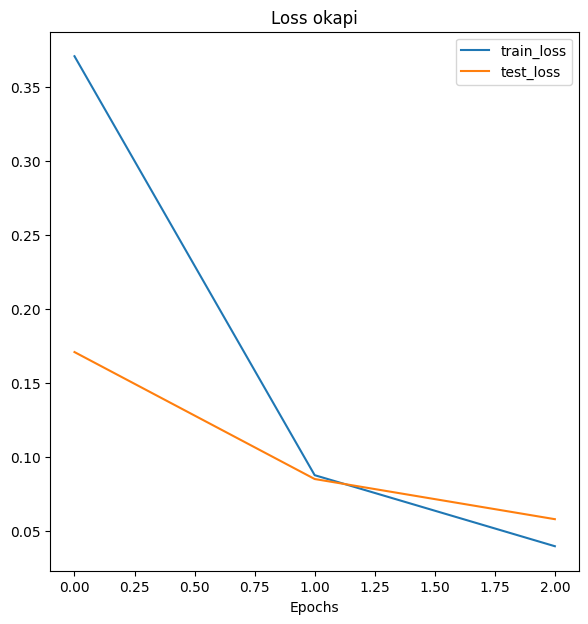

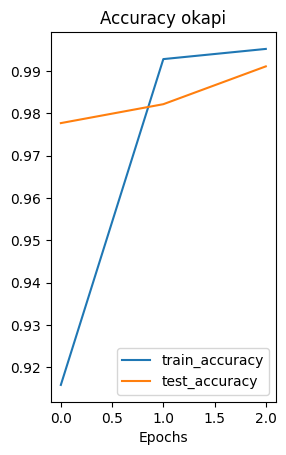

Fold 3
-------
Epoch: 1 | train_loss: 0.3673 | train_acc: 0.8894 | test_loss: 0.1298 | test_acc: 1.0000
Epoch: 2 | train_loss: 0.0909 | train_acc: 0.9832 | test_loss: 0.0476 | test_acc: 1.0000
Epoch: 3 | train_loss: 0.0405 | train_acc: 0.9952 | test_loss: 0.0318 | test_acc: 1.0000


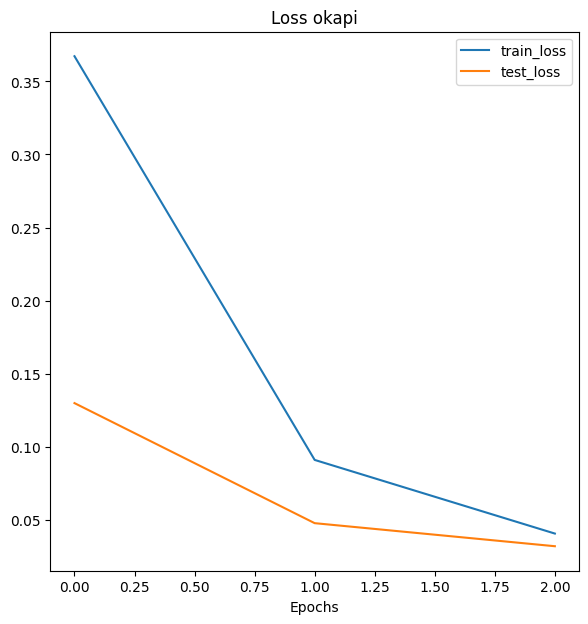

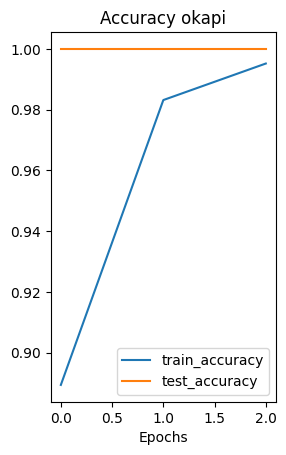

Fold 1
-------
Epoch: 1 | train_loss: 0.4076 | train_acc: 0.8678 | test_loss: 0.2366 | test_acc: 0.9554
Epoch: 2 | train_loss: 0.1245 | train_acc: 0.9784 | test_loss: 0.1290 | test_acc: 0.9509
Epoch: 3 | train_loss: 0.0649 | train_acc: 0.9904 | test_loss: 0.0867 | test_acc: 0.9821


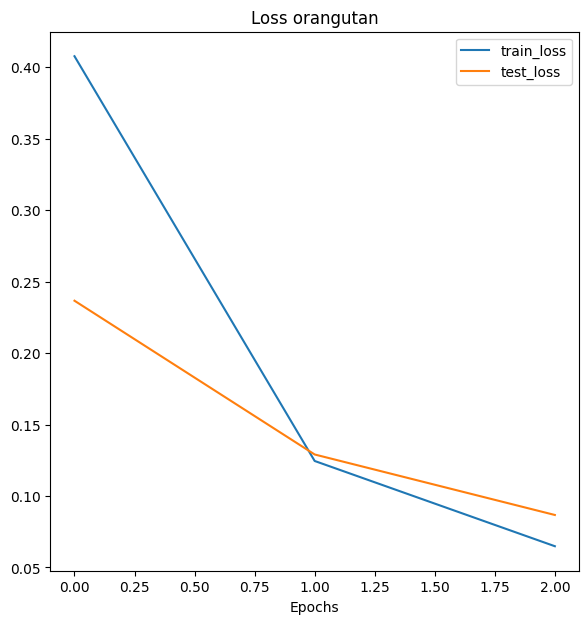

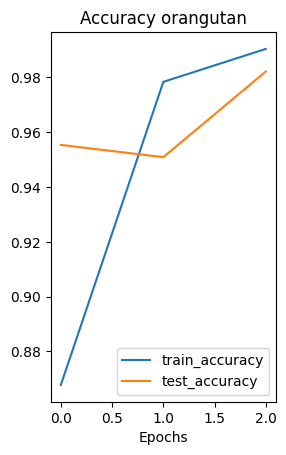

Fold 2
-------
Epoch: 1 | train_loss: 0.3514 | train_acc: 0.8822 | test_loss: 0.1485 | test_acc: 0.9911
Epoch: 2 | train_loss: 0.0810 | train_acc: 0.9928 | test_loss: 0.0653 | test_acc: 0.9911
Epoch: 3 | train_loss: 0.0369 | train_acc: 0.9952 | test_loss: 0.0392 | test_acc: 0.9911


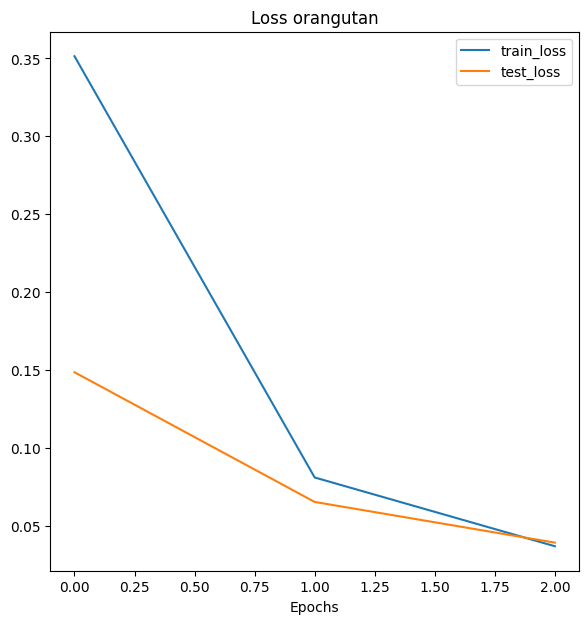

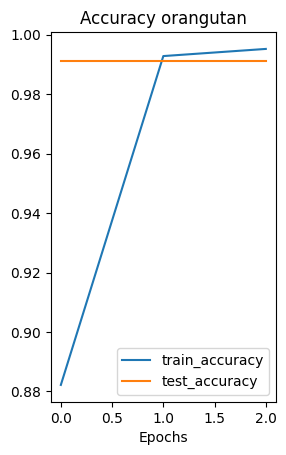

Fold 3
-------
Epoch: 1 | train_loss: 0.3671 | train_acc: 0.8750 | test_loss: 0.0983 | test_acc: 1.0000
Epoch: 2 | train_loss: 0.0776 | train_acc: 0.9928 | test_loss: 0.0400 | test_acc: 1.0000
Epoch: 3 | train_loss: 0.0339 | train_acc: 0.9952 | test_loss: 0.0200 | test_acc: 1.0000


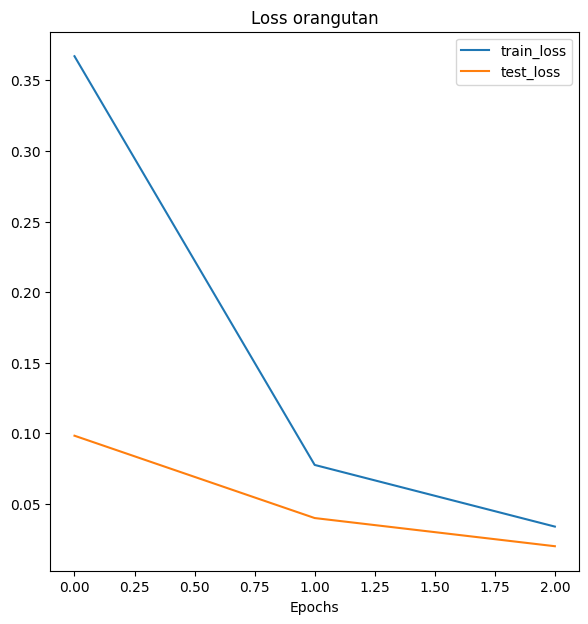

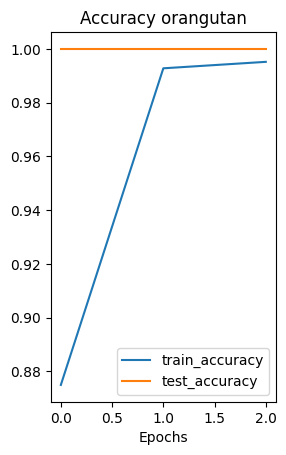

Fold 1
-------
Epoch: 1 | train_loss: 0.4429 | train_acc: 0.8317 | test_loss: 0.2895 | test_acc: 0.9688
Epoch: 2 | train_loss: 0.1502 | train_acc: 0.9712 | test_loss: 0.1871 | test_acc: 0.9643
Epoch: 3 | train_loss: 0.0741 | train_acc: 0.9904 | test_loss: 0.1111 | test_acc: 0.9821


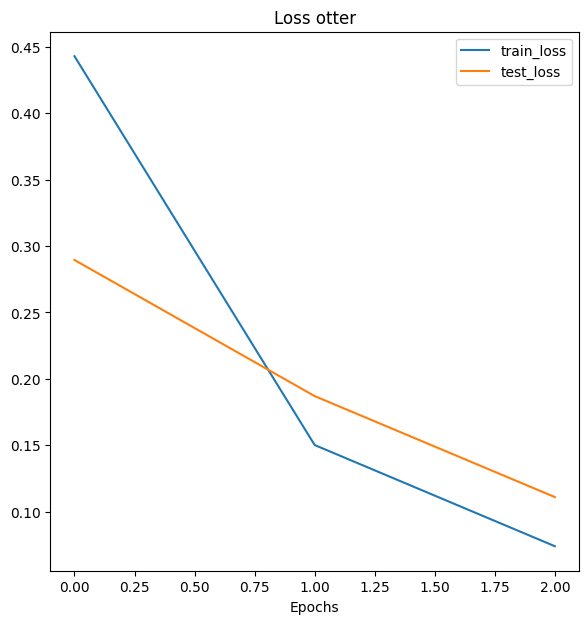

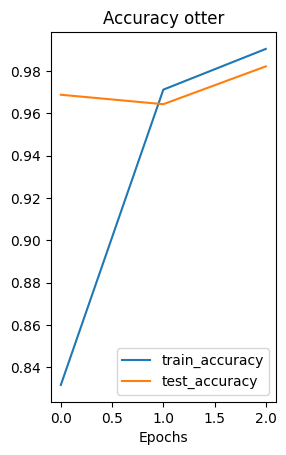

Fold 2
-------
Epoch: 1 | train_loss: 0.3822 | train_acc: 0.9014 | test_loss: 0.1671 | test_acc: 1.0000
Epoch: 2 | train_loss: 0.1171 | train_acc: 0.9904 | test_loss: 0.0627 | test_acc: 0.9955
Epoch: 3 | train_loss: 0.0542 | train_acc: 0.9880 | test_loss: 0.0488 | test_acc: 0.9955


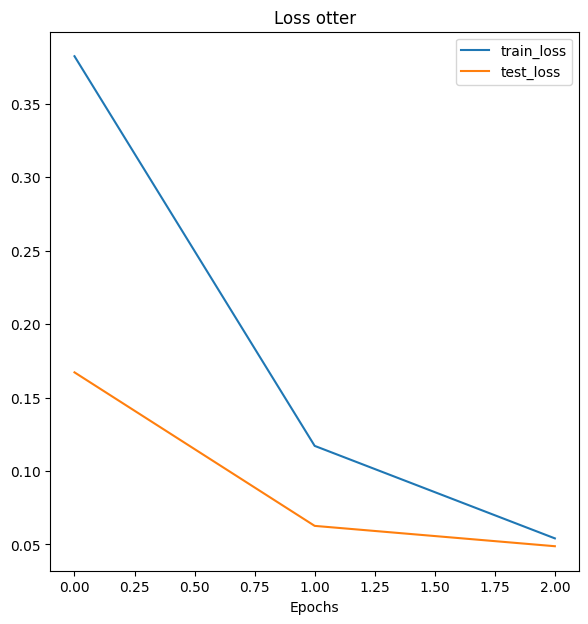

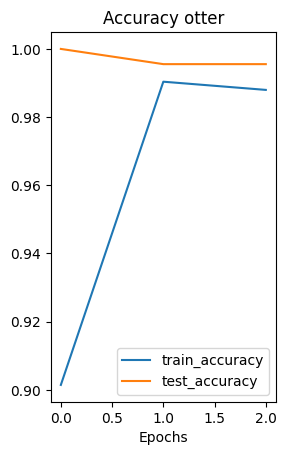

Fold 3
-------
Epoch: 1 | train_loss: 0.3161 | train_acc: 0.9591 | test_loss: 0.1064 | test_acc: 0.9955
Epoch: 2 | train_loss: 0.0775 | train_acc: 0.9904 | test_loss: 0.0508 | test_acc: 0.9955
Epoch: 3 | train_loss: 0.0364 | train_acc: 0.9904 | test_loss: 0.0463 | test_acc: 0.9777


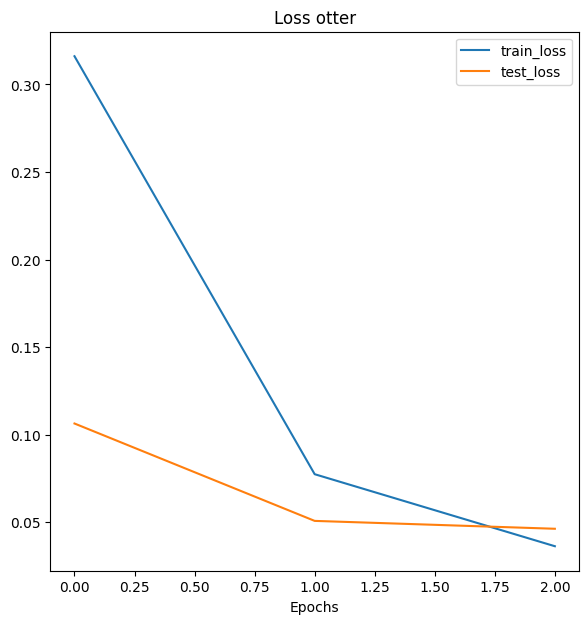

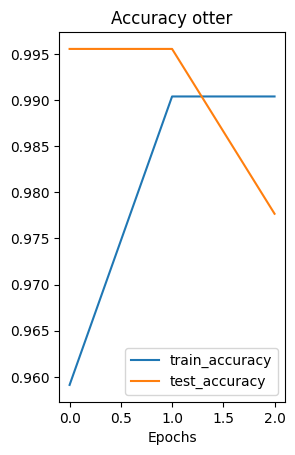

Fold 1
-------
Epoch: 1 | train_loss: 0.4425 | train_acc: 0.8654 | test_loss: 0.3467 | test_acc: 0.8795
Epoch: 2 | train_loss: 0.1800 | train_acc: 0.9615 | test_loss: 0.2012 | test_acc: 0.9375
Epoch: 3 | train_loss: 0.0848 | train_acc: 0.9904 | test_loss: 0.1606 | test_acc: 0.9554


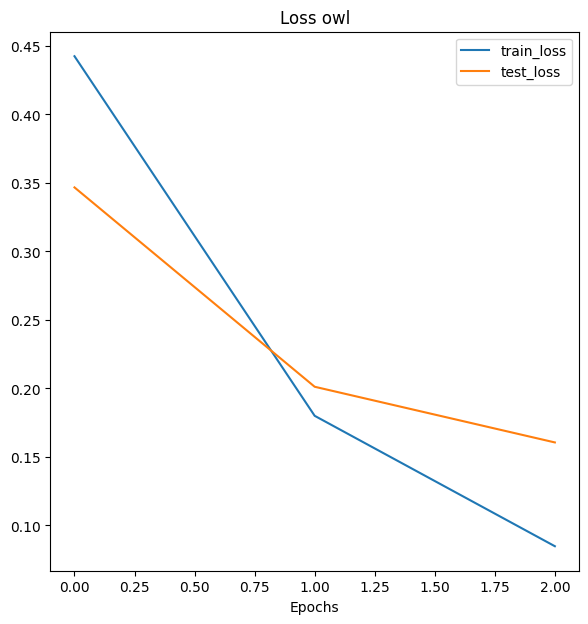

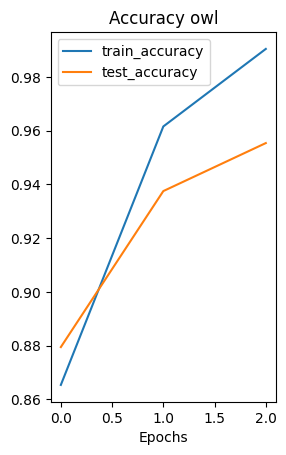

Fold 2
-------
Epoch: 1 | train_loss: 0.4077 | train_acc: 0.8846 | test_loss: 0.2134 | test_acc: 0.9732
Epoch: 2 | train_loss: 0.1331 | train_acc: 0.9760 | test_loss: 0.1158 | test_acc: 0.9866
Epoch: 3 | train_loss: 0.0703 | train_acc: 0.9904 | test_loss: 0.0708 | test_acc: 0.9911


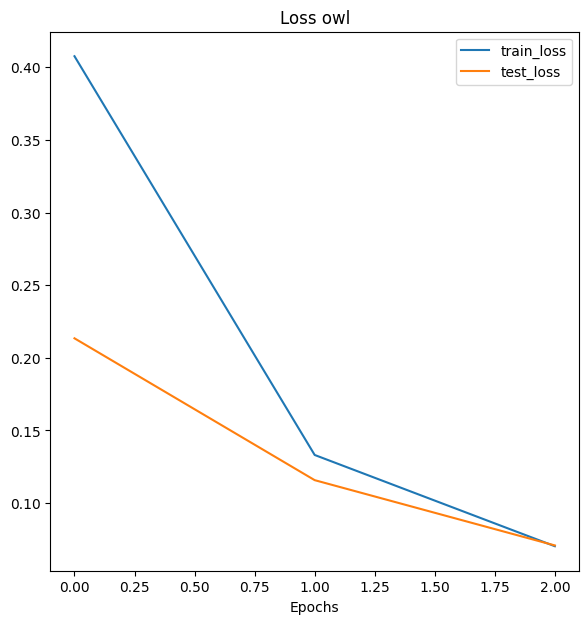

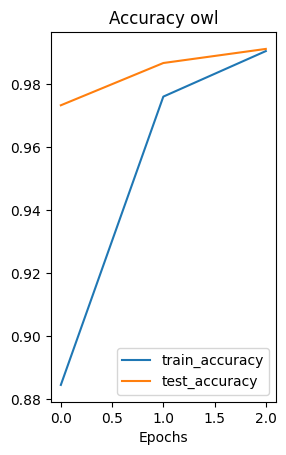

Fold 3
-------
Epoch: 1 | train_loss: 0.3579 | train_acc: 0.9135 | test_loss: 0.1170 | test_acc: 1.0000
Epoch: 2 | train_loss: 0.1012 | train_acc: 0.9808 | test_loss: 0.0459 | test_acc: 1.0000
Epoch: 3 | train_loss: 0.0565 | train_acc: 0.9880 | test_loss: 0.0271 | test_acc: 1.0000


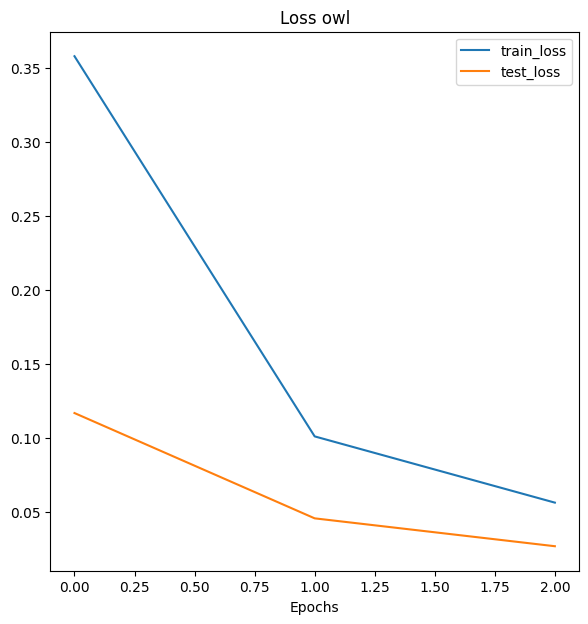

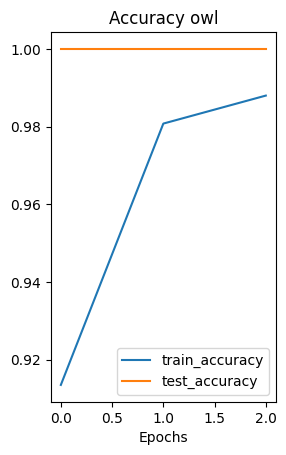

Fold 1
-------
Epoch: 1 | train_loss: 0.4710 | train_acc: 0.8077 | test_loss: 0.3092 | test_acc: 0.9509
Epoch: 2 | train_loss: 0.2188 | train_acc: 0.9183 | test_loss: 0.1989 | test_acc: 0.9598
Epoch: 3 | train_loss: 0.1343 | train_acc: 0.9639 | test_loss: 0.1518 | test_acc: 0.9598


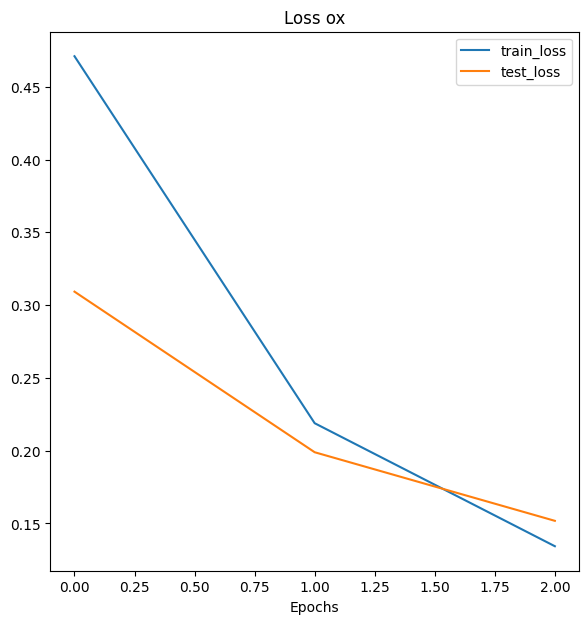

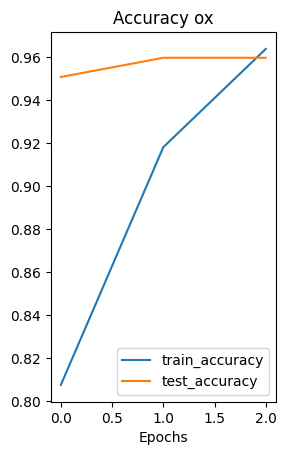

Fold 2
-------
Epoch: 1 | train_loss: 0.4074 | train_acc: 0.8870 | test_loss: 0.2486 | test_acc: 0.9375
Epoch: 2 | train_loss: 0.1428 | train_acc: 0.9688 | test_loss: 0.1621 | test_acc: 0.9375
Epoch: 3 | train_loss: 0.0819 | train_acc: 0.9808 | test_loss: 0.1234 | test_acc: 0.9420


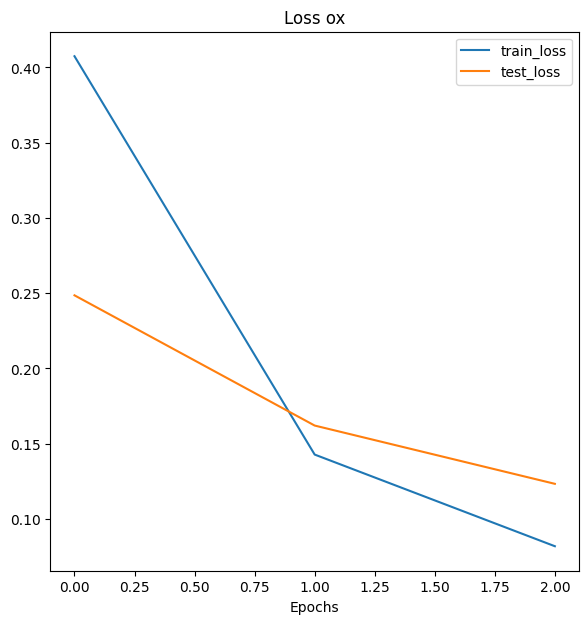

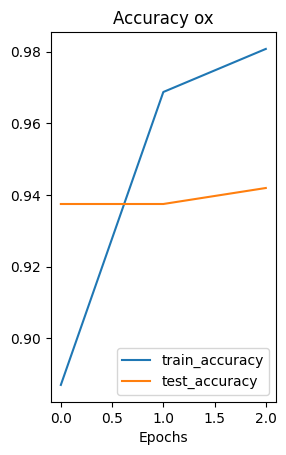

Fold 3
-------
Epoch: 1 | train_loss: 0.3650 | train_acc: 0.9135 | test_loss: 0.1590 | test_acc: 0.9777
Epoch: 2 | train_loss: 0.1236 | train_acc: 0.9736 | test_loss: 0.1024 | test_acc: 0.9598
Epoch: 3 | train_loss: 0.0915 | train_acc: 0.9688 | test_loss: 0.0535 | test_acc: 0.9955


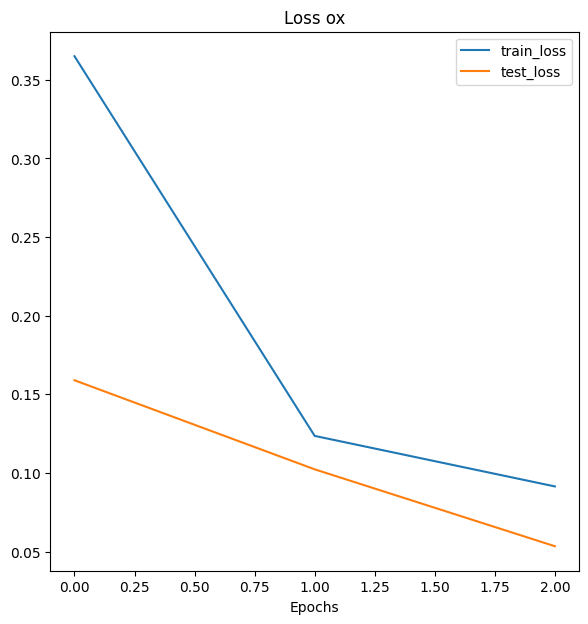

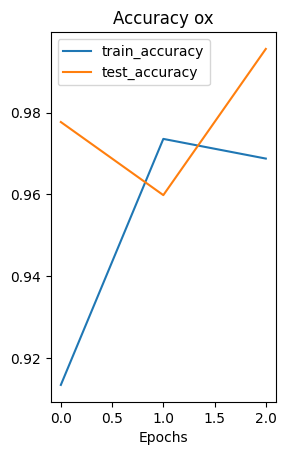

Fold 1
-------
Epoch: 1 | train_loss: 0.4066 | train_acc: 0.9062 | test_loss: 0.2405 | test_acc: 0.9777
Epoch: 2 | train_loss: 0.1105 | train_acc: 0.9928 | test_loss: 0.1089 | test_acc: 0.9821
Epoch: 3 | train_loss: 0.0450 | train_acc: 0.9976 | test_loss: 0.0703 | test_acc: 0.9866


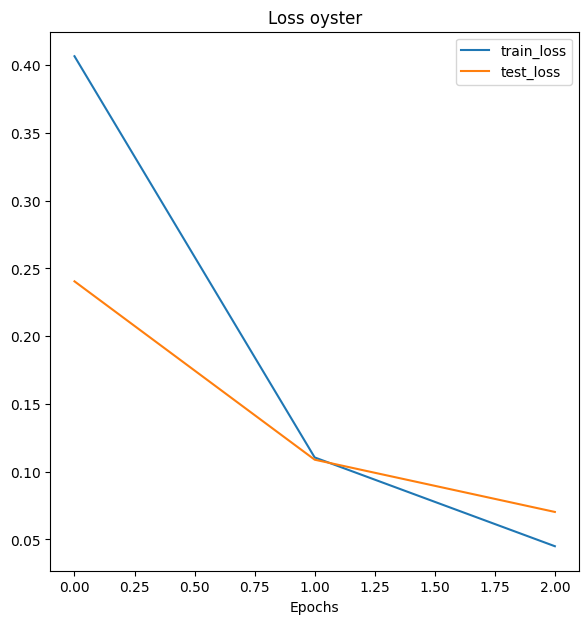

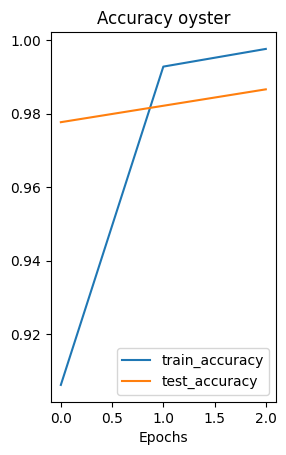

Fold 2
-------
Epoch: 1 | train_loss: 0.3053 | train_acc: 0.9688 | test_loss: 0.1154 | test_acc: 1.0000
Epoch: 2 | train_loss: 0.0617 | train_acc: 0.9976 | test_loss: 0.0468 | test_acc: 1.0000
Epoch: 3 | train_loss: 0.0275 | train_acc: 1.0000 | test_loss: 0.0272 | test_acc: 1.0000


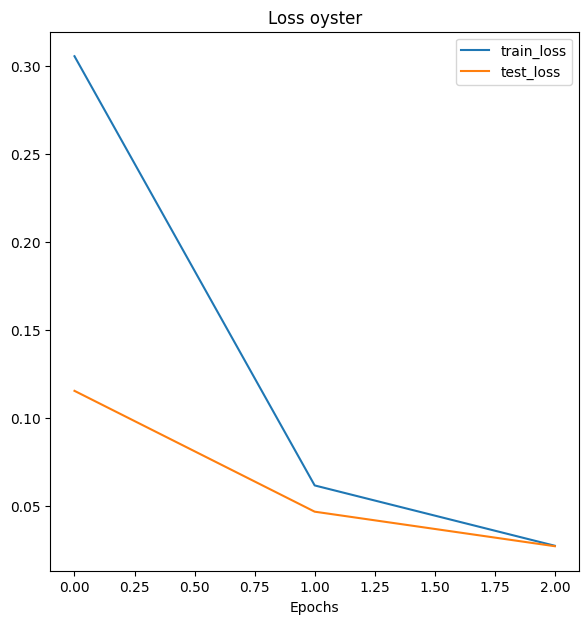

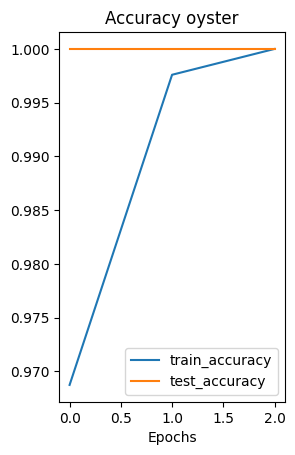

Fold 3
-------
Epoch: 1 | train_loss: 0.3018 | train_acc: 0.9351 | test_loss: 0.1023 | test_acc: 1.0000
Epoch: 2 | train_loss: 0.0592 | train_acc: 0.9976 | test_loss: 0.0409 | test_acc: 1.0000
Epoch: 3 | train_loss: 0.0356 | train_acc: 0.9952 | test_loss: 0.0254 | test_acc: 1.0000


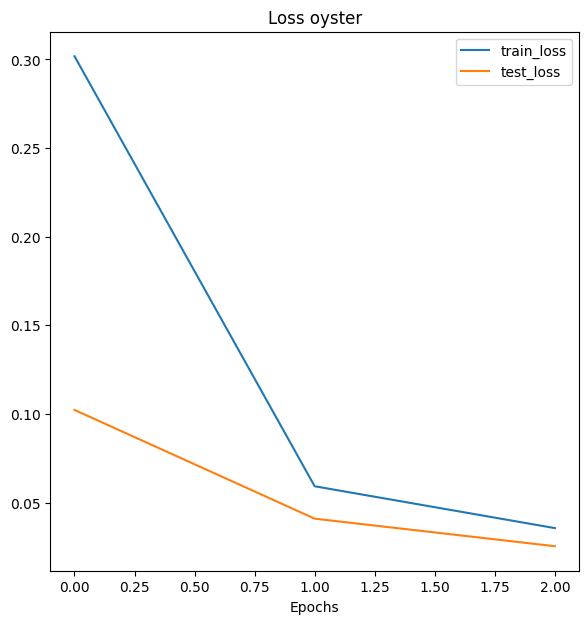

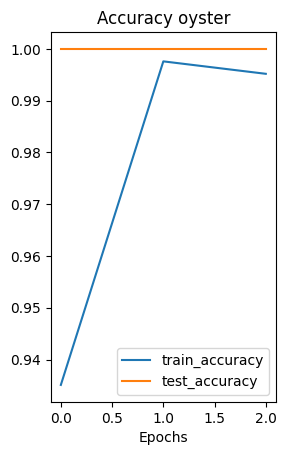

Fold 1
-------
Epoch: 1 | train_loss: 0.3803 | train_acc: 0.8894 | test_loss: 0.2261 | test_acc: 0.9821
Epoch: 2 | train_loss: 0.1079 | train_acc: 0.9880 | test_loss: 0.0966 | test_acc: 0.9911
Epoch: 3 | train_loss: 0.0565 | train_acc: 0.9928 | test_loss: 0.0714 | test_acc: 0.9866


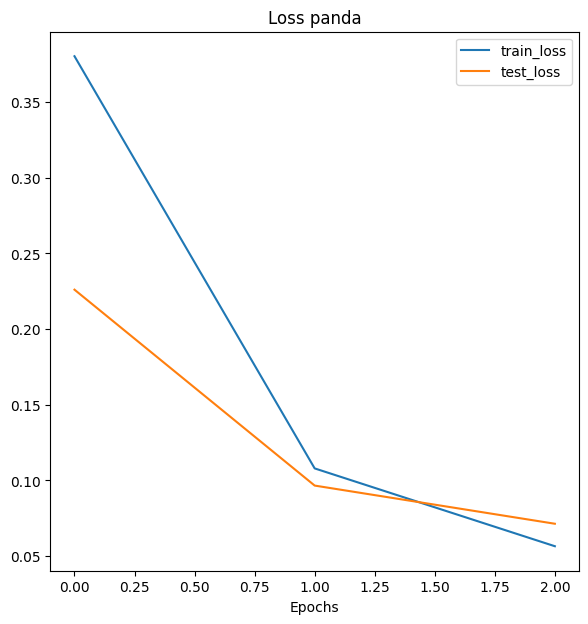

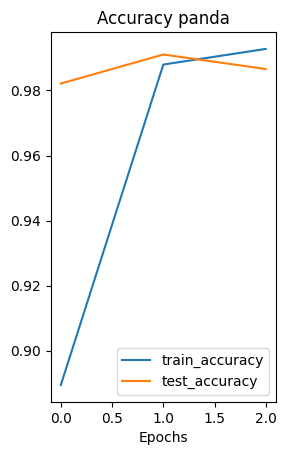

Fold 2
-------
Epoch: 1 | train_loss: 0.3602 | train_acc: 0.8966 | test_loss: 0.1452 | test_acc: 0.9911
Epoch: 2 | train_loss: 0.0751 | train_acc: 0.9976 | test_loss: 0.0633 | test_acc: 0.9911
Epoch: 3 | train_loss: 0.0451 | train_acc: 0.9928 | test_loss: 0.0634 | test_acc: 0.9777


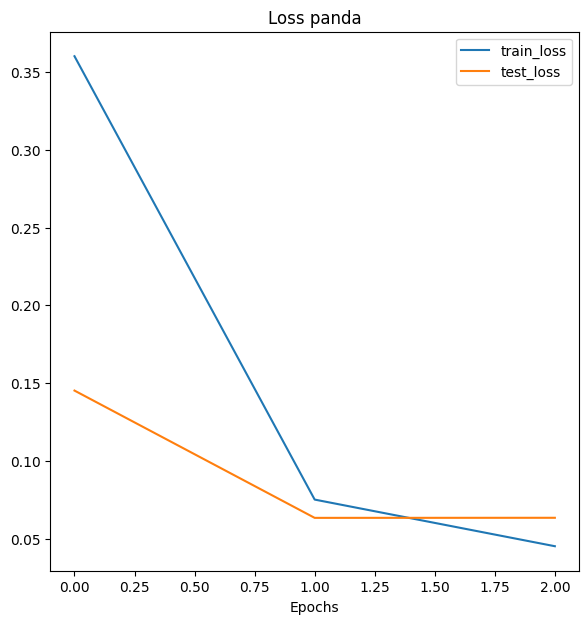

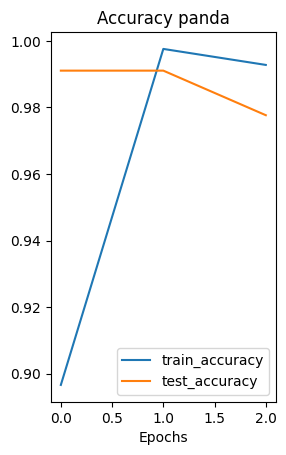

Fold 3
-------
Epoch: 1 | train_loss: 0.3194 | train_acc: 0.9399 | test_loss: 0.1055 | test_acc: 0.9911
Epoch: 2 | train_loss: 0.0692 | train_acc: 0.9928 | test_loss: 0.0449 | test_acc: 0.9955
Epoch: 3 | train_loss: 0.0269 | train_acc: 0.9976 | test_loss: 0.0313 | test_acc: 0.9955


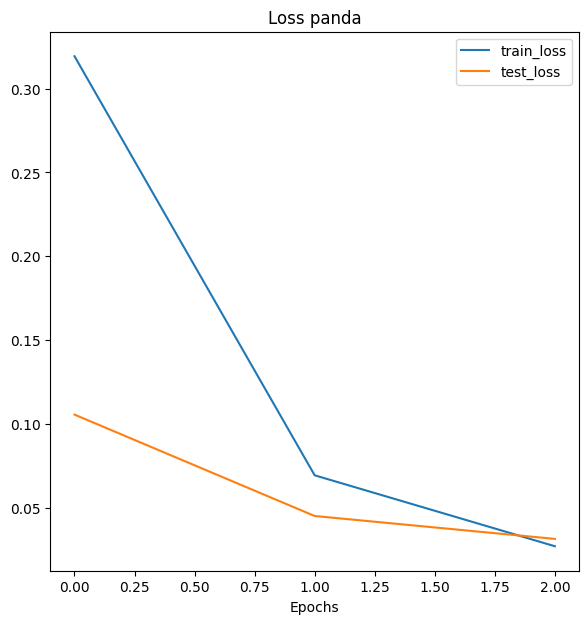

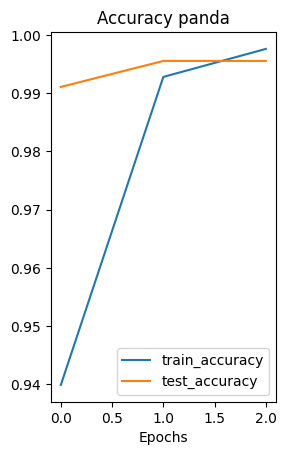

Fold 1
-------
Epoch: 1 | train_loss: 0.4318 | train_acc: 0.8654 | test_loss: 0.2731 | test_acc: 0.9509
Epoch: 2 | train_loss: 0.1607 | train_acc: 0.9543 | test_loss: 0.1398 | test_acc: 0.9732
Epoch: 3 | train_loss: 0.0848 | train_acc: 0.9832 | test_loss: 0.1035 | test_acc: 0.9732


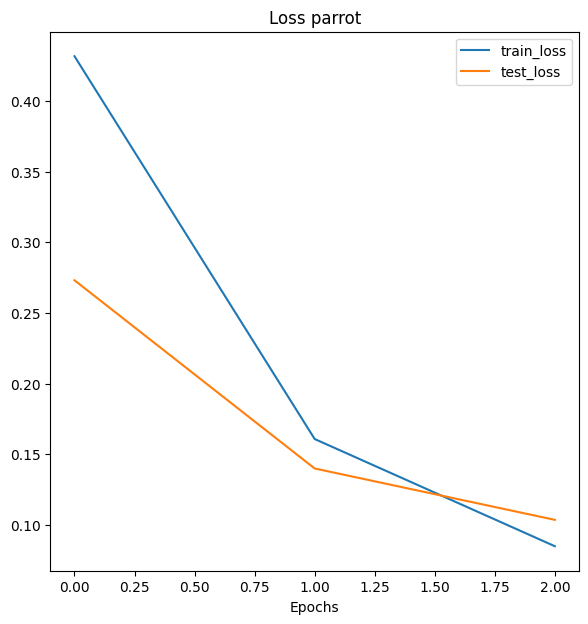

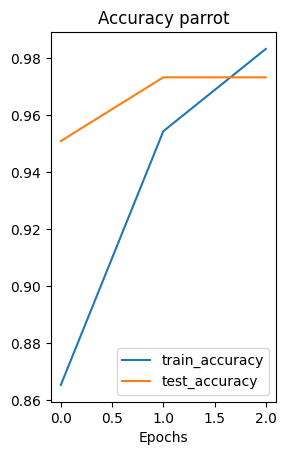

Fold 2
-------
Epoch: 1 | train_loss: 0.3817 | train_acc: 0.8870 | test_loss: 0.1801 | test_acc: 0.9955
Epoch: 2 | train_loss: 0.1094 | train_acc: 0.9784 | test_loss: 0.0787 | test_acc: 0.9911
Epoch: 3 | train_loss: 0.0525 | train_acc: 0.9952 | test_loss: 0.0517 | test_acc: 0.9955


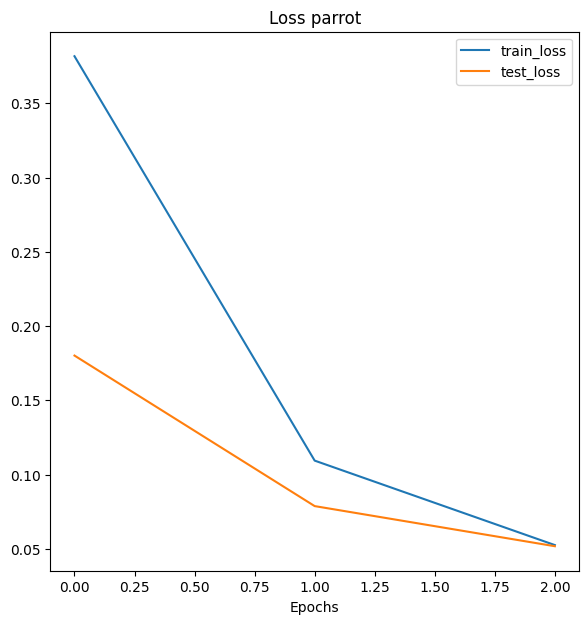

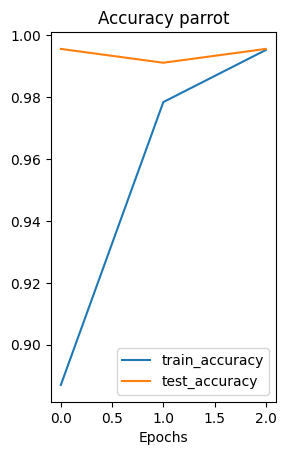

Fold 3
-------
Epoch: 1 | train_loss: 0.3415 | train_acc: 0.9087 | test_loss: 0.1216 | test_acc: 0.9866
Epoch: 2 | train_loss: 0.0800 | train_acc: 0.9832 | test_loss: 0.0621 | test_acc: 0.9911
Epoch: 3 | train_loss: 0.0479 | train_acc: 0.9952 | test_loss: 0.0454 | test_acc: 0.9911


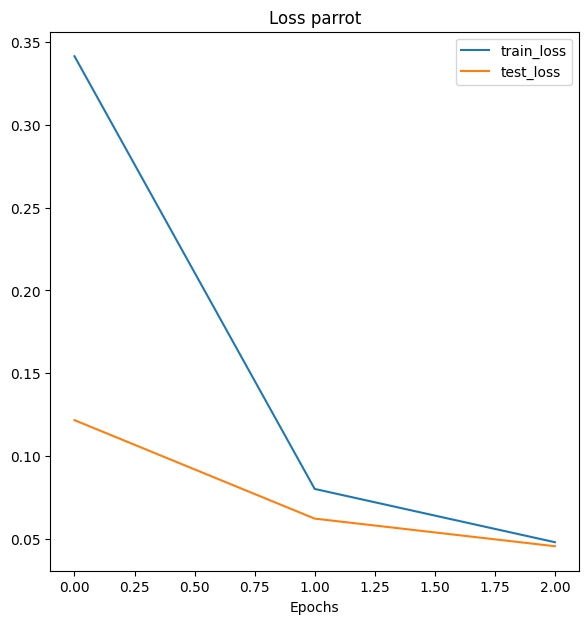

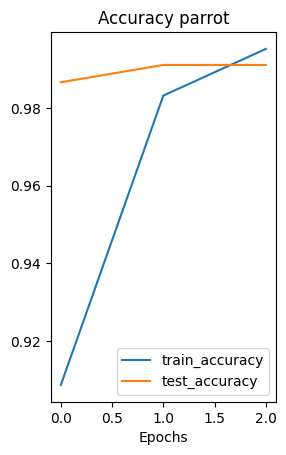

Fold 1
-------
Epoch: 1 | train_loss: 0.4446 | train_acc: 0.8582 | test_loss: 0.2984 | test_acc: 0.9107
Epoch: 2 | train_loss: 0.1588 | train_acc: 0.9712 | test_loss: 0.1773 | test_acc: 0.9598
Epoch: 3 | train_loss: 0.0926 | train_acc: 0.9736 | test_loss: 0.1191 | test_acc: 0.9732


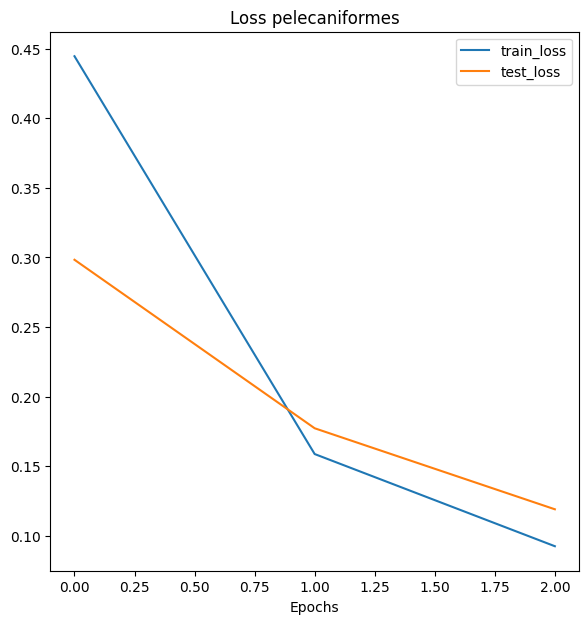

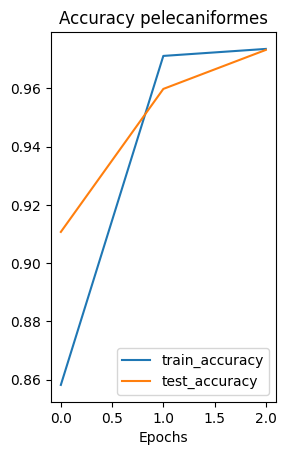

Fold 2
-------
Epoch: 1 | train_loss: 0.4120 | train_acc: 0.8774 | test_loss: 0.1825 | test_acc: 0.9821
Epoch: 2 | train_loss: 0.1292 | train_acc: 0.9784 | test_loss: 0.1041 | test_acc: 0.9821
Epoch: 3 | train_loss: 0.0732 | train_acc: 0.9904 | test_loss: 0.0702 | test_acc: 0.9821


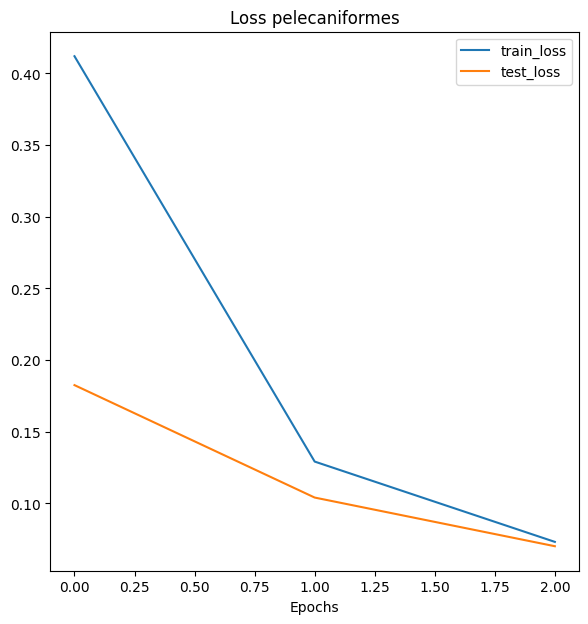

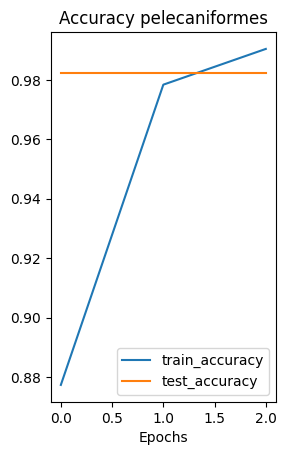

Fold 3
-------
Epoch: 1 | train_loss: 0.3686 | train_acc: 0.9038 | test_loss: 0.1439 | test_acc: 1.0000
Epoch: 2 | train_loss: 0.1137 | train_acc: 0.9736 | test_loss: 0.0656 | test_acc: 1.0000
Epoch: 3 | train_loss: 0.0550 | train_acc: 0.9928 | test_loss: 0.0458 | test_acc: 1.0000


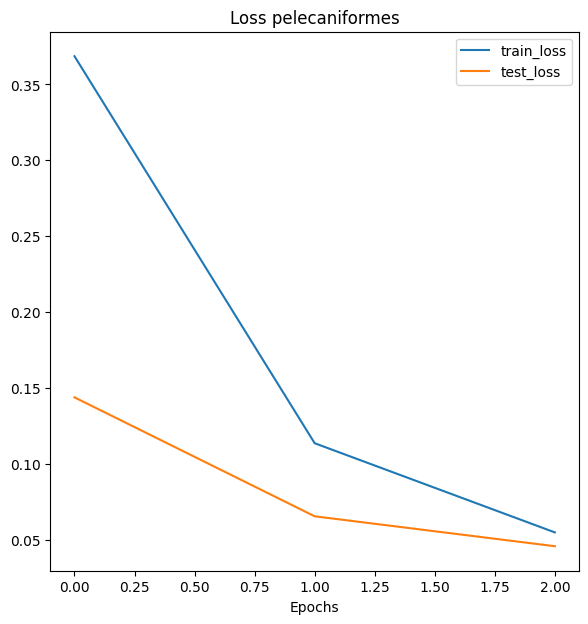

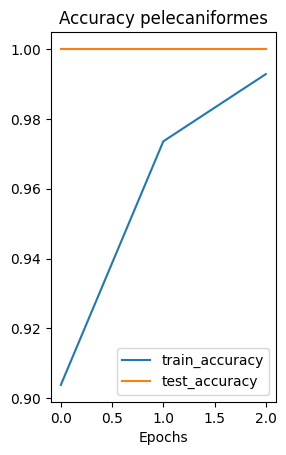

Fold 1
-------
Epoch: 1 | train_loss: 0.4462 | train_acc: 0.8534 | test_loss: 0.2866 | test_acc: 0.9241
Epoch: 2 | train_loss: 0.1439 | train_acc: 0.9760 | test_loss: 0.1335 | test_acc: 0.9643
Epoch: 3 | train_loss: 0.0709 | train_acc: 0.9880 | test_loss: 0.0985 | test_acc: 0.9777


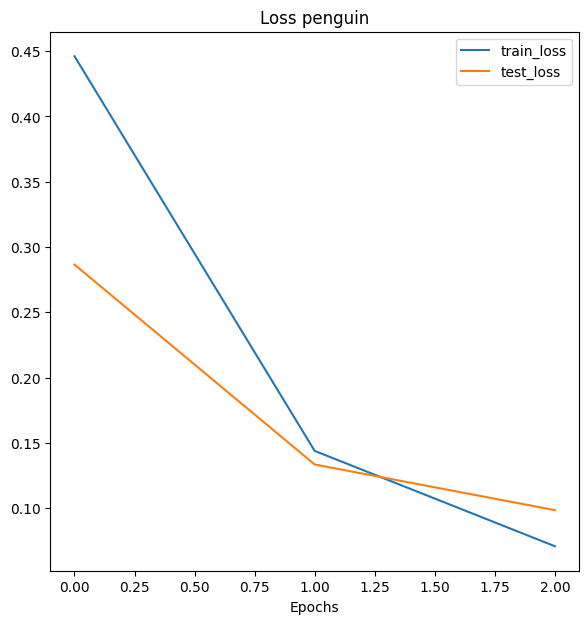

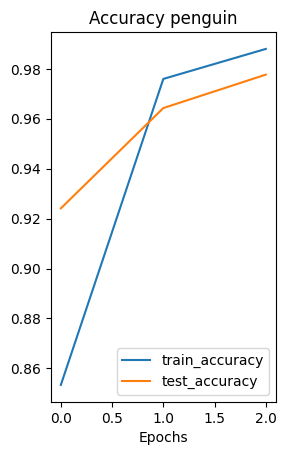

Fold 2
-------
Epoch: 1 | train_loss: 0.3839 | train_acc: 0.8894 | test_loss: 0.1801 | test_acc: 0.9777
Epoch: 2 | train_loss: 0.1010 | train_acc: 0.9856 | test_loss: 0.0866 | test_acc: 0.9866
Epoch: 3 | train_loss: 0.0439 | train_acc: 0.9952 | test_loss: 0.0559 | test_acc: 0.9866


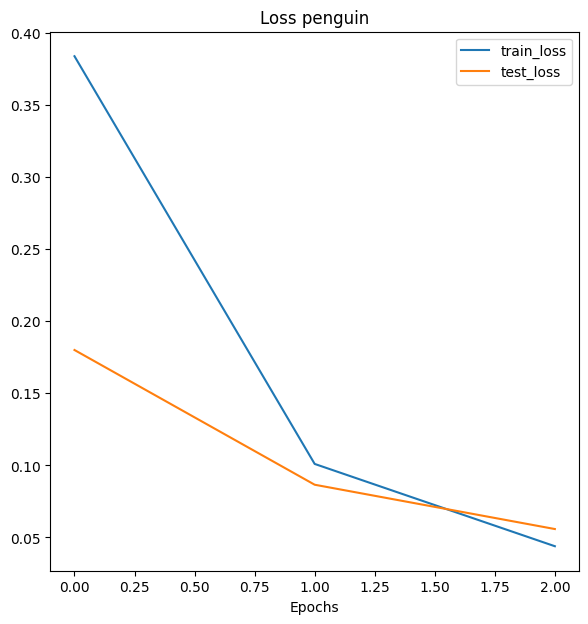

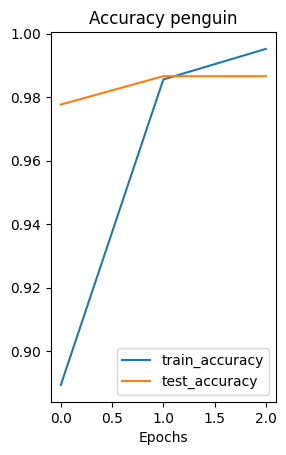

Fold 3
-------
Epoch: 1 | train_loss: 0.3522 | train_acc: 0.9038 | test_loss: 0.1213 | test_acc: 1.0000
Epoch: 2 | train_loss: 0.0845 | train_acc: 0.9904 | test_loss: 0.0476 | test_acc: 1.0000
Epoch: 3 | train_loss: 0.0377 | train_acc: 1.0000 | test_loss: 0.0385 | test_acc: 1.0000


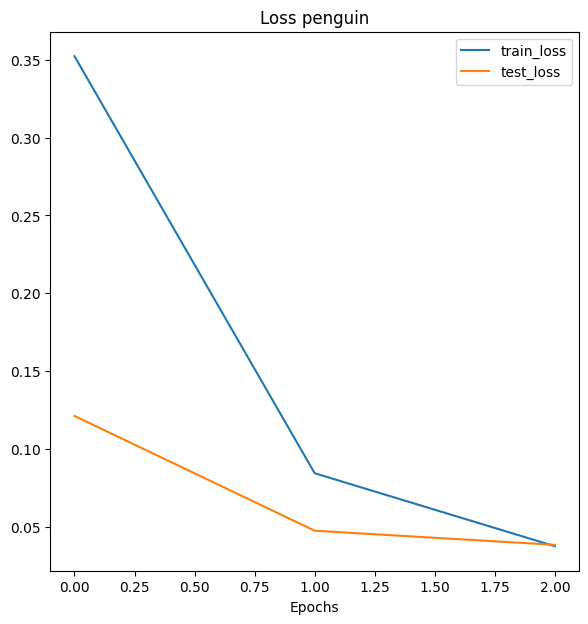

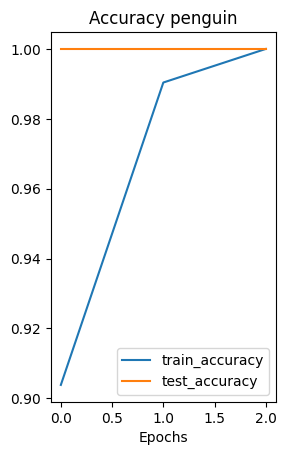

Fold 1
-------
Epoch: 1 | train_loss: 0.4157 | train_acc: 0.8846 | test_loss: 0.3011 | test_acc: 0.9554
Epoch: 2 | train_loss: 0.1533 | train_acc: 0.9688 | test_loss: 0.1787 | test_acc: 0.9554
Epoch: 3 | train_loss: 0.0661 | train_acc: 0.9952 | test_loss: 0.1323 | test_acc: 0.9554


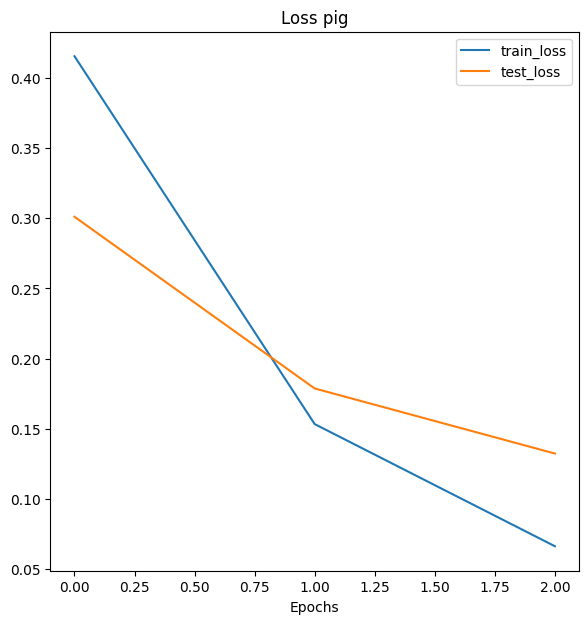

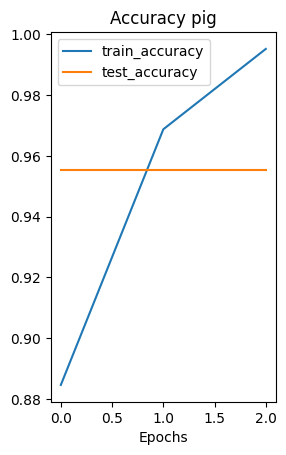

Fold 2
-------
Epoch: 1 | train_loss: 0.3703 | train_acc: 0.9159 | test_loss: 0.1559 | test_acc: 0.9911
Epoch: 2 | train_loss: 0.1047 | train_acc: 0.9856 | test_loss: 0.0724 | test_acc: 0.9955
Epoch: 3 | train_loss: 0.0671 | train_acc: 0.9784 | test_loss: 0.0543 | test_acc: 0.9911


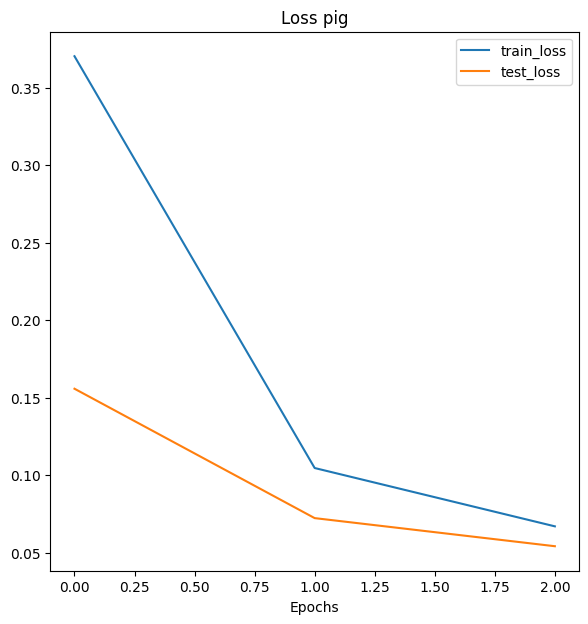

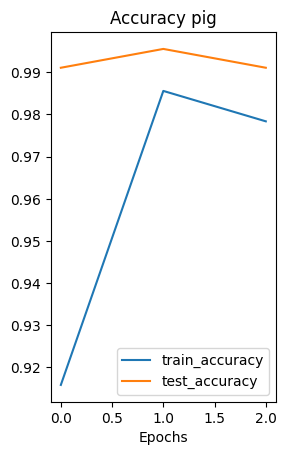

Fold 3
-------
Epoch: 1 | train_loss: 0.3277 | train_acc: 0.9519 | test_loss: 0.1059 | test_acc: 1.0000
Epoch: 2 | train_loss: 0.0899 | train_acc: 0.9856 | test_loss: 0.0569 | test_acc: 1.0000
Epoch: 3 | train_loss: 0.0418 | train_acc: 0.9976 | test_loss: 0.0374 | test_acc: 1.0000


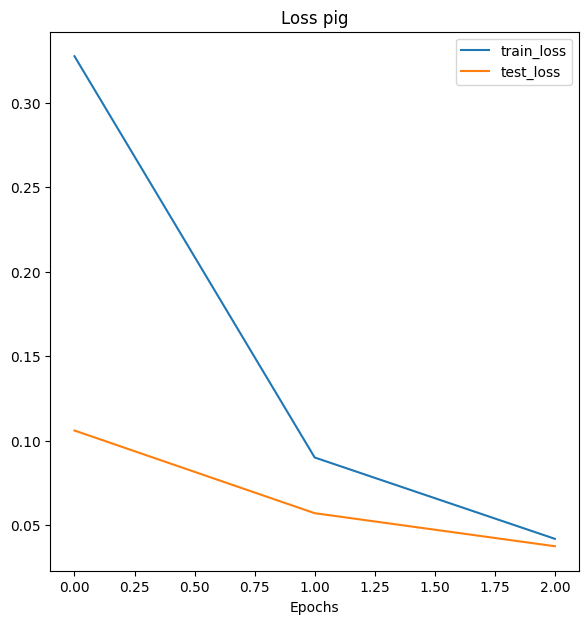

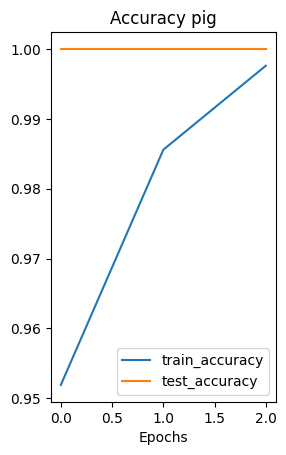

Fold 1
-------
Epoch: 1 | train_loss: 0.4450 | train_acc: 0.8606 | test_loss: 0.3036 | test_acc: 0.9107
Epoch: 2 | train_loss: 0.1670 | train_acc: 0.9639 | test_loss: 0.1893 | test_acc: 0.9375
Epoch: 3 | train_loss: 0.0747 | train_acc: 0.9928 | test_loss: 0.1346 | test_acc: 0.9688


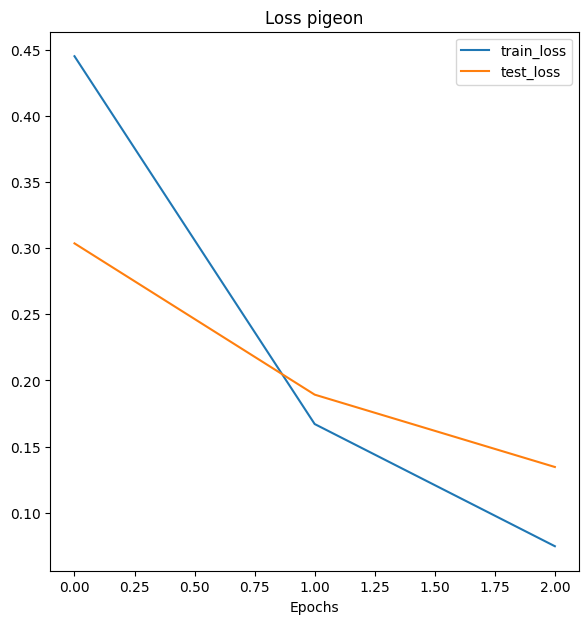

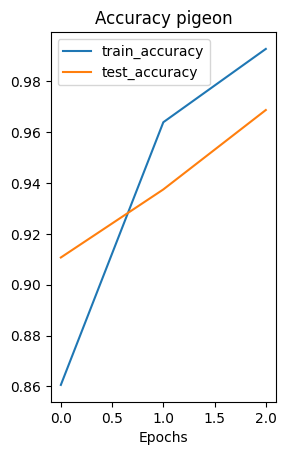

Fold 2
-------
Epoch: 1 | train_loss: 0.3857 | train_acc: 0.8918 | test_loss: 0.1778 | test_acc: 0.9866
Epoch: 2 | train_loss: 0.1134 | train_acc: 0.9928 | test_loss: 0.0784 | test_acc: 0.9821
Epoch: 3 | train_loss: 0.0583 | train_acc: 0.9928 | test_loss: 0.0584 | test_acc: 0.9821


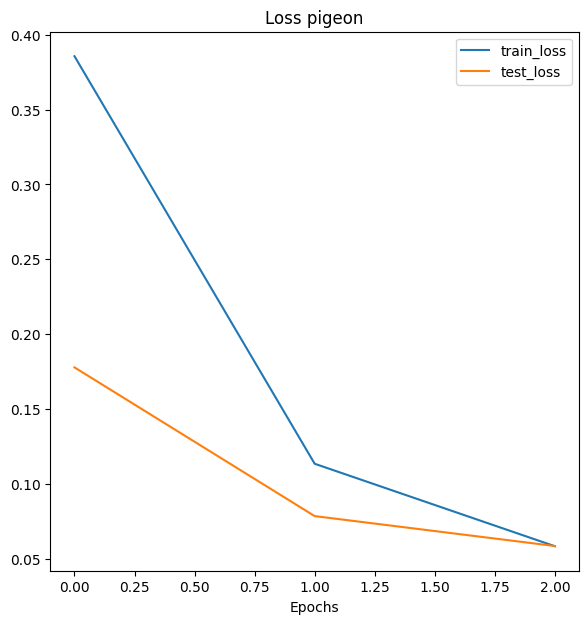

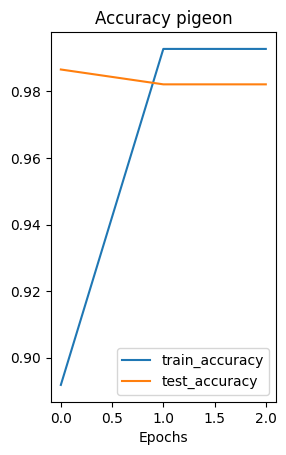

Fold 3
-------
Epoch: 1 | train_loss: 0.3663 | train_acc: 0.8870 | test_loss: 0.1437 | test_acc: 0.9911
Epoch: 2 | train_loss: 0.0983 | train_acc: 0.9928 | test_loss: 0.0609 | test_acc: 1.0000
Epoch: 3 | train_loss: 0.0413 | train_acc: 0.9952 | test_loss: 0.0335 | test_acc: 1.0000


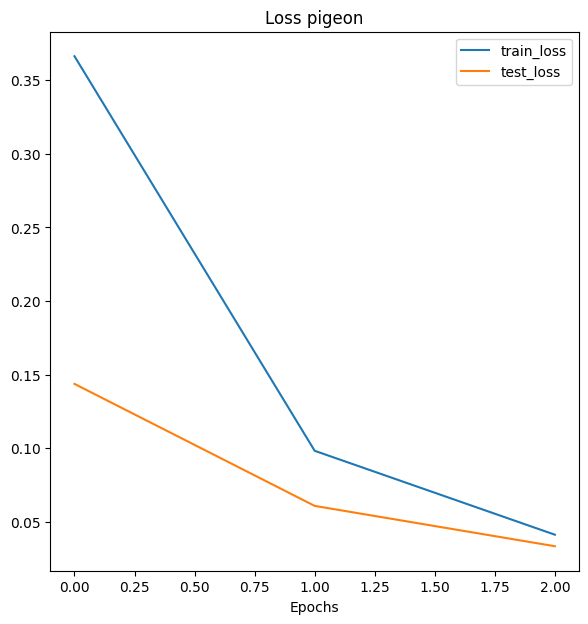

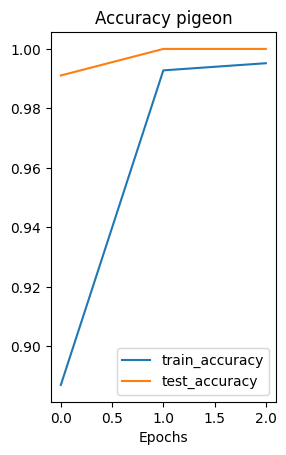

Fold 1
-------
Epoch: 1 | train_loss: 0.4042 | train_acc: 0.8702 | test_loss: 0.2651 | test_acc: 0.9375
Epoch: 2 | train_loss: 0.1326 | train_acc: 0.9808 | test_loss: 0.1291 | test_acc: 0.9866
Epoch: 3 | train_loss: 0.0561 | train_acc: 0.9904 | test_loss: 0.1031 | test_acc: 0.9554


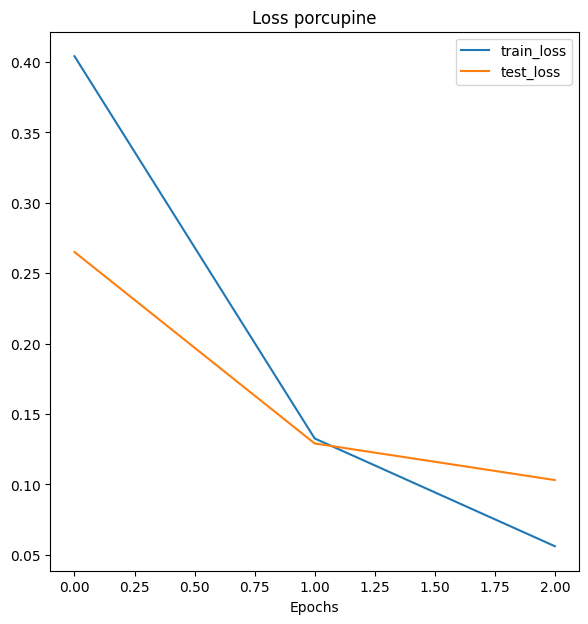

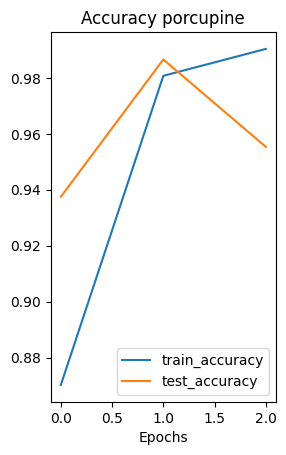

Fold 2
-------
Epoch: 1 | train_loss: 0.3129 | train_acc: 0.9471 | test_loss: 0.1174 | test_acc: 0.9955
Epoch: 2 | train_loss: 0.0755 | train_acc: 0.9928 | test_loss: 0.0414 | test_acc: 1.0000
Epoch: 3 | train_loss: 0.0426 | train_acc: 0.9880 | test_loss: 0.0267 | test_acc: 1.0000


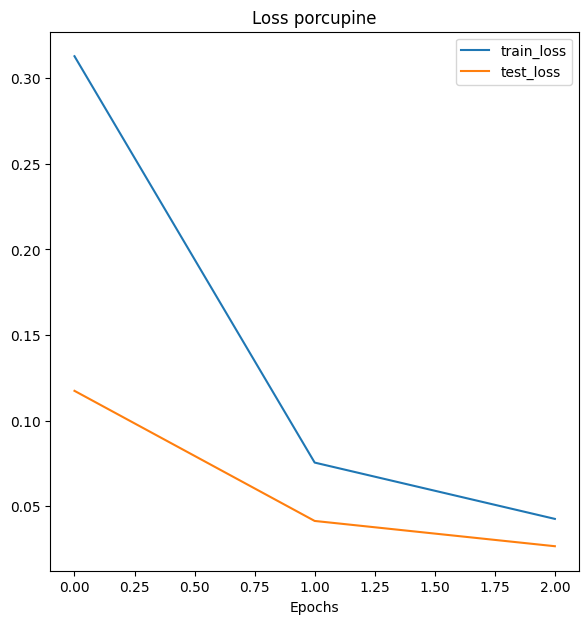

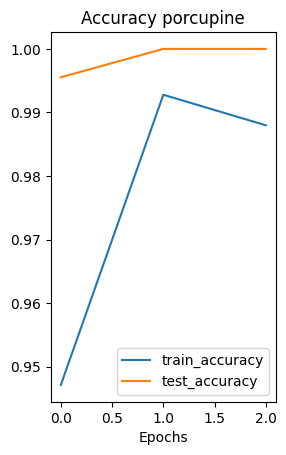

Fold 3
-------
Epoch: 1 | train_loss: 0.3121 | train_acc: 0.9423 | test_loss: 0.1129 | test_acc: 0.9955
Epoch: 2 | train_loss: 0.0829 | train_acc: 0.9808 | test_loss: 0.0428 | test_acc: 0.9955
Epoch: 3 | train_loss: 0.0275 | train_acc: 1.0000 | test_loss: 0.0305 | test_acc: 0.9955


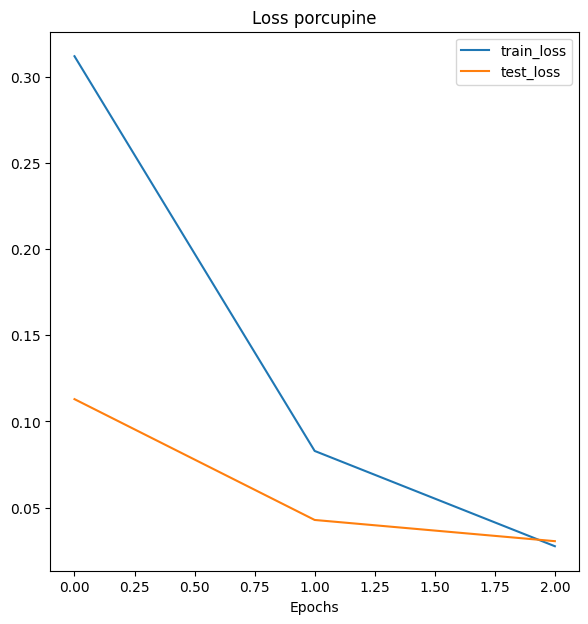

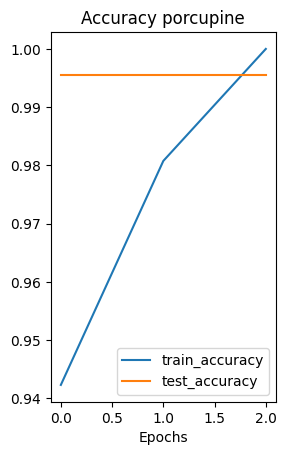

Fold 1
-------
Epoch: 1 | train_loss: 0.4152 | train_acc: 0.8678 | test_loss: 0.2841 | test_acc: 0.9286
Epoch: 2 | train_loss: 0.1566 | train_acc: 0.9591 | test_loss: 0.1600 | test_acc: 0.9598
Epoch: 3 | train_loss: 0.0953 | train_acc: 0.9760 | test_loss: 0.1154 | test_acc: 0.9598


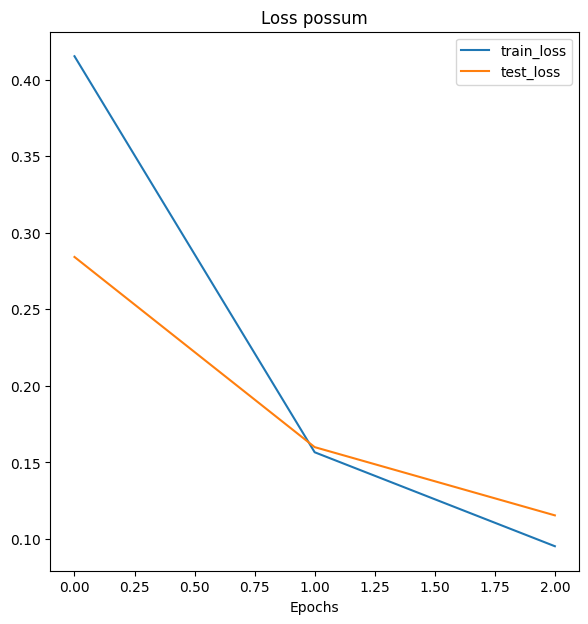

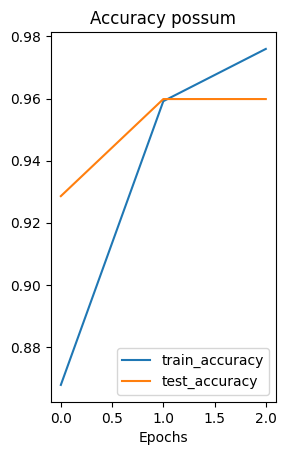

Fold 2
-------
Epoch: 1 | train_loss: 0.3984 | train_acc: 0.8894 | test_loss: 0.1971 | test_acc: 0.9598
Epoch: 2 | train_loss: 0.1306 | train_acc: 0.9760 | test_loss: 0.1035 | test_acc: 0.9821
Epoch: 3 | train_loss: 0.0766 | train_acc: 0.9856 | test_loss: 0.0660 | test_acc: 0.9866


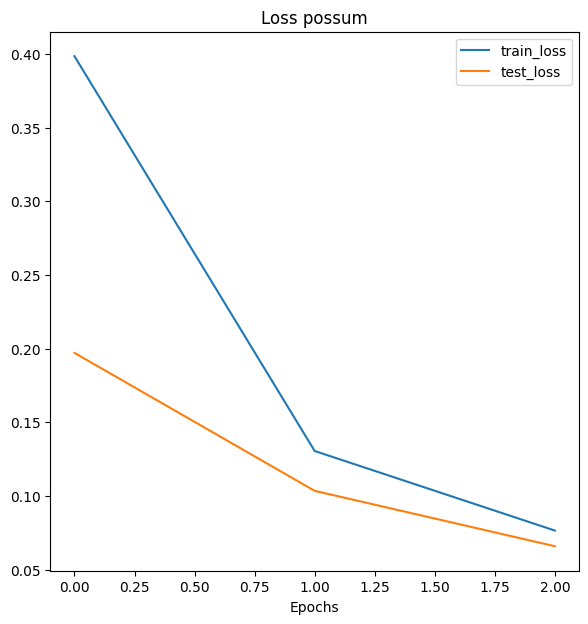

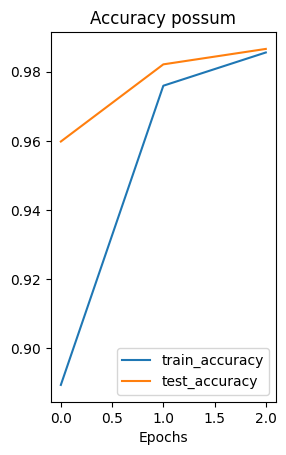

Fold 3
-------
Epoch: 1 | train_loss: 0.3373 | train_acc: 0.9159 | test_loss: 0.1469 | test_acc: 0.9821
Epoch: 2 | train_loss: 0.0934 | train_acc: 0.9832 | test_loss: 0.0851 | test_acc: 0.9688
Epoch: 3 | train_loss: 0.0547 | train_acc: 0.9832 | test_loss: 0.0482 | test_acc: 0.9911


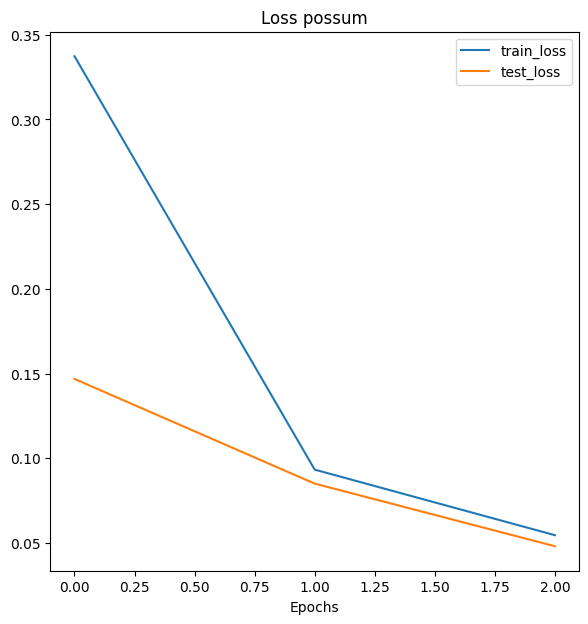

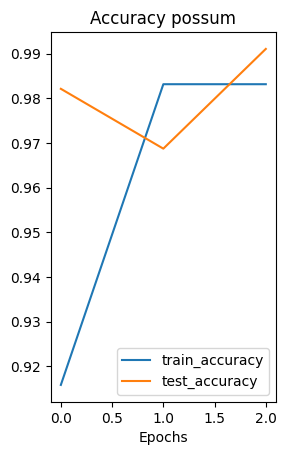

Fold 1
-------
Epoch: 1 | train_loss: 0.3884 | train_acc: 0.8894 | test_loss: 0.2764 | test_acc: 0.9241
Epoch: 2 | train_loss: 0.1382 | train_acc: 0.9712 | test_loss: 0.1356 | test_acc: 0.9598
Epoch: 3 | train_loss: 0.0707 | train_acc: 0.9808 | test_loss: 0.0955 | test_acc: 0.9643


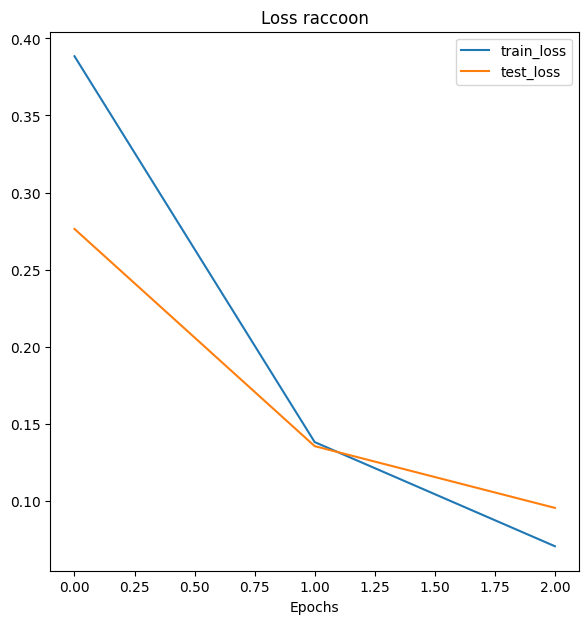

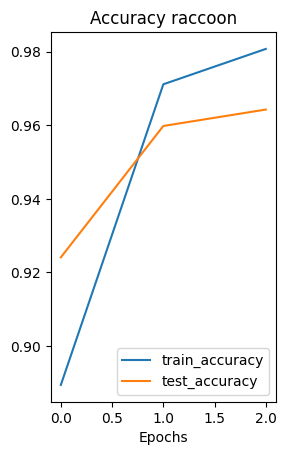

Fold 2
-------
Epoch: 1 | train_loss: 0.3574 | train_acc: 0.9135 | test_loss: 0.1501 | test_acc: 0.9821
Epoch: 2 | train_loss: 0.1095 | train_acc: 0.9784 | test_loss: 0.0844 | test_acc: 0.9821
Epoch: 3 | train_loss: 0.0597 | train_acc: 0.9880 | test_loss: 0.0610 | test_acc: 0.9866


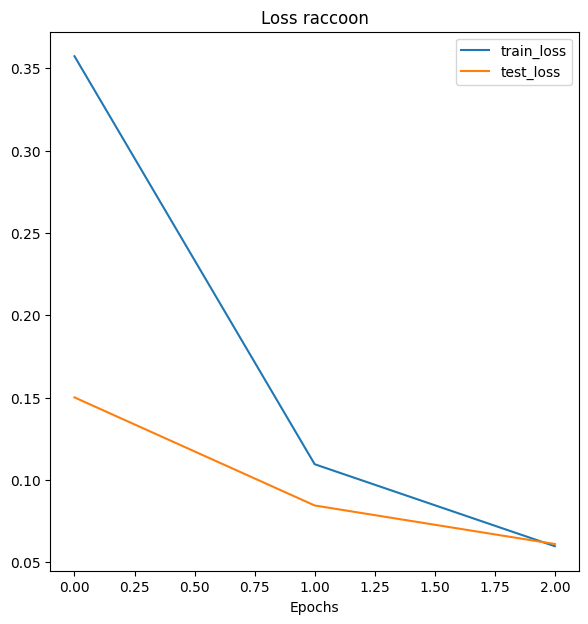

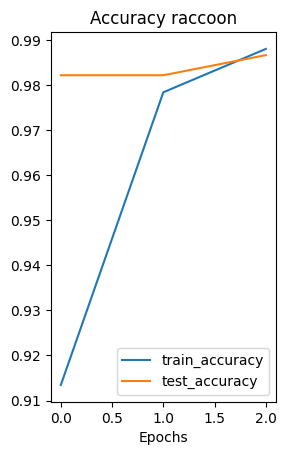

Fold 3
-------
Epoch: 1 | train_loss: 0.3326 | train_acc: 0.9159 | test_loss: 0.1175 | test_acc: 0.9955
Epoch: 2 | train_loss: 0.0792 | train_acc: 0.9904 | test_loss: 0.0555 | test_acc: 0.9955
Epoch: 3 | train_loss: 0.0388 | train_acc: 0.9928 | test_loss: 0.0379 | test_acc: 0.9955


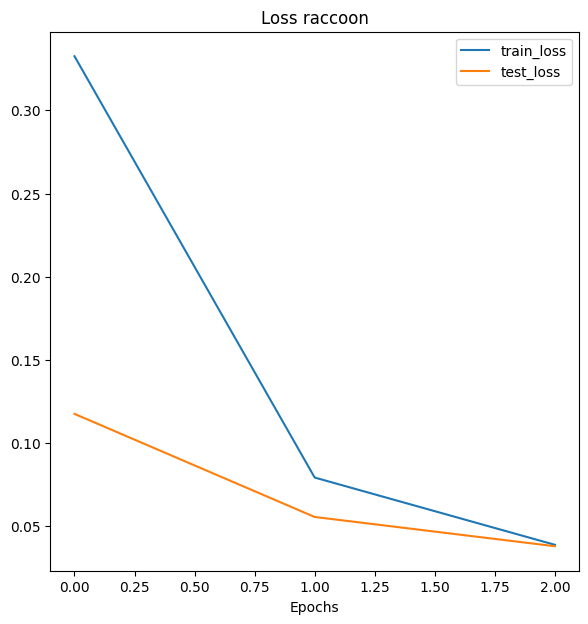

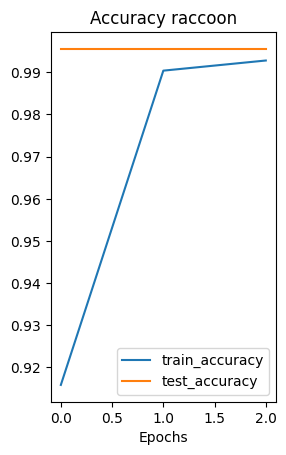

Fold 1
-------
Epoch: 1 | train_loss: 0.4205 | train_acc: 0.8678 | test_loss: 0.3119 | test_acc: 0.9018
Epoch: 2 | train_loss: 0.1695 | train_acc: 0.9543 | test_loss: 0.1943 | test_acc: 0.9420
Epoch: 3 | train_loss: 0.1034 | train_acc: 0.9712 | test_loss: 0.1496 | test_acc: 0.9464


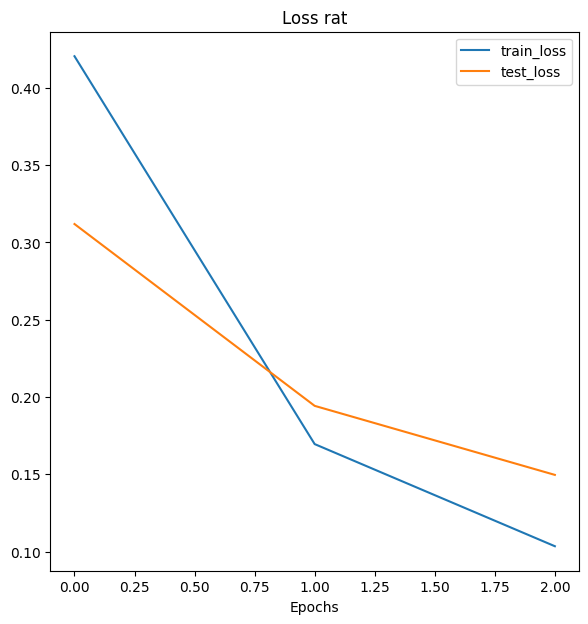

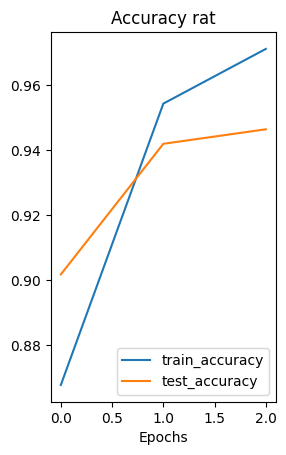

Fold 2
-------
Epoch: 1 | train_loss: 0.3929 | train_acc: 0.8894 | test_loss: 0.1859 | test_acc: 0.9777
Epoch: 2 | train_loss: 0.1334 | train_acc: 0.9639 | test_loss: 0.1010 | test_acc: 0.9821
Epoch: 3 | train_loss: 0.0762 | train_acc: 0.9856 | test_loss: 0.0821 | test_acc: 0.9777


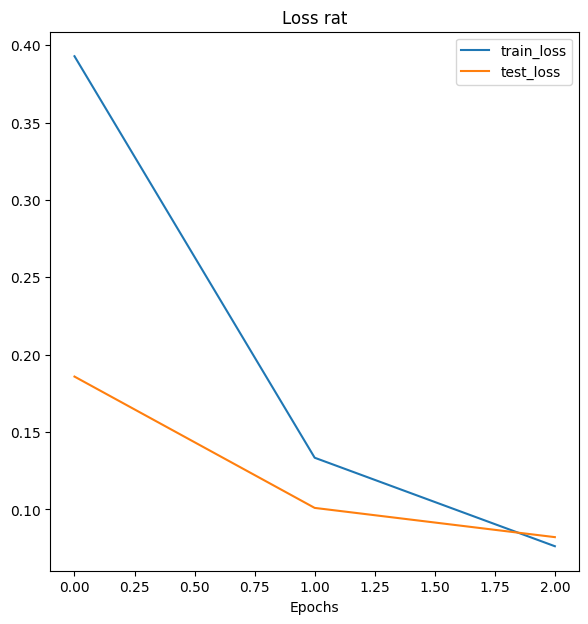

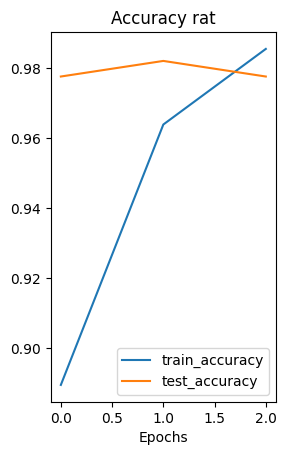

Fold 3
-------
Epoch: 1 | train_loss: 0.3853 | train_acc: 0.8750 | test_loss: 0.1663 | test_acc: 0.9732
Epoch: 2 | train_loss: 0.1185 | train_acc: 0.9712 | test_loss: 0.0811 | test_acc: 0.9821
Epoch: 3 | train_loss: 0.0524 | train_acc: 0.9904 | test_loss: 0.0642 | test_acc: 0.9821


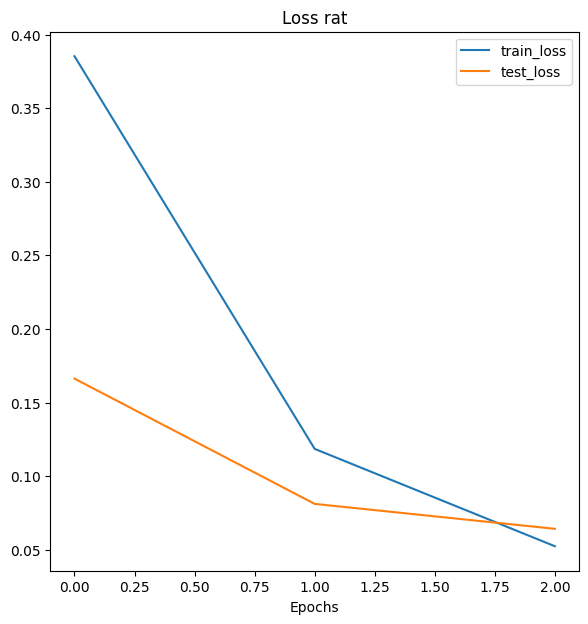

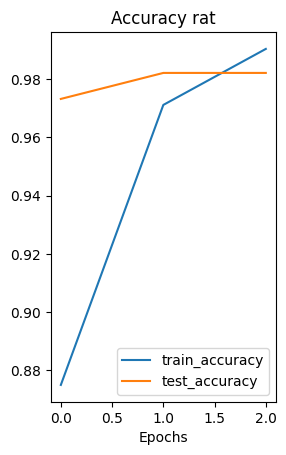

Fold 1
-------
Epoch: 1 | train_loss: 0.4293 | train_acc: 0.8702 | test_loss: 0.3356 | test_acc: 0.8973
Epoch: 2 | train_loss: 0.1532 | train_acc: 0.9663 | test_loss: 0.1897 | test_acc: 0.9375
Epoch: 3 | train_loss: 0.0655 | train_acc: 0.9928 | test_loss: 0.1237 | test_acc: 0.9643


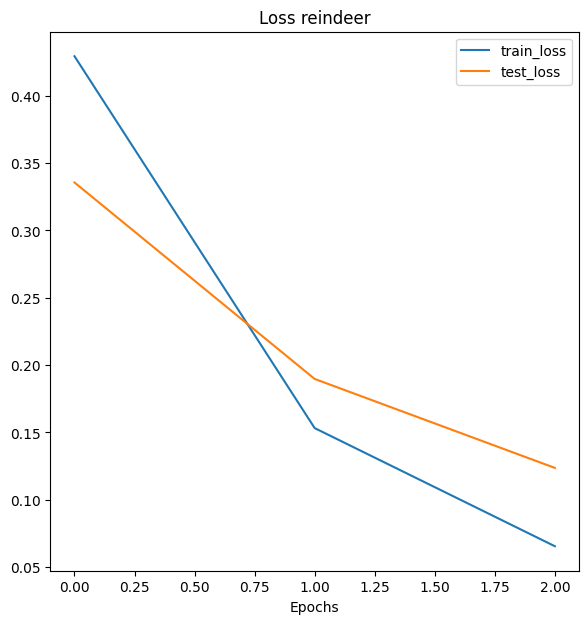

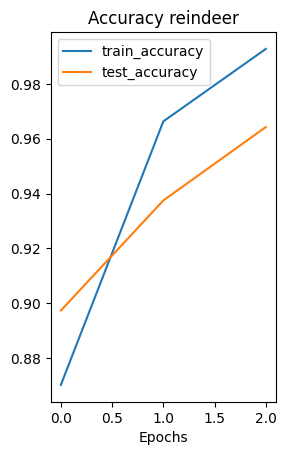

Fold 2
-------
Epoch: 1 | train_loss: 0.3701 | train_acc: 0.9111 | test_loss: 0.1641 | test_acc: 0.9866
Epoch: 2 | train_loss: 0.1070 | train_acc: 0.9856 | test_loss: 0.0693 | test_acc: 0.9866
Epoch: 3 | train_loss: 0.0591 | train_acc: 0.9832 | test_loss: 0.0565 | test_acc: 0.9911


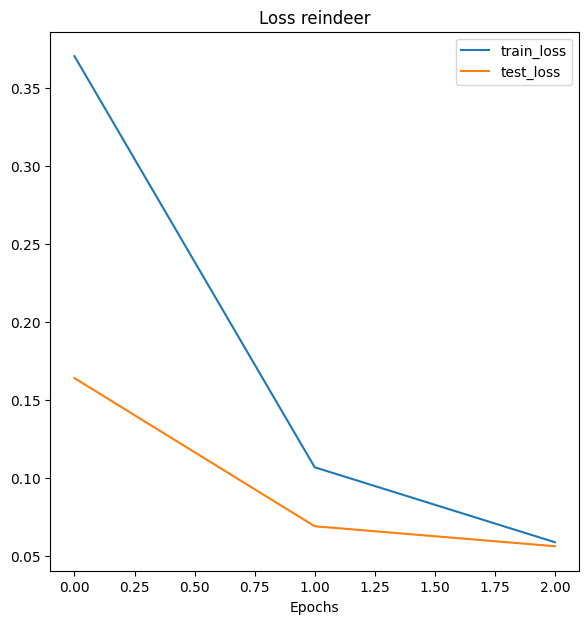

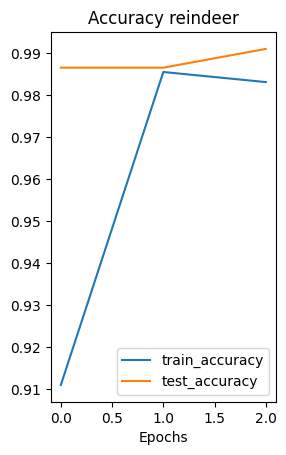

Fold 3
-------
Epoch: 1 | train_loss: 0.3467 | train_acc: 0.9399 | test_loss: 0.1161 | test_acc: 0.9955
Epoch: 2 | train_loss: 0.0934 | train_acc: 0.9904 | test_loss: 0.0512 | test_acc: 1.0000
Epoch: 3 | train_loss: 0.0462 | train_acc: 0.9904 | test_loss: 0.0341 | test_acc: 1.0000


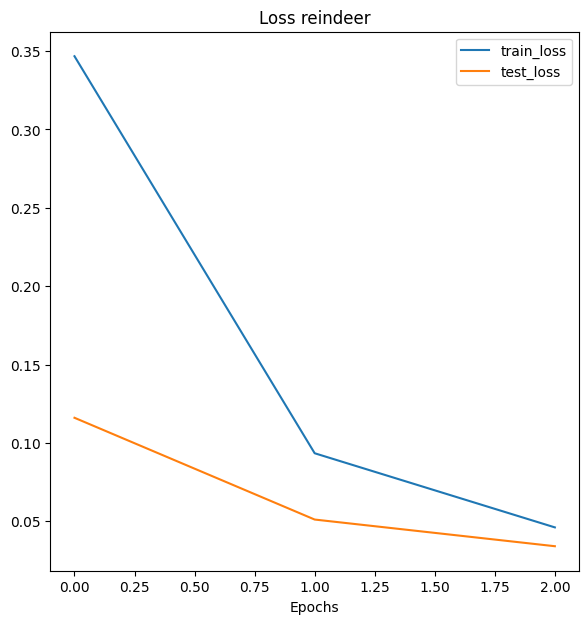

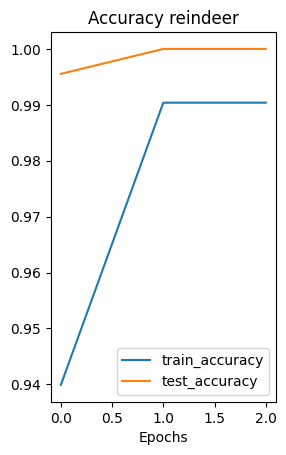

Fold 1
-------
Epoch: 1 | train_loss: 0.4088 | train_acc: 0.8798 | test_loss: 0.2608 | test_acc: 0.9509
Epoch: 2 | train_loss: 0.1343 | train_acc: 0.9688 | test_loss: 0.1795 | test_acc: 0.9509
Epoch: 3 | train_loss: 0.0662 | train_acc: 0.9880 | test_loss: 0.1386 | test_acc: 0.9375


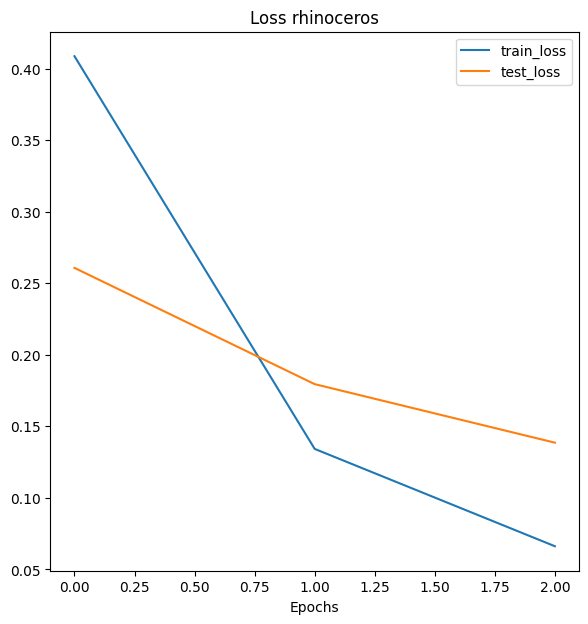

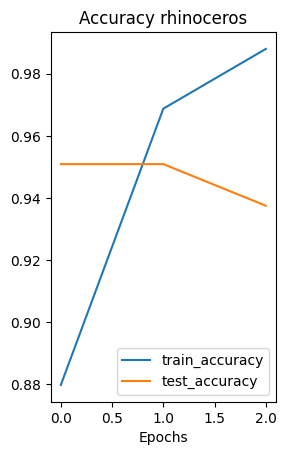

Fold 2
-------
Epoch: 1 | train_loss: 0.3781 | train_acc: 0.9014 | test_loss: 0.1796 | test_acc: 0.9509
Epoch: 2 | train_loss: 0.1178 | train_acc: 0.9736 | test_loss: 0.1014 | test_acc: 0.9777
Epoch: 3 | train_loss: 0.0621 | train_acc: 0.9880 | test_loss: 0.0848 | test_acc: 0.9777


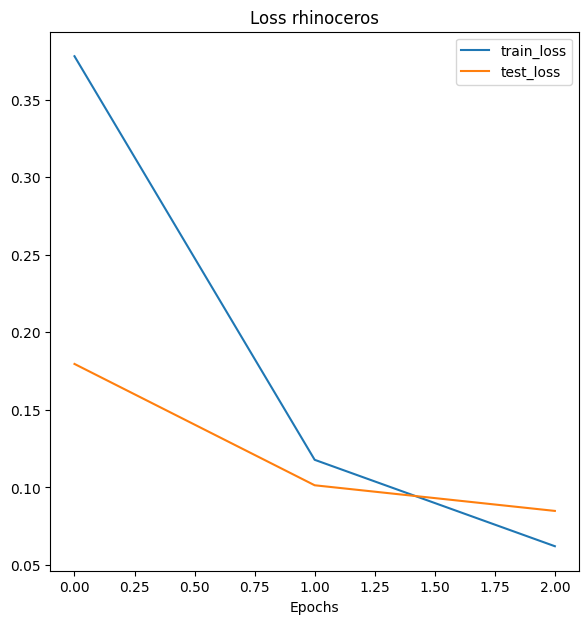

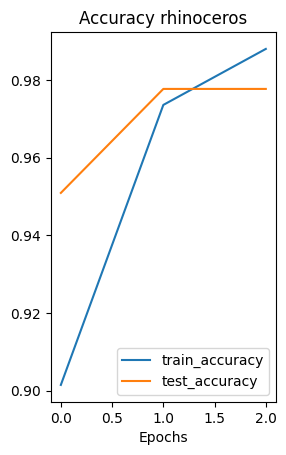

Fold 3
-------
Epoch: 1 | train_loss: 0.3466 | train_acc: 0.9183 | test_loss: 0.1238 | test_acc: 0.9955
Epoch: 2 | train_loss: 0.0886 | train_acc: 0.9880 | test_loss: 0.0541 | test_acc: 1.0000
Epoch: 3 | train_loss: 0.0597 | train_acc: 0.9880 | test_loss: 0.0381 | test_acc: 1.0000


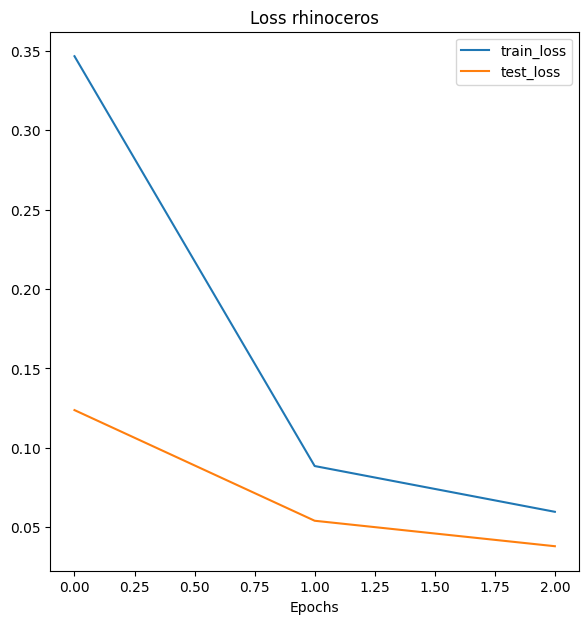

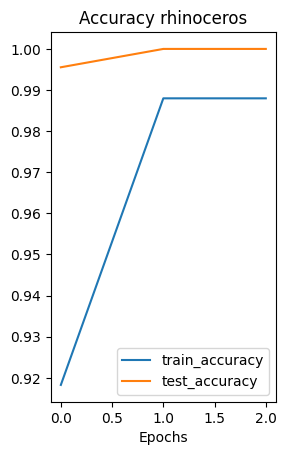

Fold 1
-------
Epoch: 1 | train_loss: 0.3540 | train_acc: 0.9279 | test_loss: 0.2726 | test_acc: 0.9196
Epoch: 2 | train_loss: 0.0882 | train_acc: 0.9928 | test_loss: 0.1383 | test_acc: 0.9732
Epoch: 3 | train_loss: 0.0446 | train_acc: 0.9952 | test_loss: 0.0916 | test_acc: 0.9821


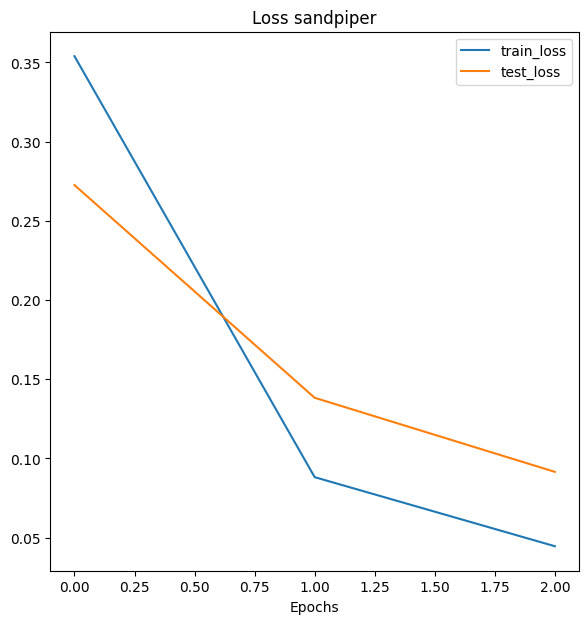

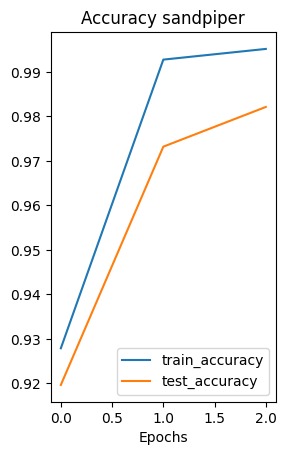

Fold 2
-------
Epoch: 1 | train_loss: 0.3099 | train_acc: 0.9567 | test_loss: 0.1142 | test_acc: 0.9911
Epoch: 2 | train_loss: 0.0770 | train_acc: 0.9856 | test_loss: 0.0421 | test_acc: 0.9911
Epoch: 3 | train_loss: 0.0564 | train_acc: 0.9832 | test_loss: 0.0327 | test_acc: 0.9911


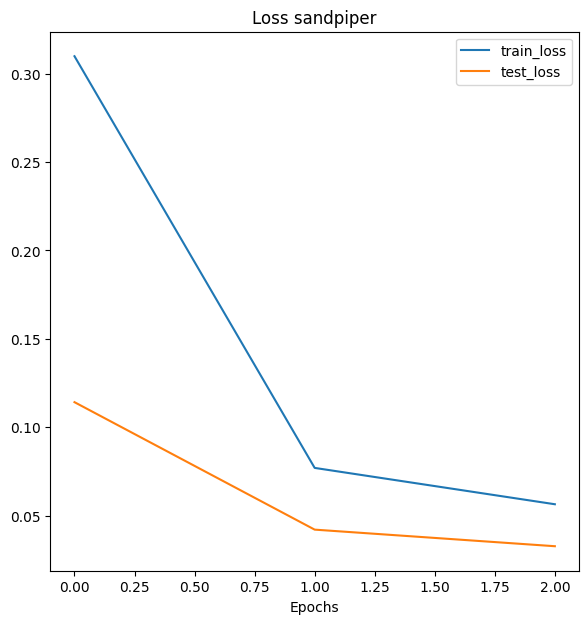

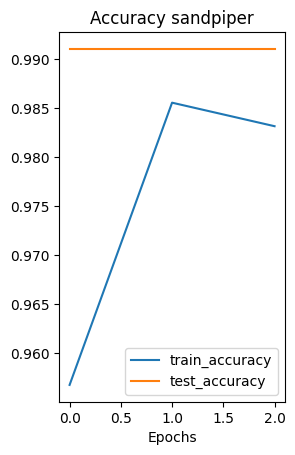

Fold 3
-------
Epoch: 1 | train_loss: 0.2953 | train_acc: 0.9399 | test_loss: 0.0937 | test_acc: 0.9955
Epoch: 2 | train_loss: 0.0684 | train_acc: 0.9880 | test_loss: 0.0369 | test_acc: 0.9955
Epoch: 3 | train_loss: 0.0450 | train_acc: 0.9904 | test_loss: 0.0318 | test_acc: 0.9955


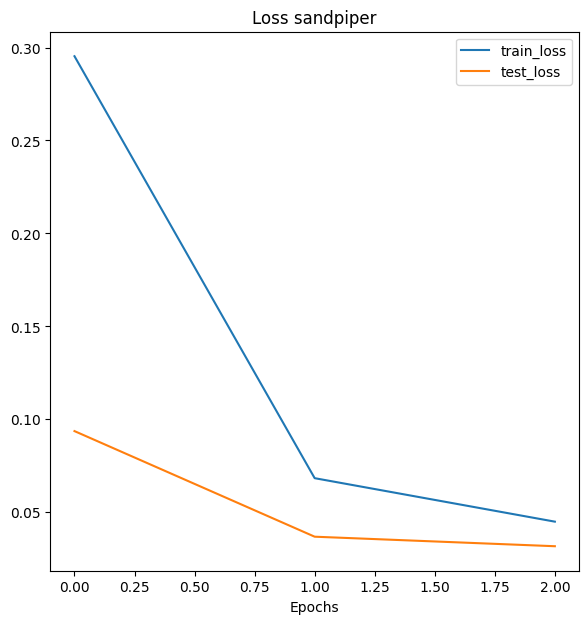

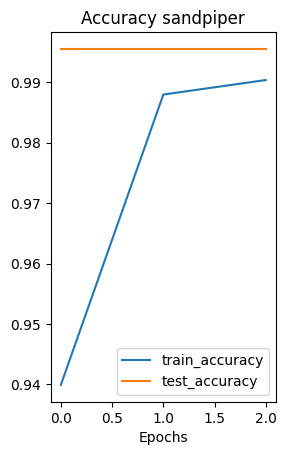

Fold 1
-------
Epoch: 1 | train_loss: 0.3731 | train_acc: 0.9087 | test_loss: 0.2947 | test_acc: 0.8929
Epoch: 2 | train_loss: 0.1280 | train_acc: 0.9736 | test_loss: 0.2015 | test_acc: 0.9152
Epoch: 3 | train_loss: 0.0595 | train_acc: 0.9928 | test_loss: 0.1642 | test_acc: 0.9509


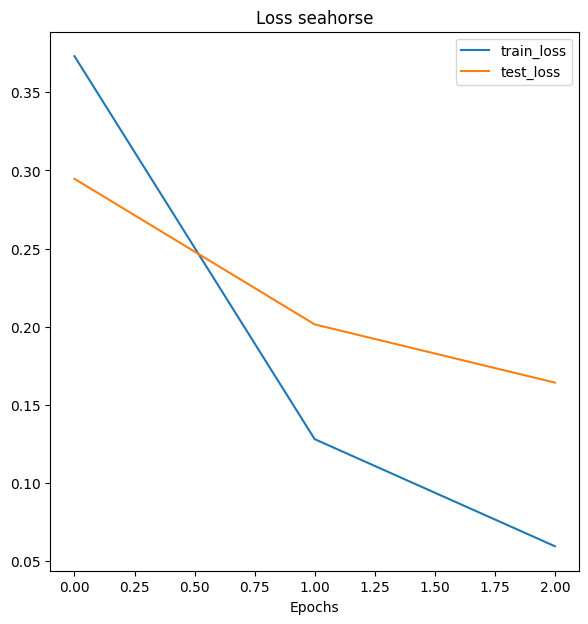

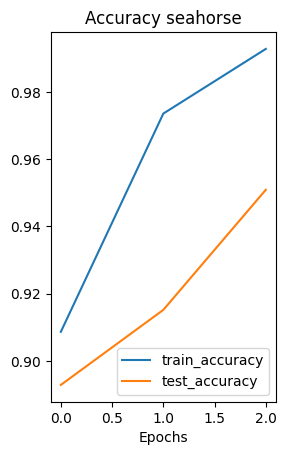

Fold 2
-------
Epoch: 1 | train_loss: 0.4315 | train_acc: 0.8245 | test_loss: 0.1834 | test_acc: 0.9911
Epoch: 2 | train_loss: 0.1252 | train_acc: 0.9832 | test_loss: 0.0954 | test_acc: 0.9821
Epoch: 3 | train_loss: 0.0706 | train_acc: 0.9904 | test_loss: 0.0935 | test_acc: 0.9688


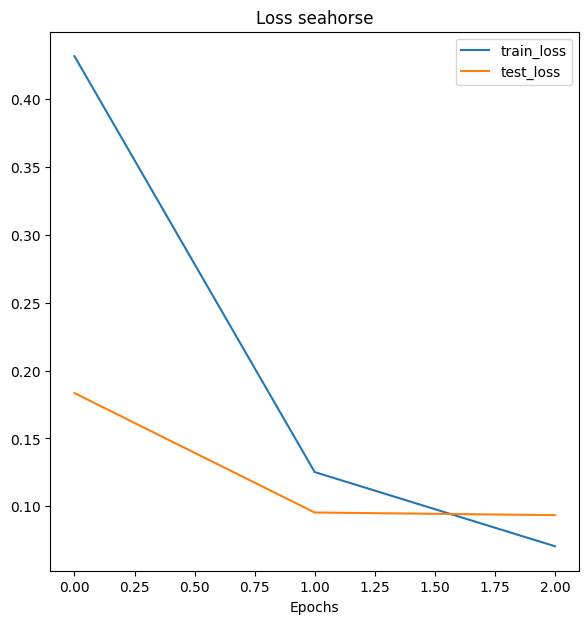

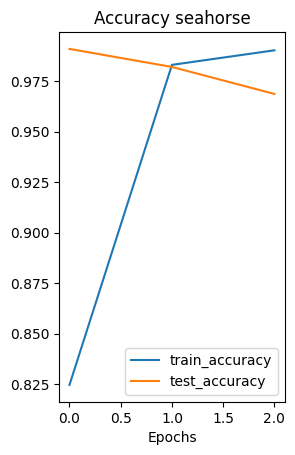

Fold 3
-------
Epoch: 1 | train_loss: 0.3493 | train_acc: 0.9207 | test_loss: 0.1318 | test_acc: 0.9911
Epoch: 2 | train_loss: 0.0919 | train_acc: 0.9856 | test_loss: 0.0579 | test_acc: 0.9955
Epoch: 3 | train_loss: 0.0472 | train_acc: 0.9928 | test_loss: 0.0434 | test_acc: 0.9955


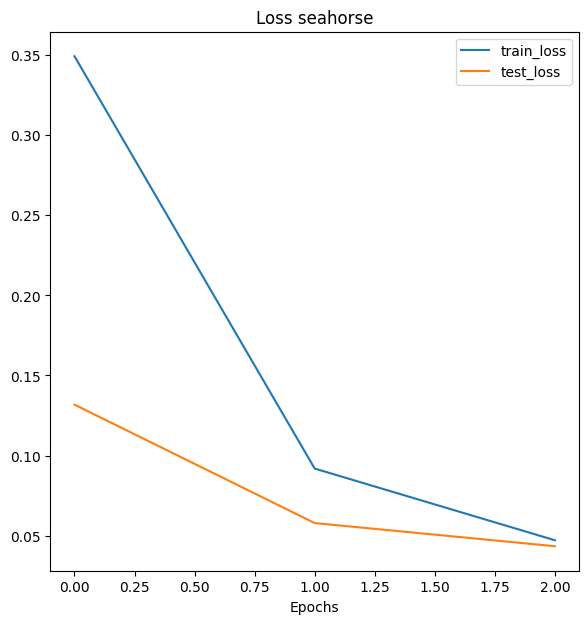

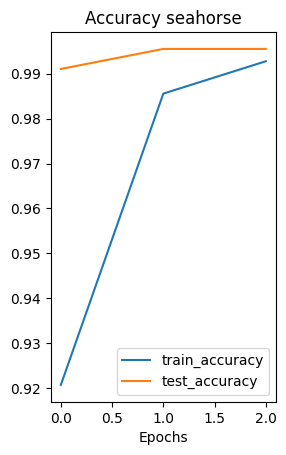

Fold 1
-------
Epoch: 1 | train_loss: 0.4335 | train_acc: 0.8582 | test_loss: 0.2923 | test_acc: 0.9375
Epoch: 2 | train_loss: 0.1534 | train_acc: 0.9856 | test_loss: 0.1678 | test_acc: 0.9420
Epoch: 3 | train_loss: 0.0736 | train_acc: 0.9952 | test_loss: 0.0953 | test_acc: 0.9777


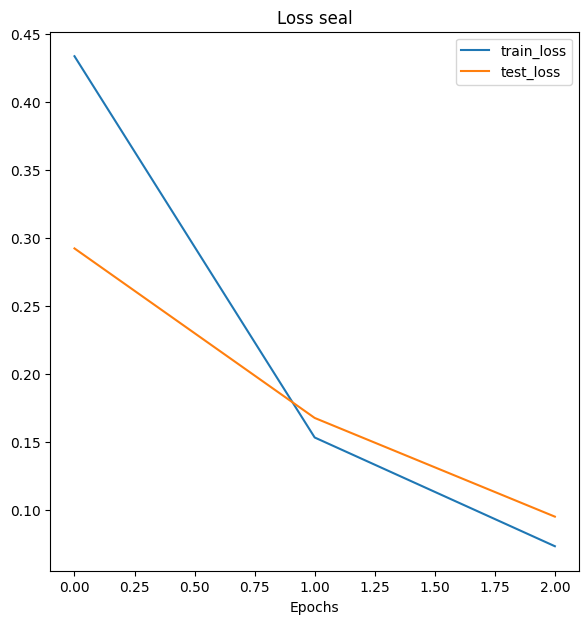

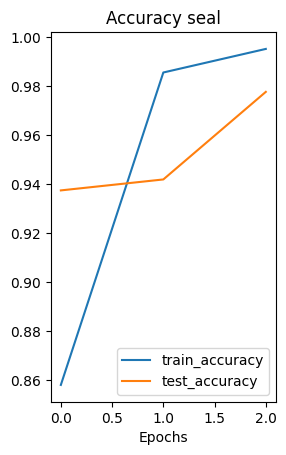

Fold 2
-------
Epoch: 1 | train_loss: 0.3810 | train_acc: 0.9159 | test_loss: 0.1591 | test_acc: 0.9955
Epoch: 2 | train_loss: 0.1107 | train_acc: 0.9952 | test_loss: 0.0645 | test_acc: 0.9955
Epoch: 3 | train_loss: 0.0479 | train_acc: 0.9976 | test_loss: 0.0426 | test_acc: 0.9955


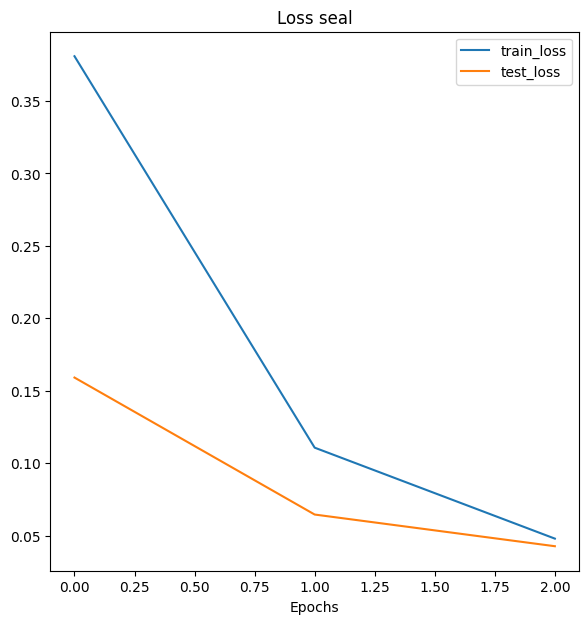

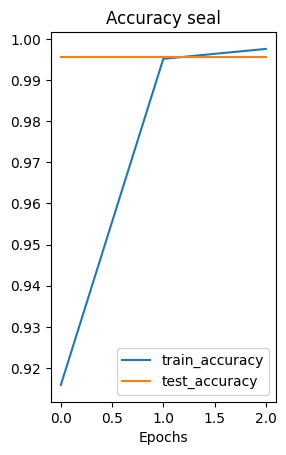

Fold 3
-------
Epoch: 1 | train_loss: 0.3570 | train_acc: 0.9159 | test_loss: 0.1247 | test_acc: 1.0000
Epoch: 2 | train_loss: 0.0815 | train_acc: 0.9928 | test_loss: 0.0462 | test_acc: 1.0000
Epoch: 3 | train_loss: 0.0327 | train_acc: 1.0000 | test_loss: 0.0296 | test_acc: 1.0000


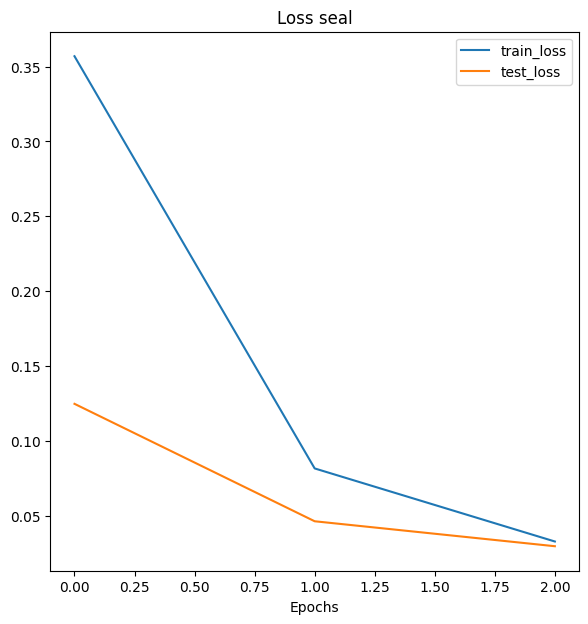

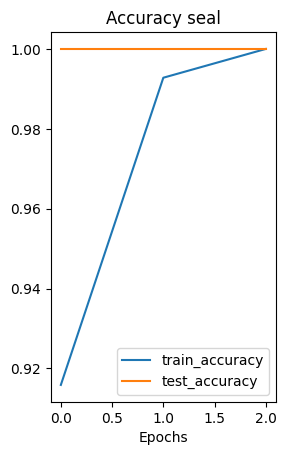

Fold 1
-------
Epoch: 1 | train_loss: 0.4245 | train_acc: 0.8654 | test_loss: 0.2790 | test_acc: 0.9420
Epoch: 2 | train_loss: 0.1279 | train_acc: 0.9808 | test_loss: 0.1343 | test_acc: 0.9732
Epoch: 3 | train_loss: 0.0600 | train_acc: 0.9904 | test_loss: 0.0920 | test_acc: 0.9821


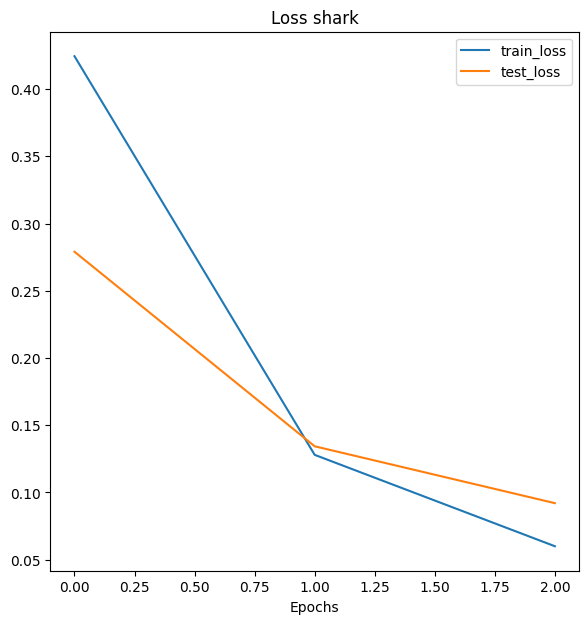

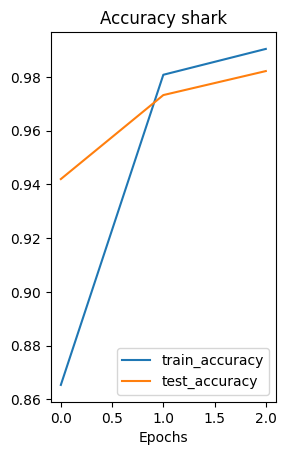

Fold 2
-------
Epoch: 1 | train_loss: 0.3633 | train_acc: 0.9231 | test_loss: 0.1517 | test_acc: 0.9866
Epoch: 2 | train_loss: 0.1168 | train_acc: 0.9760 | test_loss: 0.0800 | test_acc: 0.9821
Epoch: 3 | train_loss: 0.0577 | train_acc: 0.9904 | test_loss: 0.0576 | test_acc: 0.9866


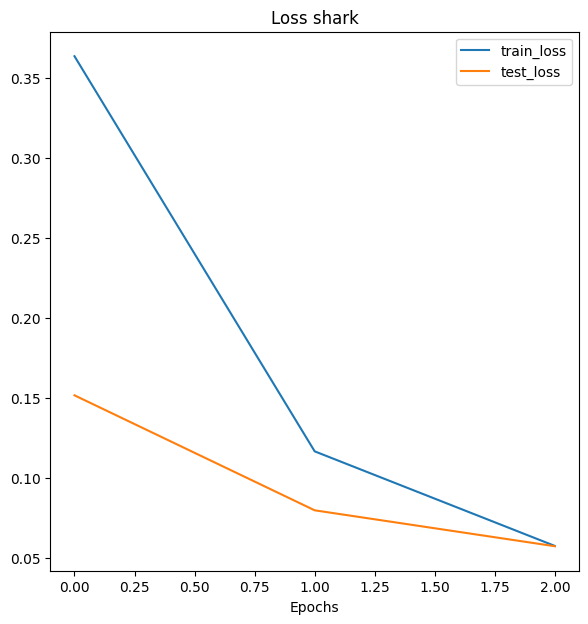

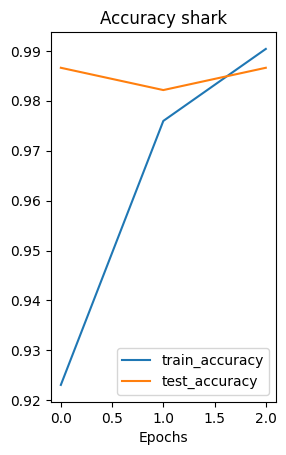

Fold 3
-------
Epoch: 1 | train_loss: 0.2886 | train_acc: 0.9519 | test_loss: 0.1088 | test_acc: 0.9955
Epoch: 2 | train_loss: 0.0713 | train_acc: 0.9880 | test_loss: 0.0486 | test_acc: 0.9955
Epoch: 3 | train_loss: 0.0527 | train_acc: 0.9856 | test_loss: 0.0353 | test_acc: 0.9955


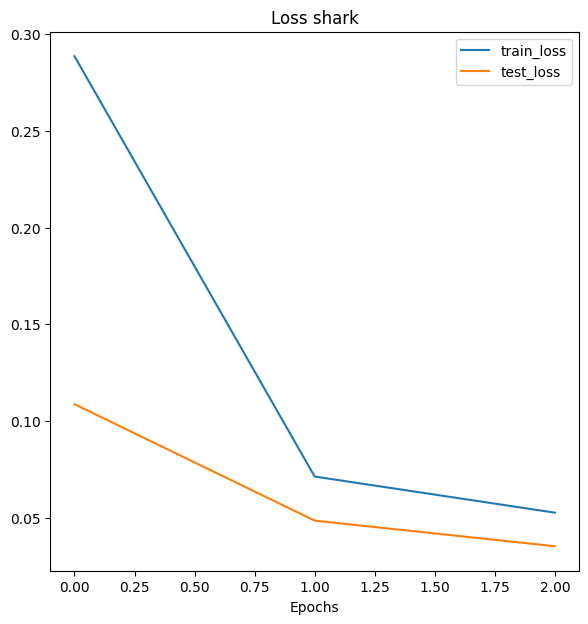

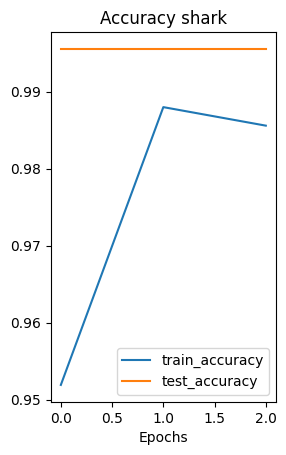

Fold 1
-------
Epoch: 1 | train_loss: 0.4253 | train_acc: 0.8606 | test_loss: 0.3098 | test_acc: 0.8884
Epoch: 2 | train_loss: 0.1439 | train_acc: 0.9808 | test_loss: 0.1519 | test_acc: 0.9777
Epoch: 3 | train_loss: 0.0867 | train_acc: 0.9832 | test_loss: 0.0927 | test_acc: 0.9866


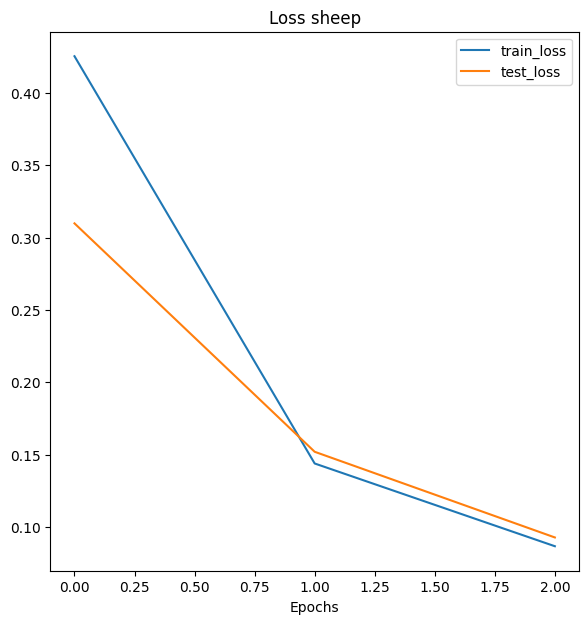

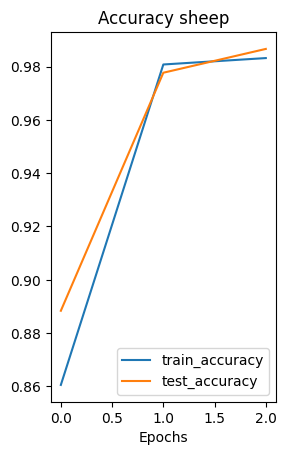

Fold 2
-------
Epoch: 1 | train_loss: 0.3819 | train_acc: 0.9111 | test_loss: 0.1524 | test_acc: 0.9955
Epoch: 2 | train_loss: 0.1116 | train_acc: 0.9856 | test_loss: 0.0745 | test_acc: 1.0000
Epoch: 3 | train_loss: 0.0543 | train_acc: 0.9952 | test_loss: 0.0428 | test_acc: 1.0000


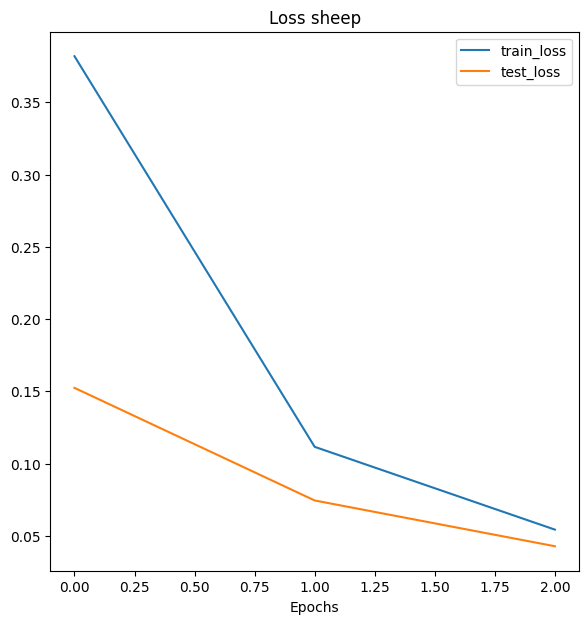

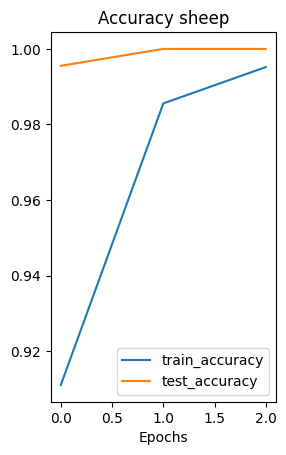

Fold 3
-------
Epoch: 1 | train_loss: 0.3404 | train_acc: 0.9231 | test_loss: 0.1250 | test_acc: 0.9955
Epoch: 2 | train_loss: 0.0870 | train_acc: 0.9928 | test_loss: 0.0535 | test_acc: 0.9955
Epoch: 3 | train_loss: 0.0357 | train_acc: 0.9952 | test_loss: 0.0417 | test_acc: 0.9955


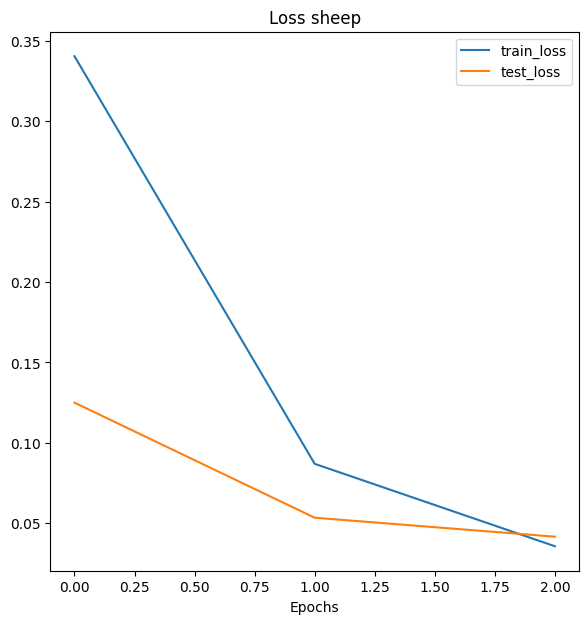

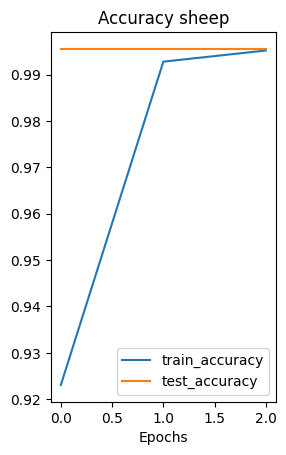

Fold 1
-------
Epoch: 1 | train_loss: 0.4177 | train_acc: 0.8774 | test_loss: 0.2699 | test_acc: 0.9598
Epoch: 2 | train_loss: 0.1382 | train_acc: 0.9808 | test_loss: 0.1466 | test_acc: 0.9509
Epoch: 3 | train_loss: 0.0677 | train_acc: 0.9856 | test_loss: 0.1096 | test_acc: 0.9598


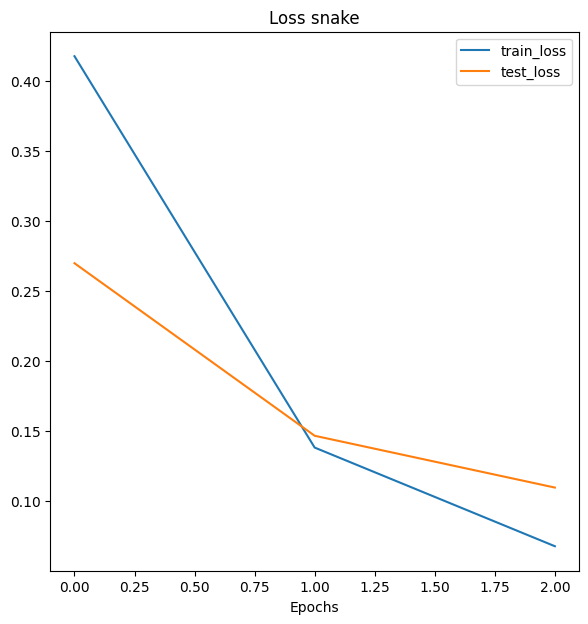

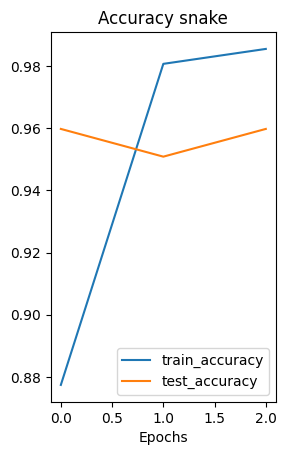

Fold 2
-------
Epoch: 1 | train_loss: 0.3545 | train_acc: 0.9207 | test_loss: 0.1496 | test_acc: 0.9911
Epoch: 2 | train_loss: 0.0911 | train_acc: 0.9904 | test_loss: 0.1054 | test_acc: 0.9821
Epoch: 3 | train_loss: 0.0451 | train_acc: 0.9976 | test_loss: 0.0536 | test_acc: 0.9911


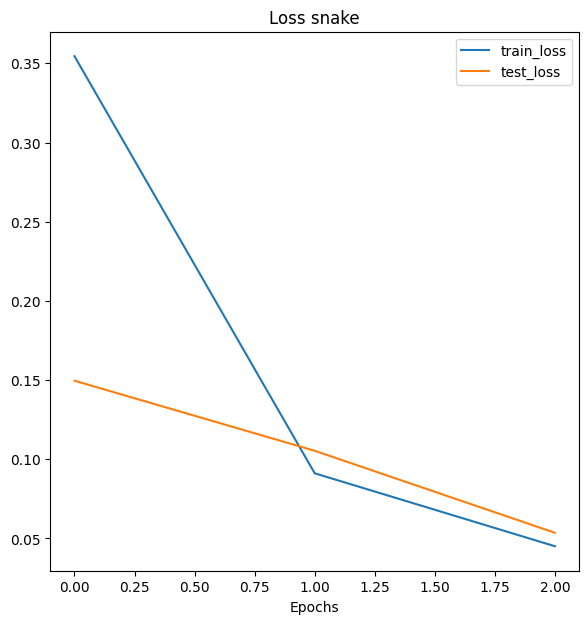

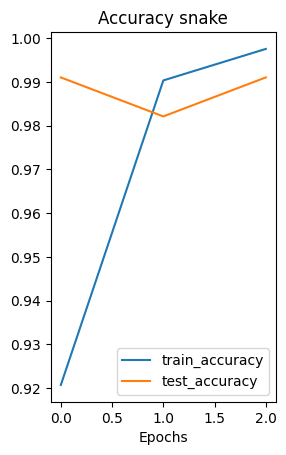

Fold 3
-------
Epoch: 1 | train_loss: 0.3529 | train_acc: 0.9135 | test_loss: 0.1219 | test_acc: 0.9955
Epoch: 2 | train_loss: 0.0817 | train_acc: 0.9880 | test_loss: 0.0509 | test_acc: 0.9955
Epoch: 3 | train_loss: 0.0436 | train_acc: 0.9904 | test_loss: 0.0321 | test_acc: 0.9955


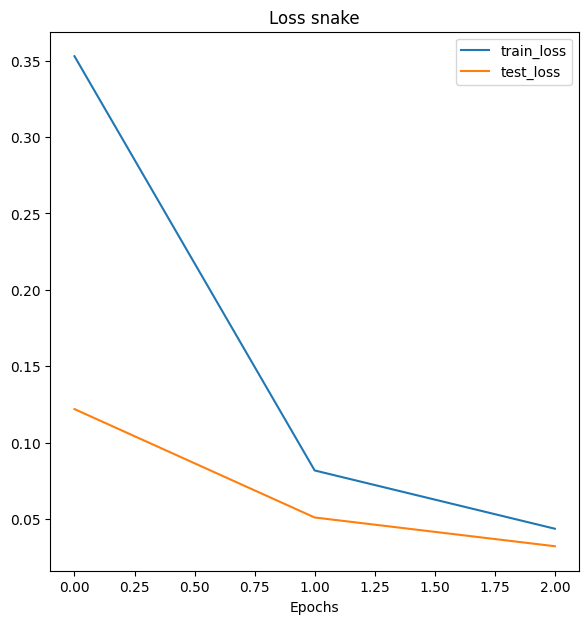

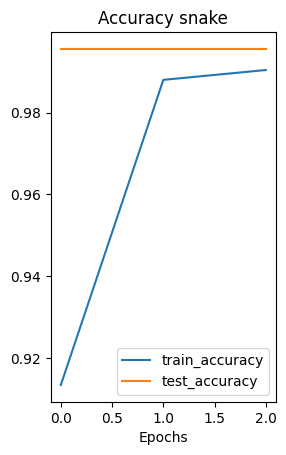

Fold 1
-------
Epoch: 1 | train_loss: 0.3998 | train_acc: 0.8870 | test_loss: 0.2665 | test_acc: 0.9464
Epoch: 2 | train_loss: 0.1442 | train_acc: 0.9591 | test_loss: 0.1217 | test_acc: 0.9688
Epoch: 3 | train_loss: 0.0699 | train_acc: 0.9832 | test_loss: 0.0802 | test_acc: 0.9866


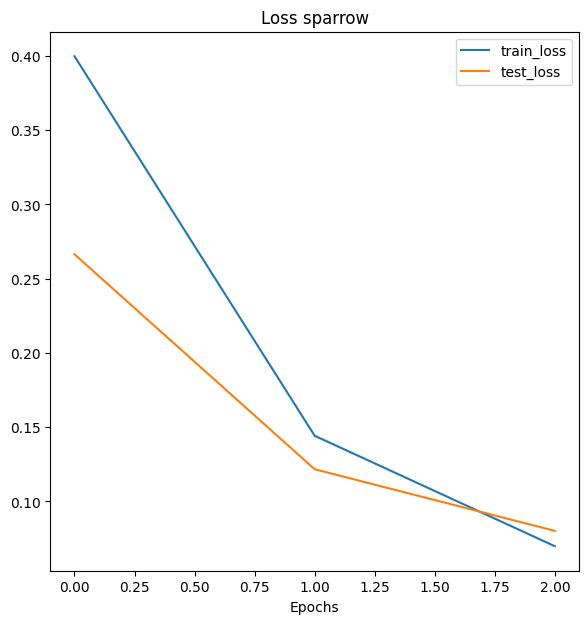

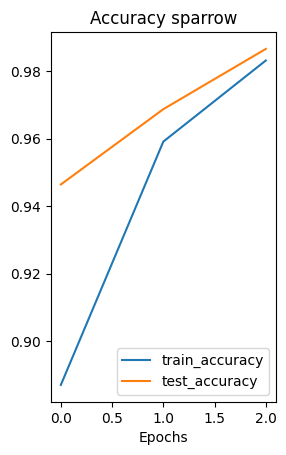

Fold 2
-------
Epoch: 1 | train_loss: 0.3499 | train_acc: 0.8942 | test_loss: 0.1502 | test_acc: 0.9777
Epoch: 2 | train_loss: 0.1099 | train_acc: 0.9784 | test_loss: 0.0719 | test_acc: 0.9821
Epoch: 3 | train_loss: 0.0472 | train_acc: 0.9904 | test_loss: 0.0530 | test_acc: 0.9821


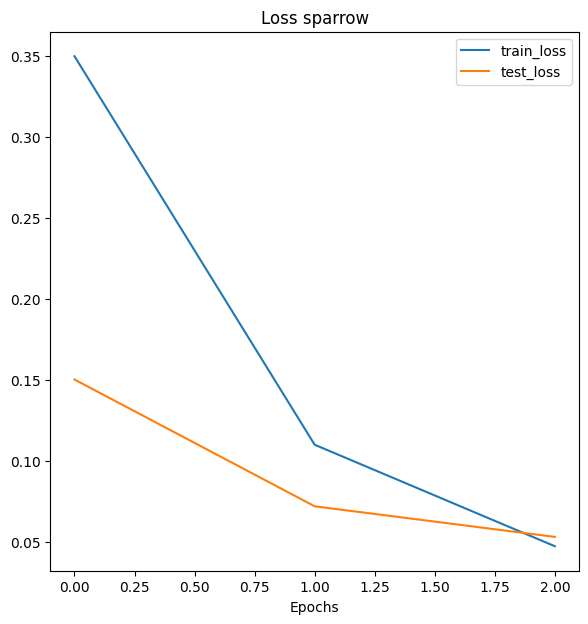

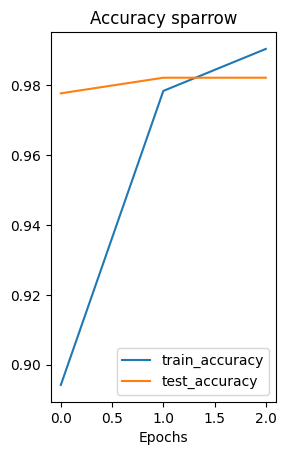

Fold 3
-------
Epoch: 1 | train_loss: 0.3688 | train_acc: 0.8726 | test_loss: 0.1280 | test_acc: 0.9911
Epoch: 2 | train_loss: 0.0807 | train_acc: 0.9880 | test_loss: 0.0515 | test_acc: 0.9955
Epoch: 3 | train_loss: 0.0453 | train_acc: 0.9880 | test_loss: 0.0345 | test_acc: 0.9955


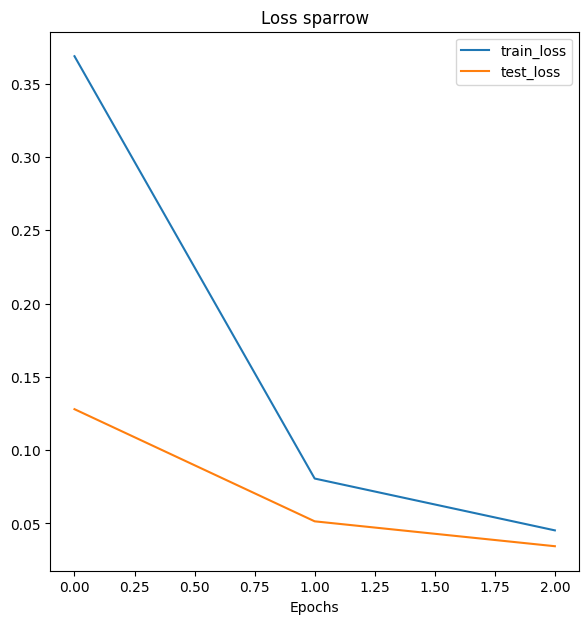

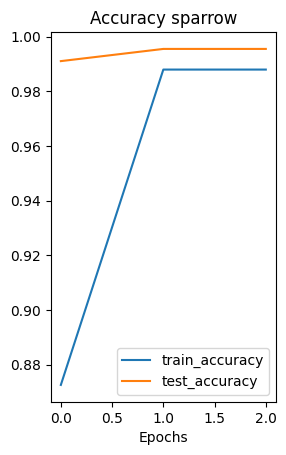

Fold 1
-------
Epoch: 1 | train_loss: 0.4572 | train_acc: 0.8317 | test_loss: 0.3508 | test_acc: 0.8929
Epoch: 2 | train_loss: 0.1892 | train_acc: 0.9447 | test_loss: 0.2343 | test_acc: 0.9330
Epoch: 3 | train_loss: 0.1092 | train_acc: 0.9808 | test_loss: 0.1790 | test_acc: 0.9330


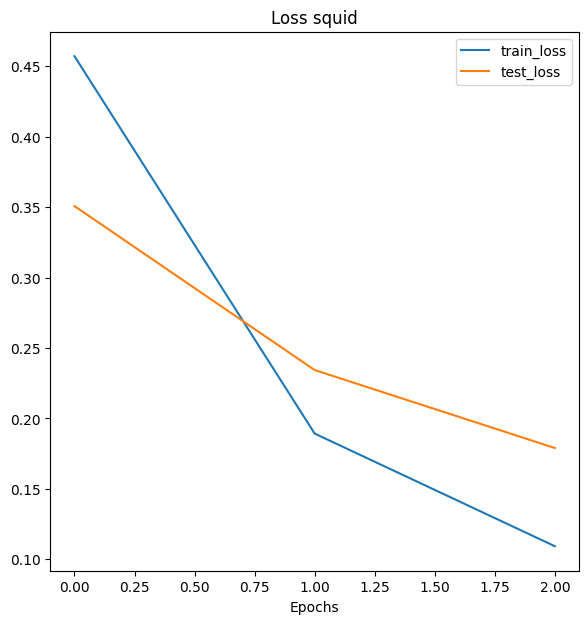

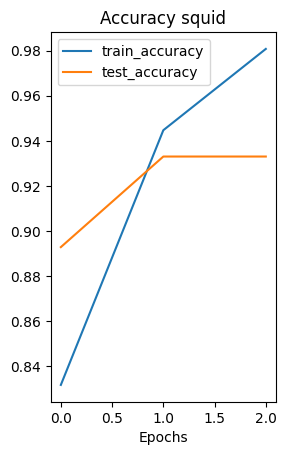

Fold 2
-------
Epoch: 1 | train_loss: 0.4194 | train_acc: 0.8510 | test_loss: 0.1908 | test_acc: 0.9688
Epoch: 2 | train_loss: 0.1415 | train_acc: 0.9736 | test_loss: 0.1035 | test_acc: 0.9866
Epoch: 3 | train_loss: 0.0731 | train_acc: 0.9856 | test_loss: 0.0806 | test_acc: 0.9866


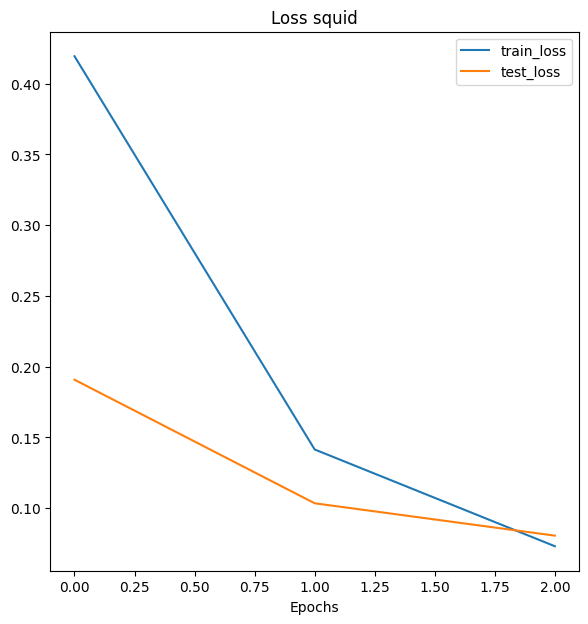

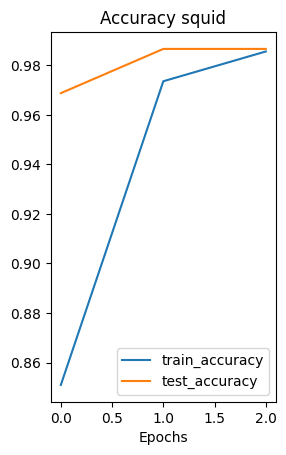

Fold 3
-------
Epoch: 1 | train_loss: 0.3319 | train_acc: 0.9303 | test_loss: 0.1572 | test_acc: 0.9777
Epoch: 2 | train_loss: 0.0947 | train_acc: 0.9880 | test_loss: 0.0758 | test_acc: 0.9866
Epoch: 3 | train_loss: 0.0457 | train_acc: 1.0000 | test_loss: 0.0810 | test_acc: 0.9732


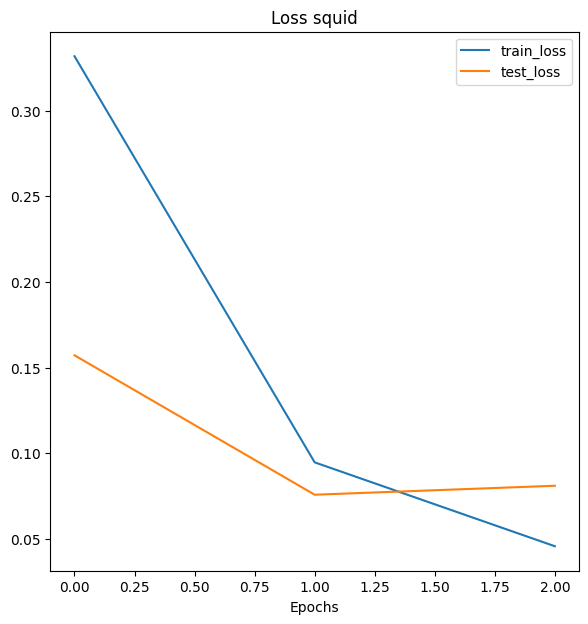

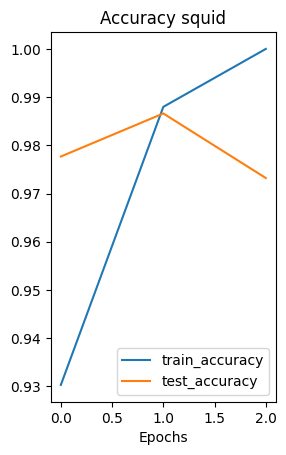

Fold 1
-------
Epoch: 1 | train_loss: 0.4624 | train_acc: 0.8317 | test_loss: 0.3129 | test_acc: 0.9464
Epoch: 2 | train_loss: 0.1854 | train_acc: 0.9495 | test_loss: 0.1701 | test_acc: 0.9509
Epoch: 3 | train_loss: 0.1017 | train_acc: 0.9880 | test_loss: 0.1144 | test_acc: 0.9821


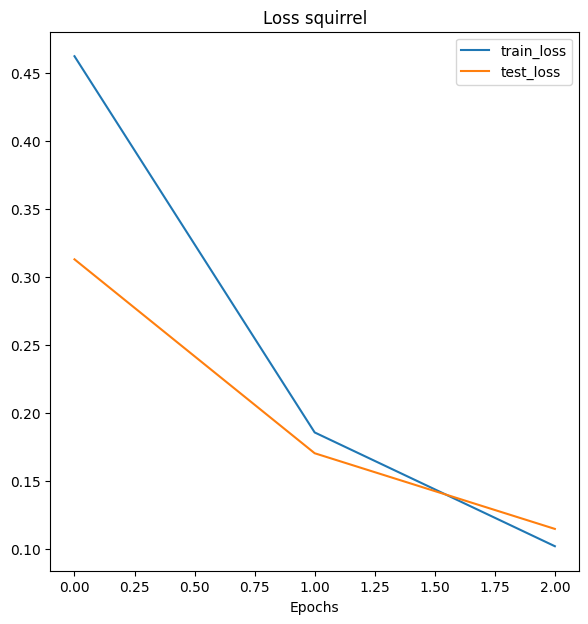

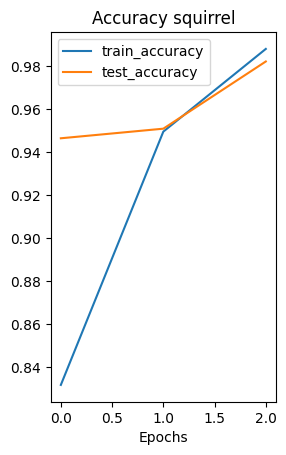

Fold 2
-------
Epoch: 1 | train_loss: 0.3473 | train_acc: 0.9255 | test_loss: 0.1754 | test_acc: 0.9643
Epoch: 2 | train_loss: 0.1187 | train_acc: 0.9808 | test_loss: 0.1000 | test_acc: 0.9732
Epoch: 3 | train_loss: 0.0718 | train_acc: 0.9808 | test_loss: 0.0794 | test_acc: 0.9777


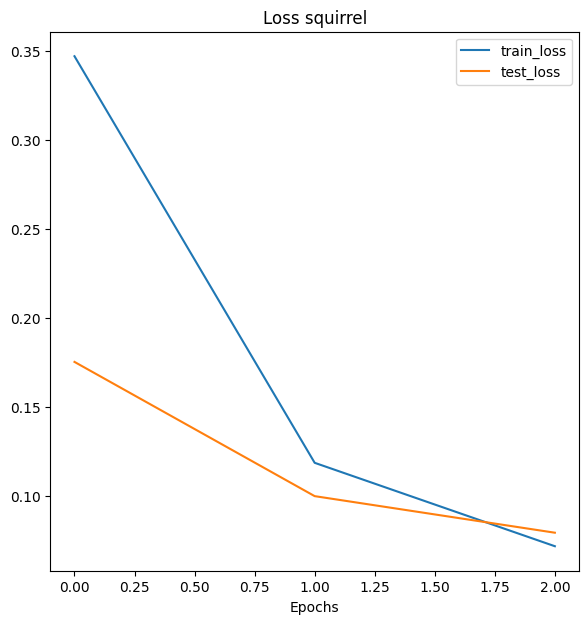

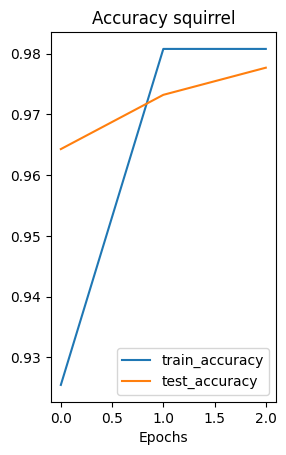

Fold 3
-------
Epoch: 1 | train_loss: 0.3448 | train_acc: 0.9279 | test_loss: 0.1294 | test_acc: 0.9955
Epoch: 2 | train_loss: 0.1064 | train_acc: 0.9736 | test_loss: 0.0572 | test_acc: 1.0000
Epoch: 3 | train_loss: 0.0607 | train_acc: 0.9832 | test_loss: 0.0339 | test_acc: 0.9955


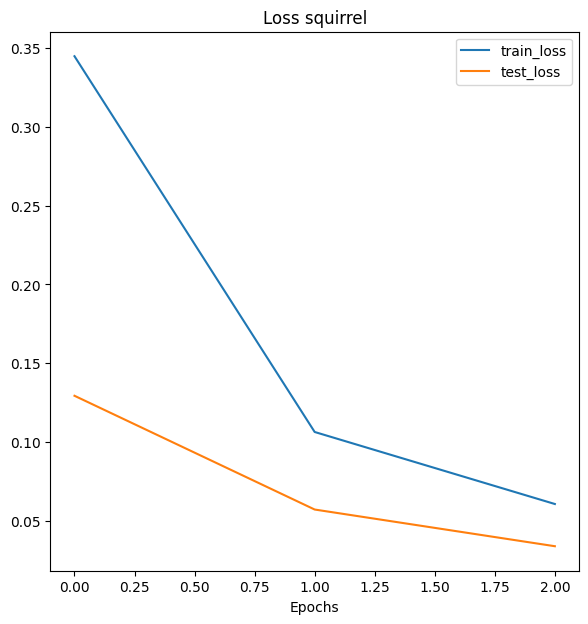

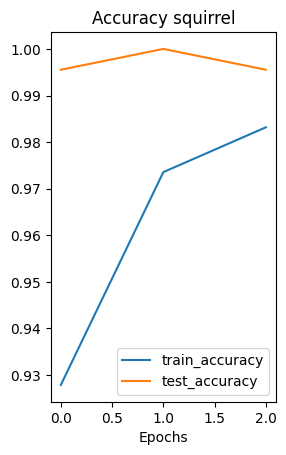

Fold 1
-------
Epoch: 1 | train_loss: 0.3875 | train_acc: 0.8822 | test_loss: 0.2707 | test_acc: 0.9330
Epoch: 2 | train_loss: 0.1212 | train_acc: 0.9808 | test_loss: 0.1339 | test_acc: 0.9866
Epoch: 3 | train_loss: 0.0553 | train_acc: 0.9952 | test_loss: 0.1416 | test_acc: 0.9643


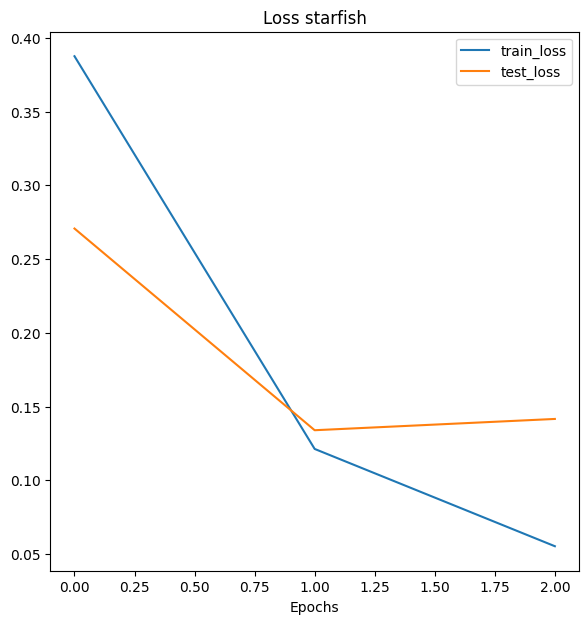

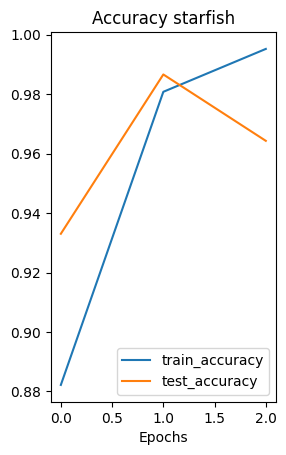

Fold 2
-------
Epoch: 1 | train_loss: 0.3300 | train_acc: 0.9471 | test_loss: 0.1287 | test_acc: 0.9955
Epoch: 2 | train_loss: 0.0751 | train_acc: 0.9904 | test_loss: 0.0555 | test_acc: 0.9955
Epoch: 3 | train_loss: 0.0381 | train_acc: 0.9976 | test_loss: 0.0355 | test_acc: 0.9911


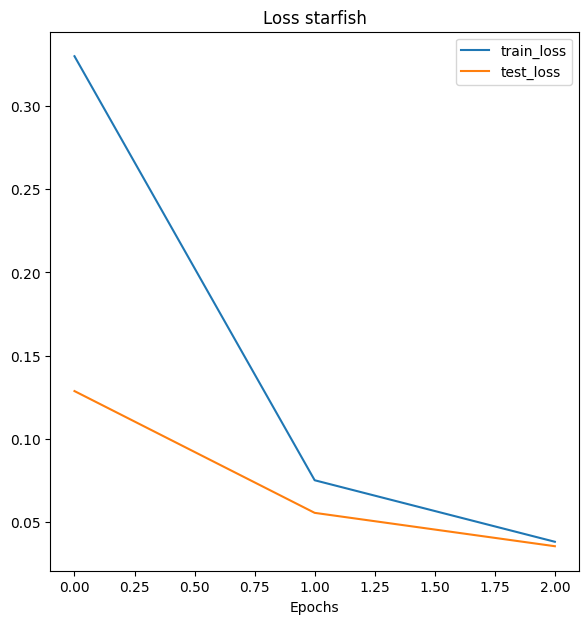

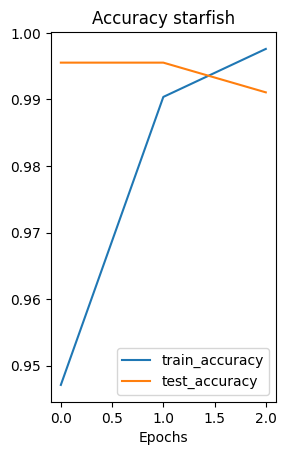

Fold 3
-------
Epoch: 1 | train_loss: 0.3574 | train_acc: 0.8942 | test_loss: 0.1313 | test_acc: 0.9955
Epoch: 2 | train_loss: 0.0752 | train_acc: 0.9952 | test_loss: 0.0546 | test_acc: 1.0000
Epoch: 3 | train_loss: 0.0316 | train_acc: 0.9952 | test_loss: 0.0391 | test_acc: 1.0000


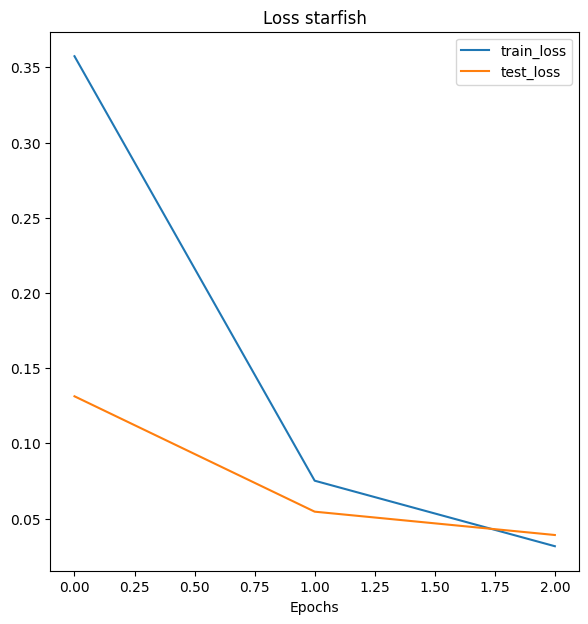

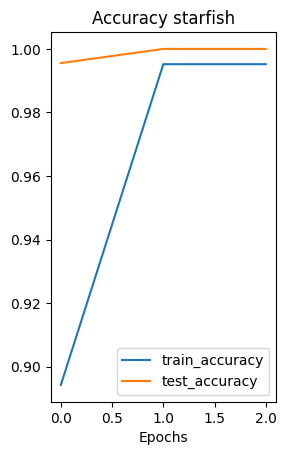

Fold 1
-------
Epoch: 1 | train_loss: 0.4314 | train_acc: 0.8462 | test_loss: 0.2870 | test_acc: 0.9464
Epoch: 2 | train_loss: 0.1557 | train_acc: 0.9712 | test_loss: 0.1425 | test_acc: 0.9598
Epoch: 3 | train_loss: 0.0737 | train_acc: 0.9928 | test_loss: 0.0976 | test_acc: 0.9732


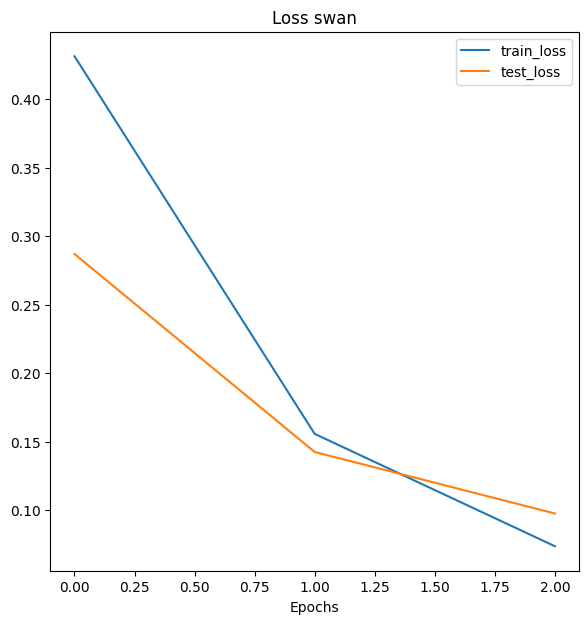

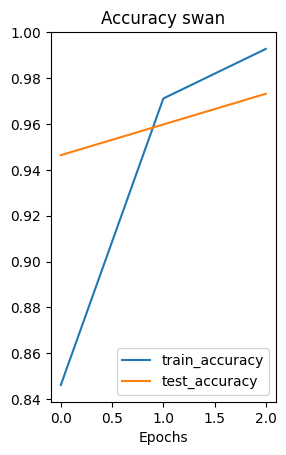

Fold 2
-------
Epoch: 1 | train_loss: 0.3820 | train_acc: 0.8918 | test_loss: 0.1892 | test_acc: 0.9821
Epoch: 2 | train_loss: 0.1125 | train_acc: 0.9880 | test_loss: 0.1006 | test_acc: 0.9866
Epoch: 3 | train_loss: 0.0515 | train_acc: 0.9928 | test_loss: 0.0724 | test_acc: 0.9955


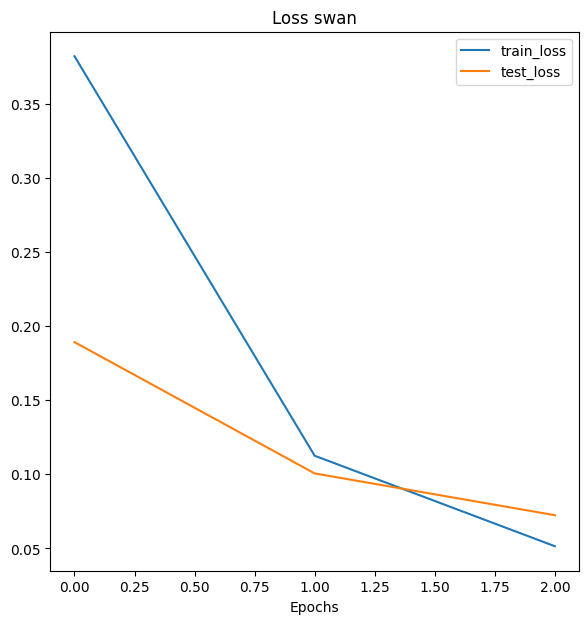

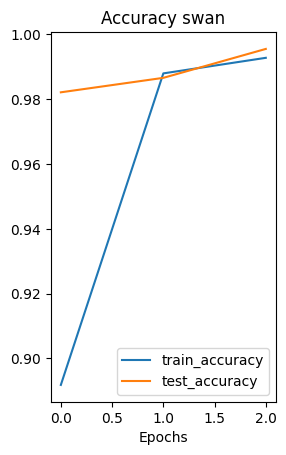

Fold 3
-------
Epoch: 1 | train_loss: 0.3627 | train_acc: 0.8918 | test_loss: 0.1288 | test_acc: 0.9955
Epoch: 2 | train_loss: 0.0890 | train_acc: 0.9952 | test_loss: 0.0546 | test_acc: 0.9955
Epoch: 3 | train_loss: 0.0462 | train_acc: 0.9928 | test_loss: 0.0353 | test_acc: 1.0000


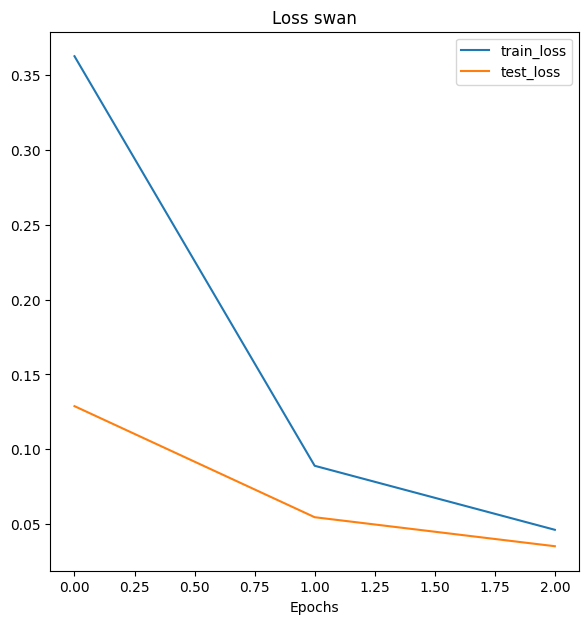

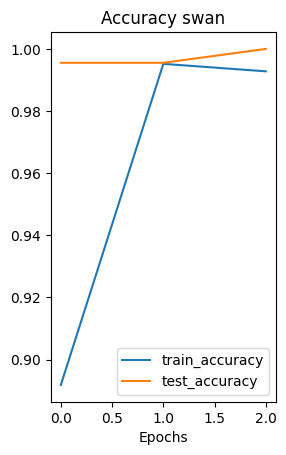

Fold 1
-------
Epoch: 1 | train_loss: 0.4180 | train_acc: 0.8438 | test_loss: 0.2370 | test_acc: 0.9643
Epoch: 2 | train_loss: 0.1387 | train_acc: 0.9663 | test_loss: 0.1209 | test_acc: 0.9777
Epoch: 3 | train_loss: 0.0563 | train_acc: 0.9904 | test_loss: 0.0816 | test_acc: 0.9821


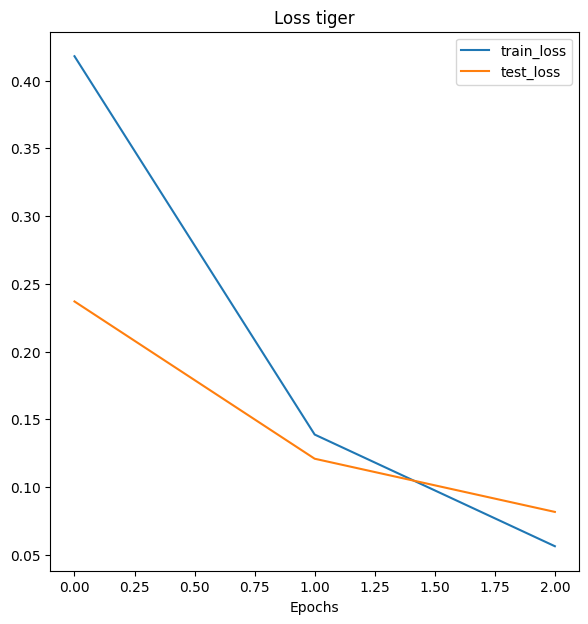

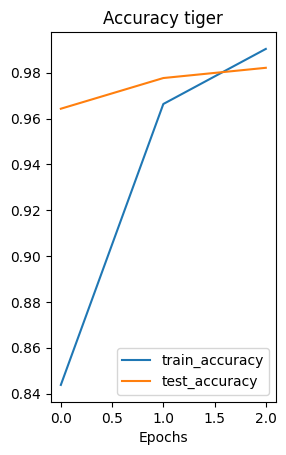

Fold 2
-------
Epoch: 1 | train_loss: 0.3570 | train_acc: 0.8942 | test_loss: 0.1573 | test_acc: 0.9732
Epoch: 2 | train_loss: 0.0829 | train_acc: 0.9856 | test_loss: 0.0695 | test_acc: 0.9866
Epoch: 3 | train_loss: 0.0486 | train_acc: 0.9928 | test_loss: 0.0530 | test_acc: 0.9866


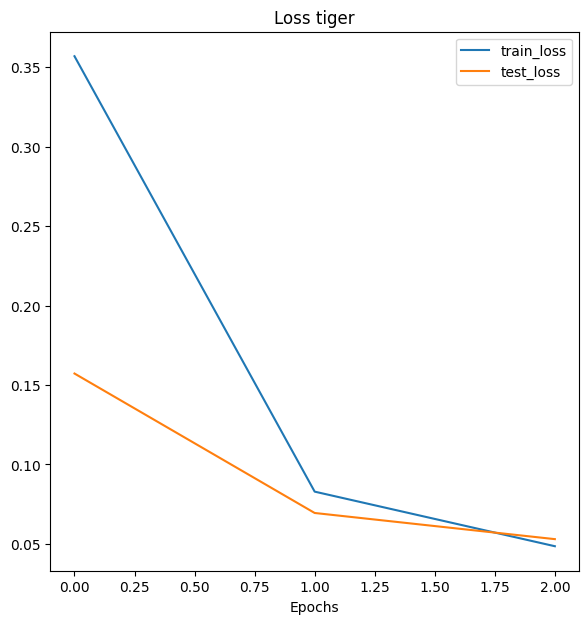

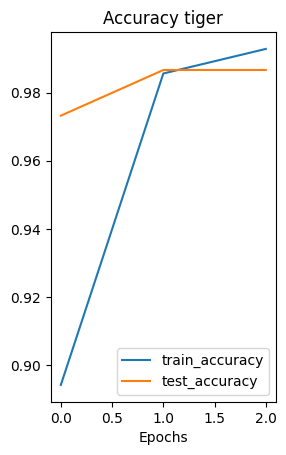

Fold 3
-------
Epoch: 1 | train_loss: 0.3216 | train_acc: 0.9231 | test_loss: 0.0957 | test_acc: 0.9955
Epoch: 2 | train_loss: 0.0694 | train_acc: 0.9928 | test_loss: 0.0347 | test_acc: 0.9911
Epoch: 3 | train_loss: 0.0384 | train_acc: 0.9928 | test_loss: 0.0227 | test_acc: 0.9911


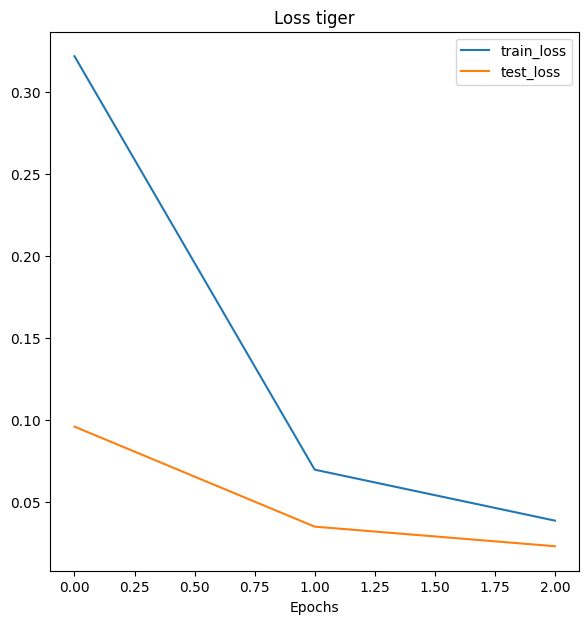

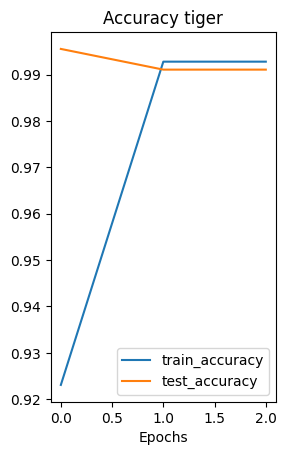

Fold 1
-------
Epoch: 1 | train_loss: 0.4265 | train_acc: 0.8870 | test_loss: 0.3079 | test_acc: 0.9464
Epoch: 2 | train_loss: 0.1545 | train_acc: 0.9736 | test_loss: 0.1413 | test_acc: 0.9821
Epoch: 3 | train_loss: 0.0761 | train_acc: 0.9880 | test_loss: 0.0867 | test_acc: 0.9866


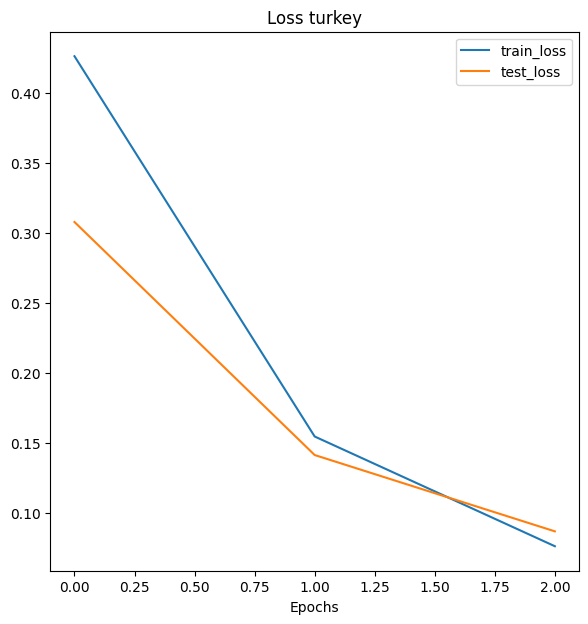

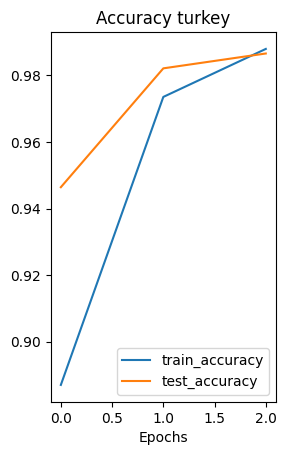

Fold 2
-------
Epoch: 1 | train_loss: 0.3634 | train_acc: 0.9303 | test_loss: 0.1855 | test_acc: 0.9821
Epoch: 2 | train_loss: 0.0923 | train_acc: 0.9952 | test_loss: 0.1032 | test_acc: 0.9866
Epoch: 3 | train_loss: 0.0430 | train_acc: 0.9976 | test_loss: 0.0758 | test_acc: 0.9866


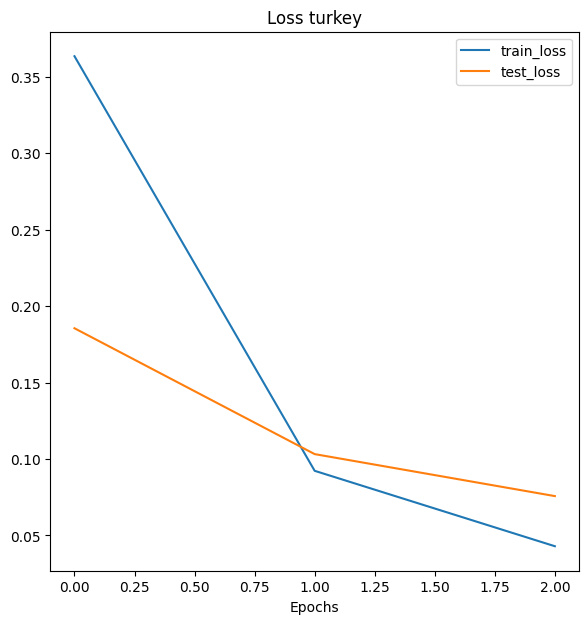

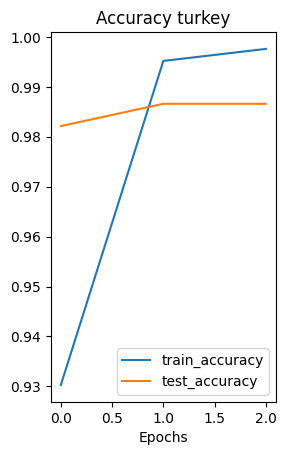

Fold 3
-------
Epoch: 1 | train_loss: 0.3669 | train_acc: 0.9062 | test_loss: 0.1200 | test_acc: 0.9955
Epoch: 2 | train_loss: 0.0858 | train_acc: 0.9928 | test_loss: 0.0541 | test_acc: 0.9955
Epoch: 3 | train_loss: 0.0446 | train_acc: 0.9928 | test_loss: 0.0295 | test_acc: 0.9955


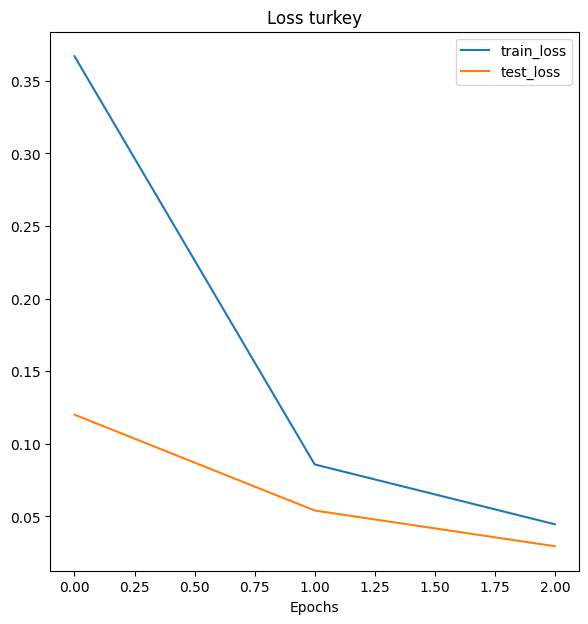

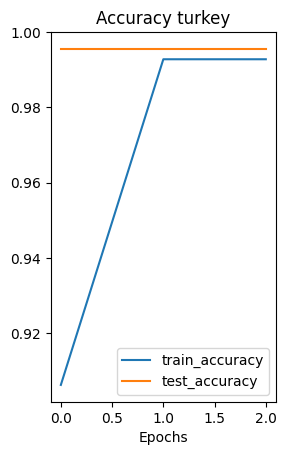

Fold 1
-------
Epoch: 1 | train_loss: 0.4105 | train_acc: 0.8918 | test_loss: 0.2618 | test_acc: 0.9330
Epoch: 2 | train_loss: 0.1291 | train_acc: 0.9760 | test_loss: 0.1299 | test_acc: 0.9643
Epoch: 3 | train_loss: 0.0674 | train_acc: 0.9904 | test_loss: 0.0826 | test_acc: 0.9777


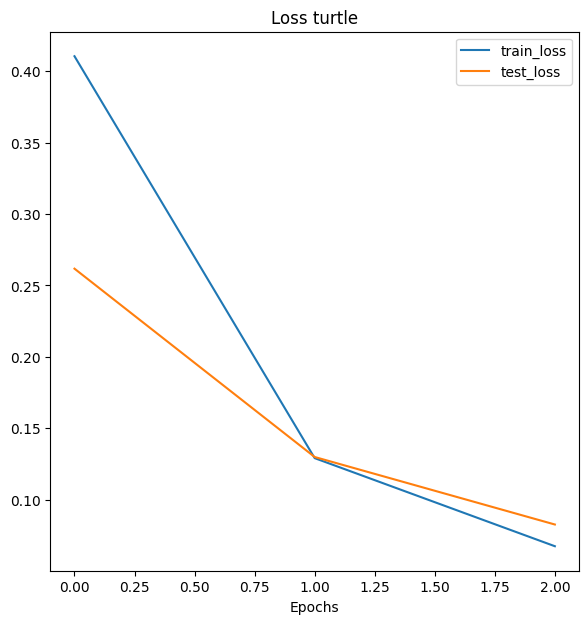

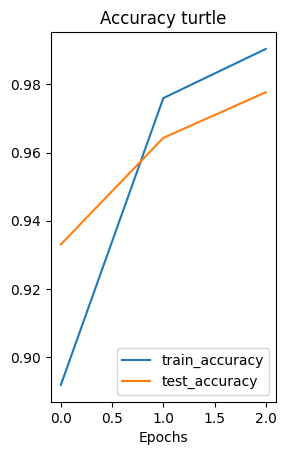

Fold 2
-------
Epoch: 1 | train_loss: 0.3748 | train_acc: 0.8942 | test_loss: 0.1593 | test_acc: 0.9911
Epoch: 2 | train_loss: 0.1012 | train_acc: 0.9880 | test_loss: 0.0680 | test_acc: 0.9955
Epoch: 3 | train_loss: 0.0578 | train_acc: 0.9904 | test_loss: 0.0482 | test_acc: 0.9955


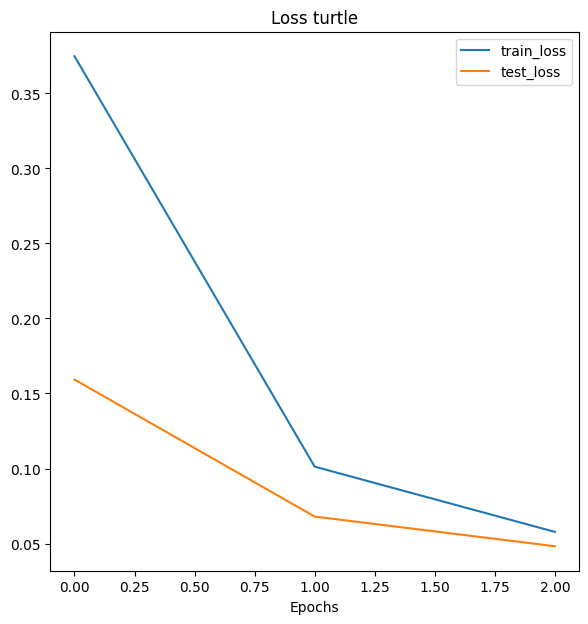

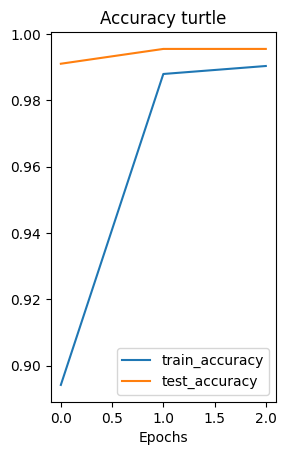

Fold 3
-------
Epoch: 1 | train_loss: 0.3295 | train_acc: 0.9207 | test_loss: 0.1150 | test_acc: 1.0000
Epoch: 2 | train_loss: 0.0752 | train_acc: 0.9976 | test_loss: 0.0550 | test_acc: 0.9955
Epoch: 3 | train_loss: 0.0353 | train_acc: 0.9976 | test_loss: 0.0333 | test_acc: 1.0000


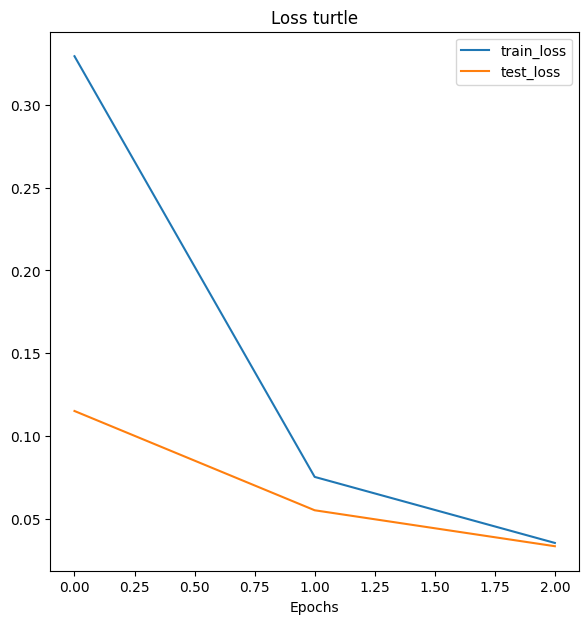

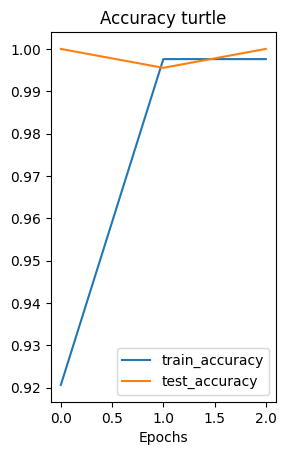

Fold 1
-------
Epoch: 1 | train_loss: 0.4381 | train_acc: 0.8678 | test_loss: 0.3015 | test_acc: 0.9241
Epoch: 2 | train_loss: 0.1721 | train_acc: 0.9543 | test_loss: 0.1784 | test_acc: 0.9464
Epoch: 3 | train_loss: 0.1007 | train_acc: 0.9760 | test_loss: 0.1174 | test_acc: 0.9732


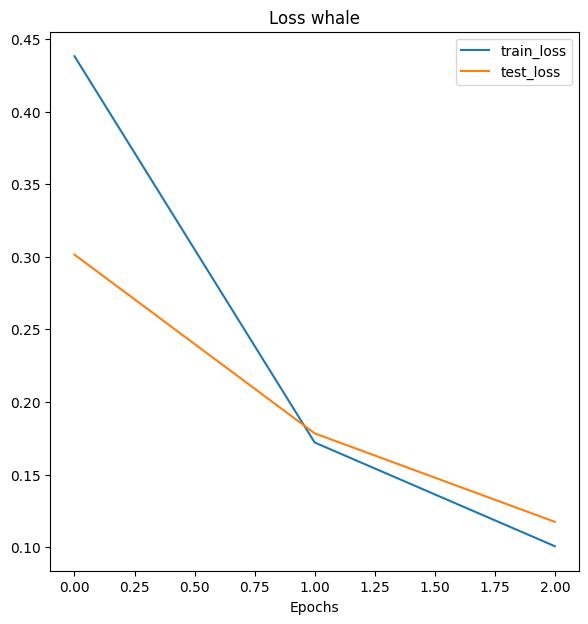

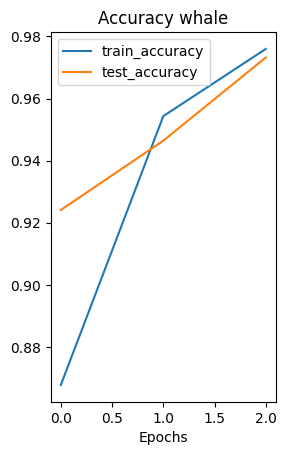

Fold 2
-------
Epoch: 1 | train_loss: 0.3485 | train_acc: 0.9399 | test_loss: 0.1671 | test_acc: 0.9777
Epoch: 2 | train_loss: 0.1191 | train_acc: 0.9784 | test_loss: 0.0893 | test_acc: 0.9866
Epoch: 3 | train_loss: 0.0619 | train_acc: 0.9856 | test_loss: 0.0622 | test_acc: 0.9911


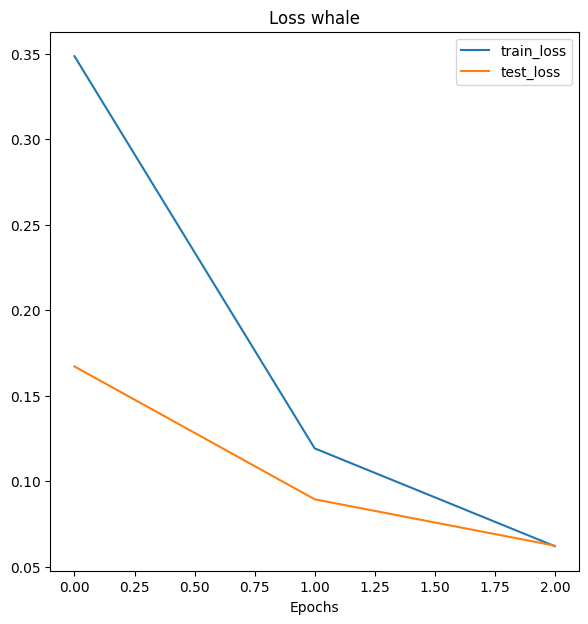

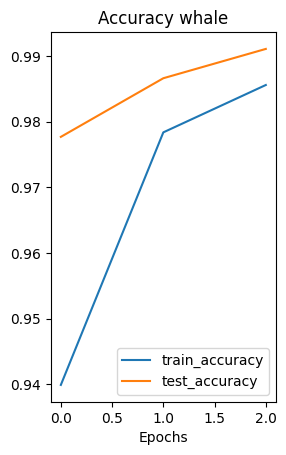

Fold 3
-------
Epoch: 1 | train_loss: 0.4285 | train_acc: 0.8125 | test_loss: 0.1717 | test_acc: 0.9911
Epoch: 2 | train_loss: 0.1035 | train_acc: 0.9856 | test_loss: 0.0686 | test_acc: 0.9911
Epoch: 3 | train_loss: 0.0482 | train_acc: 0.9976 | test_loss: 0.0477 | test_acc: 0.9911


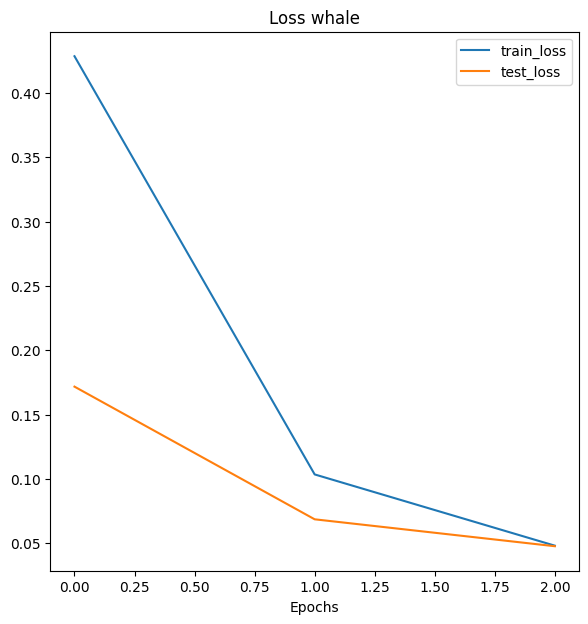

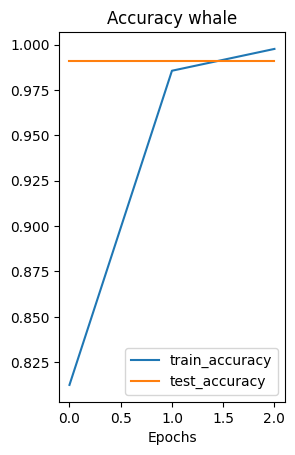

Fold 1
-------
Epoch: 1 | train_loss: 0.3685 | train_acc: 0.9062 | test_loss: 0.3144 | test_acc: 0.9196
Epoch: 2 | train_loss: 0.1354 | train_acc: 0.9736 | test_loss: 0.1540 | test_acc: 0.9420
Epoch: 3 | train_loss: 0.0640 | train_acc: 0.9808 | test_loss: 0.0975 | test_acc: 0.9732


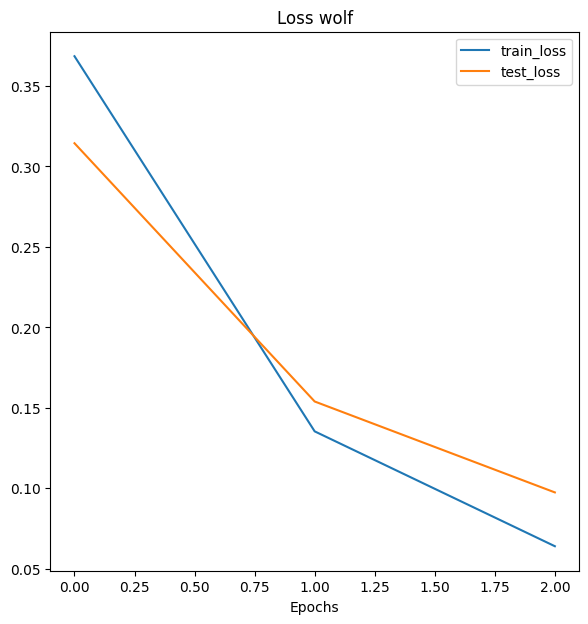

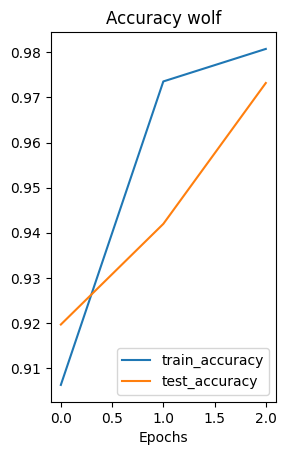

Fold 2
-------
Epoch: 1 | train_loss: 0.3465 | train_acc: 0.9231 | test_loss: 0.1689 | test_acc: 0.9821
Epoch: 2 | train_loss: 0.0995 | train_acc: 0.9832 | test_loss: 0.0957 | test_acc: 0.9821
Epoch: 3 | train_loss: 0.0684 | train_acc: 0.9712 | test_loss: 0.0780 | test_acc: 0.9821


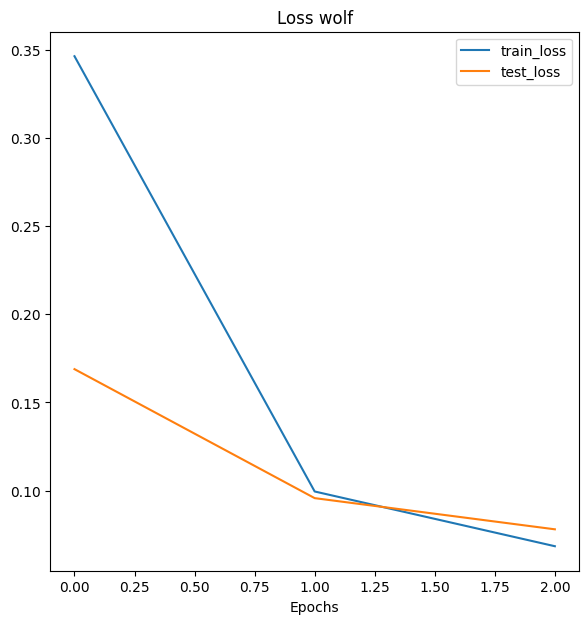

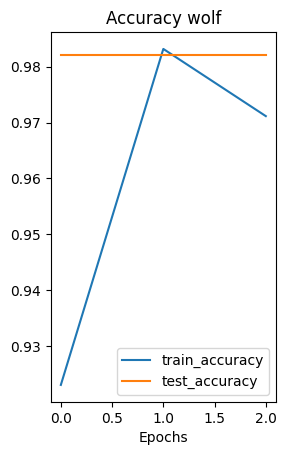

Fold 3
-------
Epoch: 1 | train_loss: 0.3724 | train_acc: 0.8822 | test_loss: 0.1471 | test_acc: 0.9732
Epoch: 2 | train_loss: 0.1107 | train_acc: 0.9688 | test_loss: 0.0515 | test_acc: 0.9866
Epoch: 3 | train_loss: 0.0611 | train_acc: 0.9808 | test_loss: 0.0404 | test_acc: 0.9866


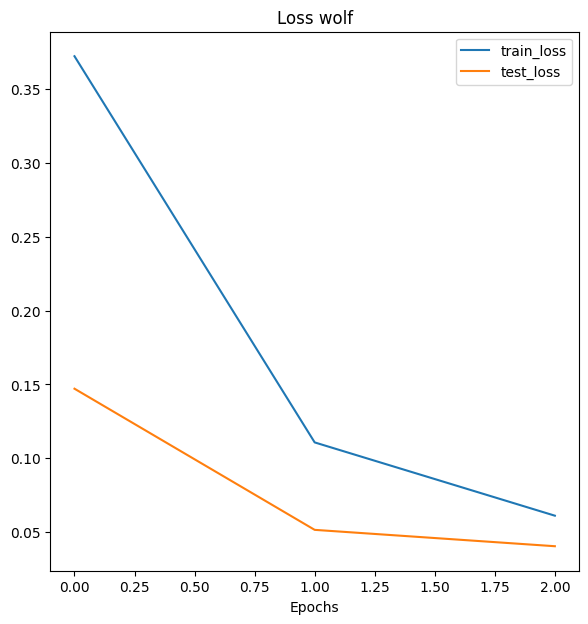

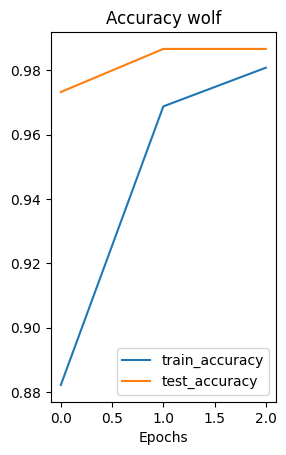

Fold 1
-------
Epoch: 1 | train_loss: 0.3849 | train_acc: 0.8918 | test_loss: 0.2650 | test_acc: 0.9330
Epoch: 2 | train_loss: 0.1152 | train_acc: 0.9856 | test_loss: 0.1206 | test_acc: 0.9598
Epoch: 3 | train_loss: 0.0663 | train_acc: 0.9856 | test_loss: 0.1148 | test_acc: 0.9688


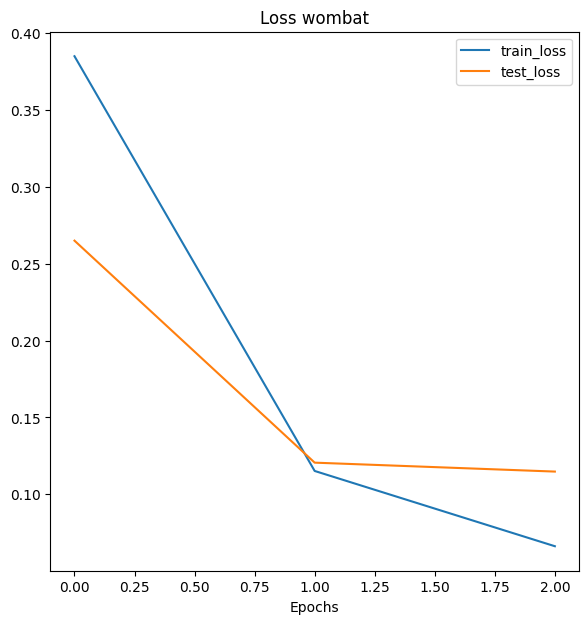

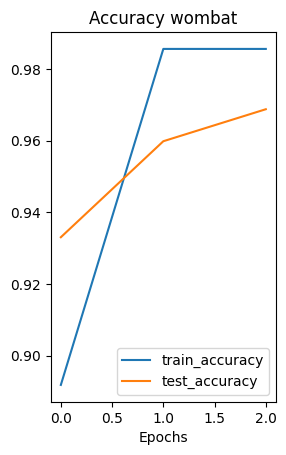

Fold 2
-------
Epoch: 1 | train_loss: 0.4146 | train_acc: 0.8582 | test_loss: 0.1621 | test_acc: 0.9955
Epoch: 2 | train_loss: 0.1039 | train_acc: 0.9856 | test_loss: 0.0621 | test_acc: 1.0000
Epoch: 3 | train_loss: 0.0600 | train_acc: 0.9808 | test_loss: 0.0451 | test_acc: 1.0000


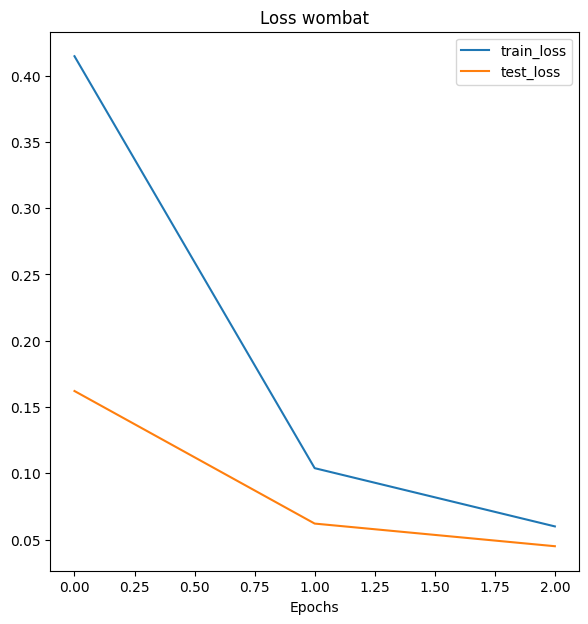

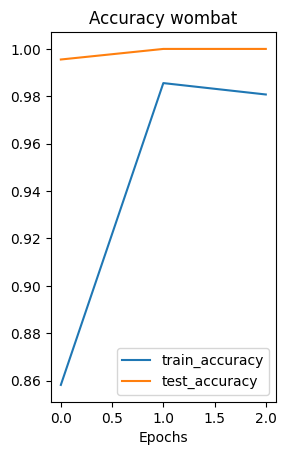

Fold 3
-------
Epoch: 1 | train_loss: 0.3265 | train_acc: 0.9231 | test_loss: 0.1287 | test_acc: 0.9866
Epoch: 2 | train_loss: 0.0777 | train_acc: 0.9928 | test_loss: 0.0522 | test_acc: 1.0000
Epoch: 3 | train_loss: 0.0421 | train_acc: 0.9904 | test_loss: 0.0428 | test_acc: 1.0000


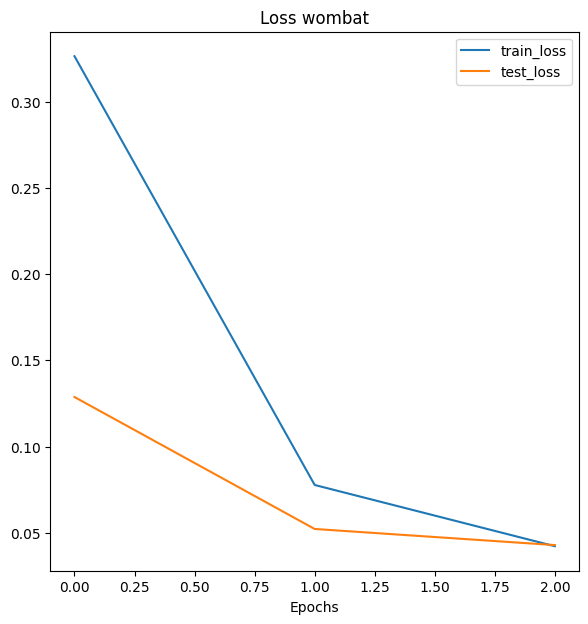

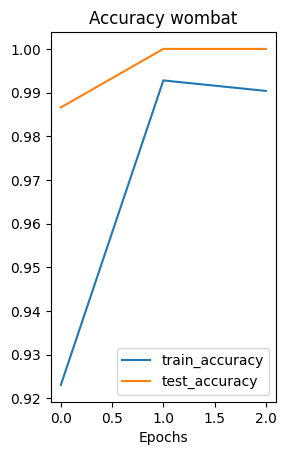

Fold 1
-------
Epoch: 1 | train_loss: 0.4370 | train_acc: 0.8486 | test_loss: 0.3022 | test_acc: 0.9330
Epoch: 2 | train_loss: 0.1656 | train_acc: 0.9663 | test_loss: 0.1708 | test_acc: 0.9643
Epoch: 3 | train_loss: 0.0824 | train_acc: 0.9928 | test_loss: 0.1317 | test_acc: 0.9688


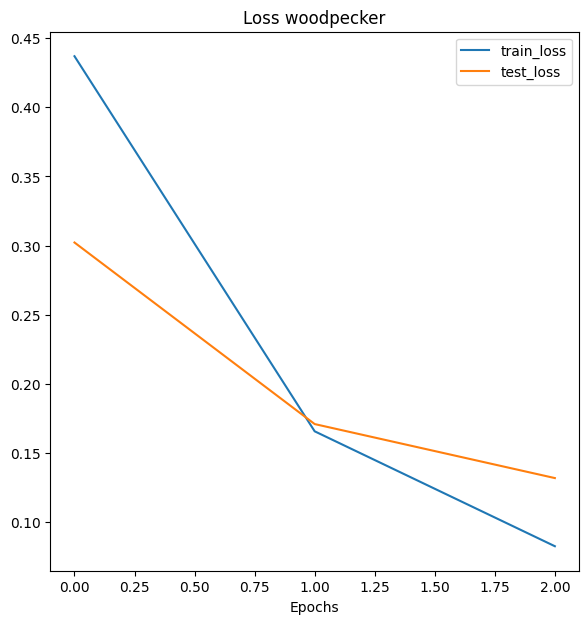

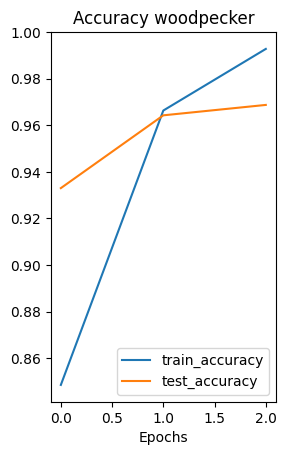

Fold 2
-------
Epoch: 1 | train_loss: 0.3903 | train_acc: 0.9014 | test_loss: 0.1777 | test_acc: 0.9866
Epoch: 2 | train_loss: 0.1103 | train_acc: 0.9880 | test_loss: 0.0825 | test_acc: 1.0000
Epoch: 3 | train_loss: 0.0518 | train_acc: 0.9904 | test_loss: 0.0592 | test_acc: 0.9911


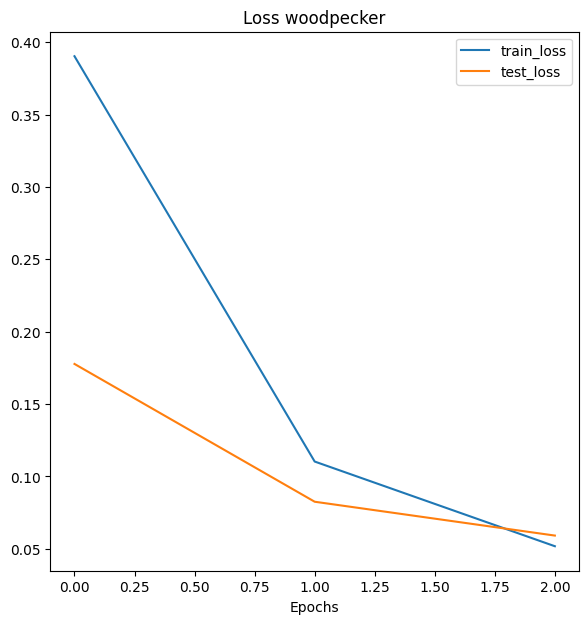

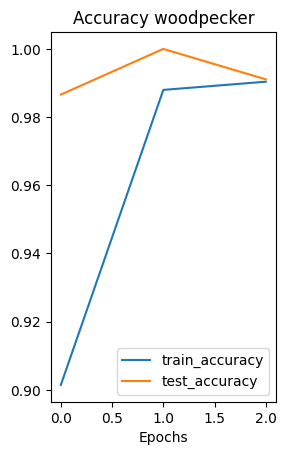

Fold 3
-------
Epoch: 1 | train_loss: 0.3496 | train_acc: 0.9183 | test_loss: 0.1351 | test_acc: 1.0000
Epoch: 2 | train_loss: 0.0826 | train_acc: 0.9928 | test_loss: 0.0646 | test_acc: 1.0000
Epoch: 3 | train_loss: 0.0490 | train_acc: 0.9904 | test_loss: 0.0407 | test_acc: 1.0000


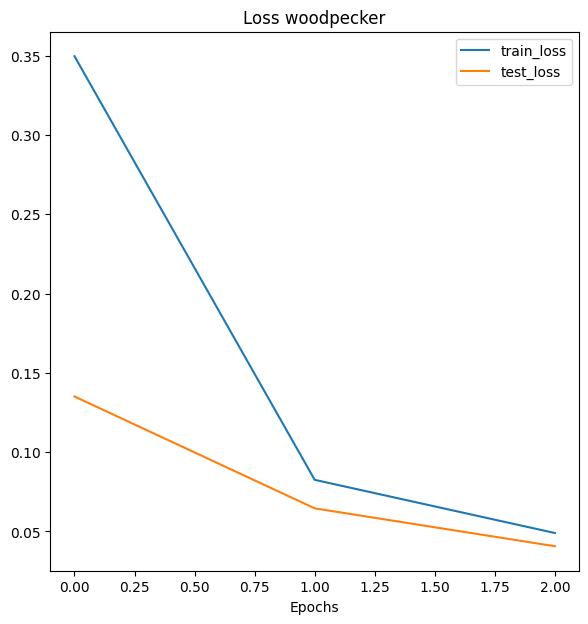

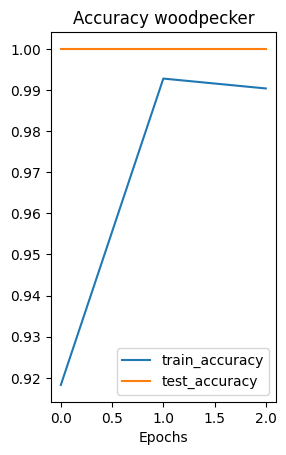

Fold 1
-------
Epoch: 1 | train_loss: 0.3928 | train_acc: 0.8918 | test_loss: 0.2555 | test_acc: 0.9732
Epoch: 2 | train_loss: 0.1091 | train_acc: 0.9928 | test_loss: 0.1064 | test_acc: 0.9911
Epoch: 3 | train_loss: 0.0495 | train_acc: 0.9976 | test_loss: 0.0682 | test_acc: 0.9955


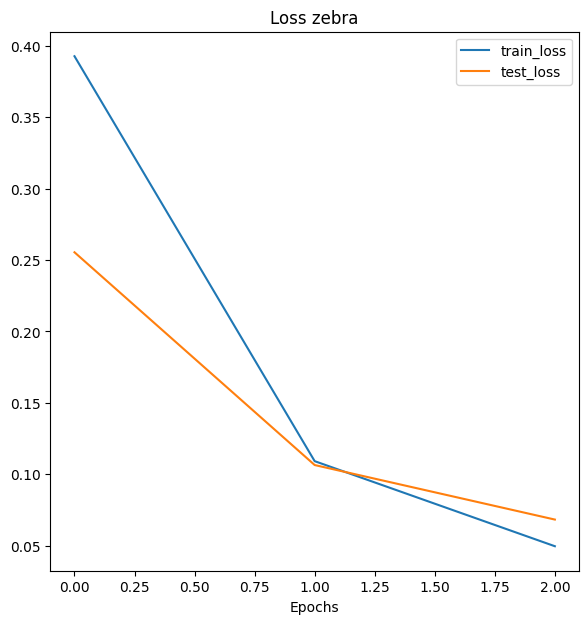

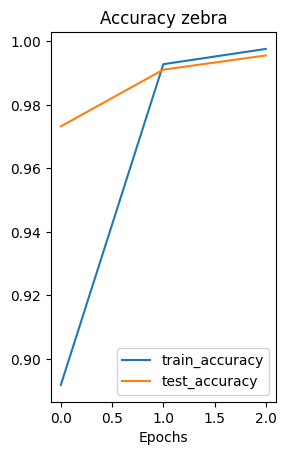

Fold 2
-------
Epoch: 1 | train_loss: 0.3290 | train_acc: 0.9519 | test_loss: 0.1295 | test_acc: 0.9955
Epoch: 2 | train_loss: 0.0676 | train_acc: 0.9976 | test_loss: 0.0545 | test_acc: 1.0000
Epoch: 3 | train_loss: 0.0332 | train_acc: 0.9976 | test_loss: 0.0352 | test_acc: 1.0000


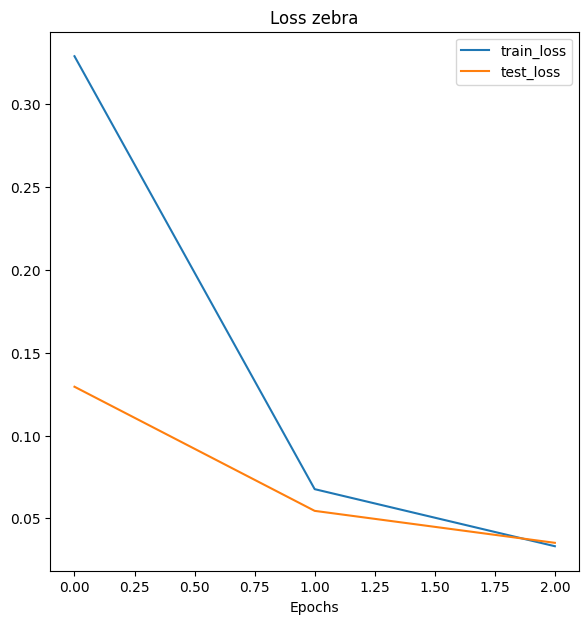

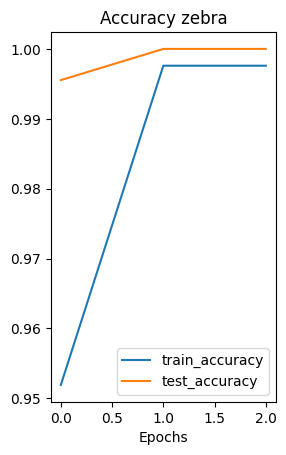

Fold 3
-------
Epoch: 1 | train_loss: 0.3261 | train_acc: 0.9327 | test_loss: 0.0993 | test_acc: 0.9955
Epoch: 2 | train_loss: 0.0656 | train_acc: 0.9976 | test_loss: 0.0400 | test_acc: 0.9955
Epoch: 3 | train_loss: 0.0293 | train_acc: 0.9976 | test_loss: 0.0286 | test_acc: 0.9955


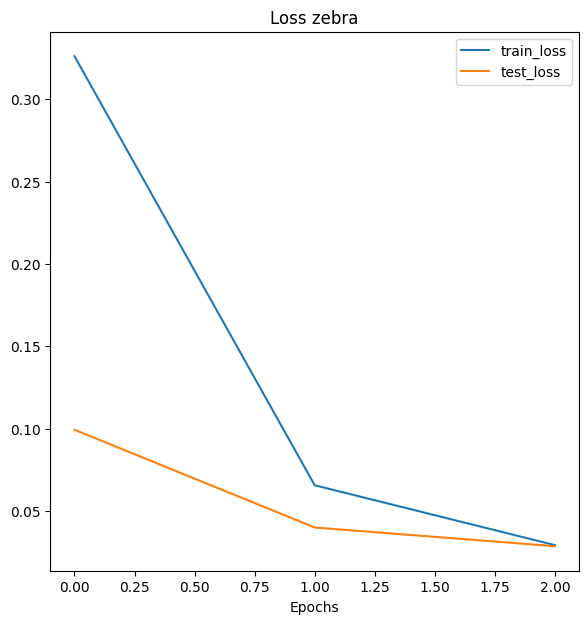

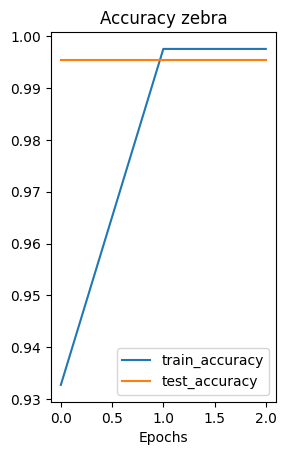

In [78]:
models = dict()
for i in df['class_name'].unique(): 
    models[i] = Model(i)
dataset_class = './dataset.csv'
# selecting_k_images('./dataset.csv', 'bear')
# Define the device (CPU or GPU)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
for i in df['class_name'].unique():
    k_folds = 3
    batch_size = 32
    # Define the device (CPU or GPU)
    selecting_k_images('./dataset.csv', i)
    loss_fn = nn.BCEWithLogitsLoss()
    df_sample = pd.read_csv('df_sample.csv')
    df_sample['class_name'] = df_sample['class_name'].apply(lambda x: 1 if x == i else 0)
    df_sample.to_csv("./df_sample.csv", index = False)
    train_data = CustomDataset("./df_sample.csv", transform = train_transform_class)
    # Initialize the k-fold cross validation
    kf = KFold(n_splits=k_folds, shuffle=True)

    # Loop through each fold
    for fold, (train_idx, test_idx) in enumerate(kf.split(train_data)):
        print(f"Fold {fold + 1}")
        print("-------")

        # Define the data loaders for the current fold
        train_loader = DataLoader(
            dataset=train_data,
            batch_size=batch_size,
            sampler=torch.utils.data.SubsetRandomSampler(train_idx),
        )
        test_loader = DataLoader(
            dataset=train_data,
            batch_size=batch_size,
            sampler=torch.utils.data.SubsetRandomSampler(test_idx),
        )
        
        model = models[i]
        model.train_mode(train_loader, test_loader, 3)

In [271]:
#5 class classification problem
animal_classes = {
    'Mammals': [
        'antelope', 'bat', 'badger', 'bear', 'bison', 'boar', 'cat', 'caterpillar',
        'chimpanzee', 'cow', 'coyote', 'deer', 'dog', 'dolphin', 'donkey',
        'elephant', 'fox', 'goat', 'gorilla', 'hamster', 'hare', 'hedgehog',
        'hippopotamus', 'horse', 'hyena', 'kangaroo', 'koala', 'leopard', 'lion',
        'mouse', 'okapi', 'orangutan', 'otter', 'panda', 'pig', 'possum', 'rabbit',
        'raccoon', 'rat', 'reindeer', 'rhinoceros', 'seal', 'sheep', 'squirrel',
        'tiger', 'whale', 'wolf', 'wombat', 'zebra', 'ox', 'porcupine'
    ],
    'Birds': [
        'crow', 'duck', 'eagle', 'flamingo', 'hornbill', 'hummingbird', 'ostrich',
        'owl', 'parrot', 'pelecaniformes', 'penguin', 'pigeon', 'sandpiper',
        'sparrow', 'swan', 'turkey', 'woodpecker', 'goose'
    ],
    'Insects': [
        'bee', 'beetle','butterfly', 'cockroach', 'dragonfly', 'fly','grasshopper', 'ladybugs', 'mosquito', 'moth'
    ],
    'Aquatic': [
        'goldfish', 'jellyfish', 'octopus', 'seahorse', 'shark', 'starfish', 'squid'
    ],
    'Other': [
        'lizard', 'snake', 'turtle', 'crab', 'lobster', 'oyster'
    ]
}



In [ ]:
def train_step(model: torch.nn.Module, 
               dataloader: torch.utils.data.DataLoader, 
               loss_fn: torch.nn.Module, 
               optimizer: torch.optim.Optimizer,
               device: torch.device):
    """Trains a PyTorch model for a single epoch.

    Turns a target PyTorch model to training mode and then
    runs through all of the required training steps (forward
    pass, loss calculation, optimizer step).

    Args:
    model: A PyTorch model to be trained.
    dataloader: A DataLoader instance for the model to be trained on.
    loss_fn: A PyTorch loss function to minimize.
    optimizer: A PyTorch optimizer to help minimize the loss function.
    device: A target device to compute on (e.g. "cuda" or "cpu").

    Returns:
    A tuple of training loss and training accuracy metrics.
    In the form (train_loss, train_accuracy). For example:

    (0.1112, 0.8743)
    """
    y_trues = list()
    y_preds = list()
    # Put model in train mode
    model.train()

    # Setup train loss and train accuracy values
    train_loss, train_acc = 0, 0

    # Loop through data loader data batches
    for batch, (X, y) in enumerate(dataloader):
        # Send data to target device
        X, y = X.to(device), y.to(device)
        # 1. Forward pass
        y_pred = model(X)

        # 2. Calculate  and accumulate loss
        loss = loss_fn(y_pred, y)
        train_loss += loss.item() 

        # 3. Optimizer zero grad
        optimizer.zero_grad()

        # 4. Loss backward
        loss.backward()

        # 5. Optimizer step
        optimizer.step()

        # Calculate and accumulate accuracy metric across all batches
        y_pred_class = torch.argmax(torch.softmax(y_pred, dim=1), dim=1)
        train_acc += (y_pred_class == y).sum().item()/len(y_pred)
        y_trues.extend(list(y.cpu().numpy()))
        y_preds.extend(list(y_pred_class.cpu().numpy()))
    # Adjust metrics to get average loss and accuracy per batch 
    print(classification_report(y_trues, y_preds))

    # Adjust metrics to get average loss and accuracy per batch 
    train_loss = train_loss / len(dataloader)
    train_acc = train_acc / len(dataloader)
    return train_loss, train_acc

def test_step(model: torch.nn.Module, 
              dataloader: torch.utils.data.DataLoader, 
              loss_fn: torch.nn.Module,
              device: torch.device):
    """Tests a PyTorch model for a single epoch.

    Turns a target PyTorch model to "eval" mode and then performs
    a forward pass on a testing dataset.

    Args:
    model: A PyTorch model to be tested.
    dataloader: A DataLoader instance for the model to be tested on.
    loss_fn: A PyTorch loss function to calculate loss on the test data.
    device: A target device to compute on (e.g. "cuda" or "cpu").

    Returns:
    A tuple of testing loss and testing accuracy metrics.
    In the form (test_loss, test_accuracy). For example:

    (0.0223, 0.8985)
    """
    # Put model in eval mode
    y_trues = list()
    y_preds = list()
    model.eval() 

    # Setup test loss and test accuracy values
    test_loss, test_acc = 0, 0

    # Turn on inference context manager
    with torch.inference_mode():
        # Loop through DataLoader batches
        for batch, (X, y) in enumerate(dataloader):
            # Send data to target device
            X, y = X.to(device), y.to(device)
            
            # 1. Forward pass
            test_pred_logits = model(X)

            # 2. Calculate and accumulate loss
            loss = loss_fn(test_pred_logits, y)
            test_loss += loss.item()

            # Calculate and accumulate accuracy
            test_pred_labels = test_pred_logits.argmax(dim=1)
            test_acc += ((test_pred_labels == y).sum().item()/len(test_pred_labels))
            y_trues.extend(list(y.cpu().numpy()))
            y_preds.extend(list(test_pred_labels.cpu().numpy()))
    # Adjust metrics to get average loss and accuracy per batch 
    print(classification_report(y_trues, y_preds))
            
    # Adjust metrics to get average loss and accuracy per batch 
    test_loss = test_loss / len(dataloader)
    test_acc = test_acc / len(dataloader)
    return test_loss, test_acc

def train(model: torch.nn.Module, 
          train_dataloader: torch.utils.data.DataLoader, 
          test_dataloader: torch.utils.data.DataLoader, 
          optimizer: torch.optim.Optimizer,
          loss_fn: torch.nn.Module,
          epochs: int,
          device: torch.device):
    """Trains and tests a PyTorch model.

    Passes a target PyTorch models through train_step() and test_step()
    functions for a number of epochs, training and testing the model
    in the same epoch loop.

    Calculates, prints and stores evaluation metrics throughout.

    Args:
    model: A PyTorch model to be trained and tested.
    train_dataloader: A DataLoader instance for the model to be trained on.
    test_dataloader: A DataLoader instance for the model to be tested on.
    optimizer: A PyTorch optimizer to help minimize the loss function.
    loss_fn: A PyTorch loss function to calculate loss on both datasets.
    epochs: An integer indicating how many epochs to train for.
    device: A target device to compute on (e.g. "cuda" or "cpu").

    Returns:
    A dictionary of training and testing loss as well as training and
    testing accuracy metrics. Each metric has a value in a list for 
    each epoch.
    In the form: {train_loss: [...],
              train_acc: [...],
              test_loss: [...],
              test_acc: [...]} 
    For example if training for epochs=2: 
             {train_loss: [2.0616, 1.0537],
              train_acc: [0.3945, 0.3945],
              test_loss: [1.2641, 1.5706],
              test_acc: [0.3400, 0.2973]} 
    """
    # Create empty results dictionary
    early_stopping = EarlyStopping(tolerance=2, min_delta=5)
    results = {"train_loss": [],
               "train_acc": [],
               "test_loss": [],
               "test_acc": []
    }
    
    # Make sure model on target device
    model.to(device)

    # Loop through training and testing steps for a number of epochs
    for epoch in range(epochs):
        train_loss, train_acc = train_step(model=model,
                                          dataloader=train_dataloader,
                                          loss_fn=loss_fn,
                                          optimizer=optimizer,
                                          device=device)
        test_loss, test_acc = test_step(model=model,
          dataloader=test_dataloader,
          loss_fn=loss_fn,
          device=device)
        
        # Print out what's happening
        print(
          f"Epoch: {epoch+1} | "
          f"train_loss: {train_loss:.4f} | "
          f"train_acc: {train_acc:.4f} | "
          f"test_loss: {test_loss:.4f} | "
          f"test_acc: {test_acc:.4f}"
        )

        # Update results dictionary
        results["train_loss"].append(train_loss)
        results["train_acc"].append(train_acc)
        results["test_loss"].append(test_loss)
        results["test_acc"].append(test_acc)
        
        early_stopping(results['train_loss'][epoch], results['test_loss'][epoch])
        if early_stopping.early_stop:
            print("We are at epoch:", i)
            break
    # Return the filled results at the end of the epochs
    return results

In [273]:
df

,class_name,file_path
0,antelope,C:\Users\pares\Documents\animal_classification...
1,antelope,C:\Users\pares\Documents\animal_classification...
2,antelope,C:\Users\pares\Documents\animal_classification...
3,antelope,C:\Users\pares\Documents\animal_classification...
4,antelope,C:\Users\pares\Documents\animal_classification...
...,...,...
5395,zebra,C:\Users\pares\Documents\animal_classification...
5396,zebra,C:\Users\pares\Documents\animal_classification...
5397,zebra,C:\Users\pares\Documents\animal_classification...
5398,zebra,C:\Users\pares\Documents\animal_classification...


In [274]:
df_5_class = df.copy()

In [275]:
for idx, i in enumerate(df_5_class['class_name']):
    class_name_idx = {"Mammals": 0, "Birds": 1, 'Insects': 2, "Aquatic": 3, "Other": 4}
    for j, k in  animal_classes.items():
        if i in k: 
            df_5_class['class_name'][idx] = (class_name_idx[j])

In [276]:
# Data

In [277]:
df['class_name'].value_counts()

class_name
antelope     60
raccoon      60
porcupine    60
pigeon       60
pig          60
             ..
goat         60
fox          60
fly          60
flamingo     60
zebra        60
Name: count, Length: 90, dtype: int64

In [278]:
df_5_class['class_name'].value_counts()

class_name
0    3000
1    1020
2     600
3     420
4     360
Name: count, dtype: int64

In [279]:
df_5_class.to_csv("./data_5_class.csv", index = False)

In [35]:
class EarlyStopping:
    def __init__(self, tolerance=5, min_delta=0):

        self.tolerance = tolerance
        self.min_delta = min_delta
        self.counter = 0
        self.early_stop = False

    def __call__(self, train_loss, validation_loss):
        if (validation_loss - train_loss) > self.min_delta:
            self.counter +=1
            if self.counter >= self.tolerance:  
                self.early_stop = True
early_stopping = EarlyStopping(tolerance=2, min_delta=5)

In [225]:
train_transform_class = transforms.Compose([
            transforms.Resize((456, 456)), 
#             transforms.Lambda(lambda x: x.permute((2, 0, 1))),
            transforms.ToTensor(),
            transforms.Normalize(mean=[0.485, 0.456, 0.406],
                                 std=[0.229, 0.224, 0.225]),
        ])

In [226]:
output_shape = 5
eff_model_5_class.classifier = torch.nn.Sequential(
    torch.nn.Dropout(p=0.2, inplace=True), 
    torch.nn.Linear(in_features=2048, 
                    out_features=5, # same number of output units as our number of classes
                    bias=True)).to(device)

In [227]:
loss_fn = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(model.parameters(), lr=0.001)

In [228]:
train_data = CustomDataset("./data_5_class.csv", transform = train_transform)

Fold 1
-------
Epoch: 1 | train_loss: 0.5097 | train_acc: 0.8451 | test_loss: 1.2656 | test_acc: 0.8438
Epoch: 2 | train_loss: 0.2634 | train_acc: 0.9154 | test_loss: 0.6383 | test_acc: 0.8459
Epoch: 3 | train_loss: 0.1976 | train_acc: 0.9300 | test_loss: 0.5309 | test_acc: 0.8783
Epoch: 4 | train_loss: 0.1762 | train_acc: 0.9428 | test_loss: 0.6238 | test_acc: 0.8827
Epoch: 5 | train_loss: 0.1396 | train_acc: 0.9544 | test_loss: 0.5787 | test_acc: 0.8772


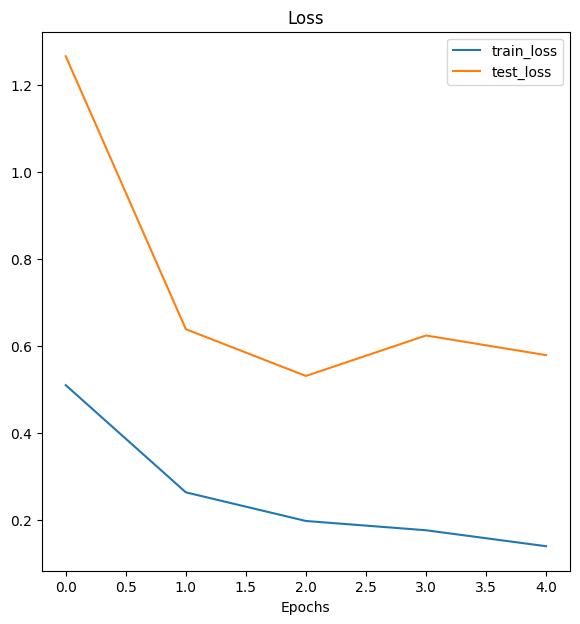

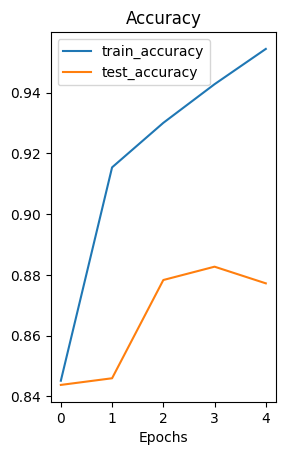

Fold 2
-------
Epoch: 1 | train_loss: 0.5051 | train_acc: 0.8363 | test_loss: 0.5647 | test_acc: 0.8723
Epoch: 2 | train_loss: 0.2548 | train_acc: 0.9176 | test_loss: 0.4499 | test_acc: 0.8865
Epoch: 3 | train_loss: 0.2039 | train_acc: 0.9303 | test_loss: 0.2929 | test_acc: 0.9134
Epoch: 4 | train_loss: 0.1636 | train_acc: 0.9447 | test_loss: 0.4820 | test_acc: 0.8690
Epoch: 5 | train_loss: 0.1308 | train_acc: 0.9563 | test_loss: 0.4844 | test_acc: 0.8997


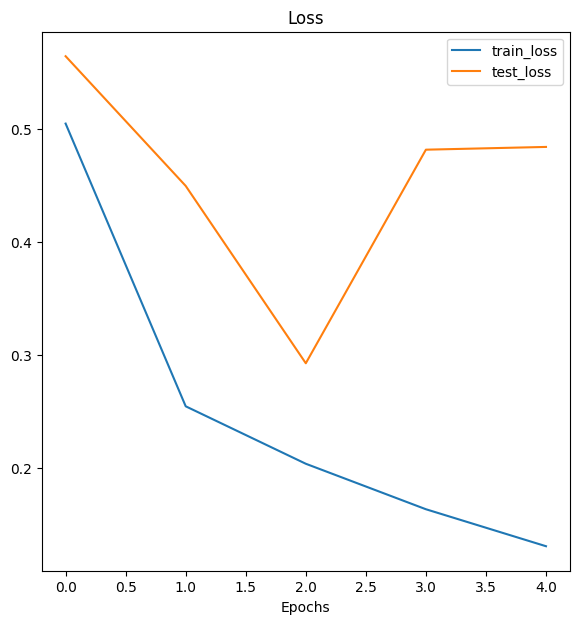

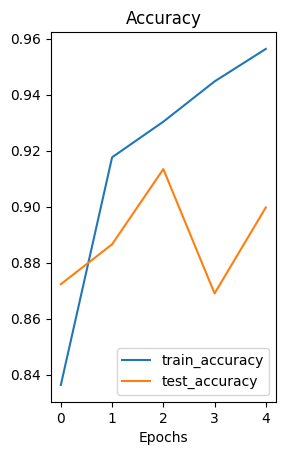

Fold 3
-------
Epoch: 1 | train_loss: 0.4851 | train_acc: 0.8435 | test_loss: 0.7430 | test_acc: 0.8498
Epoch: 2 | train_loss: 0.3255 | train_acc: 0.8955 | test_loss: 0.5497 | test_acc: 0.8662
Epoch: 3 | train_loss: 0.1938 | train_acc: 0.9372 | test_loss: 0.5388 | test_acc: 0.8734
Epoch: 4 | train_loss: 0.1673 | train_acc: 0.9505 | test_loss: 0.3147 | test_acc: 0.9079
Epoch: 5 | train_loss: 0.1256 | train_acc: 0.9566 | test_loss: 0.6764 | test_acc: 0.8547


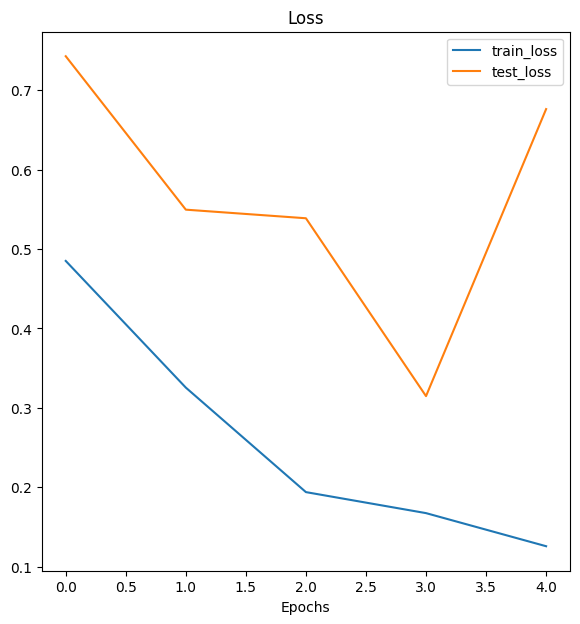

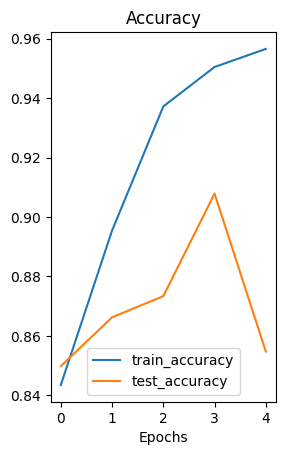

In [187]:
k_folds = 3
batch_size = 32
 
# Define the device (CPU or GPU)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Initialize the k-fold cross validation
kf = KFold(n_splits=k_folds, shuffle=True)

# Loop through each fold
for fold, (train_idx, test_idx) in enumerate(kf.split(train_data)):
    print(f"Fold {fold + 1}")
    print("-------")

    # Define the data loaders for the current fold
    train_loader = DataLoader(
        dataset=train_data,
        batch_size=batch_size,
        sampler=torch.utils.data.SubsetRandomSampler(train_idx),
    )
    test_loader = DataLoader(
        dataset=train_data,
        batch_size=batch_size,
        sampler=torch.utils.data.SubsetRandomSampler(test_idx),
    )
    weights_5_class = torchvision.models.EfficientNet_B5_Weights.DEFAULT 
    eff_model_5_class = torchvision.models.efficientnet_b5(weights=weights_5_class).to(device)
    for param in eff_model_5_class.features.parameters():
        param.requires_grad = False
    for param in eff_model_5_class.features[-5:].parameters():
        param.requires_grad = True
    output_shape = 5
    eff_model_5_class.classifier = torch.nn.Sequential(
    torch.nn.Dropout(p=0.2, inplace=True), 
    torch.nn.Linear(in_features=2048, 
                    out_features=5, # same number of output units as our number of classes
                    bias=True)).to(device)
    optimizer = torch.optim.Adam(params = eff_model_5_class.parameters(), lr=0.001)
    results = train_binary(model=eff_model_5_class,
                       train_dataloader=train_loader,
                       test_dataloade
                    r=test_loader,
                       optimizer=optimizer,
                       loss_fn=loss_fn,
                       epochs=5,
                       device=device)
    plot_loss_curves(results)
    

In [298]:
class CNN(torch.nn.Module):
    def __init__(self):
        super().__init__()
        self.model = torch.nn.Sequential(
        
            torch.nn.Conv2d(in_channels = 3, out_channels = 32, kernel_size = 3, padding = 1),
            torch.nn.MaxPool2d(kernel_size=2),
            nn.LayerNorm([32, 242, 242]),
            torch.nn.ELU(),
            torch.nn.Dropout(p=0.2),
            
            torch.nn.Conv2d(in_channels = 32, out_channels = 64, kernel_size = 3, padding = 1),
            torch.nn.MaxPool2d(kernel_size=2),
            nn.LayerNorm([64, 121, 121]),
            torch.nn.ELU(),
            torch.nn.Dropout(p=0.2),
                                     
            torch.nn.Conv2d(in_channels = 64, out_channels = 128, kernel_size = 3, padding = 1),
            torch.nn.MaxPool2d(kernel_size=2),
            nn.LayerNorm([128, 60, 60]),
            torch.nn.ELU(),
            torch.nn.Dropout(p=0.2),

            torch.nn.Conv2d(in_channels = 128, out_channels = 256, kernel_size = 3, padding = 1),
            torch.nn.MaxPool2d(kernel_size=2),
            nn.LayerNorm([256, 30, 30]),
            torch.nn.ELU(),
            torch.nn.Dropout(p=0.2),

            torch.nn.Conv2d(in_channels = 256, out_channels = 256, kernel_size = 3, padding = 1),
            torch.nn.MaxPool2d(kernel_size=2),
            nn.LayerNorm([256, 15, 15]),
            torch.nn.ELU(),
          
            
            torch.nn.Flatten(),
            torch.nn.Linear(57600, 16),
            torch.nn.ELU(),
            torch.nn.Linear(16, 2)
            
        )

    def forward(self, x):
        return self.model(x)

In [300]:
train_transform = transforms.Compose([ 
            transforms.Resize((485, 485)), 
            transforms.RandomHorizontalFlip(0.2),
            transforms.RandomVerticalFlip(0.2),
            transforms.ToTensor(),
            transforms.Normalize(mean=[0.485, 0.456, 0.406],
                                 std=[0.229, 0.224, 0.225])
        ])

In [301]:
class Model(nn.Module): 
    def __init__(self, class_name):
        super().__init__()
        self.class_name = class_name
        self.model = CNN()
        self.device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
        self.loss_fn = nn.CrossEntropyLoss(weight = weight)
    def train_mode(self, train_loader, test_loader, epoch,weight): 
        optimizer = torch.optim.Adam(params=self.model.parameters(), lr = 0.001)
        results = train(model=self.model,
                           train_dataloader=train_loader,
                           test_dataloader=test_loader,
                           optimizer=optimizer,
                           loss_fn=self.loss_fn,
                           epochs=epoch,
                           device=self.device)
        plot_loss_curves(results, self.class_name)

In [315]:
models = dict()
for i in df['class_name'].unique(): 
    models[i] = Model(i)

Fold 1 and class_name: antelope
-------
              precision    recall  f1-score   support

           0       0.83      0.74      0.78       179
           1       0.21      0.31      0.25        39

    accuracy                           0.67       218
   macro avg       0.52      0.53      0.52       218
weighted avg       0.72      0.67      0.69       218



C:\Users\pares\miniconda3\envs\ncfm\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\pares\miniconda3\envs\ncfm\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\pares\miniconda3\envs\ncfm\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


              precision    recall  f1-score   support

           0       0.81      1.00      0.89        88
           1       0.00      0.00      0.00        21

    accuracy                           0.81       109
   macro avg       0.40      0.50      0.45       109
weighted avg       0.65      0.81      0.72       109

Epoch: 1 | train_loss: 2.9631 | train_acc: 0.6700 | test_loss: 1.1551 | test_acc: 0.7903
              precision    recall  f1-score   support

           0       0.83      0.98      0.90       179
           1       0.33      0.05      0.09        39

    accuracy                           0.81       218
   macro avg       0.58      0.51      0.49       218
weighted avg       0.74      0.81      0.75       218

              precision    recall  f1-score   support

           0       0.80      0.97      0.88        88
           1       0.00      0.00      0.00        21

    accuracy                           0.78       109
   macro avg       0.40      0.48      

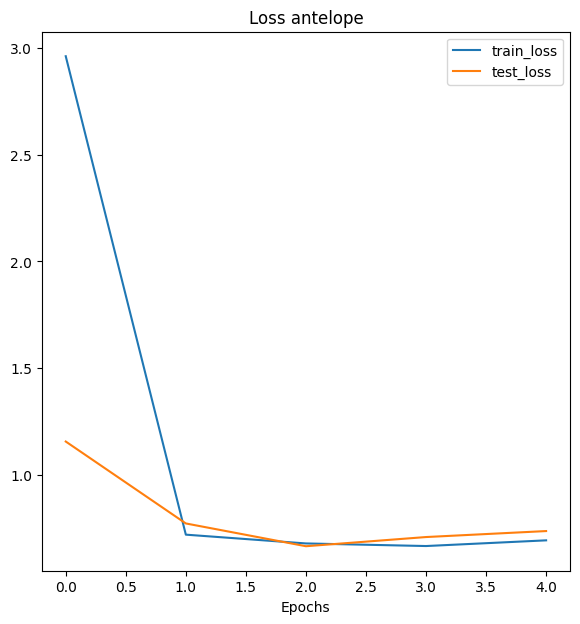

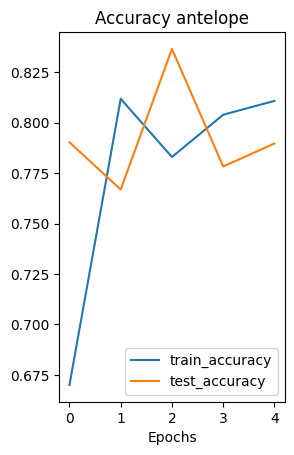

Fold 2 and class_name: antelope
-------
              precision    recall  f1-score   support

           0       0.92      0.55      0.69       179
           1       0.27      0.77      0.40        39

    accuracy                           0.59       218
   macro avg       0.59      0.66      0.55       218
weighted avg       0.80      0.59      0.64       218

              precision    recall  f1-score   support

           0       1.00      0.08      0.15        88
           1       0.21      1.00      0.34        21

    accuracy                           0.26       109
   macro avg       0.60      0.54      0.24       109
weighted avg       0.85      0.26      0.18       109

Epoch: 1 | train_loss: 1.5909 | train_acc: 0.5872 | test_loss: 0.6715 | test_acc: 0.2644
              precision    recall  f1-score   support

           0       1.00      0.01      0.02       179
           1       0.18      1.00      0.31        39

    accuracy                           0.19       218

C:\Users\pares\miniconda3\envs\ncfm\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\pares\miniconda3\envs\ncfm\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\pares\miniconda3\envs\ncfm\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


              precision    recall  f1-score   support

           0       0.00      0.00      0.00        88
           1       0.19      1.00      0.32        21

    accuracy                           0.19       109
   macro avg       0.10      0.50      0.16       109
weighted avg       0.04      0.19      0.06       109

Epoch: 2 | train_loss: 0.6885 | train_acc: 0.1872 | test_loss: 0.6944 | test_acc: 0.1755
              precision    recall  f1-score   support

           0       0.00      0.00      0.00       179
           1       0.18      0.97      0.30        39

    accuracy                           0.17       218
   macro avg       0.09      0.49      0.15       218
weighted avg       0.03      0.17      0.05       218



C:\Users\pares\miniconda3\envs\ncfm\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\pares\miniconda3\envs\ncfm\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\pares\miniconda3\envs\ncfm\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


              precision    recall  f1-score   support

           0       0.00      0.00      0.00        88
           1       0.19      1.00      0.32        21

    accuracy                           0.19       109
   macro avg       0.10      0.50      0.16       109
weighted avg       0.04      0.19      0.06       109

Epoch: 3 | train_loss: 0.6951 | train_acc: 0.1769 | test_loss: 0.6938 | test_acc: 0.1755


C:\Users\pares\miniconda3\envs\ncfm\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\pares\miniconda3\envs\ncfm\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\pares\miniconda3\envs\ncfm\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


              precision    recall  f1-score   support

           0       0.00      0.00      0.00       179
           1       0.18      1.00      0.30        39

    accuracy                           0.18       218
   macro avg       0.09      0.50      0.15       218
weighted avg       0.03      0.18      0.05       218



C:\Users\pares\miniconda3\envs\ncfm\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\pares\miniconda3\envs\ncfm\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\pares\miniconda3\envs\ncfm\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


              precision    recall  f1-score   support

           0       0.00      0.00      0.00        88
           1       0.19      1.00      0.32        21

    accuracy                           0.19       109
   macro avg       0.10      0.50      0.16       109
weighted avg       0.04      0.19      0.06       109

Epoch: 4 | train_loss: 0.6932 | train_acc: 0.1782 | test_loss: 0.6933 | test_acc: 0.1755
              precision    recall  f1-score   support

           0       0.82      0.70      0.76       179
           1       0.18      0.31      0.23        39

    accuracy                           0.63       218
   macro avg       0.50      0.51      0.49       218
weighted avg       0.71      0.63      0.66       218

              precision    recall  f1-score   support

           0       0.81      1.00      0.89        88
           1       0.00      0.00      0.00        21

    accuracy                           0.81       109
   macro avg       0.40      0.50      

C:\Users\pares\miniconda3\envs\ncfm\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\pares\miniconda3\envs\ncfm\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\pares\miniconda3\envs\ncfm\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


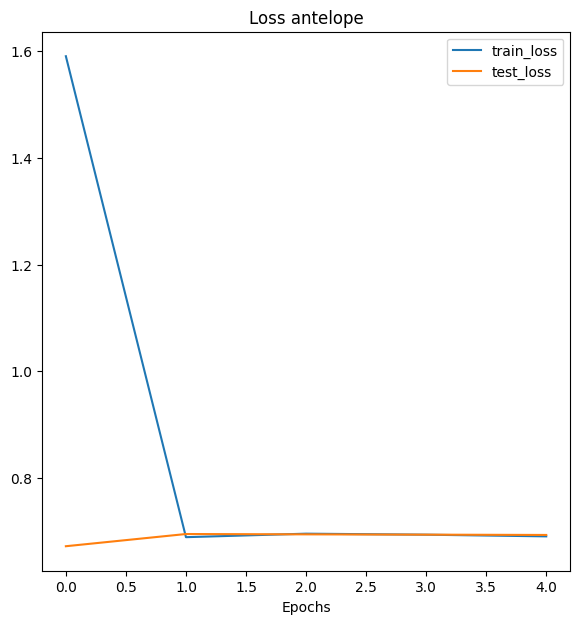

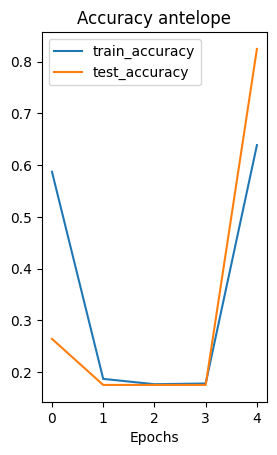

Fold 3 and class_name: antelope
-------
              precision    recall  f1-score   support

           0       0.82      0.39      0.53       176
           1       0.20      0.64      0.31        42

    accuracy                           0.44       218
   macro avg       0.51      0.52      0.42       218
weighted avg       0.70      0.44      0.49       218

              precision    recall  f1-score   support

           0       1.00      0.12      0.22        91
           1       0.18      1.00      0.31        18

    accuracy                           0.27       109
   macro avg       0.59      0.56      0.26       109
weighted avg       0.87      0.27      0.23       109

Epoch: 1 | train_loss: 1.9565 | train_acc: 0.4399 | test_loss: 0.8725 | test_acc: 0.2837
              precision    recall  f1-score   support

           0       0.83      0.03      0.05       176
           1       0.19      0.98      0.32        42

    accuracy                           0.21       218

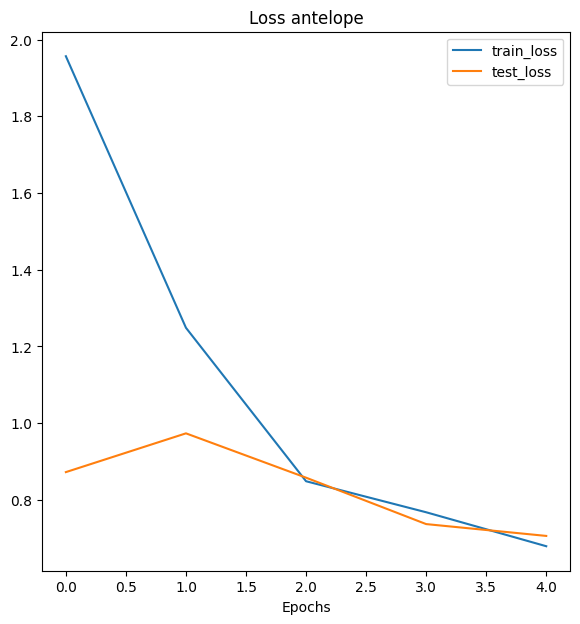

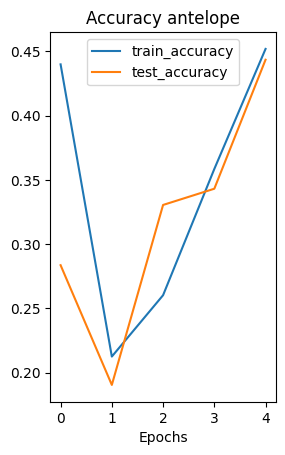

Fold 1 and class_name: badger
-------
              precision    recall  f1-score   support

           0       0.84      0.41      0.55       183
           1       0.16      0.60      0.26        35

    accuracy                           0.44       218
   macro avg       0.50      0.50      0.40       218
weighted avg       0.73      0.44      0.50       218

              precision    recall  f1-score   support

           0       0.86      0.14      0.24        84
           1       0.24      0.92      0.38        25

    accuracy                           0.32       109
   macro avg       0.55      0.53      0.31       109
weighted avg       0.72      0.32      0.28       109

Epoch: 1 | train_loss: 1.6576 | train_acc: 0.4389 | test_loss: 0.6727 | test_acc: 0.3191
              precision    recall  f1-score   support

           0       0.88      0.23      0.37       183
           1       0.17      0.83      0.28        35

    accuracy                           0.33       218
 

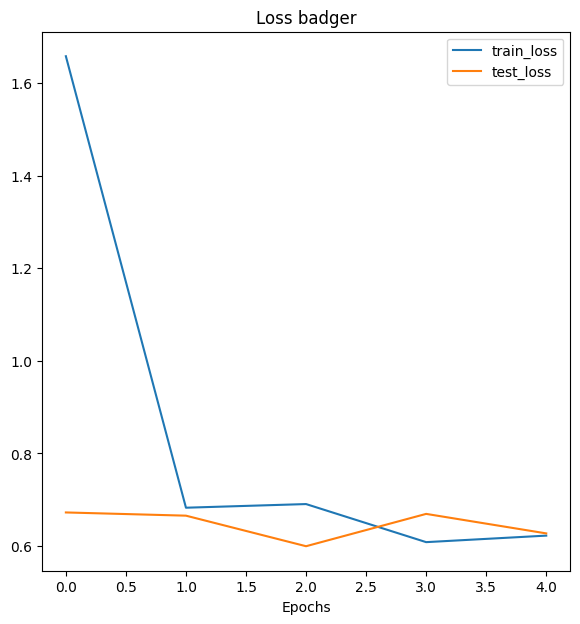

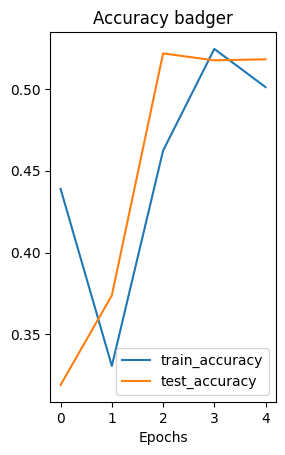

Fold 2 and class_name: badger
-------
              precision    recall  f1-score   support

           0       0.84      0.42      0.56       172
           1       0.24      0.70      0.36        46

    accuracy                           0.48       218
   macro avg       0.54      0.56      0.46       218
weighted avg       0.71      0.48      0.52       218

              precision    recall  f1-score   support

           0       0.97      0.32      0.48        95
           1       0.17      0.93      0.28        14

    accuracy                           0.39       109
   macro avg       0.57      0.62      0.38       109
weighted avg       0.86      0.39      0.45       109

Epoch: 1 | train_loss: 1.8872 | train_acc: 0.4842 | test_loss: 0.7728 | test_acc: 0.4159
              precision    recall  f1-score   support

           0       0.93      0.23      0.36       172
           1       0.24      0.93      0.39        46

    accuracy                           0.38       218
 

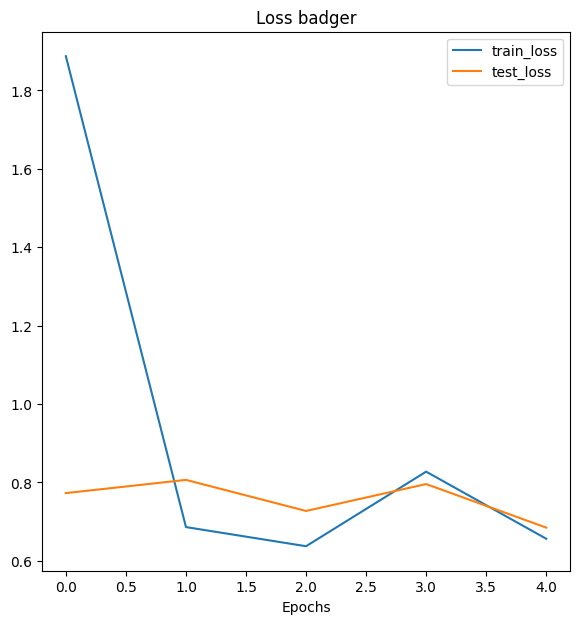

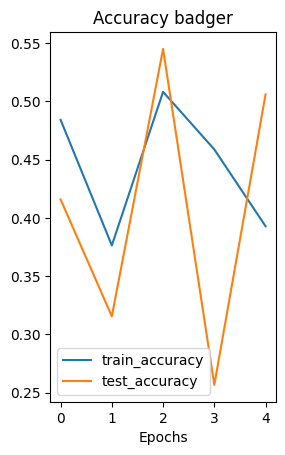

Fold 3 and class_name: badger
-------
              precision    recall  f1-score   support

           0       0.83      0.80      0.81       179
           1       0.20      0.23      0.21        39

    accuracy                           0.70       218
   macro avg       0.51      0.51      0.51       218
weighted avg       0.71      0.70      0.71       218



C:\Users\pares\miniconda3\envs\ncfm\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\pares\miniconda3\envs\ncfm\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\pares\miniconda3\envs\ncfm\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


              precision    recall  f1-score   support

           0       0.81      1.00      0.89        88
           1       0.00      0.00      0.00        21

    accuracy                           0.81       109
   macro avg       0.40      0.50      0.45       109
weighted avg       0.65      0.81      0.72       109

Epoch: 1 | train_loss: 2.5038 | train_acc: 0.7012 | test_loss: 0.6672 | test_acc: 0.8359


C:\Users\pares\miniconda3\envs\ncfm\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\pares\miniconda3\envs\ncfm\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\pares\miniconda3\envs\ncfm\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


              precision    recall  f1-score   support

           0       0.82      1.00      0.90       179
           1       0.00      0.00      0.00        39

    accuracy                           0.82       218
   macro avg       0.41      0.50      0.45       218
weighted avg       0.67      0.82      0.74       218



C:\Users\pares\miniconda3\envs\ncfm\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\pares\miniconda3\envs\ncfm\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\pares\miniconda3\envs\ncfm\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


              precision    recall  f1-score   support

           0       0.81      1.00      0.89        88
           1       0.00      0.00      0.00        21

    accuracy                           0.81       109
   macro avg       0.40      0.50      0.45       109
weighted avg       0.65      0.81      0.72       109

Epoch: 2 | train_loss: 0.7271 | train_acc: 0.8238 | test_loss: 0.7470 | test_acc: 0.8017


C:\Users\pares\miniconda3\envs\ncfm\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\pares\miniconda3\envs\ncfm\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\pares\miniconda3\envs\ncfm\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


              precision    recall  f1-score   support

           0       0.82      1.00      0.90       179
           1       0.00      0.00      0.00        39

    accuracy                           0.82       218
   macro avg       0.41      0.50      0.45       218
weighted avg       0.67      0.82      0.74       218



C:\Users\pares\miniconda3\envs\ncfm\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\pares\miniconda3\envs\ncfm\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\pares\miniconda3\envs\ncfm\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


              precision    recall  f1-score   support

           0       0.81      1.00      0.89        88
           1       0.00      0.00      0.00        21

    accuracy                           0.81       109
   macro avg       0.40      0.50      0.45       109
weighted avg       0.65      0.81      0.72       109

Epoch: 3 | train_loss: 0.7210 | train_acc: 0.8228 | test_loss: 0.7316 | test_acc: 0.8131


C:\Users\pares\miniconda3\envs\ncfm\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\pares\miniconda3\envs\ncfm\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\pares\miniconda3\envs\ncfm\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


              precision    recall  f1-score   support

           0       0.82      1.00      0.90       179
           1       0.00      0.00      0.00        39

    accuracy                           0.82       218
   macro avg       0.41      0.50      0.45       218
weighted avg       0.67      0.82      0.74       218



C:\Users\pares\miniconda3\envs\ncfm\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\pares\miniconda3\envs\ncfm\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\pares\miniconda3\envs\ncfm\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


              precision    recall  f1-score   support

           0       0.81      1.00      0.89        88
           1       0.00      0.00      0.00        21

    accuracy                           0.81       109
   macro avg       0.40      0.50      0.45       109
weighted avg       0.65      0.81      0.72       109

Epoch: 4 | train_loss: 0.7239 | train_acc: 0.8218 | test_loss: 0.7056 | test_acc: 0.8245


C:\Users\pares\miniconda3\envs\ncfm\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\pares\miniconda3\envs\ncfm\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\pares\miniconda3\envs\ncfm\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


              precision    recall  f1-score   support

           0       0.82      1.00      0.90       179
           1       0.00      0.00      0.00        39

    accuracy                           0.82       218
   macro avg       0.41      0.50      0.45       218
weighted avg       0.67      0.82      0.74       218

              precision    recall  f1-score   support

           0       0.81      1.00      0.89        88
           1       0.00      0.00      0.00        21

    accuracy                           0.81       109
   macro avg       0.40      0.50      0.45       109
weighted avg       0.65      0.81      0.72       109

Epoch: 5 | train_loss: 0.7120 | train_acc: 0.8218 | test_loss: 0.7286 | test_acc: 0.7903


C:\Users\pares\miniconda3\envs\ncfm\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\pares\miniconda3\envs\ncfm\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\pares\miniconda3\envs\ncfm\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


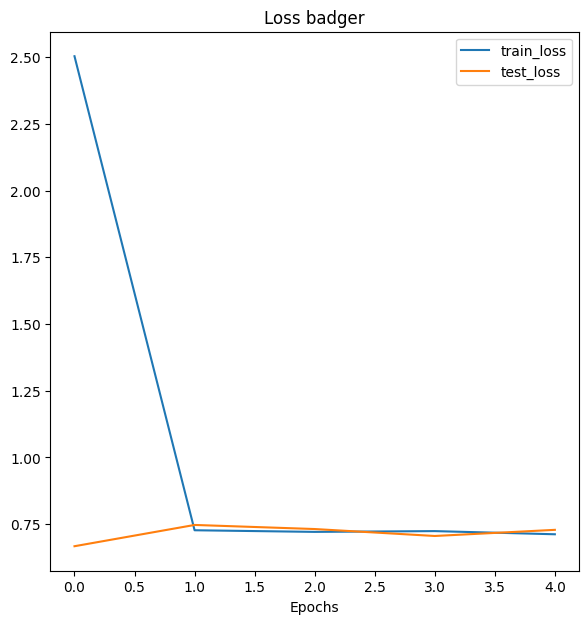

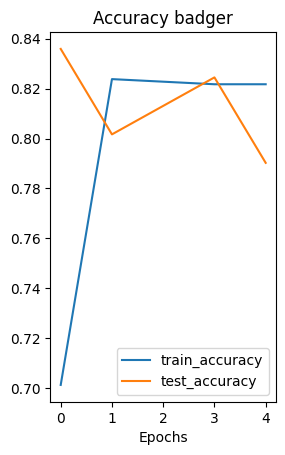

Fold 1 and class_name: bat
-------


KeyboardInterrupt: 

In [316]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
for i in df['class_name'].unique():
    k_folds = 3
    batch_size = 32
    selecting_k_images('dataset.csv', i)
    loss_fn = nn.BCEWithLogitsLoss()
    df_sample = pd.read_csv('./df_sample.csv')
    df_sample['class_name'] = df_sample['class_name'].apply(lambda x: 1 if x == i else 0)
    df_sample.to_csv("./df_sample.csv", index = False)
    train_data = CustomDataset("./df_sample.csv", transform = train_transform)
    weight_1, weight_2 = len(df_sample) / len(df_sample[df_sample['class_name'] == 0]), len(df_sample) / len(df_sample[df_sample['class_name'] == 1])
    weight = torch.tensor([weight_1, weight_2])
    # Initialize the k-fold cross validation
    kf = KFold(n_splits=k_folds, shuffle=True)

    # Loop through each fold
    for fold, (train_idx, test_idx) in enumerate(kf.split(train_data)):
        print(f"Fold {fold + 1} and class_name: {i}")
        print("-------")

        # Define the data loaders for the current fold
        train_loader = DataLoader(
            dataset=train_data,
            batch_size=batch_size,
            sampler=torch.utils.data.SubsetRandomSampler(train_idx),
        )
        test_loader = DataLoader(
            dataset=train_data,
            batch_size=batch_size,
            sampler=torch.utils.data.SubsetRandomSampler(test_idx),
        )
        
        model = models[i]
        model.train_mode(train_loader, test_loader, 5, weight)
        models[i] = Model(i)

In [324]:
m = models['antelope'].model

In [325]:
m

CNN(
  (model): Sequential(
    (0): Conv2d(3, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (2): LayerNorm((32, 242, 242), eps=1e-05, elementwise_affine=True)
    (3): ELU(alpha=1.0)
    (4): Dropout(p=0.2, inplace=False)
    (5): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (6): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (7): LayerNorm((64, 121, 121), eps=1e-05, elementwise_affine=True)
    (8): ELU(alpha=1.0)
    (9): Dropout(p=0.2, inplace=False)
    (10): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (12): LayerNorm((128, 60, 60), eps=1e-05, elementwise_affine=True)
    (13): ELU(alpha=1.0)
    (14): Dropout(p=0.2, inplace=False)
    (15): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (16): M

In [326]:
from explainable_cnn import CNNExplainer
from torchvision import transforms
import matplotlib.pyplot as plt

In [327]:
x_cnn = CNNExplainer(m, {0: "other", 1: "antelope"})

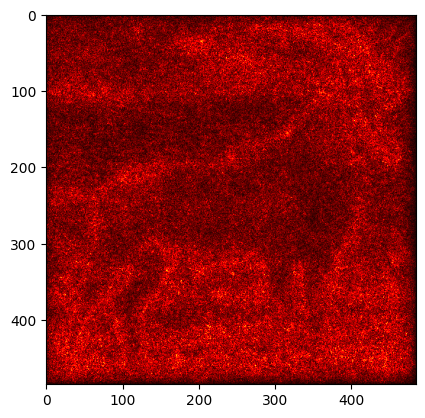

In [328]:
saliency_map = x_cnn.get_saliency_map(
    r"C:\Users\pares\Documents\animal_classification\dataset\archive\animals\animals\antelope\0fb2e9aa81.jpg",
    "antelope",
    (485, 485)
)
plt.imshow(saliency_map, cmap="hot")
plt.show()

C:\Users\pares\miniconda3\envs\ncfm\lib\site-packages\torch\nn\modules\module.py:1344: UserWarning: Using a non-full backward hook when the forward contains multiple autograd Nodes is deprecated and will be removed in future versions. This hook will be missing some grad_input. Please use register_full_backward_hook to get the documented behavior.
  warnings.warn("Using a non-full backward hook when the forward contains multiple autograd Nodes "


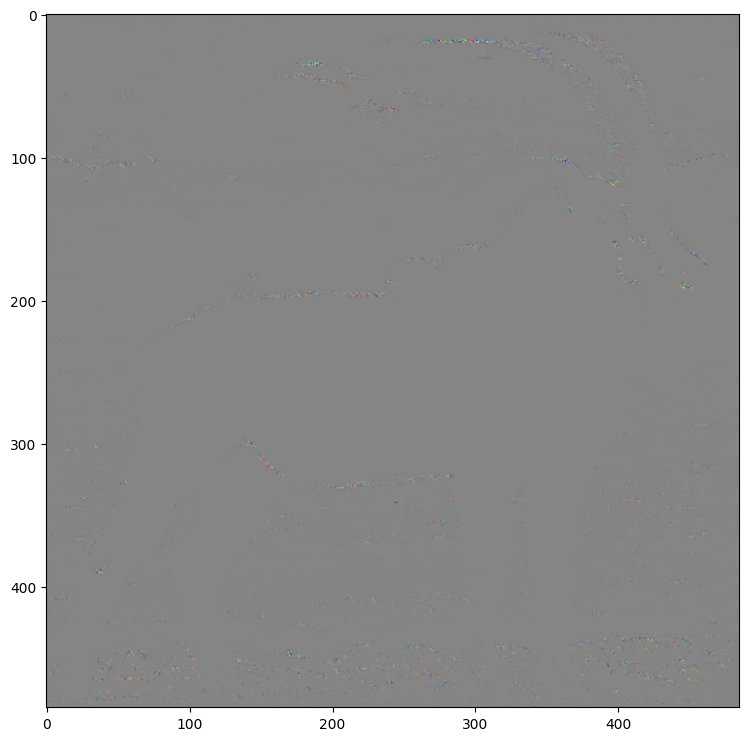

In [349]:
guided_backprop = x_cnn.get_guided_grad_cam(
  r"C:\Users\pares\Documents\animal_classification\dataset\archive\animals\animals\antelope\0fb2e9aa81.jpg",
  "antelope",
  (485, 485),
  ["model.5"]
)
plt.figure(figsize=(15, 9))
plt.imshow(guided_backprop[0].astype('uint8'))

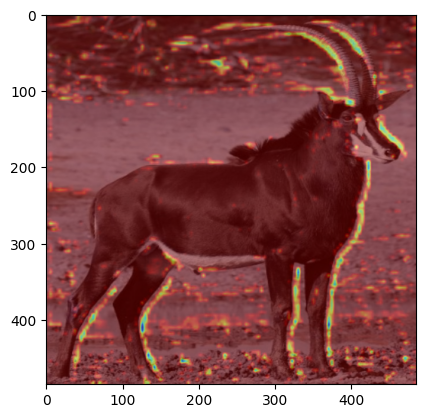

In [350]:
guided_backprop = x_cnn.get_grad_cam(
    r"C:\Users\pares\Documents\animal_classification\dataset\archive\animals\animals\antelope\0fb2e9aa81.jpg",
    "antelope",
    (485, 485),
    ['model.10']
)

plt.imshow(guided_backprop[0].astype('uint8'))

In [251]:
def predict(models, img_path, mode = 'ce'): 
    m = nn.Softmax() if mode == 'ce' else nn.Sigmoid()
    df = pd.read_csv('dataset.csv')
    mean=[0.485, 0.456, 0.406]
    std=[0.229, 0.224, 0.225]
    img = Image.open(img_path).resize((485, 485)).convert("RGB")
    img = np.asarray(img) / 255.
    img = (img-mean) / std
    img = np.reshape(img, (3, 485, 485))
    img = torch.tensor(img).unsqueeze(axis = 0)
    pred = 0
    for i in df['class_name'].unique(): 
        if mode != 'be':
            pred_temp = m(models[i].model(img.to(device).float()), dim = 1)
            pred_temp = torch.argmax(pred_temp, dim = 1)
            print(i, pred_temp.cpu().detach().numpy())
        else:
            pred_temp = m(models[i].model(img.to(device).float()))
            pred_temp = torch.round(pred_temp, dim = 1)
            print(i, pred_temp.cpu().detach().numpy())